# SOCCER TEAM STRATEGY
## Team 2
### Team Members:
#### Zeenia Singla NU ID: 002980842
#### Nithin Dornipadu NU ID: 002197358
#### Meghana Reddy NU ID: 002101719

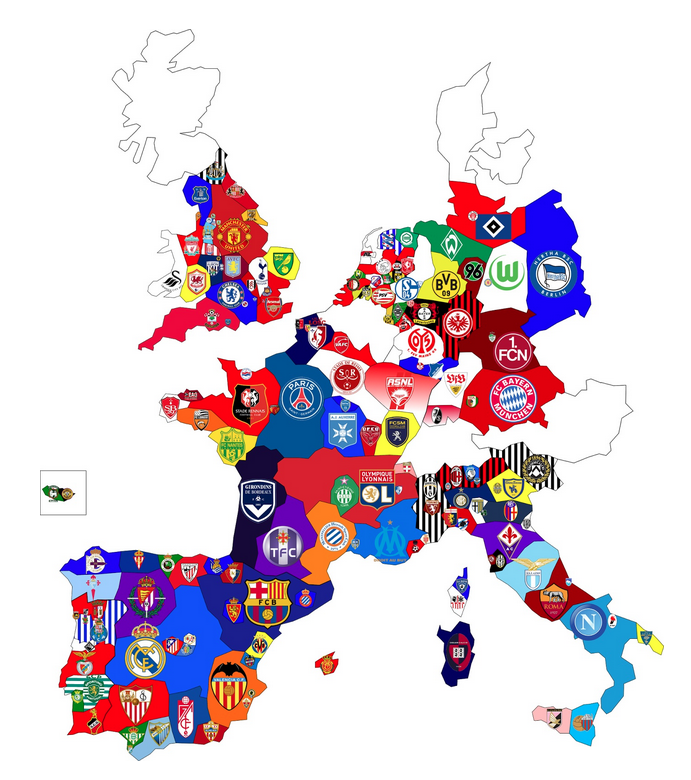

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import sqlite3
from datetime import timedelta
import warnings

warnings.filterwarnings("ignore")
db_path = "database.sqlite"

In [2]:
os.getcwd()

'D:\\Data-Science-INFO-6105\\FInalProject'

In [3]:
conn = sqlite3.connect(db_path)
df_team = pd.read_sql_query("""SELECT * FROM Team;""", conn)
df_team_attributes = pd.read_sql_query("""select * from Team_Attributes;""", conn)
df_match = pd.read_sql_query("""SELECT * FROM Match;""", conn)
df_match

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,SJA,VCH,VCD,VCA,GBH,GBD,GBA,BSH,BSD,BSA
0,1,1,1,2008/2009,1,2008-08-17 00:00:00,492473,9987,9993,1,...,4.00,1.65,3.40,4.50,1.78,3.25,4.00,1.73,3.40,4.20
1,2,1,1,2008/2009,1,2008-08-16 00:00:00,492474,10000,9994,0,...,3.80,2.00,3.25,3.25,1.85,3.25,3.75,1.91,3.25,3.60
2,3,1,1,2008/2009,1,2008-08-16 00:00:00,492475,9984,8635,0,...,2.50,2.35,3.25,2.65,2.50,3.20,2.50,2.30,3.20,2.75
3,4,1,1,2008/2009,1,2008-08-17 00:00:00,492476,9991,9998,5,...,7.50,1.45,3.75,6.50,1.50,3.75,5.50,1.44,3.75,6.50
4,5,1,1,2008/2009,1,2008-08-16 00:00:00,492477,7947,9985,1,...,1.73,4.50,3.40,1.65,4.50,3.50,1.65,4.75,3.30,1.67
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25974,25975,24558,24558,2015/2016,9,2015-09-22 00:00:00,1992091,10190,10191,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25975,25976,24558,24558,2015/2016,9,2015-09-23 00:00:00,1992092,9824,10199,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25976,25977,24558,24558,2015/2016,9,2015-09-23 00:00:00,1992093,9956,10179,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25977,25978,24558,24558,2015/2016,9,2015-09-22 00:00:00,1992094,7896,10243,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df_team = df_team.dropna()
df_team['team_fifa_api_id'] = df_team['team_fifa_api_id'].astype(int)
short_name_id_mapping = pd.Series(df_team.team_short_name.values,index=df_team.team_api_id).to_dict()

In [5]:
df_match['date'] = pd.to_datetime(df_match['date'])

### Adding Labels [Win, Draw, Defeat] for a given match

In [6]:
def get_match_label(home_goals, away_goals):
    ''' Derives a label for a given match. '''
    if home_goals > away_goals:
        return "Win"
    if home_goals == away_goals:
        return "Draw"
    if home_goals < away_goals:
        return "Defeat"


In [7]:
df_match['MatchResult'] = df_match.apply(lambda x : get_match_label(x.home_team_goal, x.away_team_goal), axis=1)

In [8]:
df_match['HomeTeamShortName'] = df_match['home_team_api_id'].apply(lambda x : short_name_id_mapping.get(x, np.nan))
df_match['AwayTeamShortName'] = df_match['away_team_api_id'].apply(lambda x : short_name_id_mapping.get(x, np.nan))

In [9]:
for index, rows in df_match.iterrows():
    match_data = rows.to_dict()
    print(type(match_data['home_player_11']))
    print(rows.to_dict())
    break

<class 'float'>
{'id': 1, 'country_id': 1, 'league_id': 1, 'season': '2008/2009', 'stage': 1, 'date': Timestamp('2008-08-17 00:00:00'), 'match_api_id': 492473, 'home_team_api_id': 9987, 'away_team_api_id': 9993, 'home_team_goal': 1, 'away_team_goal': 1, 'home_player_X1': nan, 'home_player_X2': nan, 'home_player_X3': nan, 'home_player_X4': nan, 'home_player_X5': nan, 'home_player_X6': nan, 'home_player_X7': nan, 'home_player_X8': nan, 'home_player_X9': nan, 'home_player_X10': nan, 'home_player_X11': nan, 'away_player_X1': nan, 'away_player_X2': nan, 'away_player_X3': nan, 'away_player_X4': nan, 'away_player_X5': nan, 'away_player_X6': nan, 'away_player_X7': nan, 'away_player_X8': nan, 'away_player_X9': nan, 'away_player_X10': nan, 'away_player_X11': nan, 'home_player_Y1': nan, 'home_player_Y2': nan, 'home_player_Y3': nan, 'home_player_Y4': nan, 'home_player_Y5': nan, 'home_player_Y6': nan, 'home_player_Y7': nan, 'home_player_Y8': nan, 'home_player_Y9': nan, 'home_player_Y10': nan, 'home

## Exploratory Data Anlaysis to find Top and Least Performing Teams in England Premier League

### Selecting Only England premier League ( 1729 ) matches for the current EDA

In [9]:
df_match_filtered = df_match[df_match['league_id'] == 1729]

In [10]:
df_match_filtered.shape

(3040, 118)

In [11]:
df_match_filtered['year'] = df_match_filtered['date'].dt.year

In [12]:
df_match_filtered['year'].value_counts()

2012    391
2014    380
2015    380
2009    378
2011    377
2010    374
2013    372
2008    198
2016    190
Name: year, dtype: int64

In [13]:
query = """ 
    with initial_table as (select Country.id,
		Country.name AS country,
		League.name AS league,
		match.season AS match_season,
		match.stage,
		HT.team_long_name AS  home_team,
		AT.team_long_name AS away_team,
		match.home_team_goal,
		match.away_team_goal
	from Country
	join League
	on Country.id = League.id
	join match
	on Country.id = match.country_id
	LEFT JOIN Team AS HT on HT.team_api_id = Match.home_team_api_id
	LEFT JOIN Team AS AT on AT.team_api_id = Match.away_team_api_id
	/*WHERE match_season = '2015/2016' AND league='Belgium Jupiler League'*/),	
team_home as (select initial_table.id as id,
		initial_table.country as country,
		initial_table.league as league,
		initial_table.match_season as match_season,
		initial_table.stage as stage,
		initial_table.home_team as home_team,
		initial_table.home_team_goal AS goals_scored,
		initial_table.away_team_goal AS goals_conceded,
		CASE WHEN initial_table.home_team_goal > initial_table.away_team_goal THEN 1 
			ELSE 0
			END AS won,
		CASE WHEN initial_table.home_team_goal = initial_table.away_team_goal THEN 1 
			ELSE 0
			END AS draw,
		CASE WHEN initial_table.home_team_goal < initial_table.away_team_goal THEN 1 
			ELSE 0
			END AS lost
from initial_table	
),
team_away as (select initial_table.id,
		initial_table.country AS country,
		initial_table.league AS league,
		initial_table.match_season AS match_season,
		initial_table.stage as stage,
		initial_table.away_team AS away_team,
		initial_table.away_team_goal AS goals_scored,
		initial_table.home_team_goal AS goals_conceded,
		CASE WHEN initial_table.away_team_goal > initial_table.home_team_goal THEN 1 
			ELSE 0
			END AS won,
		CASE WHEN initial_table.home_team_goal = initial_table.away_team_goal THEN 1 
			ELSE 0
			END AS draw,
		CASE WHEN  initial_table.away_team_goal < initial_table.home_team_goal THEN 1 
			ELSE 0
			END AS lost
from initial_table)	,
matches_home as (
	SELECT team,
		   country,
		   league,
		   match_season,
		   won,
		   draw,
		   lost,
	       goals_scored,
		   goals_conceded,
		   won*3 + draw AS points
		FROM (SELECT team_home.home_team as team,
			team_home.country as country,
			team_home.league as league,
			team_home.match_season as match_season,
			SUM(team_home.won) as won,
			SUM(team_home.draw) as draw,
			SUM(team_home.lost) as lost,
			SUM(team_home.goals_scored) as goals_scored,
			SUM(team_home.goals_conceded) as goals_conceded
				FROM team_home
				GROUP BY 1,2,3,4)
		),
matches_away as (
	SELECT team,
		   country,
		   league,
		   match_season,
		   won,
		   draw,
		   lost,
	       goals_scored,
		   goals_conceded,
		   won*3 + draw AS points
		FROM (SELECT team_away.away_team as team,
			team_away.country as country,
			team_away.league as league,
			team_away.match_season as match_season,
			SUM(team_away.won) as won,
			SUM(team_away.draw) as draw,
			SUM(team_away.lost) as lost,
			SUM(team_away.goals_scored) as goals_scored,
			SUM(team_away.goals_conceded) as goals_conceded
				FROM team_away
				GROUP BY 1,2,3,4)	
		),
matches as (
	select matches_home.country,
	   matches_home.league, 
	   matches_home.match_season,
	   matches_home.team, 
	   matches_home.won + matches_away.won + matches_home.draw + matches_away.draw + matches_home.lost + matches_away.lost as game_played,
	   matches_home.points + matches_away.points as points,
	   matches_home.won + matches_away.won as won,
	   matches_home.draw + matches_away.draw as draw,
	   matches_home.lost + matches_away.lost as lost,
	   matches_home.goals_scored + matches_away.goals_scored as goals_scored,
	   matches_home.goals_conceded + matches_away.goals_conceded as goals_conceded,
	   (matches_home.goals_scored + matches_away.goals_scored) - (matches_home.goals_conceded + matches_away.goals_conceded) as goals_difference
	from matches_home
	join matches_away
	on matches_home.team = matches_away.team and matches_home.match_season = matches_away.match_season
		and matches_home.country = matches_away.country
		and matches_home.league = matches_away.league
	order by points desc
)
SELECT country,
	league,
	match_season,
	team,
	game_played,
	points,
	won,
	draw,
	lost,
	goals_scored,
	goals_conceded,
	goals_difference
from matches
/*where country = 'Belgium'*/
order by country, match_season desc, points desc, goals_difference desc

"""
#df_matches = pd.read_sql_query(query.read(), connection)

# game_played = df_match.groupby(['country', 'match_season', 'team']).sum().game_played

### Total count of Games played per Country

In [14]:
df_game_played = pd.read_sql_query(query ,conn)
df_game_played['country'].value_counts()

England        160
France         160
Italy          160
Spain          160
Germany        144
Netherlands    144
Portugal       132
Poland         125
Belgium        117
Scotland        96
Switzerland     80
Name: country, dtype: int64

In [15]:
df_game_played_england = df_game_played[df_game_played['country'] == 'England']

### All the matches played in England Premier League across all Seasons

In [16]:
df_game_played_england

,country,league,match_season,team,game_played,points,won,draw,lost,goals_scored,goals_conceded,goals_difference
117,England,England Premier League,2015/2016,Leicester City,38,81,23,12,3,68,36,32
118,England,England Premier League,2015/2016,Arsenal,38,71,20,11,7,65,36,29
119,England,England Premier League,2015/2016,Tottenham Hotspur,38,70,19,13,6,69,35,34
120,England,England Premier League,2015/2016,Manchester City,38,66,19,9,10,71,41,30
121,England,England Premier League,2015/2016,Manchester United,38,66,19,9,10,49,35,14
...,...,...,...,...,...,...,...,...,...,...,...,...
272,England,England Premier League,2008/2009,Sunderland,38,36,9,9,20,34,54,-20
273,England,England Premier League,2008/2009,Hull City,38,35,8,11,19,39,64,-25
274,England,England Premier League,2008/2009,Newcastle United,38,34,7,13,18,40,59,-19
275,England,England Premier League,2008/2009,Middlesbrough,38,32,7,11,20,28,57,-29


In [17]:
# To check null values below code is used
df_game_played_england.isnull().sum()

country             0
league              0
match_season        0
team                0
game_played         0
points              0
won                 0
draw                0
lost                0
goals_scored        0
goals_conceded      0
goals_difference    0
dtype: int64

In [18]:
df_game_played_england.nunique()

country              1
league               1
match_season         8
team                34
game_played          1
points              57
won                 26
draw                14
lost                24
goals_scored        54
goals_conceded      52
goals_difference    77
dtype: int64


### Which are the top five teams or top performers over the years, per country?
Let’s visualize the information in our dataset by finding correlation between our variables and see how the data is distributed.

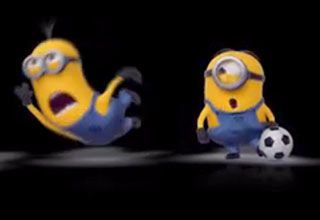

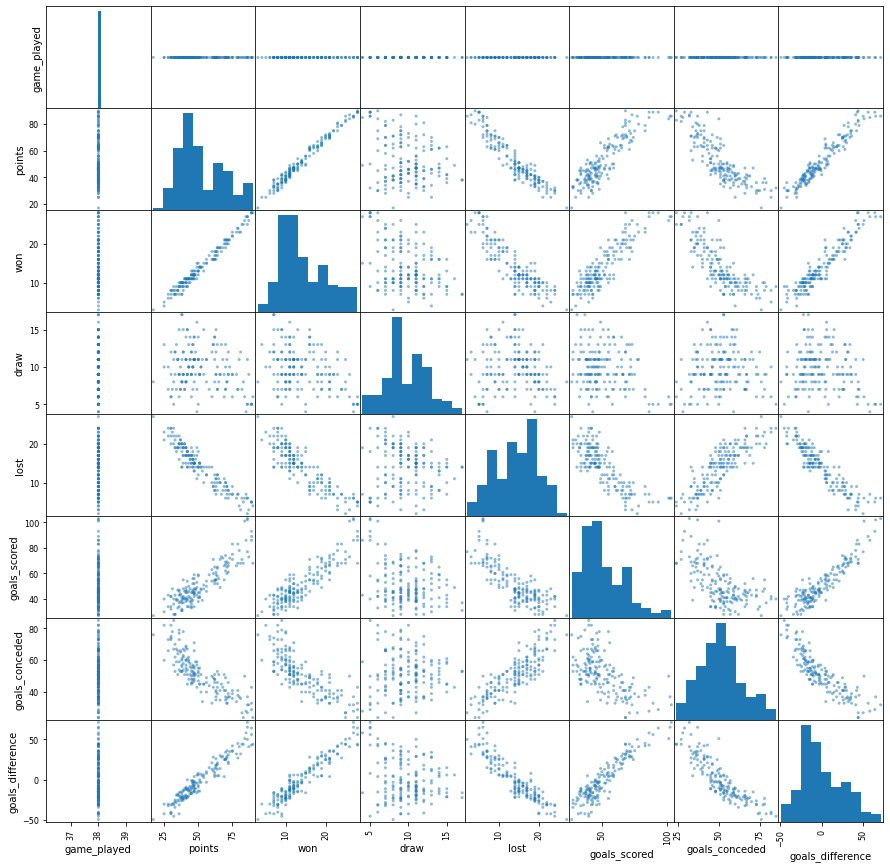

In [19]:
pd.plotting.scatter_matrix(df_game_played_england, figsize=(15,15));

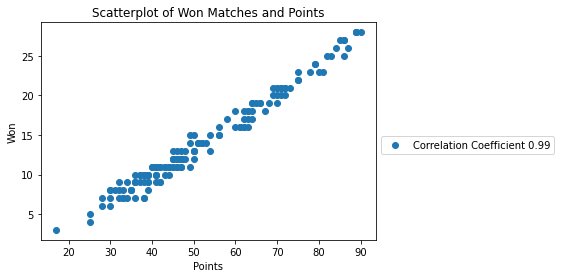

In [20]:
import matplotlib.pyplot as plt

corr = np.round(df_game_played_england['points'].corr(df_game_played_england['won']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['points'], df_game_played_england['won'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Won Matches and Points')
plt.xlabel('Points')
plt.ylabel('Won')

plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show()

With a correlation coefficient of 0.99, this scatter plot shows a strong, positive, linear relationship between won matches and how many points a team got. This means that if a team wins more games, it receives more points.

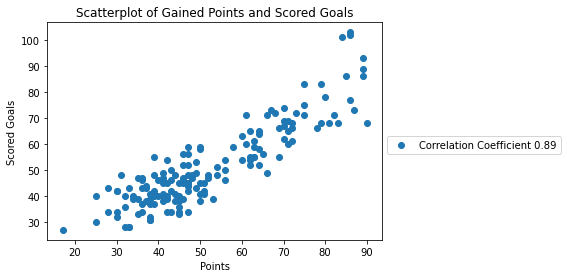

In [21]:
df_game_played_england.plot(x='points', y='goals_scored', kind='scatter');

# calculate the correlation coefficient
corr = np.round(df_game_played_england['points'].corr(df_game_played_england['goals_scored']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['points'], df_game_played_england['goals_scored'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Gained Points and Scored Goals')
plt.xlabel('Points')
plt.ylabel('Scored Goals')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();


With a correlation coefficient of 0.89, this scatter plot shows a strong, positive, linear relationship between how many goals a team scored and how many points a team got. This means that if a team scores many goals, it receives more points.

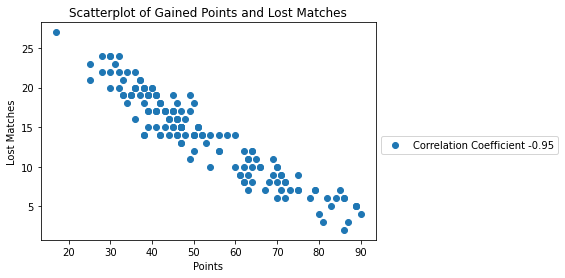

In [22]:
corr = np.round(df_game_played_england['points'].corr(df_game_played_england['lost']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['points'], df_game_played_england['lost'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Gained Points and Lost Matches')
plt.xlabel('Points')
plt.ylabel('Lost Matches')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();

With a correlation coefficient of -0.95, this scatter plot shows a strong, negative, linear relationship between how many matches a team lost and how many points a team got. This means that if a team losses many games, it receives fewer points.

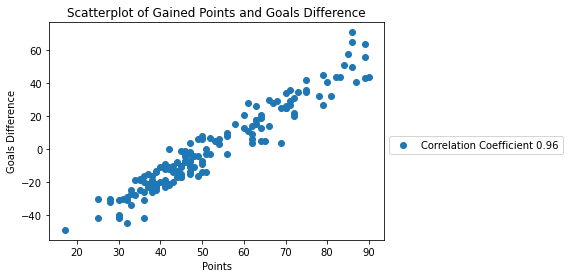

In [23]:
corr = np.round(df_game_played_england['points'].corr(df_game_played_england['goals_difference']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['points'], df_game_played_england['goals_difference'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Gained Points and Goals Difference')
plt.xlabel('Points')
plt.ylabel('Goals Difference')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();


With a correlation coefficient of 0.96, this scatter plot shows a strong, positive, linear relationship between the difference between goals scored and goals conceded (goals_difference) and how many points a team got. This means that if the difference between goals scored and goals received is bigger, than the team receives more points.

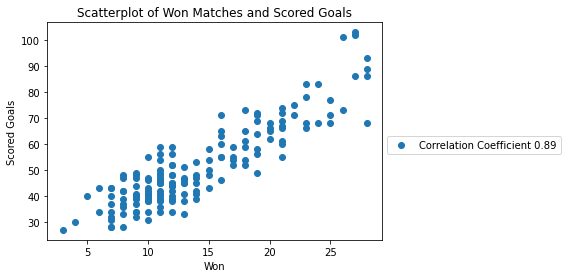

In [24]:
corr = np.round(df_game_played_england['won'].corr(df_game_played_england['goals_scored']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['won'], df_game_played_england['goals_scored'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Won Matches and Scored Goals')
plt.xlabel('Won')
plt.ylabel('Scored Goals')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();


With a correlation coefficient of 0.89, this scatter plot shows a strong, positive, linear relationship between how many goals a team scored and how many matches a team won. This means that if a team scores many goals, it wins more matches.



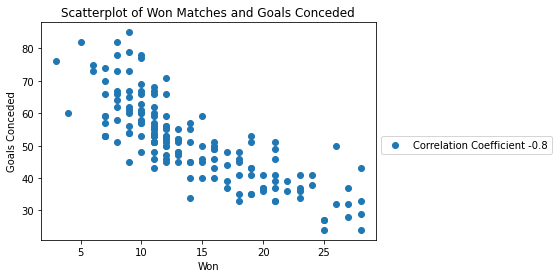

In [25]:
corr = np.round(df_game_played_england['won'].corr(df_game_played_england['goals_conceded']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['won'], df_game_played_england['goals_conceded'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Won Matches and Goals Conceded')
plt.xlabel('Won')
plt.ylabel('Goals Conceded')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();

With a correlation coefficient of -0.8, this scatter plot shows a moderate, negative, linear relationship between how many goals a team received and how many matches a team won.

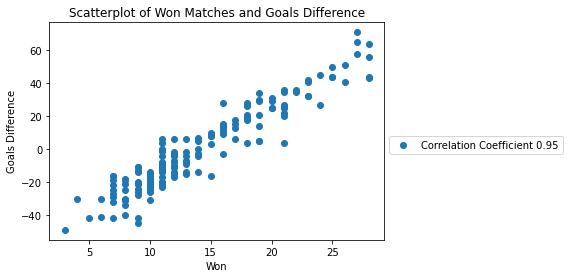

In [26]:
corr = np.round(df_game_played_england['won'].corr(df_game_played_england['goals_difference']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['won'], df_game_played_england['goals_difference'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Won Matches and Goals Difference')
plt.xlabel('Won')
plt.ylabel('Goals Difference')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();

With a correlation coefficient of 0.95, this scatter plot shows a strong, positive, linear relationship between goals difference and how many matches a team won. This means that if the goals difference is bigger, it wins more matches.



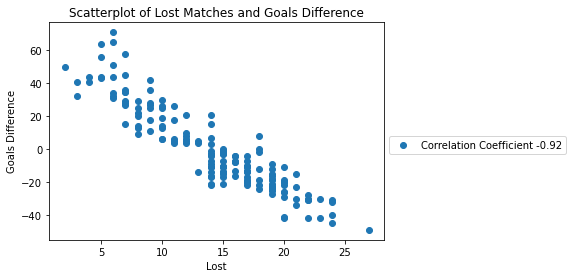

In [27]:
corr = np.round(df_game_played_england['lost'].corr(df_game_played_england['goals_difference']), decimals=2)

# plot the scatter
plt.scatter(df_game_played_england['lost'], df_game_played_england['goals_difference'], label="Correlation Coefficient {}".format(corr));
plt.title('Scatterplot of Lost Matches and Goals Difference')
plt.xlabel('Lost')
plt.ylabel('Goals Difference')
plt.legend()
plt.legend(loc='upper left', bbox_to_anchor=(1, 0.5))
plt.show();

With a correlation coefficient of -0.92, this scatter plot shows a strong, negative, linear relationship between how many matches a team lost and the goals difference. This means that if a team losses many games, the goals difference is smaller.



In [28]:
df_game_played_england

,country,league,match_season,team,game_played,points,won,draw,lost,goals_scored,goals_conceded,goals_difference
117,England,England Premier League,2015/2016,Leicester City,38,81,23,12,3,68,36,32
118,England,England Premier League,2015/2016,Arsenal,38,71,20,11,7,65,36,29
119,England,England Premier League,2015/2016,Tottenham Hotspur,38,70,19,13,6,69,35,34
120,England,England Premier League,2015/2016,Manchester City,38,66,19,9,10,71,41,30
121,England,England Premier League,2015/2016,Manchester United,38,66,19,9,10,49,35,14
...,...,...,...,...,...,...,...,...,...,...,...,...
272,England,England Premier League,2008/2009,Sunderland,38,36,9,9,20,34,54,-20
273,England,England Premier League,2008/2009,Hull City,38,35,8,11,19,39,64,-25
274,England,England Premier League,2008/2009,Newcastle United,38,34,7,13,18,40,59,-19
275,England,England Premier League,2008/2009,Middlesbrough,38,32,7,11,20,28,57,-29


## Top 5 and bottom 3 Teams for each season in England Premier League 

In [29]:
def country_details(df_country):
    country = df_country['country'].unique()
    league = df_country['league'].unique()
    match_season = df_country['match_season'].unique()
    return country, league, match_season


In [30]:
country, league, match_season = country_details(df_game_played_england)
country, league, match_season

(array(['England'], dtype=object),
 array(['England Premier League'], dtype=object),
 array(['2015/2016', '2014/2015', '2013/2014', '2012/2013', '2011/2012',
        '2010/2011', '2009/2010', '2008/2009'], dtype=object))

In [31]:
def filter_country_plot(df_country, season):
    country, league, match_season = country_details(df_country)
    
    # initialize values 
    team = []
    points = []
    goals_df = []
    
    for index, row in df_country.iterrows():
        if row['match_season'] == season:
            # append values
            team.append(row['team'])
            points.append(row['points'])
            goals_df.append( row['goals_difference'])
    
    # convert list to NumPy array            
    teams = np.array(team)
    points = np.array(points)
    goals_df = np.array(goals_df)   

    # get the top 5 values
    top_5_teams = teams[:5]
    top_5_points = points[:5]
    top_5_goals_df = goals_df[:5]

    # get the last 3 values
    last_3_position = len(teams) - 3
    last_3_teams = teams[last_3_position :]
    last_3_points = points[last_3_position :]
    last_3_goals_df = goals_df[last_3_position :]
    
    return top_5_teams, top_5_points, top_5_goals_df, last_3_teams, last_3_points, last_3_goals_df


In [32]:
season_data = set(df_game_played_england['match_season'].values.tolist())

for season_info in season_data:
    top_5_teams, top_5_points, top_5_goals_df, last_3_teams, last_3_points, last_3_goals_df = filter_country_plot(df_game_played_england,
                                                                                                                  season_info)
    print(season_info)
    print("Last 3 teams " + str(last_3_teams))
    print("Top 5 teams " + str(top_5_teams))
    

2013/2014
Last 3 teams ['Norwich City' 'Fulham' 'Cardiff City']
Top 5 teams ['Manchester City' 'Liverpool' 'Chelsea' 'Arsenal' 'Everton']
2015/2016
Last 3 teams ['Newcastle United' 'Norwich City' 'Aston Villa']
Top 5 teams ['Leicester City' 'Arsenal' 'Tottenham Hotspur' 'Manchester City'
 'Manchester United']
2009/2010
Last 3 teams ['Burnley' 'Hull City' 'Portsmouth']
Top 5 teams ['Chelsea' 'Manchester United' 'Arsenal' 'Tottenham Hotspur'
 'Manchester City']
2008/2009
Last 3 teams ['Newcastle United' 'Middlesbrough' 'West Bromwich Albion']
Top 5 teams ['Manchester United' 'Liverpool' 'Chelsea' 'Arsenal' 'Everton']
2011/2012
Last 3 teams ['Bolton Wanderers' 'Blackburn Rovers' 'Wolverhampton Wanderers']
Top 5 teams ['Manchester City' 'Manchester United' 'Arsenal' 'Tottenham Hotspur'
 'Newcastle United']
2012/2013
Last 3 teams ['Wigan Athletic' 'Reading' 'Queens Park Rangers']
Top 5 teams ['Manchester United' 'Manchester City' 'Chelsea' 'Arsenal'
 'Tottenham Hotspur']
2014/2015
Last 3 te

In [33]:
def plot_barh(teams, points, goals_df, season):
    width = 0.35
    ind = np.arange(len(teams))
    locations = ind + width / 2 # ytick locations
    labels = teams # ytick labels
    
    if len(teams) == 5:
        plt_title = 'Top Five Winners'
    else:
        plt_title = 'Last Three Teams'
    
    heights_points = points
    heights_gd = goals_df
    winners_points = plt.barh(ind, heights_points, width, alpha=.7, label='Points')
    winner_gd = plt.barh(ind + width, heights_gd, width, alpha=.7, label='Goals Difference')
    # title and labels
    plt.title('{} in {}, {} Match Season, {} by Points and Goals Difference'.format(plt_title, league[0], season, country[0]))
    plt.xlabel('Points/Goal differences')
    plt.ylabel('Team')
    plt.yticks(locations, labels)

    #legend
    plt.legend()

    plt.show();


### Time to cheer up for Top Performing Teams!! 

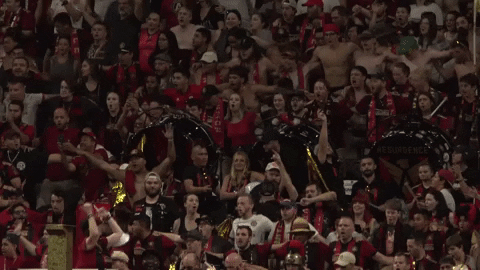

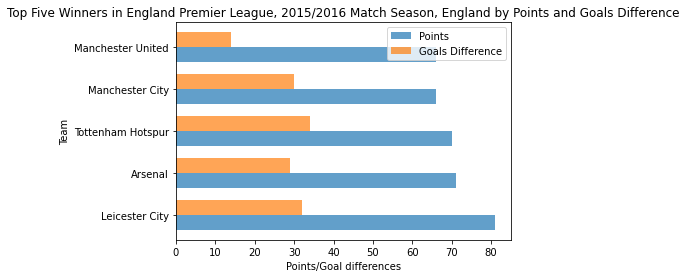

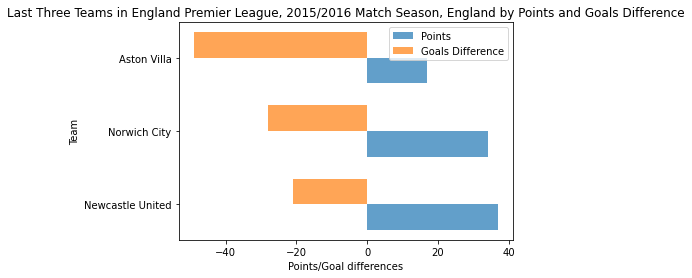

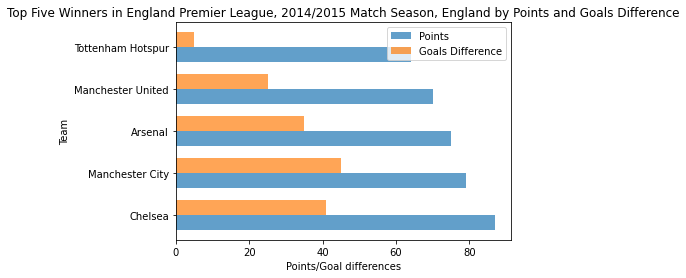

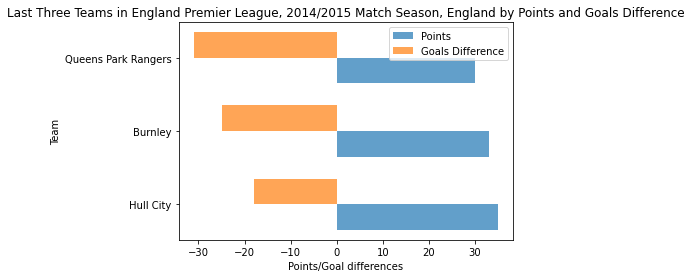

...

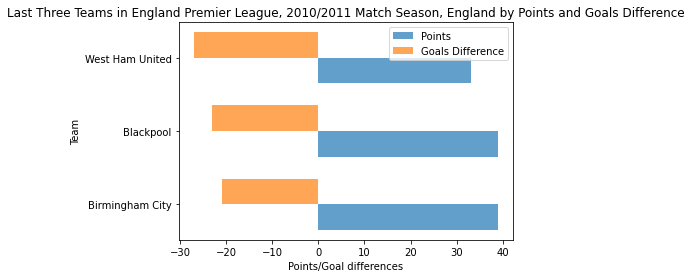

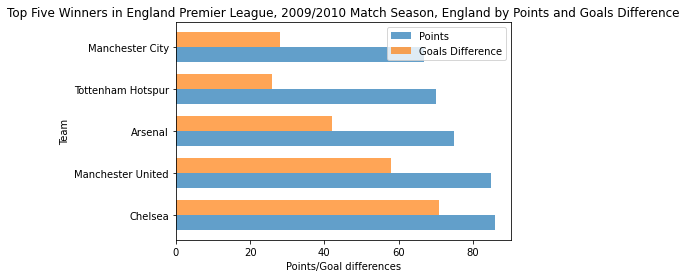

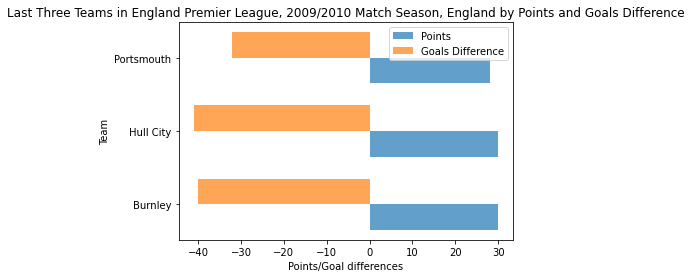

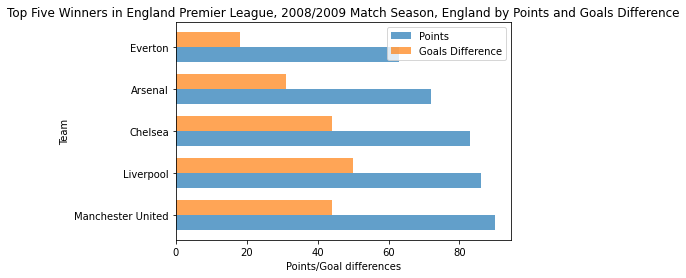

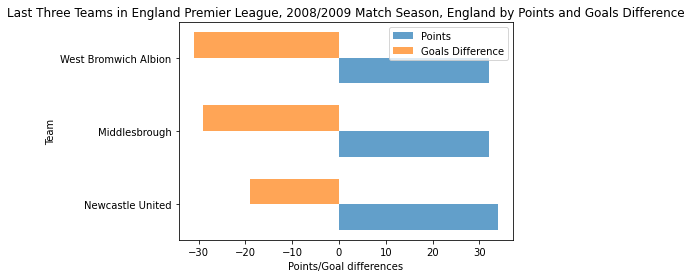

In [34]:
for season in match_season:
    top_5_teams, top_5_points, top_5_goals_df, last_3_teams, last_3_points, last_3_goals_df = filter_country_plot(df_game_played_england, season)
    plot_barh(top_5_teams, top_5_points, top_5_goals_df, season)
    plot_barh(last_3_teams, last_3_points, last_3_goals_df, season)

## Processing player attribute to get one row for each season and league  

In [100]:
df_player_attributes = pd.read_sql_query("""SELECT * FROM Player_Attributes """, conn)
df_player_attributes['date'] = pd.to_datetime(df_player_attributes['date'])
df_player_attributes['year'] = df_player_attributes['date'].dt.year 

In [101]:
player_master_data = []

cols_to_exclude = ['id', 'year', 'player_fifa_api_id', 'player_api_id', 
                       'preferred_foot', 'attacking_work_rate', 'defensive_work_rate']

for name, group in df_player_attributes.groupby(['year', 'player_fifa_api_id', 'player_api_id']):
    summarized_data = {}
    print("Processing for : " + str(name))
    for col_name in group.columns.tolist():
        if col_name not in cols_to_exclude:
            summarized_data[col_name] = group[col_name].mean() 
    summarized_data['year'] = name[0]
    summarized_data['player_fifa_api_id'] = name[1]
    summarized_data['player_api_id'] = name[2]
    summarized_data['preferred_foot'] = group['preferred_foot'].iloc[0]
    summarized_data['attacking_work_rate'] = group['attacking_work_rate'].iloc[0]
    summarized_data['defensive_work_rate'] = group['defensive_work_rate'].iloc[0]
    player_master_data.append(summarized_data)

Processing for : (2007, 2, 39357)
Processing for : (2007, 6, 41762)
Processing for : (2007, 11, 26028)
Processing for : (2007, 16, 24852)
Processing for : (2007, 27, 30630)
Processing for : (2007, 28, 101983)
Processing for : (2007, 41, 30955)
Processing for : (2007, 58, 30668)
Processing for : (2007, 61, 38243)
Processing for : (2007, 80, 24217)
Processing for : (2007, 158, 26436)
Processing for : (2007, 164, 27731)
Processing for : (2007, 185, 36286)
Processing for : (2007, 195, 30369)
Processing for : (2007, 201, 25930)
Processing for : (2007, 241, 24154)
Processing for : (2007, 244, 30615)
Processing for : (2007, 245, 30360)
Processing for : (2007, 246, 30373)
Processing for : (2007, 249, 30371)
Processing for : (2007, 250, 30612)
Processing for : (2007, 268, 33826)
Processing for : (2007, 269, 23025)
Processing for : (2007, 330, 24635)
Processing for : (2007, 388, 34418)
Processing for : (2007, 450, 30340)
Processing for : (2007, 492, 32574)
Processing for : (2007, 496, 34299)
Pro

Processing for : (2007, 4739, 41881)
Processing for : (2007, 4769, 41749)
Processing for : (2007, 4806, 41194)
Processing for : (2007, 4832, 35643)
Processing for : (2007, 4858, 26311)
Processing for : (2007, 4864, 33546)
Processing for : (2007, 4873, 31451)
Processing for : (2007, 4985, 35408)
Processing for : (2007, 4999, 32418)
Processing for : (2007, 5047, 46540)
Processing for : (2007, 5060, 26172)
Processing for : (2007, 5099, 34534)
Processing for : (2007, 5112, 26190)
Processing for : (2007, 5134, 26290)
Processing for : (2007, 5138, 23080)
Processing for : (2007, 5171, 37435)
Processing for : (2007, 5203, 30711)
Processing for : (2007, 5208, 11336)
Processing for : (2007, 5213, 24504)
Processing for : (2007, 5231, 32577)
Processing for : (2007, 5237, 26359)
Processing for : (2007, 5244, 27661)
Processing for : (2007, 5255, 30285)
Processing for : (2007, 5267, 42695)
Processing for : (2007, 5279, 38292)
Processing for : (2007, 5336, 26360)
Processing for : (2007, 5345, 30749)
P

Processing for : (2007, 11097, 38183)
Processing for : (2007, 11110, 30251)
Processing for : (2007, 11114, 27293)
Processing for : (2007, 11125, 30702)
Processing for : (2007, 11141, 30638)
Processing for : (2007, 11215, 35883)
Processing for : (2007, 11260, 23660)
Processing for : (2007, 11292, 43251)
Processing for : (2007, 11346, 35472)
Processing for : (2007, 11381, 24694)
Processing for : (2007, 11414, 23022)
Processing for : (2007, 11427, 39892)
Processing for : (2007, 11465, 39156)
Processing for : (2007, 11495, 38111)
Processing for : (2007, 11535, 41877)
Processing for : (2007, 11576, 30752)
Processing for : (2007, 11595, 32827)
Processing for : (2007, 11642, 24001)
Processing for : (2007, 11769, 30703)
Processing for : (2007, 11785, 37163)
Processing for : (2007, 11791, 33122)
Processing for : (2007, 11808, 39201)
Processing for : (2007, 11814, 38342)
Processing for : (2007, 11841, 23849)
Processing for : (2007, 11918, 23934)
Processing for : (2007, 11941, 27547)
Processing f

Processing for : (2007, 20882, 34102)
Processing for : (2007, 20933, 26333)
Processing for : (2007, 21144, 33931)
Processing for : (2007, 21146, 34944)
Processing for : (2007, 22499, 30277)
Processing for : (2007, 23015, 30709)
Processing for : (2007, 23312, 33758)
Processing for : (2007, 23330, 27301)
Processing for : (2007, 23461, 30492)
Processing for : (2007, 23466, 24890)
Processing for : (2007, 23641, 30456)
Processing for : (2007, 23814, 30849)
Processing for : (2007, 23823, 40495)
Processing for : (2007, 23972, 27360)
Processing for : (2007, 24225, 27423)
Processing for : (2007, 24248, 37545)
Processing for : (2007, 24332, 30712)
Processing for : (2007, 24413, 5686)
Processing for : (2007, 24438, 26315)
Processing for : (2007, 24630, 30660)
Processing for : (2007, 24717, 26256)
Processing for : (2007, 24851, 30736)
Processing for : (2007, 24860, 37887)
Processing for : (2007, 24894, 34222)
Processing for : (2007, 24932, 40093)
Processing for : (2007, 25110, 35991)
Processing fo

Processing for : (2007, 46065, 39702)
Processing for : (2007, 46087, 33769)
Processing for : (2007, 46102, 24169)
Processing for : (2007, 46154, 25994)
Processing for : (2007, 46160, 30443)
Processing for : (2007, 46167, 30425)
Processing for : (2007, 46175, 30827)
Processing for : (2007, 46590, 19020)
Processing for : (2007, 46727, 31052)
Processing for : (2007, 46736, 34008)
Processing for : (2007, 46807, 39490)
Processing for : (2007, 46815, 26777)
Processing for : (2007, 46826, 27349)
Processing for : (2007, 46847, 24624)
Processing for : (2007, 46857, 23916)
Processing for : (2007, 46997, 26559)
Processing for : (2007, 47003, 23819)
Processing for : (2007, 47014, 38789)
Processing for : (2007, 47020, 26586)
Processing for : (2007, 47058, 35506)
Processing for : (2007, 47092, 42573)
Processing for : (2007, 47096, 26149)
Processing for : (2007, 47131, 30852)
Processing for : (2007, 47158, 41021)
Processing for : (2007, 47189, 23889)
Processing for : (2007, 47201, 38391)
Processing f

Processing for : (2007, 51763, 40703)
Processing for : (2007, 51771, 11555)
Processing for : (2007, 51778, 41763)
Processing for : (2007, 51779, 41437)
Processing for : (2007, 51781, 42511)
Processing for : (2007, 51782, 39744)
Processing for : (2007, 51790, 9149)
Processing for : (2007, 51798, 27481)
Processing for : (2007, 51813, 34540)
Processing for : (2007, 51850, 30357)
Processing for : (2007, 51868, 3264)
Processing for : (2007, 51883, 30850)
Processing for : (2007, 51887, 37466)
Processing for : (2007, 51910, 93471)
Processing for : (2007, 51917, 38312)
Processing for : (2007, 51934, 38700)
Processing for : (2007, 51936, 25535)
Processing for : (2007, 52016, 27338)
Processing for : (2007, 52031, 3263)
Processing for : (2007, 52042, 26544)
Processing for : (2007, 52050, 26608)
Processing for : (2007, 52058, 37259)
Processing for : (2007, 52079, 23785)
Processing for : (2007, 52090, 24630)
Processing for : (2007, 52091, 32569)
Processing for : (2007, 52102, 37385)
Processing for 

Processing for : (2007, 102359, 39902)
Processing for : (2007, 102409, 37731)
Processing for : (2007, 102488, 42331)
Processing for : (2007, 102587, 23193)
Processing for : (2007, 102652, 24618)
Processing for : (2007, 103133, 34248)
Processing for : (2007, 103288, 5184)
Processing for : (2007, 103496, 41326)
Processing for : (2007, 103578, 13405)
Processing for : (2007, 103591, 36018)
Processing for : (2007, 103735, 38906)
Processing for : (2007, 103783, 39731)
Processing for : (2007, 103933, 42944)
Processing for : (2007, 103935, 27694)
Processing for : (2007, 103936, 39232)
Processing for : (2007, 103938, 38729)
Processing for : (2007, 103940, 39420)
Processing for : (2007, 104047, 24459)
Processing for : (2007, 104053, 24440)
Processing for : (2007, 104059, 39340)
Processing for : (2007, 104088, 39898)
Processing for : (2007, 104100, 39837)
Processing for : (2007, 104101, 27484)
Processing for : (2007, 104296, 38812)
Processing for : (2007, 104319, 34237)
Processing for : (2007, 10

Processing for : (2007, 112712, 30684)
Processing for : (2007, 112778, 37448)
Processing for : (2007, 112811, 26346)
Processing for : (2007, 112847, 27483)
Processing for : (2007, 112875, 33609)
Processing for : (2007, 112888, 5233)
Processing for : (2007, 112920, 75197)
Processing for : (2007, 112947, 38035)
Processing for : (2007, 113045, 35575)
Processing for : (2007, 113071, 75615)
Processing for : (2007, 113158, 33611)
Processing for : (2007, 113176, 24622)
Processing for : (2007, 113181, 41322)
Processing for : (2007, 113184, 39721)
Processing for : (2007, 113188, 42478)
Processing for : (2007, 113212, 39208)
Processing for : (2007, 113219, 39286)
Processing for : (2007, 113220, 37525)
Processing for : (2007, 113221, 24457)
Processing for : (2007, 113278, 27680)
Processing for : (2007, 113343, 23686)
Processing for : (2007, 113381, 33022)
Processing for : (2007, 113398, 38890)
Processing for : (2007, 113399, 74743)
Processing for : (2007, 113419, 74734)
Processing for : (2007, 11

Processing for : (2007, 134963, 33733)
Processing for : (2007, 134968, 10880)
Processing for : (2007, 134979, 30459)
Processing for : (2007, 134982, 39351)
Processing for : (2007, 135018, 32931)
Processing for : (2007, 135021, 32932)
Processing for : (2007, 135032, 31294)
Processing for : (2007, 135043, 26818)
Processing for : (2007, 135056, 17525)
Processing for : (2007, 135061, 17528)
Processing for : (2007, 135069, 38188)
Processing for : (2007, 135073, 42702)
Processing for : (2007, 135080, 19310)
Processing for : (2007, 135107, 33684)
Processing for : (2007, 135149, 26119)
Processing for : (2007, 135200, 36009)
Processing for : (2007, 135218, 26345)
Processing for : (2007, 135294, 115171)
Processing for : (2007, 135423, 30996)
Processing for : (2007, 135434, 25766)
Processing for : (2007, 135435, 21894)
Processing for : (2007, 135440, 26245)
Processing for : (2007, 135451, 30455)
Processing for : (2007, 135455, 34305)
Processing for : (2007, 135456, 33956)
Processing for : (2007, 

Processing for : (2007, 138241, 32427)
Processing for : (2007, 138243, 32415)
Processing for : (2007, 138244, 32952)
Processing for : (2007, 138246, 34213)
Processing for : (2007, 138247, 27329)
Processing for : (2007, 138249, 32436)
Processing for : (2007, 138251, 32430)
Processing for : (2007, 138289, 43247)
Processing for : (2007, 138297, 69686)
Processing for : (2007, 138299, 25905)
Processing for : (2007, 138334, 35497)
Processing for : (2007, 138336, 30503)
Processing for : (2007, 138350, 27578)
Processing for : (2007, 138351, 37206)
Processing for : (2007, 138373, 5693)
Processing for : (2007, 138380, 4999)
Processing for : (2007, 138384, 23148)
Processing for : (2007, 138390, 25070)
Processing for : (2007, 138394, 25160)
Processing for : (2007, 138412, 38807)
Processing for : (2007, 138413, 23073)
Processing for : (2007, 138415, 38625)
Processing for : (2007, 138418, 67003)
Processing for : (2007, 138420, 56879)
Processing for : (2007, 138421, 67393)
Processing for : (2007, 138

Processing for : (2007, 140393, 49833)
Processing for : (2007, 140415, 23882)
Processing for : (2007, 140422, 24469)
Processing for : (2007, 140445, 35725)
Processing for : (2007, 140451, 32148)
Processing for : (2007, 140453, 43268)
Processing for : (2007, 140468, 41948)
Processing for : (2007, 140488, 27669)
Processing for : (2007, 140492, 32978)
Processing for : (2007, 140497, 38880)
Processing for : (2007, 140498, 32446)
Processing for : (2007, 140507, 32833)
Processing for : (2007, 140521, 27445)
Processing for : (2007, 140522, 27471)
Processing for : (2007, 140526, 37783)
Processing for : (2007, 140535, 30254)
Processing for : (2007, 140544, 39054)
Processing for : (2007, 140550, 41339)
Processing for : (2007, 140556, 26401)
Processing for : (2007, 140601, 30865)
Processing for : (2007, 140607, 39734)
Processing for : (2007, 140609, 40009)
Processing for : (2007, 140618, 37823)
Processing for : (2007, 140620, 26660)
Processing for : (2007, 140704, 37038)
Processing for : (2007, 1

Processing for : (2007, 146747, 37492)
Processing for : (2007, 146748, 41466)
Processing for : (2007, 146749, 41465)
Processing for : (2007, 146750, 74213)
Processing for : (2007, 146753, 33775)
Processing for : (2007, 146758, 37506)
Processing for : (2007, 146759, 37446)
Processing for : (2007, 146760, 38424)
Processing for : (2007, 146762, 102628)
Processing for : (2007, 146769, 26257)
Processing for : (2007, 146932, 33586)
Processing for : (2007, 146936, 33027)
Processing for : (2007, 146937, 75616)
Processing for : (2007, 146941, 102002)
Processing for : (2007, 146952, 33630)
Processing for : (2007, 146953, 37474)
Processing for : (2007, 146954, 33635)
Processing for : (2007, 146955, 38362)
Processing for : (2007, 146963, 27436)
Processing for : (2007, 146969, 72543)
Processing for : (2007, 146970, 33863)
Processing for : (2007, 146974, 33865)
Processing for : (2007, 146984, 39735)
Processing for : (2007, 146986, 37445)
Processing for : (2007, 146992, 74302)
Processing for : (2007,

Processing for : (2007, 150490, 27518)
Processing for : (2007, 150496, 29255)
Processing for : (2007, 150508, 32788)
Processing for : (2007, 150514, 36057)
Processing for : (2007, 150515, 27554)
Processing for : (2007, 150516, 32118)
Processing for : (2007, 150520, 39670)
Processing for : (2007, 150525, 33101)
Processing for : (2007, 150532, 27472)
Processing for : (2007, 150550, 33688)
Processing for : (2007, 150564, 26244)
Processing for : (2007, 150565, 41360)
Processing for : (2007, 150568, 26236)
Processing for : (2007, 150590, 40730)
Processing for : (2007, 150594, 17703)
Processing for : (2007, 150645, 30897)
Processing for : (2007, 150647, 40544)
Processing for : (2007, 150650, 67332)
Processing for : (2007, 150655, 41116)
Processing for : (2007, 150656, 32575)
Processing for : (2007, 150657, 31453)
Processing for : (2007, 150668, 33117)
Processing for : (2007, 150675, 39980)
Processing for : (2007, 150676, 11671)
Processing for : (2007, 150677, 41221)
Processing for : (2007, 1

Processing for : (2007, 156196, 42042)
Processing for : (2007, 156216, 12763)
Processing for : (2007, 156221, 12766)
Processing for : (2007, 156222, 25962)
Processing for : (2007, 156227, 95230)
Processing for : (2007, 156233, 280976)
Processing for : (2007, 156253, 23147)
Processing for : (2007, 156256, 36005)
Processing for : (2007, 156259, 13376)
Processing for : (2007, 156271, 19434)
Processing for : (2007, 156272, 26294)
Processing for : (2007, 156275, 26646)
Processing for : (2007, 156289, 41947)
Processing for : (2007, 156383, 30863)
Processing for : (2007, 156384, 33681)
Processing for : (2007, 156385, 40049)
Processing for : (2007, 156432, 37554)
Processing for : (2007, 156434, 30964)
Processing for : (2007, 156443, 29543)
Processing for : (2007, 156473, 23740)
Processing for : (2007, 156477, 38368)
Processing for : (2007, 156519, 274623)
Processing for : (2007, 156535, 32863)
Processing for : (2007, 156538, 26652)
Processing for : (2007, 156542, 38378)
Processing for : (2007,

Processing for : (2007, 158877, 51321)
Processing for : (2007, 158879, 23997)
Processing for : (2007, 158887, 114664)
Processing for : (2007, 158902, 23823)
Processing for : (2007, 158905, 34267)
Processing for : (2007, 158911, 41602)
Processing for : (2007, 158912, 34082)
Processing for : (2007, 158933, 40341)
Processing for : (2007, 158963, 38393)
Processing for : (2007, 158994, 8881)
Processing for : (2007, 158996, 39713)
Processing for : (2007, 159017, 7284)
Processing for : (2007, 159028, 18823)
Processing for : (2007, 159034, 24228)
Processing for : (2007, 159039, 41670)
Processing for : (2007, 159040, 39428)
Processing for : (2007, 159043, 38216)
Processing for : (2007, 159047, 426553)
Processing for : (2007, 159048, 33108)
Processing for : (2007, 159051, 33550)
Processing for : (2007, 159065, 18925)
Processing for : (2007, 159073, 32620)
Processing for : (2007, 159074, 39107)
Processing for : (2007, 159080, 32907)
Processing for : (2007, 159145, 26344)
Processing for : (2007, 1

Processing for : (2007, 163097, 25604)
Processing for : (2007, 163155, 24147)
Processing for : (2007, 163158, 23371)
Processing for : (2007, 163162, 25505)
Processing for : (2007, 163184, 21834)
Processing for : (2007, 163186, 38253)
Processing for : (2007, 163187, 38363)
Processing for : (2007, 163201, 41066)
Processing for : (2007, 163203, 32449)
Processing for : (2007, 163207, 32906)
Processing for : (2007, 163209, 32705)
Processing for : (2007, 163212, 35955)
Processing for : (2007, 163225, 17391)
Processing for : (2007, 163226, 32957)
Processing for : (2007, 163228, 32951)
Processing for : (2007, 163231, 38323)
Processing for : (2007, 163244, 7604)
Processing for : (2007, 163261, 36786)
Processing for : (2007, 163264, 24155)
Processing for : (2007, 163297, 31314)
Processing for : (2007, 163303, 23253)
Processing for : (2007, 163339, 22952)
Processing for : (2007, 163340, 38759)
Processing for : (2007, 163351, 22959)
Processing for : (2007, 163352, 22969)
Processing for : (2007, 16

Processing for : (2007, 165003, 78537)
Processing for : (2007, 165005, 69599)
Processing for : (2007, 165010, 69616)
Processing for : (2007, 165012, 69261)
Processing for : (2007, 165025, 69266)
Processing for : (2007, 165031, 38887)
Processing for : (2007, 165033, 36641)
Processing for : (2007, 165064, 26574)
Processing for : (2007, 165065, 26590)
Processing for : (2007, 165070, 69004)
Processing for : (2007, 165078, 69628)
Processing for : (2007, 165102, 14642)
Processing for : (2007, 165109, 43341)
Processing for : (2007, 165153, 26166)
Processing for : (2007, 165156, 69280)
Processing for : (2007, 165174, 27420)
Processing for : (2007, 165176, 37389)
Processing for : (2007, 165179, 40840)
Processing for : (2007, 165180, 40855)
Processing for : (2007, 165190, 22929)
Processing for : (2007, 165191, 31953)
Processing for : (2007, 165195, 30899)
Processing for : (2007, 165199, 94558)
Processing for : (2007, 165226, 23054)
Processing for : (2007, 165229, 46539)
Processing for : (2007, 1

Processing for : (2007, 168640, 25166)
Processing for : (2007, 168650, 25772)
Processing for : (2007, 168651, 25773)
Processing for : (2007, 168662, 41418)
Processing for : (2007, 168732, 25751)
Processing for : (2007, 168798, 25525)
Processing for : (2007, 168799, 25519)
Processing for : (2007, 168838, 42369)
Processing for : (2007, 168913, 67401)
Processing for : (2007, 168919, 33913)
Processing for : (2007, 168930, 75376)
Processing for : (2007, 168950, 38364)
Processing for : (2007, 168961, 40558)
Processing for : (2007, 168962, 34234)
Processing for : (2007, 168965, 40714)
Processing for : (2007, 168983, 26127)
Processing for : (2007, 168984, 25657)
Processing for : (2007, 168996, 41348)
Processing for : (2007, 169020, 67369)
Processing for : (2007, 169043, 38800)
Processing for : (2007, 169051, 41199)
Processing for : (2007, 169053, 45205)
Processing for : (2007, 169055, 67365)
Processing for : (2007, 169057, 32776)
Processing for : (2007, 169063, 46344)
Processing for : (2007, 1

Processing for : (2007, 170964, 97195)
Processing for : (2007, 170972, 95227)
Processing for : (2007, 170988, 150832)
Processing for : (2007, 170991, 213820)
Processing for : (2007, 171002, 42200)
Processing for : (2007, 171016, 74435)
Processing for : (2007, 171017, 213812)
Processing for : (2007, 171018, 37631)
Processing for : (2007, 171067, 75397)
Processing for : (2007, 171082, 38262)
Processing for : (2007, 171083, 75696)
Processing for : (2007, 171087, 18664)
Processing for : (2007, 171097, 27720)
Processing for : (2007, 171098, 27723)
Processing for : (2007, 171100, 33889)
Processing for : (2007, 171106, 33891)
Processing for : (2007, 171126, 97226)
Processing for : (2007, 171133, 75411)
Processing for : (2007, 171137, 37844)
Processing for : (2007, 171139, 80500)
Processing for : (2007, 171152, 39148)
Processing for : (2007, 171177, 25625)
Processing for : (2007, 171187, 150498)
Processing for : (2007, 171189, 74989)
Processing for : (2007, 171190, 75001)
Processing for : (200

Processing for : (2007, 173165, 41405)
Processing for : (2007, 173178, 114762)
Processing for : (2007, 173179, 37879)
Processing for : (2007, 173198, 103266)
Processing for : (2007, 173204, 46374)
Processing for : (2007, 173208, 41882)
Processing for : (2007, 173210, 41890)
Processing for : (2007, 173211, 41878)
Processing for : (2007, 173212, 41892)
Processing for : (2007, 173221, 11685)
Processing for : (2007, 173228, 40139)
Processing for : (2007, 173300, 21410)
Processing for : (2007, 173305, 39229)
Processing for : (2007, 173306, 46297)
Processing for : (2007, 173325, 38886)
Processing for : (2007, 173334, 37721)
Processing for : (2007, 173349, 35451)
Processing for : (2007, 173373, 109060)
Processing for : (2007, 173395, 45889)
Processing for : (2007, 173401, 10637)
Processing for : (2007, 173414, 150574)
Processing for : (2007, 173426, 37868)
Processing for : (2007, 173432, 70812)
Processing for : (2007, 173434, 70865)
Processing for : (2007, 173436, 23305)
Processing for : (200

Processing for : (2007, 176522, 96846)
Processing for : (2007, 176527, 26057)
Processing for : (2007, 176530, 43096)
Processing for : (2007, 176546, 50074)
Processing for : (2007, 176550, 50065)
Processing for : (2007, 176552, 40021)
Processing for : (2007, 176553, 27685)
Processing for : (2007, 176564, 40044)
Processing for : (2007, 176571, 95955)
Processing for : (2007, 176572, 41711)
Processing for : (2007, 176575, 25843)
Processing for : (2007, 176578, 95224)
Processing for : (2007, 176580, 40636)
Processing for : (2007, 176586, 37469)
Processing for : (2007, 176600, 26392)
Processing for : (2007, 176605, 49860)
Processing for : (2007, 176619, 50345)
Processing for : (2007, 176627, 27155)
Processing for : (2007, 176628, 36382)
Processing for : (2007, 176635, 36378)
Processing for : (2007, 176636, 27630)
Processing for : (2007, 176668, 106286)
Processing for : (2007, 176676, 28467)
Processing for : (2007, 176680, 41171)
Processing for : (2007, 176687, 39841)
Processing for : (2007, 

Processing for : (2007, 177901, 45308)
Processing for : (2007, 177902, 45312)
Processing for : (2007, 177905, 45307)
Processing for : (2007, 177906, 27708)
Processing for : (2007, 177908, 26425)
Processing for : (2007, 177915, 41536)
Processing for : (2007, 177920, 69619)
Processing for : (2007, 177922, 69541)
Processing for : (2007, 177934, 71560)
Processing for : (2007, 177935, 26522)
Processing for : (2007, 177936, 45355)
Processing for : (2007, 177937, 74663)
Processing for : (2007, 177939, 149959)
Processing for : (2007, 177945, 31302)
Processing for : (2007, 177953, 41174)
Processing for : (2007, 177957, 37521)
Processing for : (2007, 177958, 37520)
Processing for : (2007, 177960, 37522)
Processing for : (2007, 177965, 36050)
Processing for : (2007, 177974, 24385)
Processing for : (2007, 177979, 39653)
Processing for : (2007, 177981, 39198)
Processing for : (2007, 177983, 24970)
Processing for : (2007, 177993, 45249)
Processing for : (2007, 177996, 40186)
Processing for : (2007, 

Processing for : (2007, 179708, 50055)
Processing for : (2007, 179710, 69249)
Processing for : (2007, 179712, 107281)
Processing for : (2007, 179713, 51371)
Processing for : (2007, 179741, 51409)
Processing for : (2007, 179746, 46898)
Processing for : (2007, 179751, 96509)
Processing for : (2007, 179752, 35425)
Processing for : (2007, 179763, 46660)
Processing for : (2007, 179768, 78185)
Processing for : (2007, 179783, 49586)
Processing for : (2007, 179784, 68253)
Processing for : (2007, 179789, 46726)
Processing for : (2007, 179794, 46891)
Processing for : (2007, 179811, 95615)
Processing for : (2007, 179813, 49677)
Processing for : (2007, 179831, 46377)
Processing for : (2007, 179840, 49585)
Processing for : (2007, 179844, 19243)
Processing for : (2007, 179845, 57114)
Processing for : (2007, 179846, 42346)
Processing for : (2007, 179847, 95509)
Processing for : (2007, 179855, 31989)
Processing for : (2007, 179862, 46381)
Processing for : (2007, 179873, 40180)
Processing for : (2007, 

Processing for : (2007, 182816, 93332)
Processing for : (2007, 182818, 94013)
Processing for : (2007, 182819, 94017)
Processing for : (2007, 182821, 93341)
Processing for : (2007, 182822, 93343)
Processing for : (2007, 182836, 47382)
Processing for : (2007, 182844, 79241)
Processing for : (2007, 182859, 56585)
Processing for : (2007, 182860, 57067)
Processing for : (2007, 182861, 2770)
Processing for : (2007, 182862, 57071)
Processing for : (2007, 182866, 93327)
Processing for : (2007, 182878, 101588)
Processing for : (2007, 182879, 72374)
Processing for : (2007, 182882, 56972)
Processing for : (2007, 182883, 148792)
Processing for : (2007, 182887, 93984)
Processing for : (2007, 182888, 37292)
Processing for : (2007, 182896, 104382)
Processing for : (2007, 182897, 104384)
Processing for : (2007, 182945, 46349)
Processing for : (2007, 183037, 19674)
Processing for : (2007, 183043, 122116)
Processing for : (2007, 183064, 80291)
Processing for : (2007, 183068, 71602)
Processing for : (200

Processing for : (2007, 183906, 34269)
Processing for : (2007, 183907, 36183)
Processing for : (2007, 183909, 58351)
Processing for : (2007, 183915, 40692)
Processing for : (2007, 183916, 40537)
Processing for : (2007, 183918, 103862)
Processing for : (2007, 183920, 147732)
Processing for : (2007, 183921, 40657)
Processing for : (2007, 183924, 166554)
Processing for : (2007, 183925, 41160)
Processing for : (2007, 183926, 40701)
Processing for : (2007, 183932, 45917)
Processing for : (2007, 183933, 37188)
Processing for : (2007, 183936, 109648)
Processing for : (2007, 183937, 109651)
Processing for : (2007, 183938, 110112)
Processing for : (2007, 183939, 26010)
Processing for : (2007, 183940, 109652)
Processing for : (2007, 183955, 104377)
Processing for : (2007, 183965, 103485)
Processing for : (2007, 183966, 113318)
Processing for : (2007, 183969, 121716)
Processing for : (2007, 183973, 111703)
Processing for : (2007, 183975, 103470)
Processing for : (2007, 183982, 134232)
Processing 

Processing for : (2007, 185004, 36547)
Processing for : (2007, 185009, 118346)
Processing for : (2007, 185010, 114816)
Processing for : (2007, 185019, 143841)
Processing for : (2007, 185020, 150330)
Processing for : (2007, 185030, 150213)
Processing for : (2007, 185038, 114817)
Processing for : (2007, 185046, 97326)
Processing for : (2007, 185051, 69825)
Processing for : (2007, 185057, 74843)
Processing for : (2007, 185060, 41831)
Processing for : (2007, 185068, 78901)
Processing for : (2007, 185072, 177716)
Processing for : (2007, 185073, 108809)
Processing for : (2007, 185076, 50044)
Processing for : (2007, 185082, 31308)
Processing for : (2007, 185083, 179523)
Processing for : (2007, 185089, 108075)
Processing for : (2007, 185090, 131995)
Processing for : (2007, 185103, 16351)
Processing for : (2007, 185108, 143923)
Processing for : (2007, 185109, 68796)
Processing for : (2007, 185117, 47246)
Processing for : (2007, 185118, 68768)
Processing for : (2007, 185120, 96646)
Processing fo

Processing for : (2007, 186842, 25674)
Processing for : (2007, 186845, 114475)
Processing for : (2007, 186849, 47512)
Processing for : (2007, 186852, 177688)
Processing for : (2007, 186869, 110738)
Processing for : (2007, 186876, 144989)
Processing for : (2007, 186879, 166630)
Processing for : (2007, 186882, 107001)
Processing for : (2007, 186887, 46085)
Processing for : (2007, 186890, 111994)
Processing for : (2007, 186895, 112035)
Processing for : (2007, 186900, 112704)
Processing for : (2007, 186904, 163641)
Processing for : (2007, 186905, 107280)
Processing for : (2007, 186912, 27774)
Processing for : (2007, 186935, 114688)
Processing for : (2007, 186937, 57057)
Processing for : (2007, 186939, 94690)
Processing for : (2007, 186941, 94139)
Processing for : (2007, 186942, 178818)
Processing for : (2007, 186950, 113239)
Processing for : (2007, 186954, 115160)
Processing for : (2007, 186961, 109121)
Processing for : (2007, 186982, 118434)
Processing for : (2007, 187004, 121639)
Process

Processing for : (2007, 188586, 37087)
Processing for : (2007, 188593, 56929)
Processing for : (2007, 188594, 127189)
Processing for : (2007, 188599, 74229)
Processing for : (2007, 188600, 301234)
Processing for : (2007, 188601, 265727)
Processing for : (2007, 188602, 157560)
Processing for : (2007, 188603, 128851)
Processing for : (2007, 188612, 150393)
Processing for : (2007, 188616, 79253)
Processing for : (2007, 188617, 42583)
Processing for : (2007, 188620, 40939)
Processing for : (2007, 188621, 101042)
Processing for : (2007, 188623, 108535)
Processing for : (2007, 188625, 114337)
Processing for : (2007, 188653, 179792)
Processing for : (2007, 188654, 179791)
Processing for : (2007, 188657, 127712)
Processing for : (2007, 188669, 150632)
Processing for : (2007, 188687, 159394)
Processing for : (2007, 188689, 111194)
Processing for : (2007, 188696, 145070)
Processing for : (2007, 188706, 160220)
Processing for : (2007, 188720, 186256)
Processing for : (2007, 188724, 69043)
Process

Processing for : (2007, 189476, 273564)
Processing for : (2007, 189477, 143795)
Processing for : (2007, 189478, 95977)
Processing for : (2007, 189484, 150466)
Processing for : (2007, 189485, 150395)
Processing for : (2007, 189488, 145561)
Processing for : (2007, 189490, 113902)
Processing for : (2007, 189491, 36253)
Processing for : (2007, 189492, 148909)
Processing for : (2007, 189498, 213627)
Processing for : (2007, 189500, 103482)
Processing for : (2007, 189504, 150491)
Processing for : (2007, 189505, 150250)
Processing for : (2007, 189506, 107930)
Processing for : (2007, 189508, 113868)
Processing for : (2007, 189509, 172949)
Processing for : (2007, 189510, 154259)
Processing for : (2007, 189511, 154257)
Processing for : (2007, 189512, 110142)
Processing for : (2007, 189513, 75307)
Processing for : (2007, 189521, 150085)
Processing for : (2007, 189527, 97368)
Processing for : (2007, 189530, 150081)
Processing for : (2007, 189534, 45944)
Processing for : (2007, 189536, 75445)
Proces

Processing for : (2007, 190535, 166111)
Processing for : (2007, 190540, 118666)
Processing for : (2007, 190544, 155738)
Processing for : (2007, 190545, 58358)
Processing for : (2007, 190547, 150670)
Processing for : (2007, 190549, 157101)
Processing for : (2007, 190572, 178293)
Processing for : (2007, 190575, 178802)
Processing for : (2007, 190579, 160222)
Processing for : (2007, 190581, 183484)
Processing for : (2007, 190582, 139822)
Processing for : (2007, 190584, 205278)
Processing for : (2007, 190593, 119839)
Processing for : (2007, 190604, 161682)
Processing for : (2007, 190623, 93965)
Processing for : (2007, 190628, 164703)
Processing for : (2007, 190630, 129817)
Processing for : (2007, 190633, 31241)
Processing for : (2007, 190634, 169806)
Processing for : (2007, 190635, 166179)
Processing for : (2007, 190640, 161937)
Processing for : (2007, 190641, 73359)
Processing for : (2007, 190642, 163229)
Processing for : (2007, 190648, 162680)
Processing for : (2007, 190649, 180364)
Proc

Processing for : (2007, 192397, 172157)
Processing for : (2007, 192427, 172887)
Processing for : (2007, 192437, 212879)
Processing for : (2007, 192439, 47575)
Processing for : (2007, 192442, 71055)
Processing for : (2007, 192445, 177720)
Processing for : (2007, 192448, 184554)
Processing for : (2007, 192451, 166963)
Processing for : (2007, 192454, 106640)
Processing for : (2007, 192457, 174030)
Processing for : (2007, 192463, 165607)
Processing for : (2007, 192471, 185336)
Processing for : (2007, 192476, 172948)
Processing for : (2007, 192491, 167369)
Processing for : (2007, 192492, 49836)
Processing for : (2007, 192493, 166585)
Processing for : (2007, 192499, 183158)
Processing for : (2007, 192505, 181276)
Processing for : (2007, 192508, 164236)
Processing for : (2007, 192509, 164243)
Processing for : (2007, 192510, 164241)
Processing for : (2007, 192512, 165889)
Processing for : (2007, 192521, 163981)
Processing for : (2007, 192526, 163998)
Processing for : (2007, 192527, 163999)
Pro

Processing for : (2007, 193345, 176298)
Processing for : (2007, 193346, 172346)
Processing for : (2007, 193348, 176300)
Processing for : (2007, 193349, 154261)
Processing for : (2007, 193351, 167648)
Processing for : (2007, 193352, 115591)
Processing for : (2007, 193353, 181205)
Processing for : (2007, 193357, 171789)
Processing for : (2007, 193359, 116243)
Processing for : (2007, 193361, 181995)
Processing for : (2007, 193364, 185301)
Processing for : (2007, 193369, 183331)
Processing for : (2007, 193376, 308088)
Processing for : (2007, 193404, 194034)
Processing for : (2007, 193406, 177472)
Processing for : (2007, 193408, 170775)
Processing for : (2007, 193409, 177471)
Processing for : (2007, 193410, 118356)
Processing for : (2007, 193411, 94678)
Processing for : (2007, 193415, 185704)
Processing for : (2007, 193416, 185705)
Processing for : (2007, 193420, 36186)
Processing for : (2007, 193421, 183498)
Processing for : (2007, 193422, 185433)
Processing for : (2007, 193426, 178784)
Pr

Processing for : (2007, 194718, 170316)
Processing for : (2007, 194727, 161396)
Processing for : (2007, 194728, 182106)
Processing for : (2007, 194730, 246422)
Processing for : (2007, 194742, 181425)
Processing for : (2007, 194753, 182606)
Processing for : (2007, 194761, 175305)
Processing for : (2007, 194763, 189052)
Processing for : (2007, 194765, 184138)
Processing for : (2007, 194769, 182107)
Processing for : (2007, 194783, 181998)
Processing for : (2007, 194795, 49885)
Processing for : (2007, 194806, 169162)
Processing for : (2007, 194837, 184621)
Processing for : (2007, 194845, 166019)
Processing for : (2007, 194846, 210423)
Processing for : (2007, 194847, 172615)
Processing for : (2007, 194858, 186621)
Processing for : (2007, 194859, 154911)
Processing for : (2007, 194879, 193224)
Processing for : (2007, 194890, 183425)
Processing for : (2007, 194892, 111193)
Processing for : (2007, 194911, 169756)
Processing for : (2007, 194912, 179047)
Processing for : (2007, 194913, 170441)
P

Processing for : (2007, 198040, 214984)
Processing for : (2007, 198046, 196238)
Processing for : (2007, 198055, 289257)
Processing for : (2007, 198056, 202215)
Processing for : (2007, 198063, 295200)
Processing for : (2007, 198067, 195706)
Processing for : (2007, 198068, 192574)
Processing for : (2007, 198070, 192712)
Processing for : (2007, 198076, 192770)
Processing for : (2007, 198077, 192625)
Processing for : (2007, 198079, 192842)
Processing for : (2007, 198082, 192807)
Processing for : (2007, 198091, 150707)
Processing for : (2007, 198113, 190796)
Processing for : (2007, 198117, 39470)
Processing for : (2007, 198118, 161421)
Processing for : (2007, 198129, 159465)
Processing for : (2007, 198131, 177872)
Processing for : (2007, 198133, 183500)
Processing for : (2007, 198134, 160955)
Processing for : (2007, 198135, 158841)
Processing for : (2007, 198138, 71324)
Processing for : (2007, 198139, 213707)
Processing for : (2007, 198140, 190511)
Processing for : (2007, 198141, 195305)
Pr

Processing for : (2007, 199282, 127224)
Processing for : (2007, 199283, 158886)
Processing for : (2007, 199284, 133126)
Processing for : (2007, 199285, 114011)
Processing for : (2007, 199286, 210691)
Processing for : (2007, 199287, 210694)
Processing for : (2007, 199291, 210402)
Processing for : (2007, 199304, 208077)
Processing for : (2007, 199313, 210400)
Processing for : (2007, 199334, 207542)
Processing for : (2007, 199354, 194660)
Processing for : (2007, 199378, 210466)
Processing for : (2007, 199381, 178210)
Processing for : (2007, 199382, 154229)
Processing for : (2007, 199383, 178206)
Processing for : (2007, 199386, 147594)
Processing for : (2007, 199387, 208672)
Processing for : (2007, 199389, 179182)
Processing for : (2007, 199392, 202790)
Processing for : (2007, 199393, 198277)
Processing for : (2007, 199394, 203746)
Processing for : (2007, 199396, 149953)
Processing for : (2007, 199398, 158253)
Processing for : (2007, 199401, 185908)
Processing for : (2007, 199406, 188558)


Processing for : (2007, 200255, 115723)
Processing for : (2007, 200256, 231652)
Processing for : (2007, 200260, 209786)
Processing for : (2007, 200271, 208926)
Processing for : (2007, 200273, 209377)
Processing for : (2007, 200275, 193803)
Processing for : (2007, 200276, 243466)
Processing for : (2007, 200278, 196205)
Processing for : (2007, 200283, 202669)
Processing for : (2007, 200292, 241728)
Processing for : (2007, 200295, 287353)
Processing for : (2007, 200298, 193807)
Processing for : (2007, 200301, 181255)
Processing for : (2007, 200302, 180274)
Processing for : (2007, 200303, 198278)
Processing for : (2007, 200305, 69114)
Processing for : (2007, 200314, 213699)
Processing for : (2007, 200315, 213704)
Processing for : (2007, 200316, 212815)
Processing for : (2007, 200318, 212819)
Processing for : (2007, 200320, 209097)
Processing for : (2007, 200322, 209099)
Processing for : (2007, 200346, 189111)
Processing for : (2007, 200348, 206738)
Processing for : (2007, 200349, 57103)
Pr

Processing for : (2007, 201405, 149211)
Processing for : (2007, 201417, 239920)
Processing for : (2007, 201426, 195134)
Processing for : (2007, 201428, 212420)
Processing for : (2007, 201429, 185143)
Processing for : (2007, 201438, 232299)
Processing for : (2007, 201449, 150833)
Processing for : (2007, 201450, 215005)
Processing for : (2007, 201451, 164479)
Processing for : (2007, 201454, 187017)
Processing for : (2007, 201455, 214972)
Processing for : (2007, 201456, 256197)
Processing for : (2007, 201482, 282680)
Processing for : (2007, 201498, 72393)
Processing for : (2007, 201502, 215411)
Processing for : (2007, 201504, 215412)
Processing for : (2007, 201505, 215584)
Processing for : (2007, 201508, 190872)
Processing for : (2007, 201509, 215927)
Processing for : (2007, 201510, 215798)
Processing for : (2007, 201512, 215823)
Processing for : (2007, 201514, 215804)
Processing for : (2007, 201519, 261313)
Processing for : (2007, 201523, 229855)
Processing for : (2007, 201526, 204169)
P

Processing for : (2007, 202882, 254702)
Processing for : (2007, 202885, 299052)
Processing for : (2007, 202889, 254455)
Processing for : (2007, 202934, 317717)
Processing for : (2007, 202935, 257855)
Processing for : (2007, 202940, 240478)
Processing for : (2007, 202944, 211091)
Processing for : (2007, 203030, 259296)
Processing for : (2007, 203038, 267380)
Processing for : (2007, 203042, 288880)
Processing for : (2007, 203043, 282253)
Processing for : (2007, 203048, 287223)
Processing for : (2007, 203069, 248454)
Processing for : (2007, 203105, 393232)
Processing for : (2007, 203106, 260470)
Processing for : (2007, 203127, 260564)
Processing for : (2007, 203133, 289118)
Processing for : (2007, 203158, 141126)
Processing for : (2007, 203177, 261609)
Processing for : (2007, 203187, 244840)
Processing for : (2007, 203210, 288320)
Processing for : (2007, 203211, 265913)
Processing for : (2007, 203214, 239351)
Processing for : (2007, 203216, 409005)
Processing for : (2007, 203222, 277796)


Processing for : (2007, 204277, 292262)
Processing for : (2007, 204278, 358339)
Processing for : (2007, 204280, 500791)
Processing for : (2007, 204282, 314399)
Processing for : (2007, 204289, 239807)
Processing for : (2007, 204304, 282295)
Processing for : (2007, 204307, 278815)
Processing for : (2007, 204308, 277845)
Processing for : (2007, 204311, 281207)
Processing for : (2007, 204316, 271684)
Processing for : (2007, 204318, 278866)
Processing for : (2007, 204320, 179513)
Processing for : (2007, 204322, 246316)
Processing for : (2007, 204324, 241498)
Processing for : (2007, 204331, 251131)
Processing for : (2007, 204332, 214397)
Processing for : (2007, 204336, 144998)
Processing for : (2007, 204338, 277412)
Processing for : (2007, 204341, 164319)
Processing for : (2007, 204346, 244136)
Processing for : (2007, 204350, 208852)
Processing for : (2007, 204352, 277848)
Processing for : (2007, 204354, 289159)
Processing for : (2007, 204355, 308932)
Processing for : (2007, 204360, 419765)


Processing for : (2007, 205407, 195413)
Processing for : (2007, 205408, 18945)
Processing for : (2007, 205420, 121854)
Processing for : (2007, 205425, 211821)
Processing for : (2007, 205427, 281338)
Processing for : (2007, 205431, 276791)
Processing for : (2007, 205451, 246571)
Processing for : (2007, 205452, 276738)
Processing for : (2007, 205464, 246552)
Processing for : (2007, 205473, 281200)
Processing for : (2007, 205480, 432411)
Processing for : (2007, 205483, 287232)
Processing for : (2007, 205485, 281079)
Processing for : (2007, 205496, 282774)
Processing for : (2007, 205498, 282775)
Processing for : (2007, 205501, 186676)
Processing for : (2007, 205503, 264738)
Processing for : (2007, 205512, 245423)
Processing for : (2007, 205518, 280968)
Processing for : (2007, 205522, 113702)
Processing for : (2007, 205524, 242892)
Processing for : (2007, 205529, 293205)
Processing for : (2007, 205531, 282438)
Processing for : (2007, 205540, 280653)
Processing for : (2007, 205541, 423207)
P

Processing for : (2007, 207451, 132701)
Processing for : (2007, 207456, 303206)
Processing for : (2007, 207464, 467027)
Processing for : (2007, 207471, 270774)
Processing for : (2007, 207472, 157252)
Processing for : (2007, 207494, 299215)
Processing for : (2007, 207497, 256198)
Processing for : (2007, 207514, 490121)
Processing for : (2007, 207516, 281158)
Processing for : (2007, 207523, 119838)
Processing for : (2007, 207530, 299510)
Processing for : (2007, 207531, 243493)
Processing for : (2007, 207533, 95545)
Processing for : (2007, 207537, 173462)
Processing for : (2007, 207538, 173699)
Processing for : (2007, 207541, 302985)
Processing for : (2007, 207555, 287337)
Processing for : (2007, 207559, 293722)
Processing for : (2007, 207566, 257865)
Processing for : (2007, 207593, 261654)
Processing for : (2007, 207599, 290410)
Processing for : (2007, 207624, 277849)
Processing for : (2007, 207633, 188971)
Processing for : (2007, 207640, 303334)
Processing for : (2007, 207645, 313668)
P

Processing for : (2007, 208920, 417068)
Processing for : (2007, 208927, 30793)
Processing for : (2007, 208940, 318618)
Processing for : (2007, 208944, 40128)
Processing for : (2007, 208945, 571709)
Processing for : (2007, 208959, 276708)
Processing for : (2007, 208966, 5016)
Processing for : (2007, 209025, 268039)
Processing for : (2007, 209039, 289217)
Processing for : (2007, 209160, 142357)
Processing for : (2007, 209236, 267863)
Processing for : (2007, 209252, 276676)
Processing for : (2007, 209264, 313825)
Processing for : (2007, 209267, 303568)
Processing for : (2007, 209273, 393720)
Processing for : (2007, 209293, 346114)
Processing for : (2007, 209294, 22706)
Processing for : (2007, 209299, 110185)
Processing for : (2007, 209300, 179175)
Processing for : (2007, 209301, 352833)
Processing for : (2007, 209314, 363325)
Processing for : (2007, 209316, 384446)
Processing for : (2007, 209323, 320614)
Processing for : (2007, 209329, 320686)
Processing for : (2007, 209331, 292462)
Proce

Processing for : (2007, 210527, 158845)
Processing for : (2007, 210532, 198400)
Processing for : (2007, 210533, 345905)
Processing for : (2007, 210536, 118359)
Processing for : (2007, 210537, 384376)
Processing for : (2007, 210538, 114738)
Processing for : (2007, 210539, 315036)
Processing for : (2007, 210544, 362205)
Processing for : (2007, 210555, 317580)
Processing for : (2007, 210556, 361747)
Processing for : (2007, 210557, 361718)
Processing for : (2007, 210558, 361742)
Processing for : (2007, 210560, 361735)
Processing for : (2007, 210583, 355357)
Processing for : (2007, 210585, 114601)
Processing for : (2007, 210586, 338295)
Processing for : (2007, 210592, 363906)
Processing for : (2007, 210613, 352395)
Processing for : (2007, 210614, 194325)
Processing for : (2007, 210617, 562062)
Processing for : (2007, 210622, 309868)
Processing for : (2007, 210625, 350472)
Processing for : (2007, 210648, 297556)
Processing for : (2007, 210662, 355740)
Processing for : (2007, 210663, 354535)


Processing for : (2007, 212204, 445873)
Processing for : (2007, 212205, 465726)
Processing for : (2007, 212208, 182138)
Processing for : (2007, 212210, 412708)
Processing for : (2007, 212212, 303905)
Processing for : (2007, 212213, 300918)
Processing for : (2007, 212218, 411617)
Processing for : (2007, 212219, 407765)
Processing for : (2007, 212225, 193930)
Processing for : (2007, 212226, 249761)
Processing for : (2007, 212230, 361321)
Processing for : (2007, 212231, 361326)
Processing for : (2007, 212235, 266841)
Processing for : (2007, 212240, 469763)
Processing for : (2007, 212245, 450976)
Processing for : (2007, 212249, 448806)
Processing for : (2007, 212253, 203755)
Processing for : (2007, 212258, 339990)
Processing for : (2007, 212267, 361792)
Processing for : (2007, 212269, 467479)
Processing for : (2007, 212273, 409161)
Processing for : (2007, 212277, 408981)
Processing for : (2007, 212280, 409003)
Processing for : (2007, 212282, 409193)
Processing for : (2007, 212292, 306523)


Processing for : (2007, 213803, 438320)
Processing for : (2007, 213813, 438780)
Processing for : (2007, 213814, 438507)
Processing for : (2007, 213816, 438787)
Processing for : (2007, 213833, 321970)
Processing for : (2007, 213839, 438167)
Processing for : (2007, 213846, 183544)
Processing for : (2007, 213855, 429871)
Processing for : (2007, 213868, 439368)
Processing for : (2007, 213884, 439369)
Processing for : (2007, 213902, 450292)
Processing for : (2007, 213905, 502421)
Processing for : (2007, 213917, 361751)
Processing for : (2007, 213932, 441166)
Processing for : (2007, 213937, 441441)
Processing for : (2007, 213954, 441302)
Processing for : (2007, 213991, 466672)
Processing for : (2007, 214026, 474673)
Processing for : (2007, 214046, 51348)
Processing for : (2007, 214066, 442575)
Processing for : (2007, 214071, 443002)
Processing for : (2007, 214083, 442729)
Processing for : (2007, 214091, 51341)
Processing for : (2007, 214097, 441871)
Processing for : (2007, 214168, 260182)
Pr

Processing for : (2007, 216271, 466854)
Processing for : (2007, 216272, 469296)
Processing for : (2007, 216277, 465752)
Processing for : (2007, 216280, 305248)
Processing for : (2007, 216283, 207039)
Processing for : (2007, 216289, 351898)
Processing for : (2007, 216295, 465728)
Processing for : (2007, 216299, 611682)
Processing for : (2007, 216313, 155739)
Processing for : (2007, 216320, 602211)
Processing for : (2007, 216321, 585351)
Processing for : (2007, 216332, 467052)
Processing for : (2007, 216334, 465746)
Processing for : (2007, 216341, 69030)
Processing for : (2007, 216349, 395154)
Processing for : (2007, 216352, 206508)
Processing for : (2007, 216354, 173461)
Processing for : (2007, 216368, 355101)
Processing for : (2007, 216373, 474736)
Processing for : (2007, 216376, 478391)
Processing for : (2007, 216377, 469705)
Processing for : (2007, 216380, 514806)
Processing for : (2007, 216386, 164494)
Processing for : (2007, 216388, 466482)
Processing for : (2007, 216390, 465963)
P

Processing for : (2007, 219880, 120148)
Processing for : (2007, 219896, 473937)
Processing for : (2007, 219907, 458806)
Processing for : (2007, 219908, 406330)
Processing for : (2007, 219913, 561140)
Processing for : (2007, 219914, 465614)
Processing for : (2007, 219923, 308936)
Processing for : (2007, 219925, 263676)
Processing for : (2007, 219932, 474448)
Processing for : (2007, 219943, 491794)
Processing for : (2007, 219948, 481541)
Processing for : (2007, 219952, 469939)
Processing for : (2007, 219953, 482331)
Processing for : (2007, 219958, 15938)
Processing for : (2007, 219970, 482841)
Processing for : (2007, 219977, 361749)
Processing for : (2007, 219978, 477167)
Processing for : (2007, 219979, 561849)
Processing for : (2007, 219985, 206322)
Processing for : (2007, 219998, 470868)
Processing for : (2007, 220018, 265725)
Processing for : (2007, 220042, 39749)
Processing for : (2007, 220048, 423223)
Processing for : (2007, 220052, 306296)
Processing for : (2007, 220061, 291655)
Pr

Processing for : (2007, 222709, 535600)
Processing for : (2007, 222724, 536457)
Processing for : (2007, 222729, 535701)
Processing for : (2007, 222737, 535603)
Processing for : (2007, 222741, 500585)
Processing for : (2007, 222762, 536526)
Processing for : (2007, 222773, 536440)
Processing for : (2007, 222775, 536579)
Processing for : (2007, 222825, 538336)
Processing for : (2007, 222828, 449233)
Processing for : (2007, 222832, 488140)
Processing for : (2007, 222875, 500932)
Processing for : (2007, 222883, 512740)
Processing for : (2007, 222900, 352003)
Processing for : (2007, 222907, 540098)
Processing for : (2007, 222909, 538333)
Processing for : (2007, 222922, 604589)
Processing for : (2007, 222943, 541557)
Processing for : (2007, 222944, 541558)
Processing for : (2007, 222946, 557356)
Processing for : (2007, 222979, 158818)
Processing for : (2007, 222982, 605848)
Processing for : (2007, 222987, 176201)
Processing for : (2007, 222993, 176206)
Processing for : (2007, 222994, 541330)


Processing for : (2007, 224823, 557353)
Processing for : (2007, 224825, 564575)
Processing for : (2007, 224830, 557546)
Processing for : (2007, 224834, 598091)
Processing for : (2007, 224836, 543021)
Processing for : (2007, 224837, 563068)
Processing for : (2007, 224841, 566158)
Processing for : (2007, 224842, 430429)
Processing for : (2007, 224865, 473822)
Processing for : (2007, 224869, 571623)
Processing for : (2007, 224872, 115863)
Processing for : (2007, 224882, 564859)
Processing for : (2007, 224890, 673749)
Processing for : (2007, 224911, 213483)
Processing for : (2007, 224915, 553798)
Processing for : (2007, 224921, 571685)
Processing for : (2007, 224925, 566785)
Processing for : (2007, 224933, 299886)
Processing for : (2007, 224953, 570468)
Processing for : (2007, 224967, 629579)
Processing for : (2007, 224970, 613260)
Processing for : (2007, 224980, 571379)
Processing for : (2007, 224983, 355713)
Processing for : (2007, 225013, 237610)
Processing for : (2007, 225018, 599425)


Processing for : (2007, 228589, 500934)
Processing for : (2007, 228592, 634113)
Processing for : (2007, 228593, 634310)
Processing for : (2007, 228635, 635772)
Processing for : (2007, 228644, 462004)
Processing for : (2007, 228666, 352358)
Processing for : (2007, 228704, 638612)
Processing for : (2007, 228717, 459499)
Processing for : (2007, 228735, 97331)
Processing for : (2007, 228738, 423024)
Processing for : (2007, 228747, 690188)
Processing for : (2007, 228749, 638101)
Processing for : (2007, 228751, 645704)
Processing for : (2007, 228753, 638618)
Processing for : (2007, 228760, 640641)
Processing for : (2007, 228766, 641045)
Processing for : (2007, 228768, 571296)
Processing for : (2007, 228804, 571681)
Processing for : (2007, 228811, 466294)
Processing for : (2007, 228817, 281323)
Processing for : (2007, 228821, 642618)
Processing for : (2007, 228824, 546034)
Processing for : (2007, 228832, 568589)
Processing for : (2007, 228860, 467024)
Processing for : (2007, 228870, 586678)
P

Processing for : (2007, 231443, 692984)
Processing for : (2007, 231483, 690290)
Processing for : (2007, 231493, 467318)
Processing for : (2007, 231535, 693138)
Processing for : (2007, 231545, 571298)
Processing for : (2007, 231627, 590494)
Processing for : (2007, 231633, 696443)
Processing for : (2007, 231638, 495841)
Processing for : (2007, 231650, 696435)
Processing for : (2007, 231677, 696365)
Processing for : (2007, 231685, 699362)
Processing for : (2007, 231688, 668725)
Processing for : (2007, 231691, 698273)
Processing for : (2007, 231733, 640725)
Processing for : (2007, 231747, 701154)
Processing for : (2007, 231816, 703659)
Processing for : (2007, 231823, 728414)
Processing for : (2007, 231866, 675088)
Processing for : (2007, 231873, 710807)
Processing for : (2007, 231885, 71557)
Processing for : (2007, 231966, 35901)
Processing for : (2007, 231967, 310659)
Processing for : (2007, 231969, 459658)
Processing for : (2007, 232066, 618713)
Processing for : (2007, 232072, 160460)
Pr

Processing for : (2008, 2655, 34054)
Processing for : (2008, 2742, 23937)
Processing for : (2008, 2769, 25925)
Processing for : (2008, 2799, 37529)
Processing for : (2008, 2823, 30734)
Processing for : (2008, 2837, 25668)
Processing for : (2008, 2956, 38609)
Processing for : (2008, 2992, 30458)
Processing for : (2008, 3041, 27287)
Processing for : (2008, 3078, 31303)
Processing for : (2008, 3081, 30855)
Processing for : (2008, 3148, 23946)
Processing for : (2008, 3174, 23950)
Processing for : (2008, 3189, 46656)
Processing for : (2008, 3216, 39274)
Processing for : (2008, 3235, 23334)
Processing for : (2008, 3264, 32567)
Processing for : (2008, 3281, 150083)
Processing for : (2008, 3325, 39714)
Processing for : (2008, 3337, 33682)
Processing for : (2008, 3363, 30635)
Processing for : (2008, 3395, 30367)
Processing for : (2008, 3448, 32609)
Processing for : (2008, 3455, 150077)
Processing for : (2008, 3484, 24150)
Processing for : (2008, 3492, 27336)
Processing for : (2008, 3563, 27732)

Processing for : (2008, 8722, 33082)
Processing for : (2008, 8741, 32763)
Processing for : (2008, 8753, 25522)
Processing for : (2008, 8763, 30730)
Processing for : (2008, 8772, 30623)
Processing for : (2008, 8798, 38575)
Processing for : (2008, 8830, 39264)
Processing for : (2008, 8834, 37988)
Processing for : (2008, 8842, 38922)
Processing for : (2008, 8963, 33756)
Processing for : (2008, 8998, 26621)
Processing for : (2008, 9002, 26632)
Processing for : (2008, 9003, 6824)
Processing for : (2008, 9006, 26460)
Processing for : (2008, 9014, 30834)
Processing for : (2008, 9037, 37455)
Processing for : (2008, 9273, 33857)
Processing for : (2008, 9432, 24800)
Processing for : (2008, 9593, 32765)
Processing for : (2008, 9639, 33993)
Processing for : (2008, 9676, 33639)
Processing for : (2008, 9723, 32566)
Processing for : (2008, 9751, 26510)
Processing for : (2008, 9758, 26626)
Processing for : (2008, 9764, 26609)
Processing for : (2008, 9771, 38913)
Processing for : (2008, 9780, 26498)
Pr

Processing for : (2008, 20209, 30914)
Processing for : (2008, 20212, 38492)
Processing for : (2008, 20232, 30338)
Processing for : (2008, 20250, 41717)
Processing for : (2008, 20289, 36615)
Processing for : (2008, 20481, 150031)
Processing for : (2008, 20490, 11716)
Processing for : (2008, 20525, 24423)
Processing for : (2008, 20537, 11796)
Processing for : (2008, 20543, 11801)
Processing for : (2008, 20551, 36617)
Processing for : (2008, 20556, 25926)
Processing for : (2008, 20578, 11897)
Processing for : (2008, 20607, 38113)
Processing for : (2008, 20613, 38607)
Processing for : (2008, 20642, 11829)
Processing for : (2008, 20665, 24807)
Processing for : (2008, 20699, 26535)
Processing for : (2008, 20760, 40934)
Processing for : (2008, 20775, 38239)
Processing for : (2008, 20776, 42773)
Processing for : (2008, 20779, 40184)
Processing for : (2008, 20785, 40937)
Processing for : (2008, 20794, 36393)
Processing for : (2008, 20798, 37548)
Processing for : (2008, 20801, 30893)
Processing 

Processing for : (2008, 45880, 25336)
Processing for : (2008, 46014, 32455)
Processing for : (2008, 46027, 39073)
Processing for : (2008, 46042, 41023)
Processing for : (2008, 46065, 39702)
Processing for : (2008, 46102, 24169)
Processing for : (2008, 46154, 25994)
Processing for : (2008, 46160, 30443)
Processing for : (2008, 46167, 30425)
Processing for : (2008, 46175, 30827)
Processing for : (2008, 46590, 19020)
Processing for : (2008, 46727, 31052)
Processing for : (2008, 46736, 34008)
Processing for : (2008, 46807, 39490)
Processing for : (2008, 46815, 26777)
Processing for : (2008, 46826, 27349)
Processing for : (2008, 46847, 24624)
Processing for : (2008, 46857, 23916)
Processing for : (2008, 46997, 26559)
Processing for : (2008, 47003, 23819)
Processing for : (2008, 47014, 38789)
Processing for : (2008, 47058, 35506)
Processing for : (2008, 47092, 42573)
Processing for : (2008, 47096, 26149)
Processing for : (2008, 47131, 30852)
Processing for : (2008, 47158, 41021)
Processing f

Processing for : (2008, 51910, 93471)
Processing for : (2008, 51917, 38312)
Processing for : (2008, 51934, 38700)
Processing for : (2008, 51936, 25535)
Processing for : (2008, 52016, 27338)
Processing for : (2008, 52031, 3263)
Processing for : (2008, 52042, 26544)
Processing for : (2008, 52050, 26608)
Processing for : (2008, 52058, 37259)
Processing for : (2008, 52079, 23785)
Processing for : (2008, 52090, 24630)
Processing for : (2008, 52091, 32569)
Processing for : (2008, 52102, 37385)
Processing for : (2008, 52104, 27363)
Processing for : (2008, 52115, 34262)
Processing for : (2008, 52117, 37968)
Processing for : (2008, 52126, 26291)
Processing for : (2008, 52128, 26350)
Processing for : (2008, 52256, 38439)
Processing for : (2008, 52270, 27461)
Processing for : (2008, 52279, 39901)
Processing for : (2008, 52306, 23257)
Processing for : (2008, 52326, 42247)
Processing for : (2008, 52331, 25797)
Processing for : (2008, 52340, 25791)
Processing for : (2008, 52401, 43329)
Processing fo

Processing for : (2008, 104476, 40290)
Processing for : (2008, 104702, 40103)
Processing for : (2008, 104742, 24772)
Processing for : (2008, 105308, 41818)
Processing for : (2008, 105314, 42554)
Processing for : (2008, 105318, 27599)
Processing for : (2008, 105330, 39644)
Processing for : (2008, 105338, 39191)
Processing for : (2008, 105342, 30255)
Processing for : (2008, 105409, 24841)
Processing for : (2008, 105427, 27606)
Processing for : (2008, 105430, 26454)
Processing for : (2008, 105469, 24412)
Processing for : (2008, 105471, 26216)
Processing for : (2008, 105474, 24405)
Processing for : (2008, 105477, 24415)
Processing for : (2008, 105533, 69259)
Processing for : (2008, 105558, 38206)
Processing for : (2008, 105803, 33024)
Processing for : (2008, 105827, 30978)
Processing for : (2008, 105833, 13513)
Processing for : (2008, 105834, 43321)
Processing for : (2008, 105846, 30974)
Processing for : (2008, 105866, 39419)
Processing for : (2008, 105898, 69346)
Processing for : (2008, 1

Processing for : (2008, 115909, 96652)
Processing for : (2008, 116081, 41606)
Processing for : (2008, 116197, 38755)
Processing for : (2008, 116308, 26307)
Processing for : (2008, 116309, 41312)
Processing for : (2008, 116334, 95597)
Processing for : (2008, 116339, 26356)
Processing for : (2008, 116346, 26224)
Processing for : (2008, 116368, 25538)
Processing for : (2008, 116391, 40725)
Processing for : (2008, 116411, 37944)
Processing for : (2008, 116479, 26406)
Processing for : (2008, 116491, 33107)
Processing for : (2008, 116494, 26168)
Processing for : (2008, 116609, 39982)
Processing for : (2008, 116620, 36806)
Processing for : (2008, 116629, 37733)
Processing for : (2008, 116655, 26242)
Processing for : (2008, 116677, 41121)
Processing for : (2008, 116724, 33814)
Processing for : (2008, 116745, 26150)
Processing for : (2008, 116762, 33446)
Processing for : (2008, 116812, 37945)
Processing for : (2008, 116873, 46459)
Processing for : (2008, 116938, 26343)
Processing for : (2008, 1

Processing for : (2008, 135893, 22832)
Processing for : (2008, 135915, 93350)
Processing for : (2008, 136070, 128045)
Processing for : (2008, 136074, 45285)
Processing for : (2008, 136110, 6800)
Processing for : (2008, 136113, 23571)
Processing for : (2008, 136124, 38190)
Processing for : (2008, 136126, 39401)
Processing for : (2008, 136130, 26564)
Processing for : (2008, 136137, 40198)
Processing for : (2008, 136138, 31235)
Processing for : (2008, 136144, 33974)
Processing for : (2008, 136161, 32048)
Processing for : (2008, 136185, 33337)
Processing for : (2008, 136187, 38822)
Processing for : (2008, 136194, 34106)
Processing for : (2008, 136265, 31088)
Processing for : (2008, 136363, 167254)
Processing for : (2008, 136762, 26519)
Processing for : (2008, 136764, 37401)
Processing for : (2008, 136766, 26642)
Processing for : (2008, 136790, 40008)
Processing for : (2008, 136834, 24506)
Processing for : (2008, 136839, 31296)
Processing for : (2008, 136875, 39725)
Processing for : (2008, 

Processing for : (2008, 138971, 39567)
Processing for : (2008, 138972, 27607)
Processing for : (2008, 138977, 39360)
Processing for : (2008, 138981, 45294)
Processing for : (2008, 138984, 37550)
Processing for : (2008, 138985, 32034)
Processing for : (2008, 138986, 34112)
Processing for : (2008, 139036, 34382)
Processing for : (2008, 139038, 30928)
Processing for : (2008, 139062, 28955)
Processing for : (2008, 139064, 30534)
Processing for : (2008, 139068, 40945)
Processing for : (2008, 139083, 25906)
Processing for : (2008, 139094, 40963)
Processing for : (2008, 139124, 25924)
Processing for : (2008, 139162, 41669)
Processing for : (2008, 139163, 7621)
Processing for : (2008, 139184, 31020)
Processing for : (2008, 139186, 7628)
Processing for : (2008, 139224, 31010)
Processing for : (2008, 139229, 34479)
Processing for : (2008, 139234, 6853)
Processing for : (2008, 139235, 39066)
Processing for : (2008, 139245, 38504)
Processing for : (2008, 139249, 26398)
Processing for : (2008, 1392

Processing for : (2008, 144727, 150831)
Processing for : (2008, 144741, 38138)
Processing for : (2008, 144956, 75606)
Processing for : (2008, 145014, 37666)
Processing for : (2008, 145047, 74403)
Processing for : (2008, 145159, 37970)
Processing for : (2008, 145257, 74689)
Processing for : (2008, 145269, 75619)
Processing for : (2008, 145579, 74772)
Processing for : (2008, 145586, 75600)
Processing for : (2008, 145595, 74771)
Processing for : (2008, 145620, 74672)
Processing for : (2008, 145651, 33892)
Processing for : (2008, 145830, 96620)
Processing for : (2008, 145909, 42534)
Processing for : (2008, 146003, 38036)
Processing for : (2008, 146011, 38044)
Processing for : (2008, 146058, 37510)
Processing for : (2008, 146059, 74991)
Processing for : (2008, 146076, 75353)
Processing for : (2008, 146104, 75331)
Processing for : (2008, 146121, 41294)
Processing for : (2008, 146296, 104986)
Processing for : (2008, 146305, 75371)
Processing for : (2008, 146318, 75350)
Processing for : (2008,

Processing for : (2008, 150009, 14533)
Processing for : (2008, 150026, 40603)
Processing for : (2008, 150032, 37760)
Processing for : (2008, 150035, 39440)
Processing for : (2008, 150176, 30272)
Processing for : (2008, 150189, 38601)
Processing for : (2008, 150229, 11576)
Processing for : (2008, 150249, 13034)
Processing for : (2008, 150263, 33850)
Processing for : (2008, 150266, 42325)
Processing for : (2008, 150278, 24104)
Processing for : (2008, 150288, 42327)
Processing for : (2008, 150340, 39798)
Processing for : (2008, 150360, 36132)
Processing for : (2008, 150368, 30250)
Processing for : (2008, 150374, 35882)
Processing for : (2008, 150389, 35875)
Processing for : (2008, 150414, 26894)
Processing for : (2008, 150415, 25628)
Processing for : (2008, 150417, 36060)
Processing for : (2008, 150418, 27326)
Processing for : (2008, 150425, 26955)
Processing for : (2008, 150426, 26967)
Processing for : (2008, 150443, 46535)
Processing for : (2008, 150468, 37560)
Processing for : (2008, 1

Processing for : (2008, 156256, 36005)
Processing for : (2008, 156259, 13376)
Processing for : (2008, 156271, 19434)
Processing for : (2008, 156272, 26294)
Processing for : (2008, 156275, 26646)
Processing for : (2008, 156383, 30863)
Processing for : (2008, 156384, 33681)
Processing for : (2008, 156385, 40049)
Processing for : (2008, 156432, 37554)
Processing for : (2008, 156434, 30964)
Processing for : (2008, 156443, 29543)
Processing for : (2008, 156473, 23740)
Processing for : (2008, 156477, 38368)
Processing for : (2008, 156535, 32863)
Processing for : (2008, 156542, 38378)
Processing for : (2008, 156544, 41463)
Processing for : (2008, 156545, 38357)
Processing for : (2008, 156549, 21776)
Processing for : (2008, 156585, 31014)
Processing for : (2008, 156589, 47249)
Processing for : (2008, 156616, 30924)
Processing for : (2008, 156626, 46447)
Processing for : (2008, 156634, 93470)
Processing for : (2008, 156647, 41177)
Processing for : (2008, 156649, 11332)
Processing for : (2008, 1

Processing for : (2008, 159175, 31037)
Processing for : (2008, 159234, 30884)
Processing for : (2008, 159236, 129469)
Processing for : (2008, 159240, 39215)
Processing for : (2008, 159261, 39540)
Processing for : (2008, 159265, 50669)
Processing for : (2008, 159274, 41754)
Processing for : (2008, 159276, 41695)
Processing for : (2008, 159284, 41413)
Processing for : (2008, 159287, 24507)
Processing for : (2008, 159295, 19380)
Processing for : (2008, 159302, 23369)
Processing for : (2008, 159320, 25636)
Processing for : (2008, 159339, 39875)
Processing for : (2008, 159354, 42971)
Processing for : (2008, 159370, 42312)
Processing for : (2008, 159381, 26139)
Processing for : (2008, 159382, 25108)
Processing for : (2008, 159391, 32681)
Processing for : (2008, 159460, 32591)
Processing for : (2008, 159478, 19309)
Processing for : (2008, 159487, 156714)
Processing for : (2008, 159490, 24728)
Processing for : (2008, 159499, 41640)
Processing for : (2008, 159506, 32836)
Processing for : (2008,

Processing for : (2008, 163766, 23115)
Processing for : (2008, 163774, 24693)
Processing for : (2008, 163779, 23727)
Processing for : (2008, 163791, 46705)
Processing for : (2008, 163792, 37571)
Processing for : (2008, 163793, 46709)
Processing for : (2008, 163794, 33114)
Processing for : (2008, 163796, 33116)
Processing for : (2008, 163804, 46757)
Processing for : (2008, 163824, 24948)
Processing for : (2008, 163828, 24952)
Processing for : (2008, 163848, 13551)
Processing for : (2008, 163854, 26723)
Processing for : (2008, 163855, 25975)
Processing for : (2008, 163873, 43283)
Processing for : (2008, 163884, 26628)
Processing for : (2008, 163890, 37456)
Processing for : (2008, 163901, 41489)
Processing for : (2008, 163905, 41355)
Processing for : (2008, 163907, 31731)
Processing for : (2008, 163917, 38952)
Processing for : (2008, 163920, 41378)
Processing for : (2008, 163925, 41475)
Processing for : (2008, 163927, 39701)
Processing for : (2008, 163948, 30136)
Processing for : (2008, 1

Processing for : (2008, 167694, 23732)
Processing for : (2008, 167695, 23765)
Processing for : (2008, 167702, 35532)
Processing for : (2008, 167705, 38614)
Processing for : (2008, 167706, 36410)
Processing for : (2008, 167797, 103904)
Processing for : (2008, 167833, 32711)
Processing for : (2008, 167834, 32713)
Processing for : (2008, 167841, 32421)
Processing for : (2008, 167867, 32458)
Processing for : (2008, 167868, 25579)
Processing for : (2008, 167874, 35492)
Processing for : (2008, 167885, 27654)
Processing for : (2008, 167905, 35327)
Processing for : (2008, 167919, 17887)
Processing for : (2008, 167925, 23931)
Processing for : (2008, 167931, 23979)
Processing for : (2008, 167933, 46243)
Processing for : (2008, 167936, 46338)
Processing for : (2008, 167940, 26065)
Processing for : (2008, 167941, 33930)
Processing for : (2008, 167943, 26160)
Processing for : (2008, 167946, 35560)
Processing for : (2008, 167948, 26295)
Processing for : (2008, 167954, 26383)
Processing for : (2008, 

Processing for : (2008, 170733, 37950)
Processing for : (2008, 170739, 66888)
Processing for : (2008, 170765, 67395)
Processing for : (2008, 170766, 67389)
Processing for : (2008, 170770, 37475)
Processing for : (2008, 170771, 150770)
Processing for : (2008, 170773, 75398)
Processing for : (2008, 170783, 38373)
Processing for : (2008, 170785, 67311)
Processing for : (2008, 170786, 25863)
Processing for : (2008, 170791, 42292)
Processing for : (2008, 170797, 27365)
Processing for : (2008, 170798, 27366)
Processing for : (2008, 170802, 97491)
Processing for : (2008, 170814, 38794)
Processing for : (2008, 170815, 39631)
Processing for : (2008, 170830, 67959)
Processing for : (2008, 170831, 68064)
Processing for : (2008, 170871, 210844)
Processing for : (2008, 170877, 35336)
Processing for : (2008, 170903, 26238)
Processing for : (2008, 170915, 40675)
Processing for : (2008, 170916, 92527)
Processing for : (2008, 170919, 118929)
Processing for : (2008, 170964, 97195)
Processing for : (2008

Processing for : (2008, 173649, 32450)
Processing for : (2008, 173654, 35587)
Processing for : (2008, 173660, 78926)
Processing for : (2008, 173666, 46015)
Processing for : (2008, 173673, 21864)
Processing for : (2008, 173681, 32845)
Processing for : (2008, 173682, 121069)
Processing for : (2008, 173695, 32844)
Processing for : (2008, 173731, 31921)
Processing for : (2008, 173752, 38067)
Processing for : (2008, 173770, 78404)
Processing for : (2008, 173771, 13518)
Processing for : (2008, 173818, 45744)
Processing for : (2008, 173832, 27785)
Processing for : (2008, 173834, 29571)
Processing for : (2008, 173889, 71360)
Processing for : (2008, 173891, 75416)
Processing for : (2008, 173909, 27335)
Processing for : (2008, 173982, 32561)
Processing for : (2008, 173987, 29049)
Processing for : (2008, 174199, 69768)
Processing for : (2008, 174360, 35891)
Processing for : (2008, 174379, 56686)
Processing for : (2008, 174381, 31104)
Processing for : (2008, 174388, 40677)
Processing for : (2008, 

Processing for : (2008, 177455, 71524)
Processing for : (2008, 177457, 37373)
Processing for : (2008, 177458, 37374)
Processing for : (2008, 177464, 27120)
Processing for : (2008, 177465, 36147)
Processing for : (2008, 177475, 37678)
Processing for : (2008, 177478, 41226)
Processing for : (2008, 177479, 40687)
Processing for : (2008, 177481, 40683)
Processing for : (2008, 177482, 40685)
Processing for : (2008, 177485, 37254)
Processing for : (2008, 177491, 41704)
Processing for : (2008, 177492, 39732)
Processing for : (2008, 177493, 38780)
Processing for : (2008, 177506, 39157)
Processing for : (2008, 177509, 46875)
Processing for : (2008, 177515, 71563)
Processing for : (2008, 177519, 36146)
Processing for : (2008, 177520, 36771)
Processing for : (2008, 177521, 39842)
Processing for : (2008, 177525, 38336)
Processing for : (2008, 177528, 41411)
Processing for : (2008, 177529, 41399)
Processing for : (2008, 177533, 39658)
Processing for : (2008, 177543, 37789)
Processing for : (2008, 1

Processing for : (2008, 179527, 39987)
Processing for : (2008, 179537, 73574)
Processing for : (2008, 179544, 71502)
Processing for : (2008, 179546, 71353)
Processing for : (2008, 179547, 37233)
Processing for : (2008, 179549, 27372)
Processing for : (2008, 179560, 45174)
Processing for : (2008, 179563, 45473)
Processing for : (2008, 179567, 73463)
Processing for : (2008, 179574, 35905)
Processing for : (2008, 179585, 72424)
Processing for : (2008, 179586, 71603)
Processing for : (2008, 179589, 47357)
Processing for : (2008, 179591, 2802)
Processing for : (2008, 179592, 32304)
Processing for : (2008, 179605, 47394)
Processing for : (2008, 179609, 51423)
Processing for : (2008, 179612, 40549)
Processing for : (2008, 179613, 46417)
Processing for : (2008, 179624, 47411)
Processing for : (2008, 179626, 131406)
Processing for : (2008, 179627, 47410)
Processing for : (2008, 179629, 12099)
Processing for : (2008, 179633, 31568)
Processing for : (2008, 179645, 35112)
Processing for : (2008, 1

Processing for : (2008, 182882, 56972)
Processing for : (2008, 182883, 148792)
Processing for : (2008, 182887, 93984)
Processing for : (2008, 182888, 37292)
Processing for : (2008, 182896, 104382)
Processing for : (2008, 182897, 104384)
Processing for : (2008, 182945, 46349)
Processing for : (2008, 183037, 19674)
Processing for : (2008, 183064, 80291)
Processing for : (2008, 183068, 71602)
Processing for : (2008, 183070, 40992)
Processing for : (2008, 183108, 46120)
Processing for : (2008, 183125, 72436)
Processing for : (2008, 183135, 132830)
Processing for : (2008, 183140, 46365)
Processing for : (2008, 183141, 101590)
Processing for : (2008, 183142, 47413)
Processing for : (2008, 183145, 98057)
Processing for : (2008, 183151, 121225)
Processing for : (2008, 183156, 26959)
Processing for : (2008, 183160, 96839)
Processing for : (2008, 183187, 91984)
Processing for : (2008, 183188, 96532)
Processing for : (2008, 183197, 104378)
Processing for : (2008, 183224, 74900)
Processing for : (

Processing for : (2008, 184204, 52160)
Processing for : (2008, 184223, 96627)
Processing for : (2008, 184249, 166670)
Processing for : (2008, 184252, 113769)
Processing for : (2008, 184261, 95220)
Processing for : (2008, 184267, 179795)
Processing for : (2008, 184271, 103869)
Processing for : (2008, 184283, 97732)
Processing for : (2008, 184287, 78410)
Processing for : (2008, 184290, 150292)
Processing for : (2008, 184300, 98058)
Processing for : (2008, 184312, 40686)
Processing for : (2008, 184320, 80126)
Processing for : (2008, 184323, 94553)
Processing for : (2008, 184328, 41478)
Processing for : (2008, 184331, 97502)
Processing for : (2008, 184338, 77767)
Processing for : (2008, 184339, 37537)
Processing for : (2008, 184344, 24235)
Processing for : (2008, 184350, 104386)
Processing for : (2008, 184383, 114021)
Processing for : (2008, 184387, 105680)
Processing for : (2008, 184392, 46820)
Processing for : (2008, 184399, 150210)
Processing for : (2008, 184401, 108807)
Processing for 

Processing for : (2008, 186586, 13533)
Processing for : (2008, 186588, 160495)
Processing for : (2008, 186589, 15732)
Processing for : (2008, 186591, 111819)
Processing for : (2008, 186595, 96456)
Processing for : (2008, 186598, 111800)
Processing for : (2008, 186600, 114364)
Processing for : (2008, 186607, 111747)
Processing for : (2008, 186611, 111741)
Processing for : (2008, 186627, 108808)
Processing for : (2008, 186629, 121643)
Processing for : (2008, 186630, 12374)
Processing for : (2008, 186637, 113231)
Processing for : (2008, 186638, 113232)
Processing for : (2008, 186648, 73116)
Processing for : (2008, 186672, 119541)
Processing for : (2008, 186674, 71844)
Processing for : (2008, 186681, 102394)
Processing for : (2008, 186682, 105925)
Processing for : (2008, 186687, 16300)
Processing for : (2008, 186689, 12473)
Processing for : (2008, 186718, 101503)
Processing for : (2008, 186719, 97699)
Processing for : (2008, 186722, 95513)
Processing for : (2008, 186723, 94045)
Processing 

Processing for : (2008, 188406, 157561)
Processing for : (2008, 188407, 127887)
Processing for : (2008, 188410, 150824)
Processing for : (2008, 188411, 127829)
Processing for : (2008, 188413, 49940)
Processing for : (2008, 188416, 145586)
Processing for : (2008, 188417, 141662)
Processing for : (2008, 188418, 148960)
Processing for : (2008, 188425, 137223)
Processing for : (2008, 188426, 25802)
Processing for : (2008, 188427, 66890)
Processing for : (2008, 188428, 79187)
Processing for : (2008, 188430, 140495)
Processing for : (2008, 188487, 74291)
Processing for : (2008, 188506, 42437)
Processing for : (2008, 188511, 5362)
Processing for : (2008, 188536, 173957)
Processing for : (2008, 188538, 210443)
Processing for : (2008, 188540, 143945)
Processing for : (2008, 188541, 79256)
Processing for : (2008, 188545, 93447)
Processing for : (2008, 188546, 138171)
Processing for : (2008, 188547, 131391)
Processing for : (2008, 188550, 150641)
Processing for : (2008, 188556, 40015)
Processing 

Processing for : (2008, 189490, 113902)
Processing for : (2008, 189491, 36253)
Processing for : (2008, 189492, 148909)
Processing for : (2008, 189498, 213627)
Processing for : (2008, 189500, 103482)
Processing for : (2008, 189504, 150491)
Processing for : (2008, 189505, 150250)
Processing for : (2008, 189506, 107930)
Processing for : (2008, 189508, 113868)
Processing for : (2008, 189510, 154259)
Processing for : (2008, 189511, 154257)
Processing for : (2008, 189512, 110142)
Processing for : (2008, 189513, 75307)
Processing for : (2008, 189521, 150085)
Processing for : (2008, 189527, 97368)
Processing for : (2008, 189530, 150081)
Processing for : (2008, 189534, 45944)
Processing for : (2008, 189536, 75445)
Processing for : (2008, 189538, 150065)
Processing for : (2008, 189548, 120116)
Processing for : (2008, 189551, 139635)
Processing for : (2008, 189553, 150735)
Processing for : (2008, 189557, 130113)
Processing for : (2008, 189558, 155256)
Processing for : (2008, 189560, 111237)
Proce

Processing for : (2009, 1275, 39557)
Processing for : (2009, 1277, 39534)
Processing for : (2009, 1283, 27334)
Processing for : (2009, 1289, 24503)
Processing for : (2009, 1323, 34319)
Processing for : (2009, 1373, 26289)
Processing for : (2009, 1393, 26461)
Processing for : (2009, 1408, 30676)
Processing for : (2009, 1412, 23921)
Processing for : (2009, 1419, 34942)
Processing for : (2009, 1443, 26388)
Processing for : (2009, 1479, 38725)
Processing for : (2009, 1517, 38824)
Processing for : (2009, 1518, 32961)
Processing for : (2009, 1539, 31214)
Processing for : (2009, 1551, 32572)
Processing for : (2009, 1595, 38066)
Processing for : (2009, 1605, 37478)
Processing for : (2009, 1611, 40735)
Processing for : (2009, 1625, 30626)
Processing for : (2009, 1637, 41136)
Processing for : (2009, 1647, 26015)
Processing for : (2009, 1668, 30695)
Processing for : (2009, 1672, 26265)
Processing for : (2009, 1677, 33617)
Processing for : (2009, 1678, 38084)
Processing for : (2009, 1731, 38816)
P

Processing for : (2009, 7080, 42368)
Processing for : (2009, 7142, 26098)
Processing for : (2009, 7274, 37369)
Processing for : (2009, 7280, 38212)
Processing for : (2009, 7289, 30620)
Processing for : (2009, 7306, 26370)
Processing for : (2009, 7384, 40731)
Processing for : (2009, 7391, 36390)
Processing for : (2009, 7434, 32571)
Processing for : (2009, 7455, 32653)
Processing for : (2009, 7467, 25760)
Processing for : (2009, 7512, 35561)
Processing for : (2009, 7514, 39410)
Processing for : (2009, 7517, 24854)
Processing for : (2009, 7558, 27701)
Processing for : (2009, 7584, 27697)
Processing for : (2009, 7597, 42009)
Processing for : (2009, 7610, 32410)
Processing for : (2009, 7612, 33615)
Processing for : (2009, 7631, 32748)
Processing for : (2009, 7647, 39304)
Processing for : (2009, 7656, 41887)
Processing for : (2009, 7674, 42390)
Processing for : (2009, 7687, 27665)
Processing for : (2009, 7708, 37196)
Processing for : (2009, 7738, 46343)
Processing for : (2009, 7743, 30700)
P

Processing for : (2009, 17725, 23780)
Processing for : (2009, 17811, 27276)
Processing for : (2009, 17820, 26611)
Processing for : (2009, 17880, 40938)
Processing for : (2009, 17881, 23249)
Processing for : (2009, 17887, 30585)
Processing for : (2009, 17899, 25998)
Processing for : (2009, 17912, 37439)
Processing for : (2009, 17944, 30266)
Processing for : (2009, 17964, 33633)
Processing for : (2009, 18122, 41301)
Processing for : (2009, 18126, 30704)
Processing for : (2009, 18422, 30596)
Processing for : (2009, 18511, 38788)
Processing for : (2009, 18591, 39488)
Processing for : (2009, 18704, 25793)
Processing for : (2009, 18760, 24843)
Processing for : (2009, 18766, 40466)
Processing for : (2009, 18785, 38798)
Processing for : (2009, 18881, 26680)
Processing for : (2009, 18886, 42527)
Processing for : (2009, 18919, 38802)
Processing for : (2009, 18923, 32696)
Processing for : (2009, 19077, 32703)
Processing for : (2009, 19104, 23311)
Processing for : (2009, 19184, 38077)
Processing f

Processing for : (2009, 45139, 36841)
Processing for : (2009, 45143, 37909)
Processing for : (2009, 45162, 32658)
Processing for : (2009, 45166, 31479)
Processing for : (2009, 45167, 37983)
Processing for : (2009, 45169, 21657)
Processing for : (2009, 45172, 34182)
Processing for : (2009, 45186, 37824)
Processing for : (2009, 45194, 37408)
Processing for : (2009, 45197, 30889)
Processing for : (2009, 45202, 30715)
Processing for : (2009, 45208, 37972)
Processing for : (2009, 45269, 7627)
Processing for : (2009, 45326, 35437)
Processing for : (2009, 45352, 26313)
Processing for : (2009, 45362, 39625)
Processing for : (2009, 45367, 27286)
Processing for : (2009, 45437, 41869)
Processing for : (2009, 45448, 41631)
Processing for : (2009, 45453, 38343)
Processing for : (2009, 45455, 38792)
Processing for : (2009, 45456, 30404)
Processing for : (2009, 45461, 41888)
Processing for : (2009, 45462, 31938)
Processing for : (2009, 45471, 33792)
Processing for : (2009, 45472, 26169)
Processing fo

Processing for : (2009, 51264, 30628)
Processing for : (2009, 51287, 34574)
Processing for : (2009, 51293, 37243)
Processing for : (2009, 51304, 43246)
Processing for : (2009, 51306, 32955)
Processing for : (2009, 51321, 24210)
Processing for : (2009, 51347, 32456)
Processing for : (2009, 51353, 34177)
Processing for : (2009, 51358, 26532)
Processing for : (2009, 51363, 36013)
Processing for : (2009, 51366, 38711)
Processing for : (2009, 51373, 30342)
Processing for : (2009, 51380, 32917)
Processing for : (2009, 51383, 23446)
Processing for : (2009, 51384, 32968)
Processing for : (2009, 51386, 32956)
Processing for : (2009, 51394, 23933)
Processing for : (2009, 51412, 30876)
Processing for : (2009, 51417, 24781)
Processing for : (2009, 51424, 131845)
Processing for : (2009, 51455, 26614)
Processing for : (2009, 51466, 38337)
Processing for : (2009, 51479, 3329)
Processing for : (2009, 51484, 37047)
Processing for : (2009, 51487, 23575)
Processing for : (2009, 51503, 24788)
Processing f

Processing for : (2009, 101868, 25364)
Processing for : (2009, 101875, 37377)
Processing for : (2009, 101880, 36374)
Processing for : (2009, 101882, 23133)
Processing for : (2009, 101978, 39496)
Processing for : (2009, 101999, 23185)
Processing for : (2009, 102021, 39846)
Processing for : (2009, 102056, 42645)
Processing for : (2009, 102064, 41874)
Processing for : (2009, 102081, 33413)
Processing for : (2009, 102084, 3377)
Processing for : (2009, 102088, 27610)
Processing for : (2009, 102129, 27315)
Processing for : (2009, 102356, 36035)
Processing for : (2009, 102359, 39902)
Processing for : (2009, 102409, 37731)
Processing for : (2009, 102488, 42331)
Processing for : (2009, 102587, 23193)
Processing for : (2009, 102652, 24618)
Processing for : (2009, 103133, 34248)
Processing for : (2009, 103288, 5184)
Processing for : (2009, 103496, 41326)
Processing for : (2009, 103591, 36018)
Processing for : (2009, 103783, 39731)
Processing for : (2009, 103933, 42944)
Processing for : (2009, 103

Processing for : (2009, 112920, 75197)
Processing for : (2009, 112947, 38035)
Processing for : (2009, 113045, 35575)
Processing for : (2009, 113071, 75615)
Processing for : (2009, 113158, 33611)
Processing for : (2009, 113176, 24622)
Processing for : (2009, 113181, 41322)
Processing for : (2009, 113184, 39721)
Processing for : (2009, 113188, 42478)
Processing for : (2009, 113212, 39208)
Processing for : (2009, 113219, 39286)
Processing for : (2009, 113220, 37525)
Processing for : (2009, 113221, 24457)
Processing for : (2009, 113278, 27680)
Processing for : (2009, 113343, 23686)
Processing for : (2009, 113381, 33022)
Processing for : (2009, 113398, 38890)
Processing for : (2009, 113399, 74743)
Processing for : (2009, 113419, 74734)
Processing for : (2009, 113422, 30909)
Processing for : (2009, 113441, 36066)
Processing for : (2009, 113488, 33655)
Processing for : (2009, 113524, 37489)
Processing for : (2009, 113569, 33896)
Processing for : (2009, 114038, 43374)
Processing for : (2009, 1

Processing for : (2009, 135423, 30996)
Processing for : (2009, 135440, 26245)
Processing for : (2009, 135451, 30455)
Processing for : (2009, 135455, 34305)
Processing for : (2009, 135456, 33956)
Processing for : (2009, 135472, 39963)
Processing for : (2009, 135475, 33888)
Processing for : (2009, 135479, 30931)
Processing for : (2009, 135513, 19403)
Processing for : (2009, 135520, 30950)
Processing for : (2009, 135524, 40190)
Processing for : (2009, 135527, 19427)
Processing for : (2009, 135530, 39199)
Processing for : (2009, 135567, 25986)
Processing for : (2009, 135570, 11827)
Processing for : (2009, 135587, 45836)
Processing for : (2009, 135594, 23794)
Processing for : (2009, 135606, 30903)
Processing for : (2009, 135613, 38065)
Processing for : (2009, 135619, 38526)
Processing for : (2009, 135656, 33893)
Processing for : (2009, 135697, 38578)
Processing for : (2009, 135718, 24591)
Processing for : (2009, 135734, 30273)
Processing for : (2009, 135742, 37479)
Processing for : (2009, 1

Processing for : (2009, 138463, 11754)
Processing for : (2009, 138468, 30918)
Processing for : (2009, 138479, 10404)
Processing for : (2009, 138492, 40960)
Processing for : (2009, 138497, 150731)
Processing for : (2009, 138507, 37579)
Processing for : (2009, 138530, 30667)
Processing for : (2009, 138532, 26588)
Processing for : (2009, 138537, 26596)
Processing for : (2009, 138539, 45872)
Processing for : (2009, 138564, 32969)
Processing for : (2009, 138585, 27177)
Processing for : (2009, 138588, 26450)
Processing for : (2009, 138629, 38979)
Processing for : (2009, 138630, 37211)
Processing for : (2009, 138654, 30891)
Processing for : (2009, 138667, 25560)
Processing for : (2009, 138670, 39996)
Processing for : (2009, 138671, 25342)
Processing for : (2009, 138673, 40004)
Processing for : (2009, 138675, 181344)
Processing for : (2009, 138698, 25816)
Processing for : (2009, 138699, 30940)
Processing for : (2009, 138706, 19393)
Processing for : (2009, 138711, 30908)
Processing for : (2009,

Processing for : (2009, 142225, 27631)
Processing for : (2009, 142241, 70320)
Processing for : (2009, 142258, 37900)
Processing for : (2009, 142271, 26741)
Processing for : (2009, 142300, 40080)
Processing for : (2009, 142313, 11329)
Processing for : (2009, 142329, 42321)
Processing for : (2009, 142344, 42153)
Processing for : (2009, 142359, 27679)
Processing for : (2009, 142402, 39994)
Processing for : (2009, 142444, 25574)
Processing for : (2009, 142447, 70969)
Processing for : (2009, 142451, 46211)
Processing for : (2009, 142454, 38469)
Processing for : (2009, 142532, 42113)
Processing for : (2009, 142547, 96209)
Processing for : (2009, 142550, 139775)
Processing for : (2009, 142595, 25693)
Processing for : (2009, 142619, 25499)
Processing for : (2009, 142627, 96534)
Processing for : (2009, 142705, 38932)
Processing for : (2009, 142707, 30536)
Processing for : (2009, 142708, 30549)
Processing for : (2009, 142747, 34485)
Processing for : (2009, 142750, 40964)
Processing for : (2009, 

Processing for : (2009, 148625, 33335)
Processing for : (2009, 148627, 37996)
Processing for : (2009, 148632, 26637)
Processing for : (2009, 148634, 26483)
Processing for : (2009, 148635, 41005)
Processing for : (2009, 148636, 26638)
Processing for : (2009, 148638, 26648)
Processing for : (2009, 148673, 28133)
Processing for : (2009, 148684, 25156)
Processing for : (2009, 148706, 23333)
Processing for : (2009, 148711, 30968)
Processing for : (2009, 148720, 37532)
Processing for : (2009, 148741, 26593)
Processing for : (2009, 148751, 13474)
Processing for : (2009, 148761, 13476)
Processing for : (2009, 148762, 33804)
Processing for : (2009, 148765, 13490)
Processing for : (2009, 148770, 42929)
Processing for : (2009, 148803, 36784)
Processing for : (2009, 148808, 45466)
Processing for : (2009, 148810, 26492)
Processing for : (2009, 148811, 46067)
Processing for : (2009, 148817, 26661)
Processing for : (2009, 148818, 26665)
Processing for : (2009, 148828, 26670)
Processing for : (2009, 1

Processing for : (2009, 152991, 34437)
Processing for : (2009, 152992, 33045)
Processing for : (2009, 152993, 40020)
Processing for : (2009, 152996, 40108)
Processing for : (2009, 152997, 18734)
Processing for : (2009, 152999, 30991)
Processing for : (2009, 153004, 69601)
Processing for : (2009, 153048, 185389)
Processing for : (2009, 153066, 37468)
Processing for : (2009, 153079, 37412)
Processing for : (2009, 153084, 36863)
Processing for : (2009, 153087, 164091)
Processing for : (2009, 153100, 11498)
Processing for : (2009, 153144, 68744)
Processing for : (2009, 153148, 39069)
Processing for : (2009, 153164, 97657)
Processing for : (2009, 153177, 18506)
Processing for : (2009, 153184, 18500)
Processing for : (2009, 153185, 18501)
Processing for : (2009, 153205, 26029)
Processing for : (2009, 153221, 69276)
Processing for : (2009, 153222, 69258)
Processing for : (2009, 153244, 38098)
Processing for : (2009, 153255, 37258)
Processing for : (2009, 153260, 26138)
Processing for : (2009,

Processing for : (2009, 162476, 23286)
Processing for : (2009, 162505, 31325)
Processing for : (2009, 162512, 41062)
Processing for : (2009, 162515, 11734)
Processing for : (2009, 162821, 37100)
Processing for : (2009, 162829, 34622)
Processing for : (2009, 162830, 12454)
Processing for : (2009, 162835, 42422)
Processing for : (2009, 162890, 33312)
Processing for : (2009, 162891, 25415)
Processing for : (2009, 162892, 38856)
Processing for : (2009, 162893, 30986)
Processing for : (2009, 162895, 30613)
Processing for : (2009, 162896, 23779)
Processing for : (2009, 162898, 41592)
Processing for : (2009, 162928, 38475)
Processing for : (2009, 162932, 18733)
Processing for : (2009, 162934, 150018)
Processing for : (2009, 162949, 18784)
Processing for : (2009, 162951, 18520)
Processing for : (2009, 162963, 42705)
Processing for : (2009, 162970, 5700)
Processing for : (2009, 162979, 23007)
Processing for : (2009, 162980, 24161)
Processing for : (2009, 162981, 24171)
Processing for : (2009, 1

Processing for : (2009, 164910, 33634)
Processing for : (2009, 164954, 25541)
Processing for : (2009, 164959, 26336)
Processing for : (2009, 164967, 33790)
Processing for : (2009, 164973, 101070)
Processing for : (2009, 164977, 26282)
Processing for : (2009, 164978, 29581)
Processing for : (2009, 164980, 24024)
Processing for : (2009, 164985, 38920)
Processing for : (2009, 164986, 17855)
Processing for : (2009, 164994, 43319)
Processing for : (2009, 165003, 78537)
Processing for : (2009, 165012, 69261)
Processing for : (2009, 165064, 26574)
Processing for : (2009, 165065, 26590)
Processing for : (2009, 165070, 69004)
Processing for : (2009, 165102, 14642)
Processing for : (2009, 165109, 43341)
Processing for : (2009, 165153, 26166)
Processing for : (2009, 165156, 69280)
Processing for : (2009, 165174, 27420)
Processing for : (2009, 165176, 37389)
Processing for : (2009, 165179, 40840)
Processing for : (2009, 165180, 40855)
Processing for : (2009, 165190, 22929)
Processing for : (2009, 

Processing for : (2009, 169281, 26221)
Processing for : (2009, 169317, 27866)
Processing for : (2009, 169329, 72815)
Processing for : (2009, 169345, 45254)
Processing for : (2009, 169348, 45256)
Processing for : (2009, 169383, 42431)
Processing for : (2009, 169386, 27657)
Processing for : (2009, 169387, 42420)
Processing for : (2009, 169388, 42433)
Processing for : (2009, 169394, 46337)
Processing for : (2009, 169400, 37376)
Processing for : (2009, 169401, 37388)
Processing for : (2009, 169403, 37381)
Processing for : (2009, 169405, 38170)
Processing for : (2009, 169407, 38182)
Processing for : (2009, 169408, 38181)
Processing for : (2009, 169412, 38178)
Processing for : (2009, 169416, 75342)
Processing for : (2009, 169422, 41462)
Processing for : (2009, 169426, 35324)
Processing for : (2009, 169432, 32999)
Processing for : (2009, 169441, 17343)
Processing for : (2009, 169445, 38092)
Processing for : (2009, 169446, 41063)
Processing for : (2009, 169447, 32447)
Processing for : (2009, 1

Processing for : (2009, 172013, 47565)
Processing for : (2009, 172048, 26686)
Processing for : (2009, 172049, 26675)
Processing for : (2009, 172050, 26109)
Processing for : (2009, 172055, 26234)
Processing for : (2009, 172061, 110154)
Processing for : (2009, 172070, 102912)
Processing for : (2009, 172077, 18521)
Processing for : (2009, 172082, 41196)
Processing for : (2009, 172098, 100033)
Processing for : (2009, 172100, 39233)
Processing for : (2009, 172110, 23075)
Processing for : (2009, 172111, 18388)
Processing for : (2009, 172112, 18395)
Processing for : (2009, 172114, 18384)
Processing for : (2009, 172124, 26332)
Processing for : (2009, 172138, 37044)
Processing for : (2009, 172140, 30477)
Processing for : (2009, 172143, 39213)
Processing for : (2009, 172149, 95614)
Processing for : (2009, 172152, 37963)
Processing for : (2009, 172175, 26151)
Processing for : (2009, 172198, 26367)
Processing for : (2009, 172199, 26121)
Processing for : (2009, 172203, 95336)
Processing for : (2009

Processing for : (2009, 176007, 40520)
Processing for : (2009, 176009, 40521)
Processing for : (2009, 176014, 38231)
Processing for : (2009, 176018, 37889)
Processing for : (2009, 176019, 131530)
Processing for : (2009, 176024, 30358)
Processing for : (2009, 176028, 150024)
Processing for : (2009, 176029, 38241)
Processing for : (2009, 176030, 98382)
Processing for : (2009, 176031, 79013)
Processing for : (2009, 176035, 38257)
Processing for : (2009, 176038, 38440)
Processing for : (2009, 176040, 31312)
Processing for : (2009, 176048, 69675)
Processing for : (2009, 176054, 96615)
Processing for : (2009, 176062, 69653)
Processing for : (2009, 176094, 68813)
Processing for : (2009, 176102, 38848)
Processing for : (2009, 176103, 12574)
Processing for : (2009, 176104, 36121)
Processing for : (2009, 176107, 148286)
Processing for : (2009, 176123, 38339)
Processing for : (2009, 176137, 38782)
Processing for : (2009, 176154, 94284)
Processing for : (2009, 176207, 68766)
Processing for : (2009

Processing for : (2009, 177893, 45502)
Processing for : (2009, 177896, 36379)
Processing for : (2009, 177901, 45308)
Processing for : (2009, 177902, 45312)
Processing for : (2009, 177906, 27708)
Processing for : (2009, 177908, 26425)
Processing for : (2009, 177915, 41536)
Processing for : (2009, 177920, 69619)
Processing for : (2009, 177922, 69541)
Processing for : (2009, 177934, 71560)
Processing for : (2009, 177935, 26522)
Processing for : (2009, 177936, 45355)
Processing for : (2009, 177937, 74663)
Processing for : (2009, 177939, 149959)
Processing for : (2009, 177953, 41174)
Processing for : (2009, 177957, 37521)
Processing for : (2009, 177958, 37520)
Processing for : (2009, 177960, 37522)
Processing for : (2009, 177965, 36050)
Processing for : (2009, 177974, 24385)
Processing for : (2009, 177979, 39653)
Processing for : (2009, 177981, 39198)
Processing for : (2009, 177983, 24970)
Processing for : (2009, 177996, 40186)
Processing for : (2009, 178000, 96852)
Processing for : (2009, 

Processing for : (2009, 179944, 52133)
Processing for : (2009, 179954, 36878)
Processing for : (2009, 179955, 95226)
Processing for : (2009, 179958, 78187)
Processing for : (2009, 179960, 47552)
Processing for : (2009, 179972, 73448)
Processing for : (2009, 179973, 92532)
Processing for : (2009, 179975, 42147)
Processing for : (2009, 179977, 56868)
Processing for : (2009, 179982, 67008)
Processing for : (2009, 180175, 46554)
Processing for : (2009, 180206, 96398)
Processing for : (2009, 180216, 77690)
Processing for : (2009, 180283, 144996)
Processing for : (2009, 180316, 67952)
Processing for : (2009, 180334, 78908)
Processing for : (2009, 180339, 68120)
Processing for : (2009, 180405, 171995)
Processing for : (2009, 180407, 58362)
Processing for : (2009, 180409, 78314)
Processing for : (2009, 180432, 21446)
Processing for : (2009, 180433, 36380)
Processing for : (2009, 180635, 24625)
Processing for : (2009, 180695, 78544)
Processing for : (2009, 180706, 40548)
Processing for : (2009,

Processing for : (2009, 183362, 94328)
Processing for : (2009, 183363, 94329)
Processing for : (2009, 183365, 73841)
Processing for : (2009, 183379, 96965)
Processing for : (2009, 183382, 95076)
Processing for : (2009, 183385, 131409)
Processing for : (2009, 183387, 16323)
Processing for : (2009, 183389, 79246)
Processing for : (2009, 183391, 78904)
Processing for : (2009, 183392, 79247)
Processing for : (2009, 183393, 71599)
Processing for : (2009, 183394, 94550)
Processing for : (2009, 183395, 94549)
Processing for : (2009, 183400, 95231)
Processing for : (2009, 183404, 34699)
Processing for : (2009, 183407, 36522)
Processing for : (2009, 183409, 95574)
Processing for : (2009, 183410, 94008)
Processing for : (2009, 183412, 50395)
Processing for : (2009, 183414, 39435)
Processing for : (2009, 183418, 73034)
Processing for : (2009, 183422, 46354)
Processing for : (2009, 183425, 49711)
Processing for : (2009, 183426, 97734)
Processing for : (2009, 183427, 78324)
Processing for : (2009, 

Processing for : (2009, 184490, 109898)
Processing for : (2009, 184512, 97521)
Processing for : (2009, 184515, 47341)
Processing for : (2009, 184519, 41643)
Processing for : (2009, 184543, 114792)
Processing for : (2009, 184549, 114790)
Processing for : (2009, 184551, 67355)
Processing for : (2009, 184557, 94313)
Processing for : (2009, 184565, 72633)
Processing for : (2009, 184585, 157303)
Processing for : (2009, 184587, 34225)
Processing for : (2009, 184589, 159856)
Processing for : (2009, 184591, 102725)
Processing for : (2009, 184606, 98361)
Processing for : (2009, 184611, 98363)
Processing for : (2009, 184612, 93184)
Processing for : (2009, 184615, 47190)
Processing for : (2009, 184633, 161933)
Processing for : (2009, 184634, 163227)
Processing for : (2009, 184635, 102719)
Processing for : (2009, 184655, 110140)
Processing for : (2009, 184678, 96844)
Processing for : (2009, 184689, 97493)
Processing for : (2009, 184704, 128020)
Processing for : (2009, 184706, 94307)
Processing for

Processing for : (2009, 186719, 97699)
Processing for : (2009, 186721, 94033)
Processing for : (2009, 186722, 95513)
Processing for : (2009, 186723, 94045)
Processing for : (2009, 186724, 108521)
Processing for : (2009, 186737, 94156)
Processing for : (2009, 186748, 112397)
Processing for : (2009, 186753, 118879)
Processing for : (2009, 186756, 28110)
Processing for : (2009, 186759, 112424)
Processing for : (2009, 186761, 20174)
Processing for : (2009, 186762, 130596)
Processing for : (2009, 186765, 107408)
Processing for : (2009, 186801, 148302)
Processing for : (2009, 186802, 97038)
Processing for : (2009, 186805, 52563)
Processing for : (2009, 186812, 52490)
Processing for : (2009, 186817, 118601)
Processing for : (2009, 186818, 122048)
Processing for : (2009, 186822, 181194)
Processing for : (2009, 186823, 114724)
Processing for : (2009, 186824, 21751)
Processing for : (2009, 186825, 112801)
Processing for : (2009, 186829, 103888)
Processing for : (2009, 186830, 112934)
Processing 

Processing for : (2009, 188762, 93431)
Processing for : (2009, 188763, 115429)
Processing for : (2009, 188765, 143757)
Processing for : (2009, 188768, 132843)
Processing for : (2009, 188770, 132844)
Processing for : (2009, 188772, 121080)
Processing for : (2009, 188781, 67407)
Processing for : (2009, 188791, 134236)
Processing for : (2009, 188795, 148953)
Processing for : (2009, 188802, 94685)
Processing for : (2009, 188807, 35022)
Processing for : (2009, 188816, 154949)
Processing for : (2009, 188825, 120917)
Processing for : (2009, 188829, 149962)
Processing for : (2009, 188838, 150313)
Processing for : (2009, 188839, 150091)
Processing for : (2009, 188840, 150080)
Processing for : (2009, 188841, 181375)
Processing for : (2009, 188845, 147722)
Processing for : (2009, 188860, 128392)
Processing for : (2009, 188871, 150401)
Processing for : (2009, 188876, 41688)
Processing for : (2009, 188877, 30744)
Processing for : (2009, 188879, 111801)
Processing for : (2009, 188899, 149845)
Proces

Processing for : (2009, 189736, 150388)
Processing for : (2009, 189748, 150020)
Processing for : (2009, 189757, 124144)
Processing for : (2009, 189766, 150036)
Processing for : (2009, 189767, 95681)
Processing for : (2009, 189776, 147877)
Processing for : (2009, 189779, 73977)
Processing for : (2009, 189792, 159373)
Processing for : (2009, 189794, 150267)
Processing for : (2009, 189795, 150026)
Processing for : (2009, 189799, 72458)
Processing for : (2009, 189803, 150203)
Processing for : (2009, 189805, 150201)
Processing for : (2009, 189823, 193805)
Processing for : (2009, 189849, 160211)
Processing for : (2009, 189858, 192841)
Processing for : (2009, 189860, 175311)
Processing for : (2009, 189865, 23317)
Processing for : (2009, 189869, 127644)
Processing for : (2009, 189881, 165823)
Processing for : (2009, 189885, 150596)
Processing for : (2009, 189889, 25753)
Processing for : (2009, 189893, 22355)
Processing for : (2009, 189894, 150410)
Processing for : (2009, 189899, 109647)
Proces

Processing for : (2009, 191050, 150007)
Processing for : (2009, 191052, 158783)
Processing for : (2009, 191053, 52243)
Processing for : (2009, 191055, 163971)
Processing for : (2009, 191058, 45335)
Processing for : (2009, 191059, 80492)
Processing for : (2009, 191061, 164210)
Processing for : (2009, 191065, 166872)
Processing for : (2009, 191066, 164259)
Processing for : (2009, 191069, 315227)
Processing for : (2009, 191076, 129915)
Processing for : (2009, 191077, 142992)
Processing for : (2009, 191096, 130027)
Processing for : (2009, 191101, 164352)
Processing for : (2009, 191130, 164771)
Processing for : (2009, 191151, 165679)
Processing for : (2009, 191154, 120560)
Processing for : (2009, 191167, 163206)
Processing for : (2009, 191169, 164190)
Processing for : (2009, 191173, 169217)
Processing for : (2009, 191180, 129391)
Processing for : (2009, 191198, 150968)
Processing for : (2009, 191200, 31317)
Processing for : (2009, 191202, 115067)
Processing for : (2009, 191203, 165599)
Proc

Processing for : (2009, 193195, 166557)
Processing for : (2009, 193196, 187012)
Processing for : (2009, 193198, 178753)
Processing for : (2009, 193201, 178749)
Processing for : (2009, 193211, 167094)
Processing for : (2009, 193222, 114963)
Processing for : (2009, 193226, 210146)
Processing for : (2009, 193234, 201811)
Processing for : (2009, 193236, 174630)
Processing for : (2009, 193262, 164574)
Processing for : (2009, 193263, 178506)
Processing for : (2009, 193278, 243248)
Processing for : (2009, 193281, 141160)
Processing for : (2009, 193290, 169865)
Processing for : (2009, 193296, 109288)
Processing for : (2009, 193300, 15608)
Processing for : (2009, 193301, 169193)
Processing for : (2009, 193302, 206809)
Processing for : (2009, 193304, 139895)
Processing for : (2009, 193306, 177083)
Processing for : (2009, 193310, 35818)
Processing for : (2009, 193311, 134217)
Processing for : (2009, 193312, 128689)
Processing for : (2009, 193313, 178774)
Processing for : (2009, 193331, 163604)
Pr

Processing for : (2009, 194349, 179397)
Processing for : (2009, 194404, 176186)
Processing for : (2009, 194505, 118182)
Processing for : (2009, 194519, 190452)
Processing for : (2009, 194644, 213688)
Processing for : (2009, 194681, 192775)
Processing for : (2009, 194706, 186120)
Processing for : (2009, 194716, 73047)
Processing for : (2009, 194717, 167555)
Processing for : (2009, 194718, 170316)
Processing for : (2009, 194727, 161396)
Processing for : (2009, 194728, 182106)
Processing for : (2009, 194730, 246422)
Processing for : (2009, 194742, 181425)
Processing for : (2009, 194753, 182606)
Processing for : (2009, 194761, 175305)
Processing for : (2009, 194765, 184138)
Processing for : (2009, 194769, 182107)
Processing for : (2009, 194783, 181998)
Processing for : (2009, 194795, 49885)
Processing for : (2009, 194806, 169162)
Processing for : (2009, 194837, 184621)
Processing for : (2009, 194845, 166019)
Processing for : (2009, 194847, 172615)
Processing for : (2009, 194858, 186621)
Pr

Processing for : (2010, 3973, 30485)
Processing for : (2010, 3974, 30582)
Processing for : (2010, 4001, 24494)
Processing for : (2010, 4006, 34007)
Processing for : (2010, 4077, 30663)
Processing for : (2010, 4083, 30789)
Processing for : (2010, 4086, 25995)
Processing for : (2010, 4098, 30871)
Processing for : (2010, 4105, 31427)
Processing for : (2010, 4110, 39997)
Processing for : (2010, 4111, 24211)
Processing for : (2010, 4114, 30880)
Processing for : (2010, 4173, 23335)
Processing for : (2010, 4190, 23999)
Processing for : (2010, 4202, 30721)
Processing for : (2010, 4205, 30732)
Processing for : (2010, 4238, 35467)
Processing for : (2010, 4240, 35524)
Processing for : (2010, 4246, 32693)
Processing for : (2010, 4323, 23141)
Processing for : (2010, 4353, 33637)
Processing for : (2010, 4360, 32661)
Processing for : (2010, 4381, 37384)
Processing for : (2010, 4421, 32830)
Processing for : (2010, 4459, 30281)
Processing for : (2010, 4495, 39324)
Processing for : (2010, 4505, 27703)
P

Processing for : (2010, 11083, 27447)
Processing for : (2010, 11097, 38183)
Processing for : (2010, 11110, 30251)
Processing for : (2010, 11125, 30702)
Processing for : (2010, 11141, 30638)
Processing for : (2010, 11215, 35883)
Processing for : (2010, 11260, 23660)
Processing for : (2010, 11292, 43251)
Processing for : (2010, 11346, 35472)
Processing for : (2010, 11381, 24694)
Processing for : (2010, 11414, 23022)
Processing for : (2010, 11427, 39892)
Processing for : (2010, 11495, 38111)
Processing for : (2010, 11535, 41877)
Processing for : (2010, 11576, 30752)
Processing for : (2010, 11595, 32827)
Processing for : (2010, 11642, 24001)
Processing for : (2010, 11785, 37163)
Processing for : (2010, 11791, 33122)
Processing for : (2010, 11808, 39201)
Processing for : (2010, 11814, 38342)
Processing for : (2010, 11841, 23849)
Processing for : (2010, 11918, 23934)
Processing for : (2010, 11941, 27547)
Processing for : (2010, 11944, 25518)
Processing for : (2010, 11983, 30380)
Processing f

Processing for : (2010, 28067, 36396)
Processing for : (2010, 28108, 23065)
Processing for : (2010, 28130, 30743)
Processing for : (2010, 28178, 35502)
Processing for : (2010, 28223, 32485)
Processing for : (2010, 28230, 30601)
Processing for : (2010, 28233, 26683)
Processing for : (2010, 28249, 26445)
Processing for : (2010, 28735, 36072)
Processing for : (2010, 28739, 38761)
Processing for : (2010, 28765, 38843)
Processing for : (2010, 28948, 26022)
Processing for : (2010, 29118, 30776)
Processing for : (2010, 29183, 33339)
Processing for : (2010, 29337, 30718)
Processing for : (2010, 29488, 26165)
Processing for : (2010, 29552, 30851)
Processing for : (2010, 29716, 27514)
Processing for : (2010, 29881, 27510)
Processing for : (2010, 30110, 27430)
Processing for : (2010, 30458, 27419)
Processing for : (2010, 30540, 30754)
Processing for : (2010, 30620, 23922)
Processing for : (2010, 30630, 30688)
Processing for : (2010, 30663, 30649)
Processing for : (2010, 30697, 39223)
Processing f

Processing for : (2010, 49457, 26312)
Processing for : (2010, 49461, 26157)
Processing for : (2010, 49467, 3140)
Processing for : (2010, 49468, 46741)
Processing for : (2010, 49472, 34003)
Processing for : (2010, 49476, 24374)
Processing for : (2010, 49477, 25659)
Processing for : (2010, 49479, 38108)
Processing for : (2010, 49480, 40723)
Processing for : (2010, 49483, 23781)
Processing for : (2010, 49485, 26253)
Processing for : (2010, 49486, 25551)
Processing for : (2010, 49488, 26326)
Processing for : (2010, 49490, 26347)
Processing for : (2010, 49574, 40499)
Processing for : (2010, 49607, 35412)
Processing for : (2010, 49613, 27598)
Processing for : (2010, 49614, 34969)
Processing for : (2010, 49617, 30906)
Processing for : (2010, 49633, 414792)
Processing for : (2010, 49657, 25517)
Processing for : (2010, 49659, 33464)
Processing for : (2010, 49663, 33813)
Processing for : (2010, 49674, 25957)
Processing for : (2010, 49676, 36868)
Processing for : (2010, 49678, 37979)
Processing f

Processing for : (2010, 53384, 17866)
Processing for : (2010, 53405, 34304)
Processing for : (2010, 53408, 26471)
Processing for : (2010, 53409, 24509)
Processing for : (2010, 53410, 26441)
Processing for : (2010, 53412, 24740)
Processing for : (2010, 53424, 40841)
Processing for : (2010, 53435, 35438)
Processing for : (2010, 53436, 24741)
Processing for : (2010, 53460, 30805)
Processing for : (2010, 53462, 26508)
Processing for : (2010, 53496, 24813)
Processing for : (2010, 53499, 40161)
Processing for : (2010, 53501, 40181)
Processing for : (2010, 53519, 150082)
Processing for : (2010, 53548, 37154)
Processing for : (2010, 53555, 29316)
Processing for : (2010, 53572, 23426)
Processing for : (2010, 53573, 23986)
Processing for : (2010, 53578, 30598)
Processing for : (2010, 53579, 27275)
Processing for : (2010, 53585, 23377)
Processing for : (2010, 53593, 24393)
Processing for : (2010, 53601, 23285)
Processing for : (2010, 53612, 35606)
Processing for : (2010, 53618, 24747)
Processing 

Processing for : (2010, 110019, 2768)
Processing for : (2010, 110020, 102630)
Processing for : (2010, 110023, 37498)
Processing for : (2010, 110026, 37480)
Processing for : (2010, 110082, 33732)
Processing for : (2010, 110117, 33747)
Processing for : (2010, 110146, 43282)
Processing for : (2010, 110272, 24131)
Processing for : (2010, 110281, 33666)
Processing for : (2010, 110283, 37450)
Processing for : (2010, 110291, 37488)
Processing for : (2010, 110297, 38025)
Processing for : (2010, 110301, 38889)
Processing for : (2010, 110341, 37451)
Processing for : (2010, 110363, 74404)
Processing for : (2010, 110368, 74757)
Processing for : (2010, 110371, 24099)
Processing for : (2010, 110375, 45605)
Processing for : (2010, 110376, 37871)
Processing for : (2010, 110377, 33773)
Processing for : (2010, 110381, 33632)
Processing for : (2010, 110389, 38004)
Processing for : (2010, 110402, 37718)
Processing for : (2010, 110550, 37643)
Processing for : (2010, 110606, 14100)
Processing for : (2010, 1

Processing for : (2010, 122445, 26664)
Processing for : (2010, 122574, 32616)
Processing for : (2010, 122586, 36611)
Processing for : (2010, 122649, 38793)
Processing for : (2010, 122653, 37965)
Processing for : (2010, 122656, 37981)
Processing for : (2010, 122660, 39859)
Processing for : (2010, 122699, 37846)
Processing for : (2010, 122718, 38668)
Processing for : (2010, 122723, 29356)
Processing for : (2010, 122792, 42706)
Processing for : (2010, 122827, 36835)
Processing for : (2010, 122830, 30295)
Processing for : (2010, 122831, 21812)
Processing for : (2010, 122849, 30922)
Processing for : (2010, 122862, 41106)
Processing for : (2010, 123060, 38785)
Processing for : (2010, 123116, 34334)
Processing for : (2010, 123158, 13350)
Processing for : (2010, 123159, 13349)
Processing for : (2010, 123463, 34601)
Processing for : (2010, 123576, 39447)
Processing for : (2010, 123581, 25549)
Processing for : (2010, 123586, 42502)
Processing for : (2010, 123597, 24484)
Processing for : (2010, 1

Processing for : (2010, 137510, 26458)
Processing for : (2010, 137519, 24546)
Processing for : (2010, 137534, 36789)
Processing for : (2010, 137551, 25643)
Processing for : (2010, 137552, 26484)
Processing for : (2010, 137553, 33772)
Processing for : (2010, 137578, 33827)
Processing for : (2010, 137637, 29529)
Processing for : (2010, 137659, 27535)
Processing for : (2010, 137671, 25550)
Processing for : (2010, 137677, 37193)
Processing for : (2010, 137686, 26692)
Processing for : (2010, 137692, 5044)
Processing for : (2010, 137696, 42576)
Processing for : (2010, 137699, 37383)
Processing for : (2010, 137708, 37379)
Processing for : (2010, 137733, 41303)
Processing for : (2010, 137734, 27558)
Processing for : (2010, 137759, 23144)
Processing for : (2010, 137763, 30900)
Processing for : (2010, 137767, 37177)
Processing for : (2010, 137782, 34036)
Processing for : (2010, 137785, 38899)
Processing for : (2010, 137786, 41962)
Processing for : (2010, 137809, 40819)
Processing for : (2010, 13

Processing for : (2010, 139755, 33685)
Processing for : (2010, 139784, 32829)
Processing for : (2010, 139786, 46647)
Processing for : (2010, 139795, 38255)
Processing for : (2010, 139797, 33622)
Processing for : (2010, 139836, 40721)
Processing for : (2010, 139843, 20401)
Processing for : (2010, 139852, 31257)
Processing for : (2010, 139860, 40740)
Processing for : (2010, 139862, 93466)
Processing for : (2010, 139865, 32633)
Processing for : (2010, 139866, 22928)
Processing for : (2010, 139869, 30878)
Processing for : (2010, 139871, 26455)
Processing for : (2010, 139878, 5687)
Processing for : (2010, 139883, 42310)
Processing for : (2010, 140017, 31011)
Processing for : (2010, 140035, 34113)
Processing for : (2010, 140057, 36034)
Processing for : (2010, 140085, 23507)
Processing for : (2010, 140089, 25929)
Processing for : (2010, 140119, 32618)
Processing for : (2010, 140141, 2862)
Processing for : (2010, 140161, 30572)
Processing for : (2010, 140200, 30526)
Processing for : (2010, 140

Processing for : (2010, 146672, 26348)
Processing for : (2010, 146688, 23628)
Processing for : (2010, 146689, 33854)
Processing for : (2010, 146691, 37470)
Processing for : (2010, 146692, 37429)
Processing for : (2010, 146694, 37423)
Processing for : (2010, 146695, 30664)
Processing for : (2010, 146701, 33856)
Processing for : (2010, 146702, 38406)
Processing for : (2010, 146704, 92026)
Processing for : (2010, 146715, 75206)
Processing for : (2010, 146741, 37442)
Processing for : (2010, 146743, 33898)
Processing for : (2010, 146744, 38427)
Processing for : (2010, 146745, 33861)
Processing for : (2010, 146747, 37492)
Processing for : (2010, 146748, 41466)
Processing for : (2010, 146749, 41465)
Processing for : (2010, 146750, 74213)
Processing for : (2010, 146753, 33775)
Processing for : (2010, 146758, 37506)
Processing for : (2010, 146759, 37446)
Processing for : (2010, 146760, 38424)
Processing for : (2010, 146762, 102628)
Processing for : (2010, 146769, 26257)
Processing for : (2010, 

Processing for : (2010, 150656, 32575)
Processing for : (2010, 150657, 31453)
Processing for : (2010, 150668, 33117)
Processing for : (2010, 150675, 39980)
Processing for : (2010, 150676, 11671)
Processing for : (2010, 150677, 41221)
Processing for : (2010, 150680, 26308)
Processing for : (2010, 150724, 31432)
Processing for : (2010, 150746, 21853)
Processing for : (2010, 150810, 34430)
Processing for : (2010, 150891, 41941)
Processing for : (2010, 150922, 7099)
Processing for : (2010, 150949, 7226)
Processing for : (2010, 151168, 24040)
Processing for : (2010, 151184, 23027)
Processing for : (2010, 151225, 24408)
Processing for : (2010, 151473, 31255)
Processing for : (2010, 151508, 23792)
Processing for : (2010, 151515, 26805)
Processing for : (2010, 151816, 37893)
Processing for : (2010, 151871, 37021)
Processing for : (2010, 151885, 38327)
Processing for : (2010, 151891, 38322)
Processing for : (2010, 151896, 38318)
Processing for : (2010, 151976, 131404)
Processing for : (2010, 15

Processing for : (2010, 156975, 32581)
Processing for : (2010, 156986, 39273)
Processing for : (2010, 156988, 39367)
Processing for : (2010, 157006, 75216)
Processing for : (2010, 157191, 31012)
Processing for : (2010, 157226, 25131)
Processing for : (2010, 157240, 24449)
Processing for : (2010, 157269, 33762)
Processing for : (2010, 157270, 41268)
Processing for : (2010, 157271, 38751)
Processing for : (2010, 157278, 9307)
Processing for : (2010, 157283, 39801)
Processing for : (2010, 157300, 5631)
Processing for : (2010, 157301, 30915)
Processing for : (2010, 157303, 37202)
Processing for : (2010, 157304, 26005)
Processing for : (2010, 157305, 26459)
Processing for : (2010, 157310, 41191)
Processing for : (2010, 157372, 23036)
Processing for : (2010, 157379, 26533)
Processing for : (2010, 157392, 40006)
Processing for : (2010, 157393, 24132)
Processing for : (2010, 157395, 37326)
Processing for : (2010, 157427, 27339)
Processing for : (2010, 157430, 36011)
Processing for : (2010, 157

Processing for : (2010, 161781, 32760)
Processing for : (2010, 161787, 42262)
Processing for : (2010, 161791, 47421)
Processing for : (2010, 161793, 46289)
Processing for : (2010, 161801, 74990)
Processing for : (2010, 161805, 30966)
Processing for : (2010, 161807, 75579)
Processing for : (2010, 161832, 25462)
Processing for : (2010, 161836, 143710)
Processing for : (2010, 161839, 41971)
Processing for : (2010, 161841, 33754)
Processing for : (2010, 161857, 45272)
Processing for : (2010, 161861, 37916)
Processing for : (2010, 161863, 45440)
Processing for : (2010, 161930, 13390)
Processing for : (2010, 161938, 18859)
Processing for : (2010, 161941, 38060)
Processing for : (2010, 161943, 33408)
Processing for : (2010, 161956, 38433)
Processing for : (2010, 161969, 24491)
Processing for : (2010, 161973, 32546)
Processing for : (2010, 161975, 43008)
Processing for : (2010, 161999, 39562)
Processing for : (2010, 162003, 80566)
Processing for : (2010, 162006, 36092)
Processing for : (2010, 

Processing for : (2010, 164028, 33885)
Processing for : (2010, 164029, 213653)
Processing for : (2010, 164036, 35539)
Processing for : (2010, 164042, 38215)
Processing for : (2010, 164052, 18552)
Processing for : (2010, 164080, 41016)
Processing for : (2010, 164082, 33992)
Processing for : (2010, 164102, 20342)
Processing for : (2010, 164103, 31490)
Processing for : (2010, 164157, 41327)
Processing for : (2010, 164169, 41167)
Processing for : (2010, 164211, 19511)
Processing for : (2010, 164225, 19353)
Processing for : (2010, 164233, 40681)
Processing for : (2010, 164234, 80564)
Processing for : (2010, 164240, 80562)
Processing for : (2010, 164299, 78541)
Processing for : (2010, 164300, 35244)
Processing for : (2010, 164320, 31299)
Processing for : (2010, 164335, 35444)
Processing for : (2010, 164339, 25255)
Processing for : (2010, 164345, 184618)
Processing for : (2010, 164353, 37180)
Processing for : (2010, 164361, 43303)
Processing for : (2010, 164368, 39218)
Processing for : (2010,

Processing for : (2010, 167919, 17887)
Processing for : (2010, 167925, 23931)
Processing for : (2010, 167931, 23979)
Processing for : (2010, 167936, 46338)
Processing for : (2010, 167940, 26065)
Processing for : (2010, 167941, 33930)
Processing for : (2010, 167943, 26160)
Processing for : (2010, 167946, 35560)
Processing for : (2010, 167948, 26295)
Processing for : (2010, 167954, 26383)
Processing for : (2010, 167958, 101584)
Processing for : (2010, 167963, 40961)
Processing for : (2010, 167974, 41315)
Processing for : (2010, 167985, 41319)
Processing for : (2010, 167993, 33439)
Processing for : (2010, 168253, 38951)
Processing for : (2010, 168283, 93348)
Processing for : (2010, 168293, 41232)
Processing for : (2010, 168294, 26235)
Processing for : (2010, 168297, 27691)
Processing for : (2010, 168312, 39555)
Processing for : (2010, 168317, 39142)
Processing for : (2010, 168320, 41980)
Processing for : (2010, 168326, 37526)
Processing for : (2010, 168353, 39569)
Processing for : (2010, 

Processing for : (2010, 170797, 27365)
Processing for : (2010, 170798, 27366)
Processing for : (2010, 170801, 97363)
Processing for : (2010, 170802, 97491)
Processing for : (2010, 170809, 25419)
Processing for : (2010, 170814, 38794)
Processing for : (2010, 170815, 39631)
Processing for : (2010, 170830, 67959)
Processing for : (2010, 170871, 210844)
Processing for : (2010, 170877, 35336)
Processing for : (2010, 170890, 26419)
Processing for : (2010, 170903, 26238)
Processing for : (2010, 170915, 40675)
Processing for : (2010, 170916, 92527)
Processing for : (2010, 170919, 118929)
Processing for : (2010, 170964, 97195)
Processing for : (2010, 170972, 95227)
Processing for : (2010, 170988, 150832)
Processing for : (2010, 170991, 213820)
Processing for : (2010, 171002, 42200)
Processing for : (2010, 171016, 74435)
Processing for : (2010, 171017, 213812)
Processing for : (2010, 171018, 37631)
Processing for : (2010, 171067, 75397)
Processing for : (2010, 171082, 38262)
Processing for : (20

Processing for : (2010, 173436, 23305)
Processing for : (2010, 173440, 28472)
Processing for : (2010, 173444, 23019)
Processing for : (2010, 173474, 42860)
Processing for : (2010, 173483, 26279)
Processing for : (2010, 173491, 38915)
Processing for : (2010, 173513, 25583)
Processing for : (2010, 173521, 80497)
Processing for : (2010, 173529, 36788)
Processing for : (2010, 173530, 23839)
Processing for : (2010, 173531, 155936)
Processing for : (2010, 173535, 112585)
Processing for : (2010, 173546, 109897)
Processing for : (2010, 173549, 29672)
Processing for : (2010, 173600, 46391)
Processing for : (2010, 173602, 41568)
Processing for : (2010, 173608, 172321)
Processing for : (2010, 173642, 58486)
Processing for : (2010, 173649, 32450)
Processing for : (2010, 173654, 35587)
Processing for : (2010, 173656, 41065)
Processing for : (2010, 173660, 78926)
Processing for : (2010, 173666, 46015)
Processing for : (2010, 173673, 21864)
Processing for : (2010, 173681, 32845)
Processing for : (201

Processing for : (2010, 177128, 41236)
Processing for : (2010, 177129, 27534)
Processing for : (2010, 177131, 26066)
Processing for : (2010, 177134, 35411)
Processing for : (2010, 177137, 45286)
Processing for : (2010, 177139, 41127)
Processing for : (2010, 177149, 58499)
Processing for : (2010, 177151, 26435)
Processing for : (2010, 177152, 37216)
Processing for : (2010, 177159, 37357)
Processing for : (2010, 177278, 37558)
Processing for : (2010, 177282, 40189)
Processing for : (2010, 177288, 36039)
Processing for : (2010, 177295, 32637)
Processing for : (2010, 177296, 32636)
Processing for : (2010, 177298, 33954)
Processing for : (2010, 177310, 40762)
Processing for : (2010, 177326, 40060)
Processing for : (2010, 177346, 74382)
Processing for : (2010, 177358, 46893)
Processing for : (2010, 177361, 46881)
Processing for : (2010, 177367, 46887)
Processing for : (2010, 177368, 46890)
Processing for : (2010, 177373, 91503)
Processing for : (2010, 177388, 25496)
Processing for : (2010, 1

Processing for : (2010, 178372, 31306)
Processing for : (2010, 178389, 39522)
Processing for : (2010, 178393, 41269)
Processing for : (2010, 178412, 102614)
Processing for : (2010, 178414, 42596)
Processing for : (2010, 178415, 109061)
Processing for : (2010, 178416, 42598)
Processing for : (2010, 178417, 40570)
Processing for : (2010, 178418, 41497)
Processing for : (2010, 178424, 45244)
Processing for : (2010, 178425, 41432)
Processing for : (2010, 178430, 42008)
Processing for : (2010, 178437, 39397)
Processing for : (2010, 178448, 41369)
Processing for : (2010, 178451, 39301)
Processing for : (2010, 178452, 39302)
Processing for : (2010, 178466, 41306)
Processing for : (2010, 178470, 41350)
Processing for : (2010, 178477, 39525)
Processing for : (2010, 178485, 43230)
Processing for : (2010, 178487, 25075)
Processing for : (2010, 178490, 39474)
Processing for : (2010, 178492, 42460)
Processing for : (2010, 178502, 46701)
Processing for : (2010, 178509, 46469)
Processing for : (2010,

Processing for : (2010, 181560, 93985)
Processing for : (2010, 181694, 46704)
Processing for : (2010, 181721, 74838)
Processing for : (2010, 181725, 77664)
Processing for : (2010, 181734, 39303)
Processing for : (2010, 181780, 72707)
Processing for : (2010, 181783, 75447)
Processing for : (2010, 181785, 77774)
Processing for : (2010, 181786, 46403)
Processing for : (2010, 181792, 31785)
Processing for : (2010, 181810, 9124)
Processing for : (2010, 181814, 80184)
Processing for : (2010, 181815, 31318)
Processing for : (2010, 181816, 79737)
Processing for : (2010, 181820, 92666)
Processing for : (2010, 181866, 106369)
Processing for : (2010, 181870, 94318)
Processing for : (2010, 181872, 49939)
Processing for : (2010, 181896, 13131)
Processing for : (2010, 181959, 38495)
Processing for : (2010, 182002, 121872)
Processing for : (2010, 182103, 56576)
Processing for : (2010, 182105, 171981)
Processing for : (2010, 182126, 128148)
Processing for : (2010, 182130, 12386)
Processing for : (2010

Processing for : (2010, 183853, 40719)
Processing for : (2010, 183855, 49543)
Processing for : (2010, 183869, 140497)
Processing for : (2010, 183870, 40659)
Processing for : (2010, 183871, 97747)
Processing for : (2010, 183887, 93996)
Processing for : (2010, 183896, 56867)
Processing for : (2010, 183898, 46509)
Processing for : (2010, 183899, 46384)
Processing for : (2010, 183900, 101422)
Processing for : (2010, 183901, 93359)
Processing for : (2010, 183905, 26045)
Processing for : (2010, 183906, 34269)
Processing for : (2010, 183907, 36183)
Processing for : (2010, 183909, 58351)
Processing for : (2010, 183915, 40692)
Processing for : (2010, 183916, 40537)
Processing for : (2010, 183920, 147732)
Processing for : (2010, 183921, 40657)
Processing for : (2010, 183924, 166554)
Processing for : (2010, 183925, 41160)
Processing for : (2010, 183926, 40701)
Processing for : (2010, 183932, 45917)
Processing for : (2010, 183936, 109648)
Processing for : (2010, 183937, 109651)
Processing for : (2

Processing for : (2010, 185082, 31308)
Processing for : (2010, 185083, 179523)
Processing for : (2010, 185089, 108075)
Processing for : (2010, 185090, 131995)
Processing for : (2010, 185103, 16351)
Processing for : (2010, 185109, 68796)
Processing for : (2010, 185117, 47246)
Processing for : (2010, 185118, 68768)
Processing for : (2010, 185120, 96646)
Processing for : (2010, 185132, 182224)
Processing for : (2010, 185135, 150480)
Processing for : (2010, 185148, 97234)
Processing for : (2010, 185163, 74009)
Processing for : (2010, 185171, 45816)
Processing for : (2010, 185172, 49541)
Processing for : (2010, 185173, 72371)
Processing for : (2010, 185174, 57124)
Processing for : (2010, 185179, 39185)
Processing for : (2010, 185181, 192064)
Processing for : (2010, 185194, 96937)
Processing for : (2010, 185195, 101419)
Processing for : (2010, 185199, 57003)
Processing for : (2010, 185200, 102626)
Processing for : (2010, 185204, 106175)
Processing for : (2010, 185211, 28199)
Processing for :

Processing for : (2010, 187062, 27371)
Processing for : (2010, 187072, 94916)
Processing for : (2010, 187076, 145545)
Processing for : (2010, 187077, 118390)
Processing for : (2010, 187084, 72735)
Processing for : (2010, 187132, 106309)
Processing for : (2010, 187150, 114218)
Processing for : (2010, 187151, 9128)
Processing for : (2010, 187175, 114503)
Processing for : (2010, 187200, 257757)
Processing for : (2010, 187221, 164582)
Processing for : (2010, 187323, 128037)
Processing for : (2010, 187324, 128036)
Processing for : (2010, 187335, 71894)
Processing for : (2010, 187337, 42771)
Processing for : (2010, 187338, 119305)
Processing for : (2010, 187339, 117432)
Processing for : (2010, 187361, 140963)
Processing for : (2010, 187396, 181051)
Processing for : (2010, 187489, 131583)
Processing for : (2010, 187491, 118508)
Processing for : (2010, 187498, 95257)
Processing for : (2010, 187515, 170599)
Processing for : (2010, 187570, 120621)
Processing for : (2010, 187590, 115585)
Processi

Processing for : (2010, 188975, 111199)
Processing for : (2010, 188977, 19281)
Processing for : (2010, 188988, 210276)
Processing for : (2010, 188991, 66891)
Processing for : (2010, 188992, 68436)
Processing for : (2010, 189000, 50160)
Processing for : (2010, 189007, 115143)
Processing for : (2010, 189013, 138159)
Processing for : (2010, 189018, 150316)
Processing for : (2010, 189019, 34972)
Processing for : (2010, 189020, 113186)
Processing for : (2010, 189021, 132814)
Processing for : (2010, 189022, 74468)
Processing for : (2010, 189034, 108956)
Processing for : (2010, 189039, 141814)
Processing for : (2010, 189040, 103089)
Processing for : (2010, 189042, 147731)
Processing for : (2010, 189043, 94915)
Processing for : (2010, 189047, 68840)
Processing for : (2010, 189053, 155254)
Processing for : (2010, 189054, 133997)
Processing for : (2010, 189059, 115681)
Processing for : (2010, 189060, 128106)
Processing for : (2010, 189061, 36181)
Processing for : (2010, 189065, 41735)
Processing

Processing for : (2010, 189958, 150647)
Processing for : (2010, 189961, 158257)
Processing for : (2010, 189963, 143365)
Processing for : (2010, 189967, 150209)
Processing for : (2010, 189996, 148955)
Processing for : (2010, 190014, 168342)
Processing for : (2010, 190021, 317567)
Processing for : (2010, 190025, 208493)
Processing for : (2010, 190034, 150869)
Processing for : (2010, 190038, 150299)
Processing for : (2010, 190041, 150211)
Processing for : (2010, 190057, 157806)
Processing for : (2010, 190059, 140819)
Processing for : (2010, 190060, 149006)
Processing for : (2010, 190061, 128239)
Processing for : (2010, 190066, 150206)
Processing for : (2010, 190076, 155262)
Processing for : (2010, 190084, 110378)
Processing for : (2010, 190090, 92215)
Processing for : (2010, 190093, 183497)
Processing for : (2010, 190094, 128721)
Processing for : (2010, 190097, 150746)
Processing for : (2010, 190120, 150021)
Processing for : (2010, 190126, 150068)
Processing for : (2010, 190143, 162497)
P

Processing for : (2010, 191740, 164676)
Processing for : (2010, 191980, 245530)
Processing for : (2010, 191992, 169198)
Processing for : (2010, 192012, 201111)
Processing for : (2010, 192027, 154276)
Processing for : (2010, 192071, 182836)
Processing for : (2010, 192072, 168047)
Processing for : (2010, 192073, 154239)
Processing for : (2010, 192074, 169753)
Processing for : (2010, 192081, 177496)
Processing for : (2010, 192090, 165600)
Processing for : (2010, 192098, 170365)
Processing for : (2010, 192102, 169015)
Processing for : (2010, 192119, 170323)
Processing for : (2010, 192122, 170341)
Processing for : (2010, 192126, 120845)
Processing for : (2010, 192128, 80229)
Processing for : (2010, 192129, 73462)
Processing for : (2010, 192156, 164472)
Processing for : (2010, 192169, 21123)
Processing for : (2010, 192202, 172888)
Processing for : (2010, 192205, 170667)
Processing for : (2010, 192217, 45950)
Processing for : (2010, 192225, 176299)
Processing for : (2010, 192227, 184999)
Proc

Processing for : (2010, 193178, 178764)
Processing for : (2010, 193195, 166557)
Processing for : (2010, 193196, 187012)
Processing for : (2010, 193198, 178753)
Processing for : (2010, 193201, 178749)
Processing for : (2010, 193211, 167094)
Processing for : (2010, 193222, 114963)
Processing for : (2010, 193226, 210146)
Processing for : (2010, 193234, 201811)
Processing for : (2010, 193236, 174630)
Processing for : (2010, 193262, 164574)
Processing for : (2010, 193263, 178506)
Processing for : (2010, 193278, 243248)
Processing for : (2010, 193281, 141160)
Processing for : (2010, 193290, 169865)
Processing for : (2010, 193296, 109288)
Processing for : (2010, 193300, 15608)
Processing for : (2010, 193301, 169193)
Processing for : (2010, 193302, 206809)
Processing for : (2010, 193304, 139895)
Processing for : (2010, 193306, 177083)
Processing for : (2010, 193310, 35818)
Processing for : (2010, 193311, 134217)
Processing for : (2010, 193312, 128689)
Processing for : (2010, 193313, 178774)
Pr

Processing for : (2010, 194644, 213688)
Processing for : (2010, 194669, 179115)
Processing for : (2010, 194681, 192775)
Processing for : (2010, 194706, 186120)
Processing for : (2010, 194716, 73047)
Processing for : (2010, 194717, 167555)
Processing for : (2010, 194718, 170316)
Processing for : (2010, 194727, 161396)
Processing for : (2010, 194728, 182106)
Processing for : (2010, 194730, 246422)
Processing for : (2010, 194742, 181425)
Processing for : (2010, 194753, 182606)
Processing for : (2010, 194761, 175305)
Processing for : (2010, 194765, 184138)
Processing for : (2010, 194769, 182107)
Processing for : (2010, 194783, 181998)
Processing for : (2010, 194795, 49885)
Processing for : (2010, 194806, 169162)
Processing for : (2010, 194837, 184621)
Processing for : (2010, 194845, 166019)
Processing for : (2010, 194846, 210423)
Processing for : (2010, 194847, 172615)
Processing for : (2010, 194858, 186621)
Processing for : (2010, 194859, 154911)
Processing for : (2010, 194879, 193224)
Pr

Processing for : (2010, 198196, 193530)
Processing for : (2010, 198198, 193223)
Processing for : (2010, 198199, 193533)
Processing for : (2010, 198200, 192920)
Processing for : (2010, 198202, 200962)
Processing for : (2010, 198212, 181275)
Processing for : (2010, 198213, 202210)
Processing for : (2010, 198223, 193439)
Processing for : (2010, 198229, 195263)
Processing for : (2010, 198240, 498603)
Processing for : (2010, 198248, 210789)
Processing for : (2010, 198256, 182228)
Processing for : (2010, 198261, 198444)
Processing for : (2010, 198264, 179901)
Processing for : (2010, 198266, 193410)
Processing for : (2010, 198267, 193424)
Processing for : (2010, 198269, 193203)
Processing for : (2010, 198276, 243250)
Processing for : (2010, 198286, 31310)
Processing for : (2010, 198311, 291107)
Processing for : (2010, 198317, 192065)
Processing for : (2010, 198328, 193870)
Processing for : (2010, 198329, 193869)
Processing for : (2010, 198331, 196308)
Processing for : (2010, 198335, 193859)
P

Processing for : (2010, 199633, 183715)
Processing for : (2010, 199639, 211020)
Processing for : (2010, 199641, 181069)
Processing for : (2010, 199661, 174093)
Processing for : (2010, 199663, 173449)
Processing for : (2010, 199666, 199916)
Processing for : (2010, 199674, 171338)
Processing for : (2010, 199676, 188233)
Processing for : (2010, 199684, 178435)
Processing for : (2010, 199698, 208986)
Processing for : (2010, 199701, 210046)
Processing for : (2010, 199703, 183230)
Processing for : (2010, 199715, 213805)
Processing for : (2010, 199718, 9086)
Processing for : (2010, 199721, 186811)
Processing for : (2010, 199722, 209556)
Processing for : (2010, 199724, 210453)
Processing for : (2010, 199725, 210392)
Processing for : (2010, 199726, 157869)
Processing for : (2010, 199728, 191136)
Processing for : (2010, 199729, 207118)
Processing for : (2010, 199737, 154268)
Processing for : (2010, 199738, 199839)
Processing for : (2010, 199739, 163824)
Processing for : (2010, 199745, 166471)
Pr

Processing for : (2010, 201041, 210437)
Processing for : (2010, 201042, 242156)
Processing for : (2010, 201043, 208929)
Processing for : (2010, 201046, 212645)
Processing for : (2010, 201049, 212643)
Processing for : (2010, 201061, 240346)
Processing for : (2010, 201066, 213061)
Processing for : (2010, 201073, 181197)
Processing for : (2010, 201080, 206668)
Processing for : (2010, 201081, 206662)
Processing for : (2010, 201082, 206805)
Processing for : (2010, 201083, 206792)
Processing for : (2010, 201084, 172186)
Processing for : (2010, 201085, 215551)
Processing for : (2010, 201096, 213816)
Processing for : (2010, 201103, 89476)
Processing for : (2010, 201112, 206822)
Processing for : (2010, 201114, 206830)
Processing for : (2010, 201117, 249057)
Processing for : (2010, 201118, 160627)
Processing for : (2010, 201119, 185949)
Processing for : (2010, 201122, 201934)
Processing for : (2010, 201132, 237620)
Processing for : (2010, 201136, 210389)
Processing for : (2010, 201138, 210682)
P

Processing for : (2011, 5047, 46540)
Processing for : (2011, 5099, 34534)
Processing for : (2011, 5112, 26190)
Processing for : (2011, 5134, 26290)
Processing for : (2011, 5203, 30711)
Processing for : (2011, 5208, 11336)
Processing for : (2011, 5213, 24504)
Processing for : (2011, 5231, 32577)
Processing for : (2011, 5237, 26359)
Processing for : (2011, 5267, 42695)
Processing for : (2011, 5336, 26360)
Processing for : (2011, 5345, 30749)
Processing for : (2011, 5401, 39441)
Processing for : (2011, 5419, 30619)
Processing for : (2011, 5430, 30706)
Processing for : (2011, 5440, 26136)
Processing for : (2011, 5445, 24705)
Processing for : (2011, 5460, 26663)
Processing for : (2011, 5461, 36832)
Processing for : (2011, 5467, 30617)
Processing for : (2011, 5471, 30631)
Processing for : (2011, 5479, 30657)
Processing for : (2011, 5485, 30707)
Processing for : (2011, 5533, 36843)
Processing for : (2011, 5547, 38371)
Processing for : (2011, 5550, 32690)
Processing for : (2011, 5566, 26329)
P

Processing for : (2011, 13891, 24230)
Processing for : (2011, 13914, 30622)
Processing for : (2011, 14005, 32503)
Processing for : (2011, 14106, 32659)
Processing for : (2011, 14185, 32670)
Processing for : (2011, 14487, 23307)
Processing for : (2011, 14491, 33793)
Processing for : (2011, 14501, 25927)
Processing for : (2011, 14510, 37483)
Processing for : (2011, 14752, 41059)
Processing for : (2011, 14907, 37503)
Processing for : (2011, 15270, 164130)
Processing for : (2011, 15304, 22924)
Processing for : (2011, 15402, 32596)
Processing for : (2011, 15639, 23299)
Processing for : (2011, 15704, 42712)
Processing for : (2011, 15706, 26503)
Processing for : (2011, 15708, 26576)
Processing for : (2011, 15709, 26635)
Processing for : (2011, 15723, 37139)
Processing for : (2011, 15725, 31226)
Processing for : (2011, 15799, 38354)
Processing for : (2011, 15846, 39565)
Processing for : (2011, 15976, 26536)
Processing for : (2011, 15992, 25259)
Processing for : (2011, 16005, 27508)
Processing 

Processing for : (2011, 42521, 42873)
Processing for : (2011, 43020, 24978)
Processing for : (2011, 44414, 25411)
Processing for : (2011, 44877, 32563)
Processing for : (2011, 44897, 36622)
Processing for : (2011, 44900, 27327)
Processing for : (2011, 44902, 30689)
Processing for : (2011, 44991, 31963)
Processing for : (2011, 45002, 39633)
Processing for : (2011, 45032, 26161)
Processing for : (2011, 45062, 30739)
Processing for : (2011, 45073, 37294)
Processing for : (2011, 45074, 24002)
Processing for : (2011, 45080, 39485)
Processing for : (2011, 45082, 25565)
Processing for : (2011, 45083, 25815)
Processing for : (2011, 45098, 41071)
Processing for : (2011, 45104, 25611)
Processing for : (2011, 45119, 24011)
Processing for : (2011, 45121, 39699)
Processing for : (2011, 45129, 42387)
Processing for : (2011, 45139, 36841)
Processing for : (2011, 45143, 37909)
Processing for : (2011, 45162, 32658)
Processing for : (2011, 45167, 37983)
Processing for : (2011, 45172, 34182)
Processing f

Processing for : (2011, 51264, 30628)
Processing for : (2011, 51287, 34574)
Processing for : (2011, 51304, 43246)
Processing for : (2011, 51306, 32955)
Processing for : (2011, 51321, 24210)
Processing for : (2011, 51347, 32456)
Processing for : (2011, 51353, 34177)
Processing for : (2011, 51358, 26532)
Processing for : (2011, 51363, 36013)
Processing for : (2011, 51366, 38711)
Processing for : (2011, 51373, 30342)
Processing for : (2011, 51380, 32917)
Processing for : (2011, 51384, 32968)
Processing for : (2011, 51386, 32956)
Processing for : (2011, 51394, 23933)
Processing for : (2011, 51412, 30876)
Processing for : (2011, 51417, 24781)
Processing for : (2011, 51424, 131845)
Processing for : (2011, 51466, 38337)
Processing for : (2011, 51479, 3329)
Processing for : (2011, 51484, 37047)
Processing for : (2011, 51487, 23575)
Processing for : (2011, 51503, 24788)
Processing for : (2011, 51512, 17480)
Processing for : (2011, 51513, 32942)
Processing for : (2011, 51539, 30726)
Processing f

Processing for : (2011, 102064, 41874)
Processing for : (2011, 102081, 33413)
Processing for : (2011, 102084, 3377)
Processing for : (2011, 102088, 27610)
Processing for : (2011, 102129, 27315)
Processing for : (2011, 102356, 36035)
Processing for : (2011, 102359, 39902)
Processing for : (2011, 102409, 37731)
Processing for : (2011, 102587, 23193)
Processing for : (2011, 103133, 34248)
Processing for : (2011, 103496, 41326)
Processing for : (2011, 103578, 13405)
Processing for : (2011, 103591, 36018)
Processing for : (2011, 103735, 38906)
Processing for : (2011, 103933, 42944)
Processing for : (2011, 103935, 27694)
Processing for : (2011, 103936, 39232)
Processing for : (2011, 103940, 39420)
Processing for : (2011, 104047, 24459)
Processing for : (2011, 104053, 24440)
Processing for : (2011, 104059, 39340)
Processing for : (2011, 104088, 39898)
Processing for : (2011, 104100, 39837)
Processing for : (2011, 104101, 27484)
Processing for : (2011, 104296, 38812)
Processing for : (2011, 10

Processing for : (2011, 116308, 26307)
Processing for : (2011, 116309, 41312)
Processing for : (2011, 116334, 95597)
Processing for : (2011, 116335, 26241)
Processing for : (2011, 116346, 26224)
Processing for : (2011, 116368, 25538)
Processing for : (2011, 116391, 40725)
Processing for : (2011, 116479, 26406)
Processing for : (2011, 116491, 33107)
Processing for : (2011, 116494, 26168)
Processing for : (2011, 116620, 36806)
Processing for : (2011, 116629, 37733)
Processing for : (2011, 116655, 26242)
Processing for : (2011, 116677, 41121)
Processing for : (2011, 116745, 26150)
Processing for : (2011, 116762, 33446)
Processing for : (2011, 116866, 37241)
Processing for : (2011, 116938, 26343)
Processing for : (2011, 116952, 26351)
Processing for : (2011, 117022, 40728)
Processing for : (2011, 117062, 33129)
Processing for : (2011, 117063, 26523)
Processing for : (2011, 117094, 25257)
Processing for : (2011, 117096, 5217)
Processing for : (2011, 117343, 41308)
Processing for : (2011, 11

Processing for : (2011, 137109, 26453)
Processing for : (2011, 137113, 30691)
Processing for : (2011, 137114, 40001)
Processing for : (2011, 137125, 27440)
Processing for : (2011, 137129, 41243)
Processing for : (2011, 137130, 41129)
Processing for : (2011, 137133, 27660)
Processing for : (2011, 137138, 41488)
Processing for : (2011, 137145, 42259)
Processing for : (2011, 137151, 42650)
Processing for : (2011, 137159, 39762)
Processing for : (2011, 137160, 30713)
Processing for : (2011, 137171, 39962)
Processing for : (2011, 137179, 24792)
Processing for : (2011, 137185, 39509)
Processing for : (2011, 137186, 30902)
Processing for : (2011, 137188, 41341)
Processing for : (2011, 137199, 27663)
Processing for : (2011, 137204, 41534)
Processing for : (2011, 137206, 39696)
Processing for : (2011, 137207, 42005)
Processing for : (2011, 137214, 39332)
Processing for : (2011, 137220, 39429)
Processing for : (2011, 137228, 42043)
Processing for : (2011, 137232, 37508)
Processing for : (2011, 1

Processing for : (2011, 139541, 33553)
Processing for : (2011, 139546, 32323)
Processing for : (2011, 139555, 32732)
Processing for : (2011, 139561, 39153)
Processing for : (2011, 139572, 39145)
Processing for : (2011, 139597, 46808)
Processing for : (2011, 139609, 33693)
Processing for : (2011, 139614, 36287)
Processing for : (2011, 139616, 16210)
Processing for : (2011, 139621, 23117)
Processing for : (2011, 139643, 34447)
Processing for : (2011, 139654, 32457)
Processing for : (2011, 139668, 39599)
Processing for : (2011, 139669, 39284)
Processing for : (2011, 139700, 38618)
Processing for : (2011, 139701, 45418)
Processing for : (2011, 139720, 39027)
Processing for : (2011, 139722, 33625)
Processing for : (2011, 139727, 37854)
Processing for : (2011, 139728, 38353)
Processing for : (2011, 139755, 33685)
Processing for : (2011, 139784, 32829)
Processing for : (2011, 139786, 46647)
Processing for : (2011, 139788, 45865)
Processing for : (2011, 139795, 38255)
Processing for : (2011, 1

Processing for : (2011, 146562, 37436)
Processing for : (2011, 146564, 38471)
Processing for : (2011, 146568, 37433)
Processing for : (2011, 146577, 75194)
Processing for : (2011, 146612, 213831)
Processing for : (2011, 146621, 102619)
Processing for : (2011, 146637, 196126)
Processing for : (2011, 146659, 35638)
Processing for : (2011, 146660, 33753)
Processing for : (2011, 146672, 26348)
Processing for : (2011, 146689, 33854)
Processing for : (2011, 146691, 37470)
Processing for : (2011, 146692, 37429)
Processing for : (2011, 146695, 30664)
Processing for : (2011, 146701, 33856)
Processing for : (2011, 146702, 38406)
Processing for : (2011, 146704, 92026)
Processing for : (2011, 146715, 75206)
Processing for : (2011, 146741, 37442)
Processing for : (2011, 146743, 33898)
Processing for : (2011, 146744, 38427)
Processing for : (2011, 146745, 33861)
Processing for : (2011, 146747, 37492)
Processing for : (2011, 146748, 41466)
Processing for : (2011, 146749, 41465)
Processing for : (2011

Processing for : (2011, 150668, 33117)
Processing for : (2011, 150675, 39980)
Processing for : (2011, 150676, 11671)
Processing for : (2011, 150677, 41221)
Processing for : (2011, 150680, 26308)
Processing for : (2011, 150724, 31432)
Processing for : (2011, 150746, 21853)
Processing for : (2011, 150810, 34430)
Processing for : (2011, 150891, 41941)
Processing for : (2011, 150898, 41282)
Processing for : (2011, 150949, 7226)
Processing for : (2011, 151168, 24040)
Processing for : (2011, 151184, 23027)
Processing for : (2011, 151225, 24408)
Processing for : (2011, 151473, 31255)
Processing for : (2011, 151508, 23792)
Processing for : (2011, 151515, 26805)
Processing for : (2011, 151816, 37893)
Processing for : (2011, 151871, 37021)
Processing for : (2011, 151885, 38327)
Processing for : (2011, 151891, 38322)
Processing for : (2011, 151976, 131404)
Processing for : (2011, 152024, 37903)
Processing for : (2011, 152039, 25984)
Processing for : (2011, 152046, 26612)
Processing for : (2011, 1

Processing for : (2011, 156973, 32880)
Processing for : (2011, 156975, 32581)
Processing for : (2011, 156986, 39273)
Processing for : (2011, 156988, 39367)
Processing for : (2011, 157006, 75216)
Processing for : (2011, 157191, 31012)
Processing for : (2011, 157226, 25131)
Processing for : (2011, 157240, 24449)
Processing for : (2011, 157269, 33762)
Processing for : (2011, 157270, 41268)
Processing for : (2011, 157278, 9307)
Processing for : (2011, 157300, 5631)
Processing for : (2011, 157301, 30915)
Processing for : (2011, 157303, 37202)
Processing for : (2011, 157304, 26005)
Processing for : (2011, 157305, 26459)
Processing for : (2011, 157310, 41191)
Processing for : (2011, 157364, 38608)
Processing for : (2011, 157372, 23036)
Processing for : (2011, 157379, 26533)
Processing for : (2011, 157392, 40006)
Processing for : (2011, 157393, 24132)
Processing for : (2011, 157427, 27339)
Processing for : (2011, 157430, 36011)
Processing for : (2011, 157432, 38945)
Processing for : (2011, 157

Processing for : (2011, 161709, 18636)
Processing for : (2011, 161754, 41467)
Processing for : (2011, 161781, 32760)
Processing for : (2011, 161787, 42262)
Processing for : (2011, 161791, 47421)
Processing for : (2011, 161793, 46289)
Processing for : (2011, 161801, 74990)
Processing for : (2011, 161805, 30966)
Processing for : (2011, 161807, 75579)
Processing for : (2011, 161832, 25462)
Processing for : (2011, 161836, 143710)
Processing for : (2011, 161839, 41971)
Processing for : (2011, 161841, 33754)
Processing for : (2011, 161857, 45272)
Processing for : (2011, 161861, 37916)
Processing for : (2011, 161863, 45440)
Processing for : (2011, 161930, 13390)
Processing for : (2011, 161938, 18859)
Processing for : (2011, 161941, 38060)
Processing for : (2011, 161943, 33408)
Processing for : (2011, 161956, 38433)
Processing for : (2011, 161969, 24491)
Processing for : (2011, 161975, 43008)
Processing for : (2011, 161999, 39562)
Processing for : (2011, 162006, 36092)
Processing for : (2011, 

Processing for : (2011, 164240, 80562)
Processing for : (2011, 164256, 27613)
Processing for : (2011, 164299, 78541)
Processing for : (2011, 164300, 35244)
Processing for : (2011, 164335, 35444)
Processing for : (2011, 164339, 25255)
Processing for : (2011, 164345, 184618)
Processing for : (2011, 164361, 43303)
Processing for : (2011, 164370, 24414)
Processing for : (2011, 164375, 41942)
Processing for : (2011, 164376, 41280)
Processing for : (2011, 164380, 39539)
Processing for : (2011, 164407, 89548)
Processing for : (2011, 164435, 38383)
Processing for : (2011, 164459, 35443)
Processing for : (2011, 164462, 24209)
Processing for : (2011, 164465, 24162)
Processing for : (2011, 164468, 23783)
Processing for : (2011, 164469, 23264)
Processing for : (2011, 164471, 37845)
Processing for : (2011, 164477, 32345)
Processing for : (2011, 164478, 40176)
Processing for : (2011, 164491, 33338)
Processing for : (2011, 164492, 27476)
Processing for : (2011, 164493, 30987)
Processing for : (2011, 

Processing for : (2011, 168365, 104744)
Processing for : (2011, 168379, 17299)
Processing for : (2011, 168381, 102374)
Processing for : (2011, 168397, 42396)
Processing for : (2011, 168401, 27566)
Processing for : (2011, 168403, 21982)
Processing for : (2011, 168411, 277693)
Processing for : (2011, 168435, 27659)
Processing for : (2011, 168459, 279742)
Processing for : (2011, 168529, 29585)
Processing for : (2011, 168530, 185945)
Processing for : (2011, 168542, 37459)
Processing for : (2011, 168561, 22313)
Processing for : (2011, 168565, 71550)
Processing for : (2011, 168580, 88521)
Processing for : (2011, 168584, 30994)
Processing for : (2011, 168585, 30602)
Processing for : (2011, 168593, 6864)
Processing for : (2011, 168600, 157369)
Processing for : (2011, 168605, 26605)
Processing for : (2011, 168607, 27303)
Processing for : (2011, 168609, 19327)
Processing for : (2011, 168621, 11798)
Processing for : (2011, 168630, 26354)
Processing for : (2011, 168633, 32891)
Processing for : (20

Processing for : (2011, 170903, 26238)
Processing for : (2011, 170915, 40675)
Processing for : (2011, 170916, 92527)
Processing for : (2011, 170919, 118929)
Processing for : (2011, 170964, 97195)
Processing for : (2011, 170972, 95227)
Processing for : (2011, 170988, 150832)
Processing for : (2011, 170991, 213820)
Processing for : (2011, 171016, 74435)
Processing for : (2011, 171017, 213812)
Processing for : (2011, 171018, 37631)
Processing for : (2011, 171067, 75397)
Processing for : (2011, 171082, 38262)
Processing for : (2011, 171083, 75696)
Processing for : (2011, 171087, 18664)
Processing for : (2011, 171097, 27720)
Processing for : (2011, 171098, 27723)
Processing for : (2011, 171106, 33891)
Processing for : (2011, 171126, 97226)
Processing for : (2011, 171133, 75411)
Processing for : (2011, 171137, 37844)
Processing for : (2011, 171139, 80500)
Processing for : (2011, 171177, 25625)
Processing for : (2011, 171187, 150498)
Processing for : (2011, 171189, 74989)
Processing for : (20

Processing for : (2011, 173434, 70865)
Processing for : (2011, 173436, 23305)
Processing for : (2011, 173440, 28472)
Processing for : (2011, 173444, 23019)
Processing for : (2011, 173474, 42860)
Processing for : (2011, 173483, 26279)
Processing for : (2011, 173491, 38915)
Processing for : (2011, 173513, 25583)
Processing for : (2011, 173521, 80497)
Processing for : (2011, 173529, 36788)
Processing for : (2011, 173530, 23839)
Processing for : (2011, 173531, 155936)
Processing for : (2011, 173546, 109897)
Processing for : (2011, 173549, 29672)
Processing for : (2011, 173600, 46391)
Processing for : (2011, 173602, 41568)
Processing for : (2011, 173608, 172321)
Processing for : (2011, 173642, 58486)
Processing for : (2011, 173649, 32450)
Processing for : (2011, 173654, 35587)
Processing for : (2011, 173660, 78926)
Processing for : (2011, 173666, 46015)
Processing for : (2011, 173673, 21864)
Processing for : (2011, 173681, 32845)
Processing for : (2011, 173682, 121069)
Processing for : (201

Processing for : (2011, 177105, 36130)
Processing for : (2011, 177106, 36133)
Processing for : (2011, 177113, 56895)
Processing for : (2011, 177126, 46335)
Processing for : (2011, 177128, 41236)
Processing for : (2011, 177129, 27534)
Processing for : (2011, 177131, 26066)
Processing for : (2011, 177134, 35411)
Processing for : (2011, 177137, 45286)
Processing for : (2011, 177139, 41127)
Processing for : (2011, 177149, 58499)
Processing for : (2011, 177151, 26435)
Processing for : (2011, 177152, 37216)
Processing for : (2011, 177159, 37357)
Processing for : (2011, 177278, 37558)
Processing for : (2011, 177282, 40189)
Processing for : (2011, 177288, 36039)
Processing for : (2011, 177298, 33954)
Processing for : (2011, 177310, 40762)
Processing for : (2011, 177326, 40060)
Processing for : (2011, 177341, 41458)
Processing for : (2011, 177358, 46893)
Processing for : (2011, 177361, 46881)
Processing for : (2011, 177367, 46887)
Processing for : (2011, 177368, 46890)
Processing for : (2011, 1

Processing for : (2011, 178393, 41269)
Processing for : (2011, 178412, 102614)
Processing for : (2011, 178414, 42596)
Processing for : (2011, 178415, 109061)
Processing for : (2011, 178416, 42598)
Processing for : (2011, 178417, 40570)
Processing for : (2011, 178418, 41497)
Processing for : (2011, 178424, 45244)
Processing for : (2011, 178425, 41432)
Processing for : (2011, 178430, 42008)
Processing for : (2011, 178437, 39397)
Processing for : (2011, 178442, 22136)
Processing for : (2011, 178448, 41369)
Processing for : (2011, 178451, 39301)
Processing for : (2011, 178452, 39302)
Processing for : (2011, 178466, 41306)
Processing for : (2011, 178470, 41350)
Processing for : (2011, 178475, 42052)
Processing for : (2011, 178477, 39525)
Processing for : (2011, 178485, 43230)
Processing for : (2011, 178487, 25075)
Processing for : (2011, 178490, 39474)
Processing for : (2011, 178492, 42460)
Processing for : (2011, 178502, 46701)
Processing for : (2011, 178509, 46469)
Processing for : (2011,

Processing for : (2011, 181559, 46712)
Processing for : (2011, 181560, 93985)
Processing for : (2011, 181694, 46704)
Processing for : (2011, 181721, 74838)
Processing for : (2011, 181725, 77664)
Processing for : (2011, 181734, 39303)
Processing for : (2011, 181780, 72707)
Processing for : (2011, 181783, 75447)
Processing for : (2011, 181785, 77774)
Processing for : (2011, 181786, 46403)
Processing for : (2011, 181792, 31785)
Processing for : (2011, 181814, 80184)
Processing for : (2011, 181816, 79737)
Processing for : (2011, 181820, 92666)
Processing for : (2011, 181866, 106369)
Processing for : (2011, 181870, 94318)
Processing for : (2011, 181872, 49939)
Processing for : (2011, 181896, 13131)
Processing for : (2011, 181922, 19531)
Processing for : (2011, 182002, 121872)
Processing for : (2011, 182053, 16511)
Processing for : (2011, 182103, 56576)
Processing for : (2011, 182105, 171981)
Processing for : (2011, 182130, 12386)
Processing for : (2011, 182145, 68260)
Processing for : (2011

Processing for : (2011, 183893, 113968)
Processing for : (2011, 183895, 29587)
Processing for : (2011, 183896, 56867)
Processing for : (2011, 183898, 46509)
Processing for : (2011, 183899, 46384)
Processing for : (2011, 183900, 101422)
Processing for : (2011, 183901, 93359)
Processing for : (2011, 183905, 26045)
Processing for : (2011, 183907, 36183)
Processing for : (2011, 183909, 58351)
Processing for : (2011, 183915, 40692)
Processing for : (2011, 183916, 40537)
Processing for : (2011, 183920, 147732)
Processing for : (2011, 183921, 40657)
Processing for : (2011, 183924, 166554)
Processing for : (2011, 183925, 41160)
Processing for : (2011, 183926, 40701)
Processing for : (2011, 183932, 45917)
Processing for : (2011, 183933, 37188)
Processing for : (2011, 183936, 109648)
Processing for : (2011, 183937, 109651)
Processing for : (2011, 183938, 110112)
Processing for : (2011, 183939, 26010)
Processing for : (2011, 183940, 109652)
Processing for : (2011, 183955, 104377)
Processing for :

Processing for : (2011, 187077, 118390)
Processing for : (2011, 187084, 72735)
Processing for : (2011, 187132, 106309)
Processing for : (2011, 187150, 114218)
Processing for : (2011, 187151, 9128)
Processing for : (2011, 187175, 114503)
Processing for : (2011, 187200, 257757)
Processing for : (2011, 187221, 164582)
Processing for : (2011, 187323, 128037)
Processing for : (2011, 187334, 71903)
Processing for : (2011, 187335, 71894)
Processing for : (2011, 187337, 42771)
Processing for : (2011, 187338, 119305)
Processing for : (2011, 187339, 117432)
Processing for : (2011, 187361, 140963)
Processing for : (2011, 187404, 115525)
Processing for : (2011, 187489, 131583)
Processing for : (2011, 187491, 118508)
Processing for : (2011, 187498, 95257)
Processing for : (2011, 187515, 170599)
Processing for : (2011, 187516, 118433)
Processing for : (2011, 187570, 120621)
Processing for : (2011, 187590, 115585)
Processing for : (2011, 187598, 127374)
Processing for : (2011, 187620, 41162)
Processi

Processing for : (2011, 189013, 138159)
Processing for : (2011, 189018, 150316)
Processing for : (2011, 189022, 74468)
Processing for : (2011, 189034, 108956)
Processing for : (2011, 189039, 141814)
Processing for : (2011, 189040, 103089)
Processing for : (2011, 189042, 147731)
Processing for : (2011, 189043, 94915)
Processing for : (2011, 189047, 68840)
Processing for : (2011, 189053, 155254)
Processing for : (2011, 189054, 133997)
Processing for : (2011, 189059, 115681)
Processing for : (2011, 189060, 128106)
Processing for : (2011, 189061, 36181)
Processing for : (2011, 189065, 41735)
Processing for : (2011, 189067, 114769)
Processing for : (2011, 189068, 104045)
Processing for : (2011, 189077, 121093)
Processing for : (2011, 189084, 150242)
Processing for : (2011, 189085, 95533)
Processing for : (2011, 189098, 114222)
Processing for : (2011, 189106, 151075)
Processing for : (2011, 189110, 112123)
Processing for : (2011, 189111, 113238)
Processing for : (2011, 189114, 139634)
Proces

Processing for : (2011, 190094, 128721)
Processing for : (2011, 190120, 150021)
Processing for : (2011, 190143, 162497)
Processing for : (2011, 190149, 181297)
Processing for : (2011, 190150, 114044)
Processing for : (2011, 190151, 169195)
Processing for : (2011, 190156, 2805)
Processing for : (2011, 190162, 150435)
Processing for : (2011, 190169, 150217)
Processing for : (2011, 190179, 165518)
Processing for : (2011, 190180, 94467)
Processing for : (2011, 190195, 37254)
Processing for : (2011, 190195, 156664)
Processing for : (2011, 190196, 143750)
Processing for : (2011, 190200, 150518)
Processing for : (2011, 190202, 80555)
Processing for : (2011, 190223, 154938)
Processing for : (2011, 190228, 175259)
Processing for : (2011, 190232, 145583)
Processing for : (2011, 190239, 149895)
Processing for : (2011, 190243, 114737)
Processing for : (2011, 190244, 68861)
Processing for : (2011, 190245, 114211)
Processing for : (2011, 190248, 111917)
Processing for : (2011, 190264, 161015)
Proces

Processing for : (2011, 192242, 154233)
Processing for : (2011, 192252, 29036)
Processing for : (2011, 192253, 121286)
Processing for : (2011, 192274, 167027)
Processing for : (2011, 192275, 150468)
Processing for : (2011, 192297, 80265)
Processing for : (2011, 192302, 79982)
Processing for : (2011, 192306, 173383)
Processing for : (2011, 192310, 150322)
Processing for : (2011, 192317, 190142)
Processing for : (2011, 192318, 177714)
Processing for : (2011, 192319, 191132)
Processing for : (2011, 192320, 282251)
Processing for : (2011, 192323, 158861)
Processing for : (2011, 192324, 163236)
Processing for : (2011, 192329, 213743)
Processing for : (2011, 192333, 179393)
Processing for : (2011, 192337, 115798)
Processing for : (2011, 192339, 19439)
Processing for : (2011, 192350, 172324)
Processing for : (2011, 192358, 156553)
Processing for : (2011, 192359, 167059)
Processing for : (2011, 192361, 158582)
Processing for : (2011, 192362, 158581)
Processing for : (2011, 192365, 178488)
Proc

Processing for : (2011, 193337, 154246)
Processing for : (2011, 193338, 154249)
Processing for : (2011, 193344, 113422)
Processing for : (2011, 193346, 172346)
Processing for : (2011, 193348, 176300)
Processing for : (2011, 193352, 115591)
Processing for : (2011, 193357, 171789)
Processing for : (2011, 193359, 116243)
Processing for : (2011, 193361, 181995)
Processing for : (2011, 193364, 185301)
Processing for : (2011, 193369, 183331)
Processing for : (2011, 193404, 194034)
Processing for : (2011, 193406, 177472)
Processing for : (2011, 193408, 170775)
Processing for : (2011, 193410, 118356)
Processing for : (2011, 193411, 94678)
Processing for : (2011, 193415, 185704)
Processing for : (2011, 193420, 36186)
Processing for : (2011, 193422, 185433)
Processing for : (2011, 193426, 178784)
Processing for : (2011, 193427, 179798)
Processing for : (2011, 193429, 172116)
Processing for : (2011, 193431, 179788)
Processing for : (2011, 193439, 169294)
Processing for : (2011, 193440, 164246)
Pr

Processing for : (2011, 194953, 167557)
Processing for : (2011, 194955, 280890)
Processing for : (2011, 194956, 184590)
Processing for : (2011, 194957, 186137)
Processing for : (2011, 194958, 231592)
Processing for : (2011, 194963, 172187)
Processing for : (2011, 194966, 179396)
Processing for : (2011, 194974, 183532)
Processing for : (2011, 194979, 40951)
Processing for : (2011, 194988, 56654)
Processing for : (2011, 194990, 184653)
Processing for : (2011, 194996, 200917)
Processing for : (2011, 194997, 184623)
Processing for : (2011, 194998, 163228)
Processing for : (2011, 194999, 171803)
Processing for : (2011, 195001, 188517)
Processing for : (2011, 195002, 183701)
Processing for : (2011, 195003, 183440)
Processing for : (2011, 195012, 183482)
Processing for : (2011, 195020, 187189)
Processing for : (2011, 195033, 185014)
Processing for : (2011, 195036, 239919)
Processing for : (2011, 195059, 41058)
Processing for : (2011, 195065, 174747)
Processing for : (2011, 195086, 114268)
Pro

Processing for : (2011, 198386, 150296)
Processing for : (2011, 198394, 163838)
Processing for : (2011, 198394, 282274)
Processing for : (2011, 198420, 196947)
Processing for : (2011, 198426, 213922)
Processing for : (2011, 198428, 187666)
Processing for : (2011, 198449, 210138)
Processing for : (2011, 198479, 75578)
Processing for : (2011, 198489, 175947)
Processing for : (2011, 198497, 194134)
Processing for : (2011, 198504, 194533)
Processing for : (2011, 198511, 194632)
Processing for : (2011, 198512, 192306)
Processing for : (2011, 198517, 188114)
Processing for : (2011, 198553, 114076)
Processing for : (2011, 198554, 196366)
Processing for : (2011, 198584, 195448)
Processing for : (2011, 198585, 195737)
Processing for : (2011, 198587, 201617)
Processing for : (2011, 198611, 140965)
Processing for : (2011, 198614, 173965)
Processing for : (2011, 198621, 182195)
Processing for : (2011, 198631, 196188)
Processing for : (2011, 198634, 196226)
Processing for : (2011, 198635, 202220)
P

Processing for : (2011, 199778, 209381)
Processing for : (2011, 199779, 212915)
Processing for : (2011, 199781, 210429)
Processing for : (2011, 199792, 127209)
Processing for : (2011, 199800, 238786)
Processing for : (2011, 199803, 212873)
Processing for : (2011, 199818, 181842)
Processing for : (2011, 199823, 213502)
Processing for : (2011, 199828, 72441)
Processing for : (2011, 199829, 243163)
Processing for : (2011, 199832, 212959)
Processing for : (2011, 199833, 210822)
Processing for : (2011, 199835, 183670)
Processing for : (2011, 199837, 166507)
Processing for : (2011, 199845, 73024)
Processing for : (2011, 199848, 11849)
Processing for : (2011, 199852, 168086)
Processing for : (2011, 199854, 213885)
Processing for : (2011, 199861, 179310)
Processing for : (2011, 199891, 207952)
Processing for : (2011, 199895, 202663)
Processing for : (2011, 199897, 212865)
Processing for : (2011, 199912, 212814)
Processing for : (2011, 199914, 188652)
Processing for : (2011, 199925, 12307)
Proc

Processing for : (2011, 201112, 206822)
Processing for : (2011, 201114, 206830)
Processing for : (2011, 201117, 249057)
Processing for : (2011, 201118, 160627)
Processing for : (2011, 201119, 185949)
Processing for : (2011, 201122, 201934)
Processing for : (2011, 201132, 237620)
Processing for : (2011, 201136, 210389)
Processing for : (2011, 201138, 210682)
Processing for : (2011, 201139, 128852)
Processing for : (2011, 201143, 210683)
Processing for : (2011, 201144, 141699)
Processing for : (2011, 201145, 200509)
Processing for : (2011, 201146, 449494)
Processing for : (2011, 201149, 213493)
Processing for : (2011, 201153, 213501)
Processing for : (2011, 201155, 231804)
Processing for : (2011, 201169, 206641)
Processing for : (2011, 201170, 239253)
Processing for : (2011, 201172, 197560)
Processing for : (2011, 201176, 73078)
Processing for : (2011, 201179, 212772)
Processing for : (2011, 201183, 155359)
Processing for : (2011, 201189, 279103)
Processing for : (2011, 201199, 164230)
P

Processing for : (2011, 202642, 175646)
Processing for : (2011, 202646, 264293)
Processing for : (2011, 202648, 282472)
Processing for : (2011, 202651, 280276)
Processing for : (2011, 202654, 163618)
Processing for : (2011, 202672, 210704)
Processing for : (2011, 202676, 243068)
Processing for : (2011, 202680, 265618)
Processing for : (2011, 202685, 166595)
Processing for : (2011, 202708, 251243)
Processing for : (2011, 202730, 307302)
Processing for : (2011, 202744, 243421)
Processing for : (2011, 202746, 209225)
Processing for : (2011, 202750, 246331)
Processing for : (2011, 202751, 246332)
Processing for : (2011, 202753, 246330)
Processing for : (2011, 202770, 237562)
Processing for : (2011, 202783, 185636)
Processing for : (2011, 202790, 252677)
Processing for : (2011, 202827, 243608)
Processing for : (2011, 202828, 251384)
Processing for : (2011, 202841, 253748)
Processing for : (2011, 202848, 252650)
Processing for : (2011, 202849, 205893)
Processing for : (2011, 202857, 208230)


Processing for : (2011, 204436, 278867)
Processing for : (2011, 204442, 277335)
Processing for : (2011, 204444, 212153)
Processing for : (2011, 204448, 466880)
Processing for : (2011, 204450, 302823)
Processing for : (2011, 204467, 243827)
Processing for : (2011, 204472, 278341)
Processing for : (2011, 204474, 280528)
Processing for : (2011, 204475, 287226)
Processing for : (2011, 204478, 209419)
Processing for : (2011, 204485, 278343)
Processing for : (2011, 204489, 278848)
Processing for : (2011, 204493, 215170)
Processing for : (2011, 204496, 276734)
Processing for : (2011, 204504, 293360)
Processing for : (2011, 204506, 279110)
Processing for : (2011, 204510, 466834)
Processing for : (2011, 204512, 208814)
Processing for : (2011, 204513, 263511)
Processing for : (2011, 204519, 149855)
Processing for : (2011, 204521, 166889)
Processing for : (2011, 204522, 180077)
Processing for : (2011, 204523, 282678)
Processing for : (2011, 204525, 282676)
Processing for : (2011, 204526, 407786)


Processing for : (2011, 205812, 281762)
Processing for : (2011, 205813, 263712)
Processing for : (2011, 205815, 289401)
Processing for : (2011, 205816, 178434)
Processing for : (2011, 205845, 242877)
Processing for : (2011, 205850, 231176)
Processing for : (2011, 205853, 281763)
Processing for : (2011, 205855, 206242)
Processing for : (2011, 205869, 287231)
Processing for : (2011, 205876, 279449)
Processing for : (2011, 205878, 245433)
Processing for : (2011, 205895, 181333)
Processing for : (2011, 205901, 289119)
Processing for : (2011, 205903, 266279)
Processing for : (2011, 205905, 277905)
Processing for : (2011, 205926, 292769)
Processing for : (2011, 205927, 278844)
Processing for : (2011, 205940, 282475)
Processing for : (2011, 205943, 177837)
Processing for : (2011, 205947, 287224)
Processing for : (2011, 205951, 49451)
Processing for : (2011, 205962, 279865)
Processing for : (2011, 205963, 206698)
Processing for : (2011, 205965, 268261)
Processing for : (2011, 205966, 309505)
P

Processing for : (2012, 6971, 27415)
Processing for : (2012, 7080, 42368)
Processing for : (2012, 7142, 26098)
Processing for : (2012, 7264, 25664)
Processing for : (2012, 7274, 37369)
Processing for : (2012, 7289, 30620)
Processing for : (2012, 7455, 32653)
Processing for : (2012, 7467, 25760)
Processing for : (2012, 7517, 24854)
Processing for : (2012, 7584, 27697)
Processing for : (2012, 7597, 42009)
Processing for : (2012, 7612, 33615)
Processing for : (2012, 7631, 32748)
Processing for : (2012, 7647, 39304)
Processing for : (2012, 7656, 41887)
Processing for : (2012, 7674, 42390)
Processing for : (2012, 7687, 27665)
Processing for : (2012, 7738, 46343)
Processing for : (2012, 7743, 30700)
Processing for : (2012, 7763, 30731)
Processing for : (2012, 7766, 27705)
Processing for : (2012, 7784, 33418)
Processing for : (2012, 7808, 42581)
Processing for : (2012, 7814, 37787)
Processing for : (2012, 7820, 34492)
Processing for : (2012, 7826, 30843)
Processing for : (2012, 7833, 42592)
P

Processing for : (2012, 20543, 11801)
Processing for : (2012, 20551, 36617)
Processing for : (2012, 20556, 25926)
Processing for : (2012, 20572, 96837)
Processing for : (2012, 20613, 38607)
Processing for : (2012, 20699, 26535)
Processing for : (2012, 20731, 30967)
Processing for : (2012, 20775, 38239)
Processing for : (2012, 20776, 42773)
Processing for : (2012, 20779, 40184)
Processing for : (2012, 20785, 40937)
Processing for : (2012, 20798, 37548)
Processing for : (2012, 20799, 30577)
Processing for : (2012, 20801, 30893)
Processing for : (2012, 20882, 34102)
Processing for : (2012, 20933, 26333)
Processing for : (2012, 21144, 33931)
Processing for : (2012, 21146, 34944)
Processing for : (2012, 23015, 30709)
Processing for : (2012, 23312, 33758)
Processing for : (2012, 23461, 30492)
Processing for : (2012, 23466, 24890)
Processing for : (2012, 23814, 30849)
Processing for : (2012, 23823, 40495)
Processing for : (2012, 24225, 27423)
Processing for : (2012, 24248, 37545)
Processing f

Processing for : (2012, 49486, 25551)
Processing for : (2012, 49488, 26326)
Processing for : (2012, 49490, 26347)
Processing for : (2012, 49574, 40499)
Processing for : (2012, 49613, 27598)
Processing for : (2012, 49617, 30906)
Processing for : (2012, 49633, 414792)
Processing for : (2012, 49657, 25517)
Processing for : (2012, 49663, 33813)
Processing for : (2012, 49674, 25957)
Processing for : (2012, 49678, 37979)
Processing for : (2012, 49684, 36076)
Processing for : (2012, 49886, 30824)
Processing for : (2012, 49919, 42710)
Processing for : (2012, 49920, 36849)
Processing for : (2012, 49939, 34268)
Processing for : (2012, 49966, 30890)
Processing for : (2012, 49992, 27570)
Processing for : (2012, 50222, 30419)
Processing for : (2012, 50247, 41632)
Processing for : (2012, 50294, 41124)
Processing for : (2012, 50327, 36012)
Processing for : (2012, 50385, 23438)
Processing for : (2012, 50390, 41119)
Processing for : (2012, 50429, 5243)
Processing for : (2012, 50455, 43259)
Processing f

Processing for : (2012, 100574, 23463)
Processing for : (2012, 100578, 23072)
Processing for : (2012, 100580, 43279)
Processing for : (2012, 100585, 25253)
Processing for : (2012, 100758, 35556)
Processing for : (2012, 100803, 35466)
Processing for : (2012, 100806, 23574)
Processing for : (2012, 100932, 39032)
Processing for : (2012, 100964, 33344)
Processing for : (2012, 100987, 41019)
Processing for : (2012, 101015, 39711)
Processing for : (2012, 101225, 30576)
Processing for : (2012, 101282, 27467)
Processing for : (2012, 101336, 35989)
Processing for : (2012, 101378, 27642)
Processing for : (2012, 101473, 35906)
Processing for : (2012, 101482, 42898)
Processing for : (2012, 101488, 29303)
Processing for : (2012, 101496, 35998)
Processing for : (2012, 101658, 35881)
Processing for : (2012, 101689, 34413)
Processing for : (2012, 101749, 36322)
Processing for : (2012, 101868, 25364)
Processing for : (2012, 101875, 37377)
Processing for : (2012, 101880, 36374)
Processing for : (2012, 1

Processing for : (2012, 114038, 43374)
Processing for : (2012, 114123, 30886)
Processing for : (2012, 114126, 27488)
Processing for : (2012, 114356, 25947)
Processing for : (2012, 114555, 26116)
Processing for : (2012, 114663, 33715)
Processing for : (2012, 114734, 75392)
Processing for : (2012, 114764, 33764)
Processing for : (2012, 115533, 30820)
Processing for : (2012, 115768, 37511)
Processing for : (2012, 115823, 37380)
Processing for : (2012, 115888, 36029)
Processing for : (2012, 115909, 96652)
Processing for : (2012, 116197, 38755)
Processing for : (2012, 116308, 26307)
Processing for : (2012, 116309, 41312)
Processing for : (2012, 116334, 95597)
Processing for : (2012, 116335, 26241)
Processing for : (2012, 116346, 26224)
Processing for : (2012, 116368, 25538)
Processing for : (2012, 116391, 40725)
Processing for : (2012, 116479, 26406)
Processing for : (2012, 116494, 26168)
Processing for : (2012, 116620, 36806)
Processing for : (2012, 116655, 26242)
Processing for : (2012, 1

Processing for : (2012, 137109, 26453)
Processing for : (2012, 137114, 40001)
Processing for : (2012, 137125, 27440)
Processing for : (2012, 137129, 41243)
Processing for : (2012, 137130, 41129)
Processing for : (2012, 137133, 27660)
Processing for : (2012, 137138, 41488)
Processing for : (2012, 137151, 42650)
Processing for : (2012, 137159, 39762)
Processing for : (2012, 137160, 30713)
Processing for : (2012, 137171, 39962)
Processing for : (2012, 137179, 24792)
Processing for : (2012, 137185, 39509)
Processing for : (2012, 137186, 30902)
Processing for : (2012, 137199, 27663)
Processing for : (2012, 137204, 41534)
Processing for : (2012, 137206, 39696)
Processing for : (2012, 137214, 39332)
Processing for : (2012, 137220, 39429)
Processing for : (2012, 137228, 42043)
Processing for : (2012, 137232, 37508)
Processing for : (2012, 137241, 39393)
Processing for : (2012, 137242, 39306)
Processing for : (2012, 137261, 27437)
Processing for : (2012, 137262, 31199)
Processing for : (2012, 1

Processing for : (2012, 139539, 24984)
Processing for : (2012, 139541, 33553)
Processing for : (2012, 139555, 32732)
Processing for : (2012, 139561, 39153)
Processing for : (2012, 139572, 39145)
Processing for : (2012, 139579, 32866)
Processing for : (2012, 139597, 46808)
Processing for : (2012, 139609, 33693)
Processing for : (2012, 139614, 36287)
Processing for : (2012, 139621, 23117)
Processing for : (2012, 139643, 34447)
Processing for : (2012, 139654, 32457)
Processing for : (2012, 139668, 39599)
Processing for : (2012, 139669, 39284)
Processing for : (2012, 139700, 38618)
Processing for : (2012, 139701, 45418)
Processing for : (2012, 139720, 39027)
Processing for : (2012, 139727, 37854)
Processing for : (2012, 139728, 38353)
Processing for : (2012, 139755, 33685)
Processing for : (2012, 139784, 32829)
Processing for : (2012, 139788, 45865)
Processing for : (2012, 139795, 38255)
Processing for : (2012, 139797, 33622)
Processing for : (2012, 139836, 40721)
Processing for : (2012, 1

Processing for : (2012, 146753, 33775)
Processing for : (2012, 146758, 37506)
Processing for : (2012, 146759, 37446)
Processing for : (2012, 146760, 38424)
Processing for : (2012, 146762, 102628)
Processing for : (2012, 146769, 26257)
Processing for : (2012, 146932, 33586)
Processing for : (2012, 146936, 33027)
Processing for : (2012, 146941, 102002)
Processing for : (2012, 146952, 33630)
Processing for : (2012, 146953, 37474)
Processing for : (2012, 146954, 33635)
Processing for : (2012, 146955, 38362)
Processing for : (2012, 146963, 27436)
Processing for : (2012, 146969, 72543)
Processing for : (2012, 146970, 33863)
Processing for : (2012, 146974, 33865)
Processing for : (2012, 146984, 39735)
Processing for : (2012, 146992, 74302)
Processing for : (2012, 146996, 37656)
Processing for : (2012, 147000, 37443)
Processing for : (2012, 147004, 37441)
Processing for : (2012, 147006, 24383)
Processing for : (2012, 147007, 37461)
Processing for : (2012, 147042, 41244)
Processing for : (2012,

Processing for : (2012, 152741, 24899)
Processing for : (2012, 152745, 24439)
Processing for : (2012, 152747, 30895)
Processing for : (2012, 152791, 21445)
Processing for : (2012, 152795, 19524)
Processing for : (2012, 152825, 19512)
Processing for : (2012, 152828, 40962)
Processing for : (2012, 152830, 26142)
Processing for : (2012, 152840, 26144)
Processing for : (2012, 152847, 19436)
Processing for : (2012, 152870, 103691)
Processing for : (2012, 152879, 37169)
Processing for : (2012, 152908, 23354)
Processing for : (2012, 152909, 23355)
Processing for : (2012, 152912, 18653)
Processing for : (2012, 152920, 43348)
Processing for : (2012, 152922, 30920)
Processing for : (2012, 152950, 13480)
Processing for : (2012, 152961, 13554)
Processing for : (2012, 152991, 34437)
Processing for : (2012, 152992, 33045)
Processing for : (2012, 152993, 40020)
Processing for : (2012, 152996, 40108)
Processing for : (2012, 152997, 18734)
Processing for : (2012, 152999, 30991)
Processing for : (2012, 

Processing for : (2012, 157774, 39745)
Processing for : (2012, 157791, 41376)
Processing for : (2012, 157795, 41958)
Processing for : (2012, 157801, 42601)
Processing for : (2012, 157803, 37390)
Processing for : (2012, 157804, 36373)
Processing for : (2012, 157819, 27545)
Processing for : (2012, 157888, 26410)
Processing for : (2012, 157945, 34650)
Processing for : (2012, 157947, 34104)
Processing for : (2012, 157954, 11726)
Processing for : (2012, 157955, 148974)
Processing for : (2012, 157957, 18548)
Processing for : (2012, 157982, 11760)
Processing for : (2012, 157983, 38704)
Processing for : (2012, 158023, 30981)
Processing for : (2012, 158030, 37117)
Processing for : (2012, 158036, 26130)
Processing for : (2012, 158085, 23864)
Processing for : (2012, 158087, 23881)
Processing for : (2012, 158088, 28907)
Processing for : (2012, 158089, 18816)
Processing for : (2012, 158121, 11319)
Processing for : (2012, 158127, 41332)
Processing for : (2012, 158128, 41661)
Processing for : (2012, 

Processing for : (2012, 162408, 5703)
Processing for : (2012, 162409, 38699)
Processing for : (2012, 162441, 37242)
Processing for : (2012, 162470, 37681)
Processing for : (2012, 162471, 23866)
Processing for : (2012, 162473, 22978)
Processing for : (2012, 162476, 23286)
Processing for : (2012, 162505, 31325)
Processing for : (2012, 162512, 41062)
Processing for : (2012, 162514, 11743)
Processing for : (2012, 162796, 37993)
Processing for : (2012, 162821, 37100)
Processing for : (2012, 162829, 34622)
Processing for : (2012, 162830, 12454)
Processing for : (2012, 162835, 42422)
Processing for : (2012, 162886, 24903)
Processing for : (2012, 162890, 33312)
Processing for : (2012, 162891, 25415)
Processing for : (2012, 162892, 38856)
Processing for : (2012, 162893, 30986)
Processing for : (2012, 162895, 30613)
Processing for : (2012, 162896, 23779)
Processing for : (2012, 162898, 41592)
Processing for : (2012, 162928, 38475)
Processing for : (2012, 162932, 18733)
Processing for : (2012, 16

Processing for : (2012, 164978, 29581)
Processing for : (2012, 164985, 38920)
Processing for : (2012, 164986, 17855)
Processing for : (2012, 164994, 43319)
Processing for : (2012, 165001, 69553)
Processing for : (2012, 165003, 78537)
Processing for : (2012, 165005, 69599)
Processing for : (2012, 165010, 69616)
Processing for : (2012, 165012, 69261)
Processing for : (2012, 165025, 69266)
Processing for : (2012, 165031, 38887)
Processing for : (2012, 165033, 36641)
Processing for : (2012, 165065, 26590)
Processing for : (2012, 165070, 69004)
Processing for : (2012, 165109, 43341)
Processing for : (2012, 165153, 26166)
Processing for : (2012, 165174, 27420)
Processing for : (2012, 165176, 37389)
Processing for : (2012, 165179, 40840)
Processing for : (2012, 165180, 40855)
Processing for : (2012, 165190, 22929)
Processing for : (2012, 165191, 31953)
Processing for : (2012, 165195, 30899)
Processing for : (2012, 165226, 23054)
Processing for : (2012, 165229, 46539)
Processing for : (2012, 1

Processing for : (2012, 169169, 37953)
Processing for : (2012, 169171, 37978)
Processing for : (2012, 169181, 26002)
Processing for : (2012, 169184, 14039)
Processing for : (2012, 169195, 34681)
Processing for : (2012, 169214, 23991)
Processing for : (2012, 169216, 23293)
Processing for : (2012, 169221, 38778)
Processing for : (2012, 169281, 26221)
Processing for : (2012, 169317, 27866)
Processing for : (2012, 169329, 72815)
Processing for : (2012, 169345, 45254)
Processing for : (2012, 169348, 45256)
Processing for : (2012, 169366, 26423)
Processing for : (2012, 169383, 42431)
Processing for : (2012, 169386, 27657)
Processing for : (2012, 169387, 42420)
Processing for : (2012, 169388, 42433)
Processing for : (2012, 169403, 37381)
Processing for : (2012, 169405, 38170)
Processing for : (2012, 169407, 38182)
Processing for : (2012, 169408, 38181)
Processing for : (2012, 169412, 38178)
Processing for : (2012, 169416, 75342)
Processing for : (2012, 169425, 26449)
Processing for : (2012, 1

Processing for : (2012, 171971, 32559)
Processing for : (2012, 171972, 28901)
Processing for : (2012, 171975, 37273)
Processing for : (2012, 171983, 26115)
Processing for : (2012, 171984, 39999)
Processing for : (2012, 171992, 38484)
Processing for : (2012, 171993, 38468)
Processing for : (2012, 171994, 41582)
Processing for : (2012, 171995, 150644)
Processing for : (2012, 172002, 69061)
Processing for : (2012, 172013, 47565)
Processing for : (2012, 172014, 37171)
Processing for : (2012, 172048, 26686)
Processing for : (2012, 172049, 26675)
Processing for : (2012, 172050, 26109)
Processing for : (2012, 172055, 26234)
Processing for : (2012, 172059, 26509)
Processing for : (2012, 172061, 110154)
Processing for : (2012, 172070, 102912)
Processing for : (2012, 172077, 18521)
Processing for : (2012, 172098, 100033)
Processing for : (2012, 172110, 23075)
Processing for : (2012, 172138, 37044)
Processing for : (2012, 172140, 30477)
Processing for : (2012, 172141, 110214)
Processing for : (20

Processing for : (2012, 175657, 33967)
Processing for : (2012, 175671, 12288)
Processing for : (2012, 175676, 12340)
Processing for : (2012, 175683, 37515)
Processing for : (2012, 175721, 45778)
Processing for : (2012, 175724, 45780)
Processing for : (2012, 175787, 22544)
Processing for : (2012, 175789, 40274)
Processing for : (2012, 175792, 265703)
Processing for : (2012, 175818, 37069)
Processing for : (2012, 175835, 38273)
Processing for : (2012, 175847, 150064)
Processing for : (2012, 175894, 28081)
Processing for : (2012, 175895, 38366)
Processing for : (2012, 175897, 41045)
Processing for : (2012, 175911, 149279)
Processing for : (2012, 175932, 67850)
Processing for : (2012, 175934, 36872)
Processing for : (2012, 175943, 46104)
Processing for : (2012, 175962, 36000)
Processing for : (2012, 175964, 37151)
Processing for : (2012, 175966, 68116)
Processing for : (2012, 175990, 27352)
Processing for : (2012, 175996, 24138)
Processing for : (2012, 176003, 148336)
Processing for : (201

Processing for : (2012, 177719, 68937)
Processing for : (2012, 177723, 47566)
Processing for : (2012, 177752, 42714)
Processing for : (2012, 177762, 26211)
Processing for : (2012, 177765, 46700)
Processing for : (2012, 177766, 26222)
Processing for : (2012, 177769, 39389)
Processing for : (2012, 177772, 34370)
Processing for : (2012, 177781, 41120)
Processing for : (2012, 177790, 69611)
Processing for : (2012, 177793, 41896)
Processing for : (2012, 177799, 42257)
Processing for : (2012, 177800, 42258)
Processing for : (2012, 177802, 113227)
Processing for : (2012, 177803, 27675)
Processing for : (2012, 177805, 25338)
Processing for : (2012, 177815, 38341)
Processing for : (2012, 177823, 101041)
Processing for : (2012, 177831, 163843)
Processing for : (2012, 177874, 34298)
Processing for : (2012, 177886, 36389)
Processing for : (2012, 177896, 36379)
Processing for : (2012, 177902, 45312)
Processing for : (2012, 177905, 45307)
Processing for : (2012, 177906, 27708)
Processing for : (2012

Processing for : (2012, 179918, 147960)
Processing for : (2012, 179922, 78413)
Processing for : (2012, 179930, 69479)
Processing for : (2012, 179941, 106474)
Processing for : (2012, 179942, 41469)
Processing for : (2012, 179944, 52133)
Processing for : (2012, 179954, 36878)
Processing for : (2012, 179955, 95226)
Processing for : (2012, 179960, 47552)
Processing for : (2012, 179972, 73448)
Processing for : (2012, 179973, 92532)
Processing for : (2012, 179976, 42149)
Processing for : (2012, 179982, 67008)
Processing for : (2012, 179984, 149174)
Processing for : (2012, 180175, 46554)
Processing for : (2012, 180206, 96398)
Processing for : (2012, 180216, 77690)
Processing for : (2012, 180255, 67890)
Processing for : (2012, 180283, 144996)
Processing for : (2012, 180316, 67952)
Processing for : (2012, 180334, 78908)
Processing for : (2012, 180339, 68120)
Processing for : (2012, 180359, 115519)
Processing for : (2012, 180400, 37657)
Processing for : (2012, 180405, 171995)
Processing for : (2

Processing for : (2012, 183392, 79247)
Processing for : (2012, 183393, 71599)
Processing for : (2012, 183394, 94550)
Processing for : (2012, 183395, 94549)
Processing for : (2012, 183400, 95231)
Processing for : (2012, 183407, 36522)
Processing for : (2012, 183409, 95574)
Processing for : (2012, 183410, 94008)
Processing for : (2012, 183412, 50395)
Processing for : (2012, 183414, 39435)
Processing for : (2012, 183418, 73034)
Processing for : (2012, 183422, 46354)
Processing for : (2012, 183426, 97734)
Processing for : (2012, 183427, 78324)
Processing for : (2012, 183429, 46030)
Processing for : (2012, 183436, 98368)
Processing for : (2012, 183437, 73845)
Processing for : (2012, 183450, 102612)
Processing for : (2012, 183452, 196941)
Processing for : (2012, 183453, 94321)
Processing for : (2012, 183454, 97789)
Processing for : (2012, 183465, 109058)
Processing for : (2012, 183471, 47155)
Processing for : (2012, 183474, 78279)
Processing for : (2012, 183479, 110168)
Processing for : (201

Processing for : (2012, 184467, 139672)
Processing for : (2012, 184469, 155129)
Processing for : (2012, 184472, 25667)
Processing for : (2012, 184474, 114492)
Processing for : (2012, 184477, 101501)
Processing for : (2012, 184480, 113005)
Processing for : (2012, 184482, 104911)
Processing for : (2012, 184484, 157729)
Processing for : (2012, 184489, 119351)
Processing for : (2012, 184490, 109898)
Processing for : (2012, 184501, 95216)
Processing for : (2012, 184512, 97521)
Processing for : (2012, 184515, 47341)
Processing for : (2012, 184519, 41643)
Processing for : (2012, 184543, 114792)
Processing for : (2012, 184549, 114790)
Processing for : (2012, 184557, 94313)
Processing for : (2012, 184565, 72633)
Processing for : (2012, 184575, 210398)
Processing for : (2012, 184584, 78511)
Processing for : (2012, 184585, 157303)
Processing for : (2012, 184587, 34225)
Processing for : (2012, 184589, 159856)
Processing for : (2012, 184611, 98363)
Processing for : (2012, 184615, 47190)
Processing 

Processing for : (2012, 186687, 16300)
Processing for : (2012, 186689, 12473)
Processing for : (2012, 186695, 164029)
Processing for : (2012, 186719, 97699)
Processing for : (2012, 186721, 94033)
Processing for : (2012, 186722, 95513)
Processing for : (2012, 186724, 108521)
Processing for : (2012, 186737, 94156)
Processing for : (2012, 186748, 112397)
Processing for : (2012, 186753, 118879)
Processing for : (2012, 186756, 28110)
Processing for : (2012, 186759, 112424)
Processing for : (2012, 186762, 130596)
Processing for : (2012, 186765, 107408)
Processing for : (2012, 186786, 113517)
Processing for : (2012, 186801, 148302)
Processing for : (2012, 186805, 52563)
Processing for : (2012, 186817, 118601)
Processing for : (2012, 186818, 122048)
Processing for : (2012, 186823, 114724)
Processing for : (2012, 186824, 21751)
Processing for : (2012, 186825, 112801)
Processing for : (2012, 186830, 112934)
Processing for : (2012, 186832, 111862)
Processing for : (2012, 186839, 119435)
Processin

Processing for : (2012, 188689, 111194)
Processing for : (2012, 188696, 145070)
Processing for : (2012, 188706, 160220)
Processing for : (2012, 188720, 186256)
Processing for : (2012, 188724, 69043)
Processing for : (2012, 188727, 157375)
Processing for : (2012, 188753, 40679)
Processing for : (2012, 188756, 166675)
Processing for : (2012, 188762, 93431)
Processing for : (2012, 188763, 115429)
Processing for : (2012, 188765, 143757)
Processing for : (2012, 188768, 132843)
Processing for : (2012, 188770, 132844)
Processing for : (2012, 188772, 121080)
Processing for : (2012, 188781, 67407)
Processing for : (2012, 188788, 134220)
Processing for : (2012, 188791, 134236)
Processing for : (2012, 188802, 94685)
Processing for : (2012, 188807, 35022)
Processing for : (2012, 188816, 154949)
Processing for : (2012, 188824, 128666)
Processing for : (2012, 188829, 149962)
Processing for : (2012, 188838, 150313)
Processing for : (2012, 188839, 150091)
Processing for : (2012, 188840, 150080)
Proces

Processing for : (2012, 189751, 71350)
Processing for : (2012, 189757, 124144)
Processing for : (2012, 189775, 150025)
Processing for : (2012, 189779, 73977)
Processing for : (2012, 189792, 159373)
Processing for : (2012, 189794, 150267)
Processing for : (2012, 189795, 150026)
Processing for : (2012, 189803, 150203)
Processing for : (2012, 189805, 150201)
Processing for : (2012, 189817, 19488)
Processing for : (2012, 189849, 160211)
Processing for : (2012, 189858, 192841)
Processing for : (2012, 189860, 175311)
Processing for : (2012, 189865, 23317)
Processing for : (2012, 189874, 112204)
Processing for : (2012, 189881, 165823)
Processing for : (2012, 189885, 150596)
Processing for : (2012, 189893, 22355)
Processing for : (2012, 189894, 150410)
Processing for : (2012, 189899, 109647)
Processing for : (2012, 189902, 148483)
Processing for : (2012, 189905, 150809)
Processing for : (2012, 189908, 178732)
Processing for : (2012, 189922, 29471)
Processing for : (2012, 189924, 182075)
Proces

Processing for : (2012, 191251, 27022)
Processing for : (2012, 191256, 167439)
Processing for : (2012, 191259, 94164)
Processing for : (2012, 191294, 167376)
Processing for : (2012, 191373, 20790)
Processing for : (2012, 191388, 166653)
Processing for : (2012, 191390, 154867)
Processing for : (2012, 191431, 46386)
Processing for : (2012, 191451, 164209)
Processing for : (2012, 191487, 167069)
Processing for : (2012, 191512, 164678)
Processing for : (2012, 191541, 72813)
Processing for : (2012, 191566, 130667)
Processing for : (2012, 191589, 167285)
Processing for : (2012, 191625, 171935)
Processing for : (2012, 191648, 72665)
Processing for : (2012, 191687, 150041)
Processing for : (2012, 191688, 107929)
Processing for : (2012, 191696, 150046)
Processing for : (2012, 191740, 164676)
Processing for : (2012, 191980, 245530)
Processing for : (2012, 191992, 169198)
Processing for : (2012, 192012, 201111)
Processing for : (2012, 192027, 154276)
Processing for : (2012, 192033, 172430)
Proces

Processing for : (2012, 193201, 178749)
Processing for : (2012, 193211, 167094)
Processing for : (2012, 193222, 114963)
Processing for : (2012, 193226, 210146)
Processing for : (2012, 193234, 201811)
Processing for : (2012, 193236, 174630)
Processing for : (2012, 193241, 68422)
Processing for : (2012, 193263, 178506)
Processing for : (2012, 193278, 243248)
Processing for : (2012, 193281, 141160)
Processing for : (2012, 193290, 169865)
Processing for : (2012, 193296, 109288)
Processing for : (2012, 193300, 15608)
Processing for : (2012, 193301, 169193)
Processing for : (2012, 193302, 206809)
Processing for : (2012, 193304, 139895)
Processing for : (2012, 193310, 35818)
Processing for : (2012, 193311, 134217)
Processing for : (2012, 193312, 128689)
Processing for : (2012, 193313, 178774)
Processing for : (2012, 193331, 163604)
Processing for : (2012, 193336, 181911)
Processing for : (2012, 193337, 154246)
Processing for : (2012, 193338, 154249)
Processing for : (2012, 193346, 172346)
Pro

Processing for : (2012, 194953, 167557)
Processing for : (2012, 194955, 280890)
Processing for : (2012, 194956, 184590)
Processing for : (2012, 194957, 186137)
Processing for : (2012, 194958, 231592)
Processing for : (2012, 194963, 172187)
Processing for : (2012, 194966, 179396)
Processing for : (2012, 194979, 40951)
Processing for : (2012, 194988, 56654)
Processing for : (2012, 194990, 184653)
Processing for : (2012, 194996, 200917)
Processing for : (2012, 194997, 184623)
Processing for : (2012, 194998, 163228)
Processing for : (2012, 194999, 171803)
Processing for : (2012, 195001, 188517)
Processing for : (2012, 195002, 183701)
Processing for : (2012, 195003, 183440)
Processing for : (2012, 195012, 183482)
Processing for : (2012, 195020, 187189)
Processing for : (2012, 195033, 185014)
Processing for : (2012, 195036, 239919)
Processing for : (2012, 195059, 41058)
Processing for : (2012, 195065, 174747)
Processing for : (2012, 195086, 114268)
Processing for : (2012, 195087, 155355)
Pro

Processing for : (2012, 198352, 193901)
Processing for : (2012, 198368, 193978)
Processing for : (2012, 198372, 91790)
Processing for : (2012, 198373, 127134)
Processing for : (2012, 198379, 189910)
Processing for : (2012, 198386, 150296)
Processing for : (2012, 198394, 163838)
Processing for : (2012, 198394, 282274)
Processing for : (2012, 198420, 196947)
Processing for : (2012, 198426, 213922)
Processing for : (2012, 198428, 187666)
Processing for : (2012, 198449, 210138)
Processing for : (2012, 198474, 543020)
Processing for : (2012, 198479, 75578)
Processing for : (2012, 198489, 175947)
Processing for : (2012, 198497, 194134)
Processing for : (2012, 198504, 194533)
Processing for : (2012, 198511, 194632)
Processing for : (2012, 198512, 192306)
Processing for : (2012, 198517, 188114)
Processing for : (2012, 198553, 114076)
Processing for : (2012, 198554, 196366)
Processing for : (2012, 198573, 231811)
Processing for : (2012, 198584, 195448)
Processing for : (2012, 198587, 201617)
Pr

Processing for : (2012, 199718, 9086)
Processing for : (2012, 199721, 186811)
Processing for : (2012, 199724, 210453)
Processing for : (2012, 199728, 191136)
Processing for : (2012, 199729, 207118)
Processing for : (2012, 199737, 154268)
Processing for : (2012, 199739, 163824)
Processing for : (2012, 199745, 166471)
Processing for : (2012, 199757, 241747)
Processing for : (2012, 199761, 189190)
Processing for : (2012, 199762, 214977)
Processing for : (2012, 199763, 198099)
Processing for : (2012, 199764, 215307)
Processing for : (2012, 199767, 199291)
Processing for : (2012, 199774, 49269)
Processing for : (2012, 199776, 154245)
Processing for : (2012, 199778, 209381)
Processing for : (2012, 199779, 212915)
Processing for : (2012, 199792, 127209)
Processing for : (2012, 199800, 238786)
Processing for : (2012, 199803, 212873)
Processing for : (2012, 199808, 200633)
Processing for : (2012, 199818, 181842)
Processing for : (2012, 199823, 213502)
Processing for : (2012, 199829, 243163)
Pro

Processing for : (2012, 201112, 206822)
Processing for : (2012, 201117, 249057)
Processing for : (2012, 201118, 160627)
Processing for : (2012, 201119, 185949)
Processing for : (2012, 201122, 201934)
Processing for : (2012, 201132, 237620)
Processing for : (2012, 201138, 210682)
Processing for : (2012, 201139, 128852)
Processing for : (2012, 201143, 210683)
Processing for : (2012, 201144, 141699)
Processing for : (2012, 201145, 200509)
Processing for : (2012, 201146, 449494)
Processing for : (2012, 201149, 213493)
Processing for : (2012, 201153, 213501)
Processing for : (2012, 201155, 231804)
Processing for : (2012, 201169, 206641)
Processing for : (2012, 201170, 239253)
Processing for : (2012, 201172, 197560)
Processing for : (2012, 201176, 73078)
Processing for : (2012, 201179, 212772)
Processing for : (2012, 201183, 155359)
Processing for : (2012, 201189, 279103)
Processing for : (2012, 201199, 164230)
Processing for : (2012, 201217, 207238)
Processing for : (2012, 201222, 213341)
P

Processing for : (2012, 202788, 248457)
Processing for : (2012, 202789, 248437)
Processing for : (2012, 202790, 252677)
Processing for : (2012, 202800, 164553)
Processing for : (2012, 202807, 215166)
Processing for : (2012, 202811, 268375)
Processing for : (2012, 202827, 243608)
Processing for : (2012, 202828, 251384)
Processing for : (2012, 202841, 253748)
Processing for : (2012, 202848, 252650)
Processing for : (2012, 202849, 205893)
Processing for : (2012, 202851, 265924)
Processing for : (2012, 202857, 208230)
Processing for : (2012, 202882, 254702)
Processing for : (2012, 202885, 299052)
Processing for : (2012, 202889, 254455)
Processing for : (2012, 202934, 317717)
Processing for : (2012, 202935, 257855)
Processing for : (2012, 202940, 240478)
Processing for : (2012, 202944, 211091)
Processing for : (2012, 203030, 259296)
Processing for : (2012, 203038, 267380)
Processing for : (2012, 203042, 288880)
Processing for : (2012, 203043, 282253)
Processing for : (2012, 203048, 287223)


Processing for : (2012, 204366, 289441)
Processing for : (2012, 204370, 304668)
Processing for : (2012, 204381, 190366)
Processing for : (2012, 204386, 292773)
Processing for : (2012, 204389, 279105)
Processing for : (2012, 204392, 279107)
Processing for : (2012, 204394, 212170)
Processing for : (2012, 204396, 290018)
Processing for : (2012, 204397, 291127)
Processing for : (2012, 204399, 150509)
Processing for : (2012, 204401, 242783)
Processing for : (2012, 204420, 278823)
Processing for : (2012, 204422, 196864)
Processing for : (2012, 204427, 278864)
Processing for : (2012, 204436, 278867)
Processing for : (2012, 204444, 212153)
Processing for : (2012, 204448, 466880)
Processing for : (2012, 204449, 243465)
Processing for : (2012, 204450, 302823)
Processing for : (2012, 204467, 243827)
Processing for : (2012, 204474, 280528)
Processing for : (2012, 204475, 287226)
Processing for : (2012, 204476, 212370)
Processing for : (2012, 204478, 209419)
Processing for : (2012, 204485, 278343)


Processing for : (2012, 205639, 488710)
Processing for : (2012, 205641, 289155)
Processing for : (2012, 205654, 195414)
Processing for : (2012, 205659, 282706)
Processing for : (2012, 205669, 293074)
Processing for : (2012, 205670, 363340)
Processing for : (2012, 205671, 206701)
Processing for : (2012, 205672, 243501)
Processing for : (2012, 205679, 211816)
Processing for : (2012, 205681, 278840)
Processing for : (2012, 205683, 277347)
Processing for : (2012, 205687, 244835)
Processing for : (2012, 205691, 189283)
Processing for : (2012, 205693, 352968)
Processing for : (2012, 205698, 282015)
Processing for : (2012, 205699, 289884)
Processing for : (2012, 205704, 281840)
Processing for : (2012, 205705, 282473)
Processing for : (2012, 205707, 163557)
Processing for : (2012, 205713, 281974)
Processing for : (2012, 205720, 215725)
Processing for : (2012, 205726, 267260)
Processing for : (2012, 205735, 282723)
Processing for : (2012, 205745, 277487)
Processing for : (2012, 205752, 276119)


Processing for : (2012, 207994, 303089)
Processing for : (2012, 207996, 304019)
Processing for : (2012, 208004, 304455)
Processing for : (2012, 208005, 172875)
Processing for : (2012, 208015, 306990)
Processing for : (2012, 208017, 167057)
Processing for : (2012, 208018, 278838)
Processing for : (2012, 208020, 306655)
Processing for : (2012, 208022, 306117)
Processing for : (2012, 208023, 145063)
Processing for : (2012, 208025, 267720)
Processing for : (2012, 208029, 280038)
Processing for : (2012, 208030, 288622)
Processing for : (2012, 208041, 115675)
Processing for : (2012, 208045, 360560)
Processing for : (2012, 208053, 358937)
Processing for : (2012, 208093, 246438)
Processing for : (2012, 208095, 306631)
Processing for : (2012, 208097, 114216)
Processing for : (2012, 208102, 212708)
Processing for : (2012, 208104, 261348)
Processing for : (2012, 208114, 322354)
Processing for : (2012, 208128, 304733)
Processing for : (2012, 208135, 352887)
Processing for : (2012, 208153, 243937)


Processing for : (2012, 210009, 281099)
Processing for : (2012, 210010, 422121)
Processing for : (2012, 210011, 305831)
Processing for : (2012, 210016, 361778)
Processing for : (2012, 210019, 355347)
Processing for : (2012, 210031, 164334)
Processing for : (2012, 210035, 288406)
Processing for : (2012, 210047, 189982)
Processing for : (2012, 210109, 279855)
Processing for : (2012, 210111, 359190)
Processing for : (2012, 210112, 359189)
Processing for : (2012, 210118, 361723)
Processing for : (2012, 210126, 115847)
Processing for : (2012, 210129, 274156)
Processing for : (2012, 210136, 306174)
Processing for : (2012, 210148, 278839)
Processing for : (2012, 210171, 280476)
Processing for : (2012, 210205, 110184)
Processing for : (2012, 210213, 357230)
Processing for : (2012, 210214, 427893)
Processing for : (2012, 210219, 304563)
Processing for : (2012, 210233, 361764)
Processing for : (2012, 210234, 360510)
Processing for : (2012, 210237, 355362)
Processing for : (2012, 210243, 306128)


Processing for : (2013, 838, 32413)
Processing for : (2013, 1041, 30460)
Processing for : (2013, 1046, 32578)
Processing for : (2013, 1075, 30727)
Processing for : (2013, 1088, 30723)
Processing for : (2013, 1099, 32749)
Processing for : (2013, 1102, 23984)
Processing for : (2013, 1178, 32769)
Processing for : (2013, 1179, 30717)
Processing for : (2013, 1210, 39194)
Processing for : (2013, 1219, 34530)
Processing for : (2013, 1235, 39349)
Processing for : (2013, 1238, 30714)
Processing for : (2013, 1256, 26096)
Processing for : (2013, 1289, 24503)
Processing for : (2013, 1518, 32961)
Processing for : (2013, 1539, 31214)
Processing for : (2013, 1551, 32572)
Processing for : (2013, 1611, 40735)
Processing for : (2013, 1625, 30626)
Processing for : (2013, 1637, 41136)
Processing for : (2013, 1803, 37576)
Processing for : (2013, 1860, 23186)
Processing for : (2013, 1889, 24260)
Processing for : (2013, 1983, 30823)
Processing for : (2013, 2002, 23083)
Processing for : (2013, 2091, 34045)
Pr

Processing for : (2013, 12070, 36051)
Processing for : (2013, 12167, 33433)
Processing for : (2013, 12253, 23927)
Processing for : (2013, 12445, 24130)
Processing for : (2013, 12666, 39991)
Processing for : (2013, 12695, 30819)
Processing for : (2013, 12940, 24167)
Processing for : (2013, 13038, 30661)
Processing for : (2013, 13042, 30287)
Processing for : (2013, 13117, 185701)
Processing for : (2013, 13124, 31298)
Processing for : (2013, 13127, 186669)
Processing for : (2013, 13130, 30362)
Processing for : (2013, 13349, 30353)
Processing for : (2013, 13354, 23081)
Processing for : (2013, 13690, 31907)
Processing for : (2013, 13732, 30627)
Processing for : (2013, 13739, 30248)
Processing for : (2013, 13743, 30618)
Processing for : (2013, 13761, 24839)
Processing for : (2013, 13843, 34421)
Processing for : (2013, 13856, 34170)
Processing for : (2013, 13879, 39225)
Processing for : (2013, 13891, 24230)
Processing for : (2013, 13914, 30622)
Processing for : (2013, 14185, 32670)
Processing

Processing for : (2013, 46826, 27349)
Processing for : (2013, 46857, 23916)
Processing for : (2013, 47003, 23819)
Processing for : (2013, 47014, 38789)
Processing for : (2013, 47020, 26586)
Processing for : (2013, 47201, 38391)
Processing for : (2013, 47483, 33872)
Processing for : (2013, 47529, 36846)
Processing for : (2013, 47608, 33018)
Processing for : (2013, 47680, 25951)
Processing for : (2013, 47690, 114789)
Processing for : (2013, 47699, 34270)
Processing for : (2013, 47702, 25792)
Processing for : (2013, 47854, 34052)
Processing for : (2013, 47860, 25856)
Processing for : (2013, 47903, 27433)
Processing for : (2013, 48717, 30989)
Processing for : (2013, 48745, 30929)
Processing for : (2013, 48757, 33870)
Processing for : (2013, 48826, 39537)
Processing for : (2013, 48940, 30859)
Processing for : (2013, 49000, 32496)
Processing for : (2013, 49012, 30249)
Processing for : (2013, 49025, 41667)
Processing for : (2013, 49026, 27664)
Processing for : (2013, 49031, 39477)
Processing 

Processing for : (2013, 53652, 33948)
Processing for : (2013, 53655, 35338)
Processing for : (2013, 53669, 24754)
Processing for : (2013, 53736, 40581)
Processing for : (2013, 53760, 26364)
Processing for : (2013, 53769, 30686)
Processing for : (2013, 53775, 23314)
Processing for : (2013, 53785, 30669)
Processing for : (2013, 53792, 22988)
Processing for : (2013, 53804, 23352)
Processing for : (2013, 53815, 27512)
Processing for : (2013, 53827, 24372)
Processing for : (2013, 53832, 24528)
Processing for : (2013, 53834, 33316)
Processing for : (2013, 53842, 23275)
Processing for : (2013, 53847, 24886)
Processing for : (2013, 53849, 34194)
Processing for : (2013, 53869, 23282)
Processing for : (2013, 53874, 24446)
Processing for : (2013, 53884, 30355)
Processing for : (2013, 53899, 23453)
Processing for : (2013, 53914, 23268)
Processing for : (2013, 53924, 24373)
Processing for : (2013, 53944, 23074)
Processing for : (2013, 53967, 34420)
Processing for : (2013, 53978, 23070)
Processing f

Processing for : (2013, 112847, 27483)
Processing for : (2013, 112875, 33609)
Processing for : (2013, 112920, 75197)
Processing for : (2013, 113045, 35575)
Processing for : (2013, 113176, 24622)
Processing for : (2013, 113188, 42478)
Processing for : (2013, 113278, 27680)
Processing for : (2013, 113343, 23686)
Processing for : (2013, 113419, 74734)
Processing for : (2013, 113422, 30909)
Processing for : (2013, 113524, 37489)
Processing for : (2013, 114038, 43374)
Processing for : (2013, 114123, 30886)
Processing for : (2013, 114126, 27488)
Processing for : (2013, 114356, 25947)
Processing for : (2013, 114663, 33715)
Processing for : (2013, 114764, 33764)
Processing for : (2013, 115533, 30820)
Processing for : (2013, 115768, 37511)
Processing for : (2013, 115823, 37380)
Processing for : (2013, 115888, 36029)
Processing for : (2013, 115909, 96652)
Processing for : (2013, 116081, 41606)
Processing for : (2013, 116197, 38755)
Processing for : (2013, 116308, 26307)
Processing for : (2013, 1

Processing for : (2013, 137089, 24737)
Processing for : (2013, 137109, 26453)
Processing for : (2013, 137114, 40001)
Processing for : (2013, 137133, 27660)
Processing for : (2013, 137138, 41488)
Processing for : (2013, 137151, 42650)
Processing for : (2013, 137159, 39762)
Processing for : (2013, 137160, 30713)
Processing for : (2013, 137171, 39962)
Processing for : (2013, 137179, 24792)
Processing for : (2013, 137185, 39509)
Processing for : (2013, 137186, 30902)
Processing for : (2013, 137199, 27663)
Processing for : (2013, 137204, 41534)
Processing for : (2013, 137206, 39696)
Processing for : (2013, 137220, 39429)
Processing for : (2013, 137228, 42043)
Processing for : (2013, 137232, 37508)
Processing for : (2013, 137261, 27437)
Processing for : (2013, 137262, 31199)
Processing for : (2013, 137267, 49550)
Processing for : (2013, 137317, 40712)
Processing for : (2013, 137324, 46246)
Processing for : (2013, 137330, 41105)
Processing for : (2013, 137337, 26394)
Processing for : (2013, 1

Processing for : (2013, 140161, 30572)
Processing for : (2013, 140200, 30526)
Processing for : (2013, 140215, 17361)
Processing for : (2013, 140222, 31103)
Processing for : (2013, 140233, 31047)
Processing for : (2013, 140274, 32675)
Processing for : (2013, 140276, 30472)
Processing for : (2013, 140284, 97484)
Processing for : (2013, 140293, 35644)
Processing for : (2013, 140307, 32547)
Processing for : (2013, 140384, 40792)
Processing for : (2013, 140392, 27515)
Processing for : (2013, 140393, 49833)
Processing for : (2013, 140415, 23882)
Processing for : (2013, 140422, 24469)
Processing for : (2013, 140445, 35725)
Processing for : (2013, 140451, 32148)
Processing for : (2013, 140453, 43268)
Processing for : (2013, 140468, 41948)
Processing for : (2013, 140488, 27669)
Processing for : (2013, 140497, 38880)
Processing for : (2013, 140498, 32446)
Processing for : (2013, 140507, 32833)
Processing for : (2013, 140522, 27471)
Processing for : (2013, 140526, 37783)
Processing for : (2013, 1

Processing for : (2013, 148564, 13428)
Processing for : (2013, 148569, 13423)
Processing for : (2013, 148572, 105526)
Processing for : (2013, 148581, 110189)
Processing for : (2013, 148584, 13225)
Processing for : (2013, 148588, 26896)
Processing for : (2013, 148622, 26451)
Processing for : (2013, 148625, 33335)
Processing for : (2013, 148634, 26483)
Processing for : (2013, 148635, 41005)
Processing for : (2013, 148645, 17259)
Processing for : (2013, 148673, 28133)
Processing for : (2013, 148684, 25156)
Processing for : (2013, 148706, 23333)
Processing for : (2013, 148711, 30968)
Processing for : (2013, 148720, 37532)
Processing for : (2013, 148741, 26593)
Processing for : (2013, 148751, 13474)
Processing for : (2013, 148756, 30977)
Processing for : (2013, 148758, 69374)
Processing for : (2013, 148762, 33804)
Processing for : (2013, 148764, 13473)
Processing for : (2013, 148765, 13490)
Processing for : (2013, 148771, 30278)
Processing for : (2013, 148803, 36784)
Processing for : (2013,

Processing for : (2013, 154545, 39298)
Processing for : (2013, 154563, 37768)
Processing for : (2013, 154634, 24536)
Processing for : (2013, 154725, 13436)
Processing for : (2013, 154738, 69227)
Processing for : (2013, 154950, 40825)
Processing for : (2013, 155018, 32786)
Processing for : (2013, 155264, 28284)
Processing for : (2013, 155267, 31936)
Processing for : (2013, 155289, 13320)
Processing for : (2013, 155299, 40574)
Processing for : (2013, 155355, 130670)
Processing for : (2013, 155408, 37317)
Processing for : (2013, 155422, 13494)
Processing for : (2013, 155494, 13538)
Processing for : (2013, 155524, 23091)
Processing for : (2013, 155530, 43250)
Processing for : (2013, 155537, 35125)
Processing for : (2013, 155539, 24983)
Processing for : (2013, 155671, 13449)
Processing for : (2013, 155676, 40159)
Processing for : (2013, 155681, 17276)
Processing for : (2013, 155694, 67896)
Processing for : (2013, 155781, 13504)
Processing for : (2013, 155787, 69428)
Processing for : (2013, 

Processing for : (2013, 158887, 114664)
Processing for : (2013, 158902, 23823)
Processing for : (2013, 158905, 34267)
Processing for : (2013, 158911, 41602)
Processing for : (2013, 158912, 34082)
Processing for : (2013, 158933, 40341)
Processing for : (2013, 158963, 38393)
Processing for : (2013, 158994, 8881)
Processing for : (2013, 158996, 39713)
Processing for : (2013, 159017, 7284)
Processing for : (2013, 159028, 18823)
Processing for : (2013, 159034, 24228)
Processing for : (2013, 159039, 41670)
Processing for : (2013, 159040, 39428)
Processing for : (2013, 159043, 38216)
Processing for : (2013, 159051, 33550)
Processing for : (2013, 159065, 18925)
Processing for : (2013, 159073, 32620)
Processing for : (2013, 159074, 39107)
Processing for : (2013, 159080, 32907)
Processing for : (2013, 159145, 26344)
Processing for : (2013, 159147, 26353)
Processing for : (2013, 159167, 19285)
Processing for : (2013, 159168, 19297)
Processing for : (2013, 159171, 37411)
Processing for : (2013, 15

Processing for : (2013, 163495, 21753)
Processing for : (2013, 163500, 38289)
Processing for : (2013, 163530, 35499)
Processing for : (2013, 163569, 23445)
Processing for : (2013, 163570, 23528)
Processing for : (2013, 163571, 23538)
Processing for : (2013, 163582, 4939)
Processing for : (2013, 163587, 37770)
Processing for : (2013, 163600, 40602)
Processing for : (2013, 163611, 31454)
Processing for : (2013, 163619, 25416)
Processing for : (2013, 163621, 24399)
Processing for : (2013, 163626, 34426)
Processing for : (2013, 163631, 24846)
Processing for : (2013, 163640, 148294)
Processing for : (2013, 163653, 39190)
Processing for : (2013, 163658, 174600)
Processing for : (2013, 163661, 33929)
Processing for : (2013, 163662, 36552)
Processing for : (2013, 163664, 42536)
Processing for : (2013, 163665, 26399)
Processing for : (2013, 163666, 41358)
Processing for : (2013, 163670, 40536)
Processing for : (2013, 163678, 46242)
Processing for : (2013, 163699, 33468)
Processing for : (2013, 

Processing for : (2013, 166779, 42852)
Processing for : (2013, 166838, 24381)
Processing for : (2013, 166844, 36783)
Processing for : (2013, 166847, 21849)
Processing for : (2013, 166851, 39330)
Processing for : (2013, 166919, 47418)
Processing for : (2013, 166928, 27524)
Processing for : (2013, 167098, 33422)
Processing for : (2013, 167237, 27556)
Processing for : (2013, 167285, 3441)
Processing for : (2013, 167305, 39719)
Processing for : (2013, 167306, 69923)
Processing for : (2013, 167308, 43210)
Processing for : (2013, 167397, 22543)
Processing for : (2013, 167413, 30949)
Processing for : (2013, 167423, 18590)
Processing for : (2013, 167430, 27431)
Processing for : (2013, 167431, 27427)
Processing for : (2013, 167435, 30992)
Processing for : (2013, 167452, 39022)
Processing for : (2013, 167495, 27299)
Processing for : (2013, 167497, 39940)
Processing for : (2013, 167499, 178486)
Processing for : (2013, 167514, 30983)
Processing for : (2013, 167515, 38567)
Processing for : (2013, 1

Processing for : (2013, 170231, 27411)
Processing for : (2013, 170288, 29568)
Processing for : (2013, 170307, 39423)
Processing for : (2013, 170309, 42524)
Processing for : (2013, 170320, 25587)
Processing for : (2013, 170346, 213912)
Processing for : (2013, 170349, 46468)
Processing for : (2013, 170353, 46470)
Processing for : (2013, 170355, 46458)
Processing for : (2013, 170368, 174850)
Processing for : (2013, 170369, 41157)
Processing for : (2013, 170446, 26677)
Processing for : (2013, 170456, 37622)
Processing for : (2013, 170472, 25830)
Processing for : (2013, 170481, 37581)
Processing for : (2013, 170494, 68114)
Processing for : (2013, 170514, 41769)
Processing for : (2013, 170516, 41809)
Processing for : (2013, 170565, 31207)
Processing for : (2013, 170568, 26120)
Processing for : (2013, 170569, 102631)
Processing for : (2013, 170570, 24213)
Processing for : (2013, 170579, 25789)
Processing for : (2013, 170585, 39878)
Processing for : (2013, 170597, 24229)
Processing for : (2013

Processing for : (2013, 172862, 46078)
Processing for : (2013, 172871, 37762)
Processing for : (2013, 172879, 39455)
Processing for : (2013, 172881, 39462)
Processing for : (2013, 172882, 39450)
Processing for : (2013, 172886, 22785)
Processing for : (2013, 172904, 22045)
Processing for : (2013, 172937, 35523)
Processing for : (2013, 172939, 24064)
Processing for : (2013, 172944, 24475)
Processing for : (2013, 172949, 26209)
Processing for : (2013, 172953, 23358)
Processing for : (2013, 172960, 37779)
Processing for : (2013, 172962, 106228)
Processing for : (2013, 173023, 30143)
Processing for : (2013, 173030, 21414)
Processing for : (2013, 173033, 26402)
Processing for : (2013, 173038, 214899)
Processing for : (2013, 173040, 24122)
Processing for : (2013, 173073, 26409)
Processing for : (2013, 173097, 110878)
Processing for : (2013, 173126, 39400)
Processing for : (2013, 173132, 181921)
Processing for : (2013, 173146, 27671)
Processing for : (2013, 173147, 27672)
Processing for : (201

Processing for : (2013, 176894, 23675)
Processing for : (2013, 176902, 79274)
Processing for : (2013, 176903, 49866)
Processing for : (2013, 176915, 72623)
Processing for : (2013, 176930, 49847)
Processing for : (2013, 176934, 19435)
Processing for : (2013, 176941, 31916)
Processing for : (2013, 176942, 31701)
Processing for : (2013, 176944, 39618)
Processing for : (2013, 176949, 38229)
Processing for : (2013, 176957, 20396)
Processing for : (2013, 176964, 20445)
Processing for : (2013, 176966, 167412)
Processing for : (2013, 176993, 96643)
Processing for : (2013, 176997, 31018)
Processing for : (2013, 177003, 31097)
Processing for : (2013, 177016, 71607)
Processing for : (2013, 177017, 41100)
Processing for : (2013, 177019, 42297)
Processing for : (2013, 177022, 31100)
Processing for : (2013, 177035, 31073)
Processing for : (2013, 177036, 33065)
Processing for : (2013, 177055, 40444)
Processing for : (2013, 177100, 26982)
Processing for : (2013, 177105, 36130)
Processing for : (2013, 

Processing for : (2013, 178367, 46650)
Processing for : (2013, 178372, 31306)
Processing for : (2013, 178374, 38947)
Processing for : (2013, 178393, 41269)
Processing for : (2013, 178412, 102614)
Processing for : (2013, 178414, 42596)
Processing for : (2013, 178415, 109061)
Processing for : (2013, 178416, 42598)
Processing for : (2013, 178417, 40570)
Processing for : (2013, 178418, 41497)
Processing for : (2013, 178424, 45244)
Processing for : (2013, 178425, 41432)
Processing for : (2013, 178430, 42008)
Processing for : (2013, 178437, 39397)
Processing for : (2013, 178448, 41369)
Processing for : (2013, 178451, 39301)
Processing for : (2013, 178452, 39302)
Processing for : (2013, 178470, 41350)
Processing for : (2013, 178485, 43230)
Processing for : (2013, 178487, 25075)
Processing for : (2013, 178490, 39474)
Processing for : (2013, 178502, 46701)
Processing for : (2013, 178509, 46469)
Processing for : (2013, 178518, 41433)
Processing for : (2013, 178535, 40165)
Processing for : (2013,

Processing for : (2013, 182002, 121872)
Processing for : (2013, 182053, 16511)
Processing for : (2013, 182103, 56576)
Processing for : (2013, 182105, 171981)
Processing for : (2013, 182126, 128148)
Processing for : (2013, 182130, 12386)
Processing for : (2013, 182145, 68260)
Processing for : (2013, 182152, 201888)
Processing for : (2013, 182166, 42693)
Processing for : (2013, 182168, 25526)
Processing for : (2013, 182177, 41666)
Processing for : (2013, 182178, 41652)
Processing for : (2013, 182179, 41655)
Processing for : (2013, 182207, 35477)
Processing for : (2013, 182212, 71605)
Processing for : (2013, 182409, 120737)
Processing for : (2013, 182432, 25575)
Processing for : (2013, 182435, 69149)
Processing for : (2013, 182440, 103686)
Processing for : (2013, 182493, 56678)
Processing for : (2013, 182494, 56829)
Processing for : (2013, 182495, 96616)
Processing for : (2013, 182521, 95078)
Processing for : (2013, 182627, 97489)
Processing for : (2013, 182628, 97496)
Processing for : (2

Processing for : (2013, 183909, 58351)
Processing for : (2013, 183916, 40537)
Processing for : (2013, 183918, 103862)
Processing for : (2013, 183920, 147732)
Processing for : (2013, 183921, 40657)
Processing for : (2013, 183924, 166554)
Processing for : (2013, 183925, 41160)
Processing for : (2013, 183926, 40701)
Processing for : (2013, 183933, 37188)
Processing for : (2013, 183936, 109648)
Processing for : (2013, 183937, 109651)
Processing for : (2013, 183938, 110112)
Processing for : (2013, 183939, 26010)
Processing for : (2013, 183940, 109652)
Processing for : (2013, 183955, 104377)
Processing for : (2013, 183966, 113318)
Processing for : (2013, 183969, 121716)
Processing for : (2013, 183973, 111703)
Processing for : (2013, 183975, 103470)
Processing for : (2013, 183982, 134232)
Processing for : (2013, 183987, 29631)
Processing for : (2013, 183999, 72401)
Processing for : (2013, 184001, 110159)
Processing for : (2013, 184010, 29145)
Processing for : (2013, 184027, 110113)
Processing

Processing for : (2013, 185221, 147729)
Processing for : (2013, 185226, 29198)
Processing for : (2013, 185239, 109615)
Processing for : (2013, 185255, 93223)
Processing for : (2013, 185306, 148325)
Processing for : (2013, 185316, 79160)
Processing for : (2013, 185339, 181066)
Processing for : (2013, 185349, 149150)
Processing for : (2013, 185400, 98997)
Processing for : (2013, 185405, 17869)
Processing for : (2013, 185422, 185236)
Processing for : (2013, 185427, 73409)
Processing for : (2013, 185438, 98209)
Processing for : (2013, 186100, 150328)
Processing for : (2013, 186115, 78513)
Processing for : (2013, 186117, 149917)
Processing for : (2013, 186119, 154235)
Processing for : (2013, 186126, 95335)
Processing for : (2013, 186128, 281862)
Processing for : (2013, 186130, 163200)
Processing for : (2013, 186132, 173317)
Processing for : (2013, 186137, 175806)
Processing for : (2013, 186139, 173408)
Processing for : (2013, 186140, 165709)
Processing for : (2013, 186146, 113836)
Processin

Processing for : (2013, 188031, 74044)
Processing for : (2013, 188038, 128209)
Processing for : (2013, 188042, 46552)
Processing for : (2013, 188063, 118530)
Processing for : (2013, 188070, 52280)
Processing for : (2013, 188071, 140445)
Processing for : (2013, 188075, 128870)
Processing for : (2013, 188076, 40656)
Processing for : (2013, 188086, 132898)
Processing for : (2013, 188103, 213711)
Processing for : (2013, 188124, 105351)
Processing for : (2013, 188131, 31316)
Processing for : (2013, 188132, 128843)
Processing for : (2013, 188135, 103905)
Processing for : (2013, 188145, 128456)
Processing for : (2013, 188146, 118850)
Processing for : (2013, 188152, 128864)
Processing for : (2013, 188154, 128827)
Processing for : (2013, 188155, 104482)
Processing for : (2013, 188157, 97470)
Processing for : (2013, 188161, 102290)
Processing for : (2013, 188164, 148790)
Processing for : (2013, 188166, 127133)
Processing for : (2013, 188167, 32088)
Processing for : (2013, 188168, 45588)
Processi

Processing for : (2013, 189227, 151058)
Processing for : (2013, 189234, 127945)
Processing for : (2013, 189235, 113340)
Processing for : (2013, 189240, 38604)
Processing for : (2013, 189242, 184536)
Processing for : (2013, 189246, 58354)
Processing for : (2013, 189248, 147733)
Processing for : (2013, 189250, 51545)
Processing for : (2013, 189251, 119525)
Processing for : (2013, 189253, 139922)
Processing for : (2013, 189259, 145067)
Processing for : (2013, 189261, 145039)
Processing for : (2013, 189263, 102301)
Processing for : (2013, 189271, 159594)
Processing for : (2013, 189272, 147735)
Processing for : (2013, 189280, 182223)
Processing for : (2013, 189288, 155260)
Processing for : (2013, 189296, 150747)
Processing for : (2013, 189300, 186880)
Processing for : (2013, 189303, 156556)
Processing for : (2013, 189311, 181227)
Processing for : (2013, 189317, 200902)
Processing for : (2013, 189324, 119079)
Processing for : (2013, 189328, 58491)
Processing for : (2013, 189332, 150739)
Proc

Processing for : (2013, 190483, 156726)
Processing for : (2013, 190490, 120428)
Processing for : (2013, 190494, 111858)
Processing for : (2013, 190497, 143512)
Processing for : (2013, 190499, 231093)
Processing for : (2013, 190500, 105327)
Processing for : (2013, 190501, 121044)
Processing for : (2013, 190502, 154230)
Processing for : (2013, 190504, 185974)
Processing for : (2013, 190507, 159881)
Processing for : (2013, 190510, 91695)
Processing for : (2013, 190516, 166618)
Processing for : (2013, 190520, 114025)
Processing for : (2013, 190529, 92222)
Processing for : (2013, 190531, 156551)
Processing for : (2013, 190535, 166111)
Processing for : (2013, 190544, 155738)
Processing for : (2013, 190545, 58358)
Processing for : (2013, 190547, 150670)
Processing for : (2013, 190549, 157101)
Processing for : (2013, 190572, 178293)
Processing for : (2013, 190575, 178802)
Processing for : (2013, 190581, 183484)
Processing for : (2013, 190582, 139822)
Processing for : (2013, 190584, 205278)
Pro

Processing for : (2013, 193529, 179403)
Processing for : (2013, 193532, 49970)
Processing for : (2013, 193533, 177532)
Processing for : (2013, 193546, 160568)
Processing for : (2013, 193548, 129177)
Processing for : (2013, 193549, 156019)
Processing for : (2013, 193550, 107132)
Processing for : (2013, 193552, 177760)
Processing for : (2013, 193554, 192899)
Processing for : (2013, 193555, 181654)
Processing for : (2013, 193557, 181229)
Processing for : (2013, 193558, 178541)
Processing for : (2013, 193561, 159854)
Processing for : (2013, 193571, 177874)
Processing for : (2013, 193600, 178574)
Processing for : (2013, 193601, 186991)
Processing for : (2013, 193621, 177652)
Processing for : (2013, 193623, 108760)
Processing for : (2013, 193628, 182193)
Processing for : (2013, 193632, 80262)
Processing for : (2013, 193645, 183076)
Processing for : (2013, 193660, 277569)
Processing for : (2013, 193661, 191631)
Processing for : (2013, 193663, 181215)
Processing for : (2013, 193669, 178767)
Pr

Processing for : (2013, 196150, 98220)
Processing for : (2013, 196220, 140988)
Processing for : (2013, 196316, 186806)
Processing for : (2013, 196432, 40148)
Processing for : (2013, 196569, 179412)
Processing for : (2013, 196580, 89475)
Processing for : (2013, 196681, 192323)
Processing for : (2013, 196801, 191788)
Processing for : (2013, 196819, 112012)
Processing for : (2013, 196830, 339260)
Processing for : (2013, 196876, 51509)
Processing for : (2013, 196881, 116183)
Processing for : (2013, 196884, 135310)
Processing for : (2013, 196889, 187360)
Processing for : (2013, 196896, 362261)
Processing for : (2013, 196898, 45824)
Processing for : (2013, 196899, 184114)
Processing for : (2013, 196905, 186524)
Processing for : (2013, 196906, 321020)
Processing for : (2013, 196932, 192921)
Processing for : (2013, 196935, 242418)
Processing for : (2013, 196940, 166423)
Processing for : (2013, 196942, 188060)
Processing for : (2013, 196946, 129819)
Processing for : (2013, 196978, 184321)
Proce

Processing for : (2013, 198828, 190027)
Processing for : (2013, 198836, 210390)
Processing for : (2013, 198840, 213695)
Processing for : (2013, 198841, 444186)
Processing for : (2013, 198849, 200964)
Processing for : (2013, 198856, 200965)
Processing for : (2013, 198857, 111739)
Processing for : (2013, 198861, 210128)
Processing for : (2013, 198863, 190030)
Processing for : (2013, 198868, 210185)
Processing for : (2013, 198873, 213111)
Processing for : (2013, 198900, 184770)
Processing for : (2013, 198904, 202180)
Processing for : (2013, 198908, 161661)
Processing for : (2013, 198909, 201804)
Processing for : (2013, 198914, 94666)
Processing for : (2013, 198932, 202108)
Processing for : (2013, 198946, 130155)
Processing for : (2013, 198950, 240054)
Processing for : (2013, 198951, 201939)
Processing for : (2013, 198953, 111818)
Processing for : (2013, 198970, 192319)
Processing for : (2013, 198971, 72259)
Processing for : (2013, 198989, 154928)
Processing for : (2013, 199000, 207021)
Pr

Processing for : (2013, 200145, 208494)
Processing for : (2013, 200149, 229610)
Processing for : (2013, 200151, 197848)
Processing for : (2013, 200152, 181569)
Processing for : (2013, 200155, 203666)
Processing for : (2013, 200157, 240044)
Processing for : (2013, 200158, 200743)
Processing for : (2013, 200178, 212598)
Processing for : (2013, 200180, 242234)
Processing for : (2013, 200197, 212697)
Processing for : (2013, 200201, 243429)
Processing for : (2013, 200215, 141370)
Processing for : (2013, 200223, 209372)
Processing for : (2013, 200228, 268273)
Processing for : (2013, 200231, 209373)
Processing for : (2013, 200233, 209371)
Processing for : (2013, 200235, 243430)
Processing for : (2013, 200236, 72767)
Processing for : (2013, 200255, 115723)
Processing for : (2013, 200256, 231652)
Processing for : (2013, 200260, 209786)
Processing for : (2013, 200271, 208926)
Processing for : (2013, 200275, 193803)
Processing for : (2013, 200276, 243466)
Processing for : (2013, 200278, 196205)
P

Processing for : (2013, 201549, 115739)
Processing for : (2013, 201746, 142272)
Processing for : (2013, 201818, 232103)
Processing for : (2013, 201841, 202471)
Processing for : (2013, 201857, 232096)
Processing for : (2013, 201858, 195199)
Processing for : (2013, 201860, 177942)
Processing for : (2013, 201862, 161035)
Processing for : (2013, 201877, 214123)
Processing for : (2013, 201878, 237631)
Processing for : (2013, 201884, 231801)
Processing for : (2013, 201892, 170274)
Processing for : (2013, 201893, 238841)
Processing for : (2013, 201908, 265918)
Processing for : (2013, 201914, 239213)
Processing for : (2013, 201917, 179793)
Processing for : (2013, 201922, 195207)
Processing for : (2013, 201925, 239559)
Processing for : (2013, 201931, 265273)
Processing for : (2013, 201935, 239594)
Processing for : (2013, 201938, 215419)
Processing for : (2013, 201939, 239964)
Processing for : (2013, 201942, 242709)
Processing for : (2013, 201949, 120110)
Processing for : (2013, 201953, 239981)


Processing for : (2013, 203487, 279489)
Processing for : (2013, 203521, 264686)
Processing for : (2013, 203528, 256727)
Processing for : (2013, 203535, 304000)
Processing for : (2013, 203537, 264840)
Processing for : (2013, 203541, 260486)
Processing for : (2013, 203542, 264702)
Processing for : (2013, 203543, 10933)
Processing for : (2013, 203544, 265363)
Processing for : (2013, 203551, 264842)
Processing for : (2013, 203555, 243456)
Processing for : (2013, 203568, 206695)
Processing for : (2013, 203574, 263653)
Processing for : (2013, 203581, 264885)
Processing for : (2013, 203619, 164470)
Processing for : (2013, 203624, 198217)
Processing for : (2013, 203632, 277821)
Processing for : (2013, 203633, 239352)
Processing for : (2013, 203671, 42491)
Processing for : (2013, 203682, 164099)
Processing for : (2013, 203688, 449484)
Processing for : (2013, 203699, 245287)
Processing for : (2013, 203723, 231133)
Processing for : (2013, 203725, 253120)
Processing for : (2013, 203734, 246187)
Pr

Processing for : (2013, 204677, 281679)
Processing for : (2013, 204682, 214450)
Processing for : (2013, 204684, 279116)
Processing for : (2013, 204685, 427980)
Processing for : (2013, 204687, 212377)
Processing for : (2013, 204690, 177941)
Processing for : (2013, 204699, 172446)
Processing for : (2013, 204701, 274781)
Processing for : (2013, 204709, 244377)
Processing for : (2013, 204713, 242094)
Processing for : (2013, 204731, 280906)
Processing for : (2013, 204737, 214449)
Processing for : (2013, 204738, 207243)
Processing for : (2013, 204757, 184091)
Processing for : (2013, 204760, 289137)
Processing for : (2013, 204778, 282284)
Processing for : (2013, 204782, 303906)
Processing for : (2013, 204786, 351127)
Processing for : (2013, 204816, 352402)
Processing for : (2013, 204819, 279172)
Processing for : (2013, 204820, 243160)
Processing for : (2013, 204822, 186803)
Processing for : (2013, 204823, 280936)
Processing for : (2013, 204826, 191784)
Processing for : (2013, 204830, 282467)


Processing for : (2013, 206003, 274787)
Processing for : (2013, 206004, 157788)
Processing for : (2013, 206010, 256202)
Processing for : (2013, 206018, 193222)
Processing for : (2013, 206022, 71898)
Processing for : (2013, 206035, 369859)
Processing for : (2013, 206040, 303179)
Processing for : (2013, 206058, 288613)
Processing for : (2013, 206062, 268283)
Processing for : (2013, 206074, 458660)
Processing for : (2013, 206094, 305827)
Processing for : (2013, 206096, 291646)
Processing for : (2013, 206098, 358149)
Processing for : (2013, 206109, 399549)
Processing for : (2013, 206113, 385437)
Processing for : (2013, 206141, 289251)
Processing for : (2013, 206142, 289252)
Processing for : (2013, 206159, 364104)
Processing for : (2013, 206161, 293235)
Processing for : (2013, 206167, 290022)
Processing for : (2013, 206198, 303800)
Processing for : (2013, 206207, 291131)
Processing for : (2013, 206209, 290868)
Processing for : (2013, 206218, 291643)
Processing for : (2013, 206220, 291642)
P

Processing for : (2013, 208461, 198559)
Processing for : (2013, 208470, 310355)
Processing for : (2013, 208494, 173922)
Processing for : (2013, 208509, 346142)
Processing for : (2013, 208514, 427850)
Processing for : (2013, 208520, 116645)
Processing for : (2013, 208521, 149334)
Processing for : (2013, 208522, 179759)
Processing for : (2013, 208535, 317156)
Processing for : (2013, 208574, 281012)
Processing for : (2013, 208585, 352888)
Processing for : (2013, 208595, 439739)
Processing for : (2013, 208596, 309726)
Processing for : (2013, 208598, 303929)
Processing for : (2013, 208602, 312791)
Processing for : (2013, 208603, 312561)
Processing for : (2013, 208614, 312585)
Processing for : (2013, 208620, 359191)
Processing for : (2013, 208628, 311111)
Processing for : (2013, 208629, 314820)
Processing for : (2013, 208630, 206795)
Processing for : (2013, 208631, 287341)
Processing for : (2013, 208638, 314947)
Processing for : (2013, 208659, 186284)
Processing for : (2013, 208670, 360559)


Processing for : (2013, 210329, 244970)
Processing for : (2013, 210342, 38994)
Processing for : (2013, 210352, 318493)
Processing for : (2013, 210358, 299879)
Processing for : (2013, 210361, 346111)
Processing for : (2013, 210363, 114672)
Processing for : (2013, 210364, 352842)
Processing for : (2013, 210372, 210120)
Processing for : (2013, 210373, 361380)
Processing for : (2013, 210384, 414232)
Processing for : (2013, 210385, 361717)
Processing for : (2013, 210386, 510399)
Processing for : (2013, 210389, 515338)
Processing for : (2013, 210392, 388894)
Processing for : (2013, 210401, 408104)
Processing for : (2013, 210404, 362110)
Processing for : (2013, 210406, 362212)
Processing for : (2013, 210411, 397019)
Processing for : (2013, 210413, 362195)
Processing for : (2013, 210414, 275765)
Processing for : (2013, 210416, 229737)
Processing for : (2013, 210420, 410160)
Processing for : (2013, 210422, 275751)
Processing for : (2013, 210423, 484858)
Processing for : (2013, 210424, 488189)
P

Processing for : (2013, 211999, 304348)
Processing for : (2013, 212002, 388903)
Processing for : (2013, 212023, 158297)
Processing for : (2013, 212030, 396912)
Processing for : (2013, 212031, 396888)
Processing for : (2013, 212055, 396884)
Processing for : (2013, 212096, 400625)
Processing for : (2013, 212107, 276701)
Processing for : (2013, 212112, 400962)
Processing for : (2013, 212118, 478357)
Processing for : (2013, 212120, 424128)
Processing for : (2013, 212121, 401004)
Processing for : (2013, 212125, 280260)
Processing for : (2013, 212129, 410424)
Processing for : (2013, 212138, 402419)
Processing for : (2013, 212141, 231614)
Processing for : (2013, 212146, 402765)
Processing for : (2013, 212150, 425963)
Processing for : (2013, 212153, 485634)
Processing for : (2013, 212169, 364290)
Processing for : (2013, 212183, 406257)
Processing for : (2013, 212188, 450980)
Processing for : (2013, 212190, 447084)
Processing for : (2013, 212192, 461356)
Processing for : (2013, 212198, 422685)


Processing for : (2013, 213629, 335606)
Processing for : (2013, 213648, 266523)
Processing for : (2013, 213661, 449232)
Processing for : (2013, 213666, 604982)
Processing for : (2013, 213694, 643232)
Processing for : (2013, 213702, 435960)
Processing for : (2013, 213705, 435902)
Processing for : (2013, 213739, 36610)
Processing for : (2013, 213740, 354786)
Processing for : (2013, 213743, 281560)
Processing for : (2013, 213746, 242904)
Processing for : (2013, 213751, 281554)
Processing for : (2013, 213777, 375732)
Processing for : (2013, 213803, 438320)
Processing for : (2013, 213813, 438780)
Processing for : (2013, 213814, 438507)
Processing for : (2013, 213816, 438787)
Processing for : (2013, 213833, 321970)
Processing for : (2013, 213839, 438167)
Processing for : (2013, 213846, 183544)
Processing for : (2013, 213855, 429871)
Processing for : (2013, 213868, 439368)
Processing for : (2013, 213884, 439369)
Processing for : (2013, 213902, 450292)
Processing for : (2013, 213905, 502421)
P

Processing for : (2013, 216468, 573463)
Processing for : (2013, 216472, 280638)
Processing for : (2013, 216474, 460635)
Processing for : (2013, 216475, 477472)
Processing for : (2013, 216482, 481694)
Processing for : (2013, 216503, 426633)
Processing for : (2013, 216523, 282420)
Processing for : (2013, 216524, 473851)
Processing for : (2013, 216531, 361377)
Processing for : (2013, 216534, 180076)
Processing for : (2013, 216547, 477023)
Processing for : (2013, 216549, 440330)
Processing for : (2013, 216578, 318535)
Processing for : (2013, 216594, 469852)
Processing for : (2013, 216643, 536584)
Processing for : (2013, 216652, 110382)
Processing for : (2013, 216666, 168569)
Processing for : (2013, 216688, 202713)
Processing for : (2013, 216696, 174203)
Processing for : (2013, 216741, 462945)
Processing for : (2013, 216742, 196176)
Processing for : (2013, 216746, 463810)
Processing for : (2013, 216749, 493196)
Processing for : (2013, 216774, 465628)
Processing for : (2013, 216778, 489013)


Processing for : (2013, 220925, 461357)
Processing for : (2013, 220966, 512033)
Processing for : (2013, 220968, 513810)
Processing for : (2013, 220991, 210029)
Processing for : (2013, 221016, 16475)
Processing for : (2013, 221087, 532942)
Processing for : (2013, 221120, 489959)
Processing for : (2013, 221267, 425457)
Processing for : (2013, 221269, 496563)
Processing for : (2013, 221271, 512723)
Processing for : (2013, 221322, 514802)
Processing for : (2013, 221330, 515189)
Processing for : (2013, 221335, 210952)
Processing for : (2014, 2, 39357)
Processing for : (2014, 11, 26028)
Processing for : (2014, 16, 24852)
Processing for : (2014, 27, 30630)
Processing for : (2014, 28, 101983)
Processing for : (2014, 41, 30955)
Processing for : (2014, 58, 30668)
Processing for : (2014, 80, 24217)
Processing for : (2014, 164, 27731)
Processing for : (2014, 241, 24154)
Processing for : (2014, 330, 24635)
Processing for : (2014, 492, 32574)
Processing for : (2014, 603, 26215)
Processing for : (201

Processing for : (2014, 18785, 38798)
Processing for : (2014, 18886, 42527)
Processing for : (2014, 18919, 38802)
Processing for : (2014, 19104, 23311)
Processing for : (2014, 19140, 23265)
Processing for : (2014, 19184, 38077)
Processing for : (2014, 19202, 24845)
Processing for : (2014, 19260, 27110)
Processing for : (2014, 19271, 24744)
Processing for : (2014, 19292, 24751)
Processing for : (2014, 19324, 30954)
Processing for : (2014, 19351, 23415)
Processing for : (2014, 19376, 11496)
Processing for : (2014, 19400, 23288)
Processing for : (2014, 19463, 34214)
Processing for : (2014, 19524, 23464)
Processing for : (2014, 19687, 39070)
Processing for : (2014, 19689, 30710)
Processing for : (2014, 19724, 24435)
Processing for : (2014, 19874, 24411)
Processing for : (2014, 19896, 33761)
Processing for : (2014, 19975, 25860)
Processing for : (2014, 20057, 27838)
Processing for : (2014, 20172, 24698)
Processing for : (2014, 20176, 40958)
Processing for : (2014, 20199, 38888)
Processing f

Processing for : (2014, 50955, 37567)
Processing for : (2014, 50959, 26132)
Processing for : (2014, 51008, 38628)
Processing for : (2014, 51021, 27492)
Processing for : (2014, 51100, 25594)
Processing for : (2014, 51101, 41318)
Processing for : (2014, 51105, 33812)
Processing for : (2014, 51113, 25598)
Processing for : (2014, 51123, 26155)
Processing for : (2014, 51159, 25809)
Processing for : (2014, 51256, 30687)
Processing for : (2014, 51257, 30830)
Processing for : (2014, 51261, 23021)
Processing for : (2014, 51287, 34574)
Processing for : (2014, 51353, 34177)
Processing for : (2014, 51358, 26532)
Processing for : (2014, 51363, 36013)
Processing for : (2014, 51366, 38711)
Processing for : (2014, 51373, 30342)
Processing for : (2014, 51394, 23933)
Processing for : (2014, 51412, 30876)
Processing for : (2014, 51417, 24781)
Processing for : (2014, 51466, 38337)
Processing for : (2014, 51503, 24788)
Processing for : (2014, 51512, 17480)
Processing for : (2014, 51513, 32942)
Processing f

Processing for : (2014, 109910, 41067)
Processing for : (2014, 110019, 2768)
Processing for : (2014, 110020, 102630)
Processing for : (2014, 110023, 37498)
Processing for : (2014, 110026, 37480)
Processing for : (2014, 110117, 33747)
Processing for : (2014, 110146, 43282)
Processing for : (2014, 110283, 37450)
Processing for : (2014, 110297, 38025)
Processing for : (2014, 110301, 38889)
Processing for : (2014, 110341, 37451)
Processing for : (2014, 110368, 74757)
Processing for : (2014, 110371, 24099)
Processing for : (2014, 110376, 37871)
Processing for : (2014, 110377, 33773)
Processing for : (2014, 110381, 33632)
Processing for : (2014, 110606, 14100)
Processing for : (2014, 110638, 38395)
Processing for : (2014, 110652, 37920)
Processing for : (2014, 110677, 33845)
Processing for : (2014, 110774, 33607)
Processing for : (2014, 110787, 38431)
Processing for : (2014, 110811, 37427)
Processing for : (2014, 110842, 25347)
Processing for : (2014, 110852, 32995)
Processing for : (2014, 1

Processing for : (2014, 136124, 38190)
Processing for : (2014, 136130, 26564)
Processing for : (2014, 136137, 40198)
Processing for : (2014, 136138, 31235)
Processing for : (2014, 136144, 33974)
Processing for : (2014, 136187, 38822)
Processing for : (2014, 136194, 34106)
Processing for : (2014, 136265, 31088)
Processing for : (2014, 136363, 167254)
Processing for : (2014, 136764, 37401)
Processing for : (2014, 136775, 26491)
Processing for : (2014, 136834, 24506)
Processing for : (2014, 136839, 31296)
Processing for : (2014, 136875, 39725)
Processing for : (2014, 136941, 39834)
Processing for : (2014, 137011, 30138)
Processing for : (2014, 137080, 39045)
Processing for : (2014, 137089, 24737)
Processing for : (2014, 137109, 26453)
Processing for : (2014, 137114, 40001)
Processing for : (2014, 137133, 27660)
Processing for : (2014, 137138, 41488)
Processing for : (2014, 137151, 42650)
Processing for : (2014, 137159, 39762)
Processing for : (2014, 137160, 30713)
Processing for : (2014, 

Processing for : (2014, 140057, 36034)
Processing for : (2014, 140082, 105828)
Processing for : (2014, 140085, 23507)
Processing for : (2014, 140089, 25929)
Processing for : (2014, 140119, 32618)
Processing for : (2014, 140141, 2862)
Processing for : (2014, 140161, 30572)
Processing for : (2014, 140200, 30526)
Processing for : (2014, 140215, 17361)
Processing for : (2014, 140222, 31103)
Processing for : (2014, 140233, 31047)
Processing for : (2014, 140274, 32675)
Processing for : (2014, 140276, 30472)
Processing for : (2014, 140284, 97484)
Processing for : (2014, 140293, 35644)
Processing for : (2014, 140307, 32547)
Processing for : (2014, 140384, 40792)
Processing for : (2014, 140393, 49833)
Processing for : (2014, 140415, 23882)
Processing for : (2014, 140422, 24469)
Processing for : (2014, 140445, 35725)
Processing for : (2014, 140451, 32148)
Processing for : (2014, 140453, 43268)
Processing for : (2014, 140468, 41948)
Processing for : (2014, 140488, 27669)
Processing for : (2014, 1

Processing for : (2014, 148684, 25156)
Processing for : (2014, 148706, 23333)
Processing for : (2014, 148711, 30968)
Processing for : (2014, 148720, 37532)
Processing for : (2014, 148741, 26593)
Processing for : (2014, 148756, 30977)
Processing for : (2014, 148758, 69374)
Processing for : (2014, 148764, 13473)
Processing for : (2014, 148765, 13490)
Processing for : (2014, 148771, 30278)
Processing for : (2014, 148803, 36784)
Processing for : (2014, 148839, 26618)
Processing for : (2014, 148854, 45860)
Processing for : (2014, 148866, 5063)
Processing for : (2014, 148872, 18533)
Processing for : (2014, 148890, 33039)
Processing for : (2014, 149064, 24791)
Processing for : (2014, 149073, 39621)
Processing for : (2014, 149132, 41766)
Processing for : (2014, 149136, 39533)
Processing for : (2014, 149147, 39726)
Processing for : (2014, 149165, 56992)
Processing for : (2014, 149184, 39535)
Processing for : (2014, 149185, 74034)
Processing for : (2014, 149217, 39706)
Processing for : (2014, 14

Processing for : (2014, 156167, 35454)
Processing for : (2014, 156170, 23954)
Processing for : (2014, 156216, 12763)
Processing for : (2014, 156221, 12766)
Processing for : (2014, 156227, 95230)
Processing for : (2014, 156233, 280976)
Processing for : (2014, 156253, 23147)
Processing for : (2014, 156256, 36005)
Processing for : (2014, 156259, 13376)
Processing for : (2014, 156271, 19434)
Processing for : (2014, 156272, 26294)
Processing for : (2014, 156385, 40049)
Processing for : (2014, 156432, 37554)
Processing for : (2014, 156434, 30964)
Processing for : (2014, 156443, 29543)
Processing for : (2014, 156473, 23740)
Processing for : (2014, 156477, 38368)
Processing for : (2014, 156519, 274623)
Processing for : (2014, 156535, 32863)
Processing for : (2014, 156542, 38378)
Processing for : (2014, 156544, 41463)
Processing for : (2014, 156549, 21776)
Processing for : (2014, 156585, 31014)
Processing for : (2014, 156616, 30924)
Processing for : (2014, 156623, 46265)
Processing for : (2014,

Processing for : (2014, 161754, 41467)
Processing for : (2014, 161781, 32760)
Processing for : (2014, 161787, 42262)
Processing for : (2014, 161793, 46289)
Processing for : (2014, 161801, 74990)
Processing for : (2014, 161805, 30966)
Processing for : (2014, 161807, 75579)
Processing for : (2014, 161832, 25462)
Processing for : (2014, 161836, 143710)
Processing for : (2014, 161841, 33754)
Processing for : (2014, 161857, 45272)
Processing for : (2014, 161861, 37916)
Processing for : (2014, 161863, 45440)
Processing for : (2014, 161913, 357288)
Processing for : (2014, 161930, 13390)
Processing for : (2014, 161938, 18859)
Processing for : (2014, 161943, 33408)
Processing for : (2014, 161956, 38433)
Processing for : (2014, 161969, 24491)
Processing for : (2014, 161975, 43008)
Processing for : (2014, 161999, 39562)
Processing for : (2014, 162006, 36092)
Processing for : (2014, 162047, 38576)
Processing for : (2014, 162054, 24579)
Processing for : (2014, 162056, 37166)
Processing for : (2014,

Processing for : (2014, 164835, 30973)
Processing for : (2014, 164839, 70288)
Processing for : (2014, 164849, 39105)
Processing for : (2014, 164850, 25942)
Processing for : (2014, 164851, 40967)
Processing for : (2014, 164853, 38617)
Processing for : (2014, 164857, 33800)
Processing for : (2014, 164858, 71780)
Processing for : (2014, 164859, 31013)
Processing for : (2014, 164876, 118528)
Processing for : (2014, 164878, 14557)
Processing for : (2014, 164880, 14560)
Processing for : (2014, 164890, 18549)
Processing for : (2014, 164909, 75214)
Processing for : (2014, 164910, 33634)
Processing for : (2014, 164954, 25541)
Processing for : (2014, 164959, 26336)
Processing for : (2014, 164962, 26285)
Processing for : (2014, 164974, 209442)
Processing for : (2014, 164977, 26282)
Processing for : (2014, 164978, 29581)
Processing for : (2014, 164985, 38920)
Processing for : (2014, 164986, 17855)
Processing for : (2014, 164994, 43319)
Processing for : (2014, 165001, 69553)
Processing for : (2014,

Processing for : (2014, 169281, 26221)
Processing for : (2014, 169317, 27866)
Processing for : (2014, 169329, 72815)
Processing for : (2014, 169345, 45254)
Processing for : (2014, 169348, 45256)
Processing for : (2014, 169366, 26423)
Processing for : (2014, 169386, 27657)
Processing for : (2014, 169387, 42420)
Processing for : (2014, 169388, 42433)
Processing for : (2014, 169405, 38170)
Processing for : (2014, 169407, 38182)
Processing for : (2014, 169408, 38181)
Processing for : (2014, 169416, 75342)
Processing for : (2014, 169422, 41462)
Processing for : (2014, 169426, 35324)
Processing for : (2014, 169432, 32999)
Processing for : (2014, 169445, 38092)
Processing for : (2014, 169446, 41063)
Processing for : (2014, 169447, 32447)
Processing for : (2014, 169450, 109147)
Processing for : (2014, 169451, 35398)
Processing for : (2014, 169452, 38866)
Processing for : (2014, 169458, 35480)
Processing for : (2014, 169464, 63520)
Processing for : (2014, 169465, 23170)
Processing for : (2014, 

Processing for : (2014, 172290, 99047)
Processing for : (2014, 172294, 33960)
Processing for : (2014, 172295, 56846)
Processing for : (2014, 172297, 46230)
Processing for : (2014, 172316, 151063)
Processing for : (2014, 172322, 119117)
Processing for : (2014, 172398, 46359)
Processing for : (2014, 172423, 41182)
Processing for : (2014, 172425, 34654)
Processing for : (2014, 172470, 34763)
Processing for : (2014, 172475, 37173)
Processing for : (2014, 172494, 129763)
Processing for : (2014, 172522, 74169)
Processing for : (2014, 172529, 80678)
Processing for : (2014, 172547, 66583)
Processing for : (2014, 172553, 120598)
Processing for : (2014, 172555, 45400)
Processing for : (2014, 172561, 34698)
Processing for : (2014, 172568, 67300)
Processing for : (2014, 172594, 96651)
Processing for : (2014, 172610, 22337)
Processing for : (2014, 172613, 119542)
Processing for : (2014, 172630, 42703)
Processing for : (2014, 172648, 26606)
Processing for : (2014, 172649, 26613)
Processing for : (20

Processing for : (2014, 176572, 41711)
Processing for : (2014, 176575, 25843)
Processing for : (2014, 176580, 40636)
Processing for : (2014, 176600, 26392)
Processing for : (2014, 176605, 49860)
Processing for : (2014, 176619, 50345)
Processing for : (2014, 176627, 27155)
Processing for : (2014, 176628, 36382)
Processing for : (2014, 176635, 36378)
Processing for : (2014, 176676, 28467)
Processing for : (2014, 176680, 41171)
Processing for : (2014, 176687, 39841)
Processing for : (2014, 176688, 27310)
Processing for : (2014, 176692, 46412)
Processing for : (2014, 176693, 46407)
Processing for : (2014, 176712, 46345)
Processing for : (2014, 176731, 31627)
Processing for : (2014, 176733, 39141)
Processing for : (2014, 176736, 37967)
Processing for : (2014, 176757, 40661)
Processing for : (2014, 176768, 31498)
Processing for : (2014, 176769, 39122)
Processing for : (2014, 176773, 40523)
Processing for : (2014, 176790, 38647)
Processing for : (2014, 176791, 27974)
Processing for : (2014, 1

Processing for : (2014, 178213, 41365)
Processing for : (2014, 178224, 70409)
Processing for : (2014, 178233, 37104)
Processing for : (2014, 178250, 46836)
Processing for : (2014, 178251, 41189)
Processing for : (2014, 178255, 42594)
Processing for : (2014, 178256, 41596)
Processing for : (2014, 178264, 34633)
Processing for : (2014, 178278, 209312)
Processing for : (2014, 178283, 104033)
Processing for : (2014, 178287, 37240)
Processing for : (2014, 178297, 74752)
Processing for : (2014, 178311, 362198)
Processing for : (2014, 178312, 39294)
Processing for : (2014, 178317, 37307)
Processing for : (2014, 178319, 26538)
Processing for : (2014, 178322, 71724)
Processing for : (2014, 178328, 121960)
Processing for : (2014, 178360, 46244)
Processing for : (2014, 178363, 103468)
Processing for : (2014, 178365, 46649)
Processing for : (2014, 178372, 31306)
Processing for : (2014, 178374, 38947)
Processing for : (2014, 178393, 41269)
Processing for : (2014, 178412, 102614)
Processing for : (2

Processing for : (2014, 181560, 93985)
Processing for : (2014, 181694, 46704)
Processing for : (2014, 181721, 74838)
Processing for : (2014, 181725, 77664)
Processing for : (2014, 181734, 39303)
Processing for : (2014, 181780, 72707)
Processing for : (2014, 181783, 75447)
Processing for : (2014, 181785, 77774)
Processing for : (2014, 181786, 46403)
Processing for : (2014, 181792, 31785)
Processing for : (2014, 181814, 80184)
Processing for : (2014, 181816, 79737)
Processing for : (2014, 181820, 92666)
Processing for : (2014, 181866, 106369)
Processing for : (2014, 181870, 94318)
Processing for : (2014, 181872, 49939)
Processing for : (2014, 181896, 13131)
Processing for : (2014, 181922, 19531)
Processing for : (2014, 182002, 121872)
Processing for : (2014, 182053, 16511)
Processing for : (2014, 182103, 56576)
Processing for : (2014, 182105, 171981)
Processing for : (2014, 182126, 128148)
Processing for : (2014, 182130, 12386)
Processing for : (2014, 182145, 68260)
Processing for : (201

Processing for : (2014, 183924, 166554)
Processing for : (2014, 183925, 41160)
Processing for : (2014, 183926, 40701)
Processing for : (2014, 183933, 37188)
Processing for : (2014, 183936, 109648)
Processing for : (2014, 183937, 109651)
Processing for : (2014, 183938, 110112)
Processing for : (2014, 183939, 26010)
Processing for : (2014, 183940, 109652)
Processing for : (2014, 183955, 104377)
Processing for : (2014, 183965, 103485)
Processing for : (2014, 183966, 113318)
Processing for : (2014, 183969, 121716)
Processing for : (2014, 183973, 111703)
Processing for : (2014, 183975, 103470)
Processing for : (2014, 183982, 134232)
Processing for : (2014, 183987, 29631)
Processing for : (2014, 183999, 72401)
Processing for : (2014, 184001, 110159)
Processing for : (2014, 184010, 29145)
Processing for : (2014, 184027, 110113)
Processing for : (2014, 184031, 96838)
Processing for : (2014, 184035, 110331)
Processing for : (2014, 184037, 154271)
Processing for : (2014, 184040, 47532)
Processin

Processing for : (2014, 186158, 165704)
Processing for : (2014, 186161, 187669)
Processing for : (2014, 186170, 162549)
Processing for : (2014, 186172, 162548)
Processing for : (2014, 186190, 180330)
Processing for : (2014, 186194, 198372)
Processing for : (2014, 186197, 163205)
Processing for : (2014, 186200, 184822)
Processing for : (2014, 186238, 214748)
Processing for : (2014, 186241, 212896)
Processing for : (2014, 186260, 91929)
Processing for : (2014, 186267, 108994)
Processing for : (2014, 186270, 73172)
Processing for : (2014, 186272, 104434)
Processing for : (2014, 186274, 115670)
Processing for : (2014, 186296, 145551)
Processing for : (2014, 186307, 111897)
Processing for : (2014, 186325, 132809)
Processing for : (2014, 186330, 107588)
Processing for : (2014, 186345, 191869)
Processing for : (2014, 186351, 109638)
Processing for : (2014, 186362, 119118)
Processing for : (2014, 186366, 212433)
Processing for : (2014, 186370, 211849)
Processing for : (2014, 186392, 146830)
Pr

Processing for : (2014, 188157, 97470)
Processing for : (2014, 188161, 102290)
Processing for : (2014, 188164, 148790)
Processing for : (2014, 188166, 127133)
Processing for : (2014, 188167, 32088)
Processing for : (2014, 188168, 45588)
Processing for : (2014, 188175, 131394)
Processing for : (2014, 188177, 110147)
Processing for : (2014, 188181, 32087)
Processing for : (2014, 188182, 147726)
Processing for : (2014, 188185, 150248)
Processing for : (2014, 188201, 80128)
Processing for : (2014, 188230, 67333)
Processing for : (2014, 188232, 67334)
Processing for : (2014, 188234, 129462)
Processing for : (2014, 188253, 101192)
Processing for : (2014, 188257, 67228)
Processing for : (2014, 188268, 46295)
Processing for : (2014, 188270, 41083)
Processing for : (2014, 188271, 131991)
Processing for : (2014, 188272, 140951)
Processing for : (2014, 188274, 134221)
Processing for : (2014, 188277, 128360)
Processing for : (2014, 188282, 99306)
Processing for : (2014, 188284, 104005)
Processing 

Processing for : (2014, 189338, 114680)
Processing for : (2014, 189354, 96619)
Processing for : (2014, 189358, 144993)
Processing for : (2014, 189362, 20276)
Processing for : (2014, 189383, 112935)
Processing for : (2014, 189386, 148948)
Processing for : (2014, 189387, 94658)
Processing for : (2014, 189388, 141113)
Processing for : (2014, 189389, 164706)
Processing for : (2014, 189390, 155534)
Processing for : (2014, 189391, 150327)
Processing for : (2014, 189397, 94876)
Processing for : (2014, 189403, 139673)
Processing for : (2014, 189410, 162679)
Processing for : (2014, 189415, 134285)
Processing for : (2014, 189423, 128795)
Processing for : (2014, 189425, 181190)
Processing for : (2014, 189430, 128803)
Processing for : (2014, 189431, 119760)
Processing for : (2014, 189432, 108525)
Processing for : (2014, 189433, 145536)
Processing for : (2014, 189436, 112476)
Processing for : (2014, 189437, 115330)
Processing for : (2014, 189446, 160496)
Processing for : (2014, 189447, 69008)
Proce

Processing for : (2014, 190623, 93965)
Processing for : (2014, 190630, 129817)
Processing for : (2014, 190633, 31241)
Processing for : (2014, 190634, 169806)
Processing for : (2014, 190635, 166179)
Processing for : (2014, 190640, 161937)
Processing for : (2014, 190648, 162680)
Processing for : (2014, 190658, 159352)
Processing for : (2014, 190659, 103714)
Processing for : (2014, 190664, 141161)
Processing for : (2014, 190666, 178800)
Processing for : (2014, 190667, 149909)
Processing for : (2014, 190670, 36934)
Processing for : (2014, 190671, 37042)
Processing for : (2014, 190674, 148830)
Processing for : (2014, 190683, 160448)
Processing for : (2014, 190685, 154856)
Processing for : (2014, 190687, 178702)
Processing for : (2014, 190690, 68786)
Processing for : (2014, 190696, 157376)
Processing for : (2014, 190698, 15361)
Processing for : (2014, 190716, 93850)
Processing for : (2014, 190717, 158545)
Processing for : (2014, 190722, 181242)
Processing for : (2014, 190738, 171548)
Process

Processing for : (2014, 192624, 174326)
Processing for : (2014, 192625, 160936)
Processing for : (2014, 192629, 174472)
Processing for : (2014, 192635, 150396)
Processing for : (2014, 192635, 164128)
Processing for : (2014, 192636, 115512)
Processing for : (2014, 192638, 196169)
Processing for : (2014, 192641, 167589)
Processing for : (2014, 192643, 36293)
Processing for : (2014, 192645, 174634)
Processing for : (2014, 192647, 159839)
Processing for : (2014, 192658, 167065)
Processing for : (2014, 192660, 178833)
Processing for : (2014, 192665, 178771)
Processing for : (2014, 192667, 213809)
Processing for : (2014, 192671, 181362)
Processing for : (2014, 192673, 37986)
Processing for : (2014, 192679, 209950)
Processing for : (2014, 192685, 184092)
Processing for : (2014, 192707, 172147)
Processing for : (2014, 192708, 174062)
Processing for : (2014, 192720, 2857)
Processing for : (2014, 192722, 179845)
Processing for : (2014, 192725, 173952)
Processing for : (2014, 192728, 171091)
Proc

Processing for : (2014, 197439, 177953)
Processing for : (2014, 197445, 121633)
Processing for : (2014, 197480, 190451)
Processing for : (2014, 197641, 181619)
Processing for : (2014, 197655, 165526)
Processing for : (2014, 197678, 190741)
Processing for : (2014, 197681, 186831)
Processing for : (2014, 197688, 202341)
Processing for : (2014, 197689, 150464)
Processing for : (2014, 197698, 190854)
Processing for : (2014, 197756, 154280)
Processing for : (2014, 197759, 192905)
Processing for : (2014, 197768, 186815)
Processing for : (2014, 197775, 249550)
Processing for : (2014, 197777, 238838)
Processing for : (2014, 197781, 191315)
Processing for : (2014, 197785, 182791)
Processing for : (2014, 197786, 191080)
Processing for : (2014, 197813, 210142)
Processing for : (2014, 197831, 192303)
Processing for : (2014, 197837, 191616)
Processing for : (2014, 197853, 195299)
Processing for : (2014, 197885, 187279)
Processing for : (2014, 197890, 191906)
Processing for : (2014, 197891, 191873)


Processing for : (2014, 199278, 154941)
Processing for : (2014, 199282, 127224)
Processing for : (2014, 199283, 158886)
Processing for : (2014, 199284, 133126)
Processing for : (2014, 199285, 114011)
Processing for : (2014, 199286, 210691)
Processing for : (2014, 199291, 210402)
Processing for : (2014, 199304, 208077)
Processing for : (2014, 199313, 210400)
Processing for : (2014, 199334, 207542)
Processing for : (2014, 199354, 194660)
Processing for : (2014, 199378, 210466)
Processing for : (2014, 199381, 178210)
Processing for : (2014, 199382, 154229)
Processing for : (2014, 199383, 178206)
Processing for : (2014, 199386, 147594)
Processing for : (2014, 199387, 208672)
Processing for : (2014, 199392, 202790)
Processing for : (2014, 199393, 198277)
Processing for : (2014, 199394, 203746)
Processing for : (2014, 199398, 158253)
Processing for : (2014, 199409, 309537)
Processing for : (2014, 199412, 204212)
Processing for : (2014, 199413, 141114)
Processing for : (2014, 199416, 213470)


Processing for : (2014, 200521, 212714)
Processing for : (2014, 200529, 110189)
Processing for : (2014, 200532, 209855)
Processing for : (2014, 200534, 188231)
Processing for : (2014, 200536, 212960)
Processing for : (2014, 200538, 241997)
Processing for : (2014, 200539, 478390)
Processing for : (2014, 200542, 13191)
Processing for : (2014, 200588, 245526)
Processing for : (2014, 200610, 212893)
Processing for : (2014, 200630, 185566)
Processing for : (2014, 200644, 155639)
Processing for : (2014, 200647, 147951)
Processing for : (2014, 200673, 178119)
Processing for : (2014, 200677, 154264)
Processing for : (2014, 200698, 209785)
Processing for : (2014, 200700, 192504)
Processing for : (2014, 200724, 213499)
Processing for : (2014, 200726, 210114)
Processing for : (2014, 200735, 213702)
Processing for : (2014, 200741, 419196)
Processing for : (2014, 200743, 310346)
Processing for : (2014, 200752, 197352)
Processing for : (2014, 200754, 212881)
Processing for : (2014, 200758, 210804)
P

Processing for : (2014, 202195, 318656)
Processing for : (2014, 202198, 215930)
Processing for : (2014, 202199, 241996)
Processing for : (2014, 202200, 303926)
Processing for : (2014, 202201, 245315)
Processing for : (2014, 202276, 238438)
Processing for : (2014, 202282, 237563)
Processing for : (2014, 202316, 158234)
Processing for : (2014, 202330, 201915)
Processing for : (2014, 202335, 361315)
Processing for : (2014, 202337, 179289)
Processing for : (2014, 202338, 231674)
Processing for : (2014, 202349, 232152)
Processing for : (2014, 202354, 244525)
Processing for : (2014, 202371, 277771)
Processing for : (2014, 202379, 280483)
Processing for : (2014, 202400, 183542)
Processing for : (2014, 202413, 243781)
Processing for : (2014, 202416, 33605)
Processing for : (2014, 202424, 206743)
Processing for : (2014, 202429, 240537)
Processing for : (2014, 202445, 244963)
Processing for : (2014, 202455, 208743)
Processing for : (2014, 202456, 142994)
Processing for : (2014, 202459, 186837)
P

Processing for : (2014, 204022, 141704)
Processing for : (2014, 204024, 269788)
Processing for : (2014, 204032, 268394)
Processing for : (2014, 204044, 275328)
Processing for : (2014, 204050, 188540)
Processing for : (2014, 204060, 117541)
Processing for : (2014, 204062, 206592)
Processing for : (2014, 204071, 281747)
Processing for : (2014, 204077, 46241)
Processing for : (2014, 204078, 206793)
Processing for : (2014, 204082, 278831)
Processing for : (2014, 204098, 287333)
Processing for : (2014, 204099, 277767)
Processing for : (2014, 204102, 352404)
Processing for : (2014, 204105, 279461)
Processing for : (2014, 204120, 156175)
Processing for : (2014, 204126, 277536)
Processing for : (2014, 204132, 277779)
Processing for : (2014, 204135, 282689)
Processing for : (2014, 204136, 179239)
Processing for : (2014, 204137, 120076)
Processing for : (2014, 204138, 257828)
Processing for : (2014, 204143, 184098)
Processing for : (2014, 204144, 12283)
Processing for : (2014, 204145, 68827)
Pro

Processing for : (2014, 205243, 279873)
Processing for : (2014, 205254, 277234)
Processing for : (2014, 205256, 281861)
Processing for : (2014, 205286, 289222)
Processing for : (2014, 205310, 215780)
Processing for : (2014, 205311, 363351)
Processing for : (2014, 205321, 245022)
Processing for : (2014, 205326, 277434)
Processing for : (2014, 205330, 215766)
Processing for : (2014, 205340, 280350)
Processing for : (2014, 205342, 211139)
Processing for : (2014, 205343, 279879)
Processing for : (2014, 205349, 287900)
Processing for : (2014, 205353, 439933)
Processing for : (2014, 205362, 213485)
Processing for : (2014, 205363, 279820)
Processing for : (2014, 205377, 279866)
Processing for : (2014, 205380, 241501)
Processing for : (2014, 205386, 279874)
Processing for : (2014, 205391, 279477)
Processing for : (2014, 205401, 278473)
Processing for : (2014, 205402, 402975)
Processing for : (2014, 205406, 189557)
Processing for : (2014, 205407, 195413)
Processing for : (2014, 205408, 18945)
P

Processing for : (2014, 207624, 277849)
Processing for : (2014, 207633, 188971)
Processing for : (2014, 207640, 303334)
Processing for : (2014, 207645, 313668)
Processing for : (2014, 207650, 259306)
Processing for : (2014, 207651, 300978)
Processing for : (2014, 207664, 166648)
Processing for : (2014, 207677, 56961)
Processing for : (2014, 207707, 304014)
Processing for : (2014, 207711, 319055)
Processing for : (2014, 207715, 362194)
Processing for : (2014, 207716, 307227)
Processing for : (2014, 207724, 303999)
Processing for : (2014, 207725, 264860)
Processing for : (2014, 207732, 303088)
Processing for : (2014, 207733, 319975)
Processing for : (2014, 207739, 20645)
Processing for : (2014, 207740, 574789)
Processing for : (2014, 207741, 303994)
Processing for : (2014, 207742, 45835)
Processing for : (2014, 207744, 303359)
Processing for : (2014, 207745, 303358)
Processing for : (2014, 207746, 303360)
Processing for : (2014, 207747, 496549)
Processing for : (2014, 207754, 303025)
Pro

Processing for : (2014, 209499, 359188)
Processing for : (2014, 209502, 354485)
Processing for : (2014, 209503, 562849)
Processing for : (2014, 209504, 258245)
Processing for : (2014, 209510, 317565)
Processing for : (2014, 209512, 380949)
Processing for : (2014, 209523, 68552)
Processing for : (2014, 209529, 261597)
Processing for : (2014, 209531, 315903)
Processing for : (2014, 209533, 613972)
Processing for : (2014, 209535, 35751)
Processing for : (2014, 209547, 196203)
Processing for : (2014, 209600, 467478)
Processing for : (2014, 209620, 324910)
Processing for : (2014, 209621, 323380)
Processing for : (2014, 209643, 108451)
Processing for : (2014, 209644, 277348)
Processing for : (2014, 209658, 343748)
Processing for : (2014, 209660, 244398)
Processing for : (2014, 209662, 179218)
Processing for : (2014, 209674, 163165)
Processing for : (2014, 209691, 352943)
Processing for : (2014, 209698, 348408)
Processing for : (2014, 209701, 248151)
Processing for : (2014, 209703, 422117)
Pr

Processing for : (2014, 211124, 116907)
Processing for : (2014, 211173, 384407)
Processing for : (2014, 211176, 518373)
Processing for : (2014, 211185, 306507)
Processing for : (2014, 211194, 306522)
Processing for : (2014, 211195, 466832)
Processing for : (2014, 211204, 410359)
Processing for : (2014, 211209, 522576)
Processing for : (2014, 211214, 363363)
Processing for : (2014, 211221, 192782)
Processing for : (2014, 211231, 362855)
Processing for : (2014, 211239, 363359)
Processing for : (2014, 211245, 407970)
Processing for : (2014, 211247, 361661)
Processing for : (2014, 211249, 57082)
Processing for : (2014, 211267, 323385)
Processing for : (2014, 211284, 363343)
Processing for : (2014, 211293, 170660)
Processing for : (2014, 211300, 413557)
Processing for : (2014, 211305, 364164)
Processing for : (2014, 211320, 358155)
Processing for : (2014, 211321, 275122)
Processing for : (2014, 211322, 358156)
Processing for : (2014, 211327, 206711)
Processing for : (2014, 211328, 281019)
P

Processing for : (2014, 213014, 429847)
Processing for : (2014, 213021, 424918)
Processing for : (2014, 213051, 339992)
Processing for : (2014, 213097, 428063)
Processing for : (2014, 213113, 120221)
Processing for : (2014, 213114, 297579)
Processing for : (2014, 213117, 433951)
Processing for : (2014, 213125, 299380)
Processing for : (2014, 213133, 429893)
Processing for : (2014, 213134, 469764)
Processing for : (2014, 213135, 426202)
Processing for : (2014, 213136, 426174)
Processing for : (2014, 213150, 426359)
Processing for : (2014, 213152, 562725)
Processing for : (2014, 213157, 306158)
Processing for : (2014, 213211, 429655)
Processing for : (2014, 213212, 429657)
Processing for : (2014, 213296, 500520)
Processing for : (2014, 213303, 281999)
Processing for : (2014, 213311, 299653)
Processing for : (2014, 213313, 427855)
Processing for : (2014, 213317, 309496)
Processing for : (2014, 213318, 264216)
Processing for : (2014, 213321, 281206)
Processing for : (2014, 213331, 469700)


Processing for : (2014, 216037, 120132)
Processing for : (2014, 216065, 212630)
Processing for : (2014, 216067, 414854)
Processing for : (2014, 216072, 414856)
Processing for : (2014, 216076, 104778)
Processing for : (2014, 216079, 299374)
Processing for : (2014, 216094, 163897)
Processing for : (2014, 216097, 355874)
Processing for : (2014, 216102, 163839)
Processing for : (2014, 216104, 282529)
Processing for : (2014, 216105, 466157)
Processing for : (2014, 216108, 463529)
Processing for : (2014, 216110, 463806)
Processing for : (2014, 216139, 415308)
Processing for : (2014, 216145, 301023)
Processing for : (2014, 216150, 244811)
Processing for : (2014, 216156, 306206)
Processing for : (2014, 216158, 275034)
Processing for : (2014, 216172, 173385)
Processing for : (2014, 216182, 134132)
Processing for : (2014, 216186, 135247)
Processing for : (2014, 216189, 449492)
Processing for : (2014, 216193, 150589)
Processing for : (2014, 216194, 433311)
Processing for : (2014, 216201, 604105)


Processing for : (2014, 219848, 479217)
Processing for : (2014, 219852, 447488)
Processing for : (2014, 219864, 358142)
Processing for : (2014, 219880, 120148)
Processing for : (2014, 219907, 458806)
Processing for : (2014, 219908, 406330)
Processing for : (2014, 219913, 561140)
Processing for : (2014, 219914, 465614)
Processing for : (2014, 219923, 308936)
Processing for : (2014, 219925, 263676)
Processing for : (2014, 219932, 474448)
Processing for : (2014, 219943, 491794)
Processing for : (2014, 219948, 481541)
Processing for : (2014, 219952, 469939)
Processing for : (2014, 219953, 482331)
Processing for : (2014, 219970, 482841)
Processing for : (2014, 219977, 361749)
Processing for : (2014, 219978, 477167)
Processing for : (2014, 219979, 561849)
Processing for : (2014, 219985, 206322)
Processing for : (2014, 219998, 470868)
Processing for : (2014, 220018, 265725)
Processing for : (2014, 220042, 39749)
Processing for : (2014, 220048, 423223)
Processing for : (2014, 220052, 306296)
P

Processing for : (2014, 222875, 500932)
Processing for : (2014, 222883, 512740)
Processing for : (2014, 222900, 352003)
Processing for : (2014, 222907, 540098)
Processing for : (2014, 222909, 538333)
Processing for : (2014, 222922, 604589)
Processing for : (2014, 222943, 541557)
Processing for : (2014, 222944, 541558)
Processing for : (2014, 222946, 557356)
Processing for : (2014, 222979, 158818)
Processing for : (2014, 222982, 605848)
Processing for : (2014, 222993, 176206)
Processing for : (2014, 222994, 541330)
Processing for : (2014, 223033, 580589)
Processing for : (2014, 223113, 543298)
Processing for : (2014, 223117, 165525)
Processing for : (2014, 223142, 119427)
Processing for : (2014, 223143, 520979)
Processing for : (2014, 223146, 543288)
Processing for : (2014, 223197, 464486)
Processing for : (2014, 223198, 476771)
Processing for : (2014, 223205, 467056)
Processing for : (2014, 223214, 554280)
Processing for : (2014, 223217, 181572)
Processing for : (2014, 223219, 442735)


Processing for : (2014, 224933, 299886)
Processing for : (2014, 224953, 570468)
Processing for : (2014, 224967, 629579)
Processing for : (2014, 224970, 613260)
Processing for : (2014, 224980, 571379)
Processing for : (2014, 224983, 355713)
Processing for : (2014, 225013, 237610)
Processing for : (2014, 225018, 599425)
Processing for : (2014, 225028, 425985)
Processing for : (2014, 225050, 564712)
Processing for : (2014, 225100, 568571)
Processing for : (2014, 225114, 359461)
Processing for : (2014, 225121, 574654)
Processing for : (2014, 225123, 580704)
Processing for : (2014, 225126, 574642)
Processing for : (2014, 225151, 533212)
Processing for : (2014, 225152, 278807)
Processing for : (2014, 225187, 574630)
Processing for : (2014, 225199, 574633)
Processing for : (2014, 225255, 574872)
Processing for : (2014, 225256, 570437)
Processing for : (2014, 225262, 196172)
Processing for : (2014, 225299, 394825)
Processing for : (2014, 225309, 614449)
Processing for : (2014, 225346, 315459)


Processing for : (2015, 18115, 164323)
Processing for : (2015, 18121, 173630)
Processing for : (2015, 18122, 41301)
Processing for : (2015, 18739, 33272)
Processing for : (2015, 18886, 42527)
Processing for : (2015, 18919, 38802)
Processing for : (2015, 19104, 23311)
Processing for : (2015, 19140, 23265)
Processing for : (2015, 19202, 24845)
Processing for : (2015, 19271, 24744)
Processing for : (2015, 19292, 24751)
Processing for : (2015, 19324, 30954)
Processing for : (2015, 19351, 23415)
Processing for : (2015, 19376, 11496)
Processing for : (2015, 19524, 23464)
Processing for : (2015, 19687, 39070)
Processing for : (2015, 19724, 24435)
Processing for : (2015, 19874, 24411)
Processing for : (2015, 19896, 33761)
Processing for : (2015, 19975, 25860)
Processing for : (2015, 20057, 27838)
Processing for : (2015, 20172, 24698)
Processing for : (2015, 20176, 40958)
Processing for : (2015, 20209, 30914)
Processing for : (2015, 20289, 36615)
Processing for : (2015, 20388, 186687)
Processin

Processing for : (2015, 120238, 41694)
Processing for : (2015, 120274, 27734)
Processing for : (2015, 120297, 23736)
Processing for : (2015, 120304, 25572)
Processing for : (2015, 120306, 33109)
Processing for : (2015, 120309, 30934)
Processing for : (2015, 120312, 24531)
Processing for : (2015, 120533, 25921)
Processing for : (2015, 120718, 41708)
Processing for : (2015, 121122, 27429)
Processing for : (2015, 121170, 27478)
Processing for : (2015, 121185, 25483)
Processing for : (2015, 121193, 31718)
Processing for : (2015, 121591, 40197)
Processing for : (2015, 121933, 27424)
Processing for : (2015, 121937, 27284)
Processing for : (2015, 121939, 30894)
Processing for : (2015, 121944, 30872)
Processing for : (2015, 121945, 39106)
Processing for : (2015, 121988, 37335)
Processing for : (2015, 122040, 37048)
Processing for : (2015, 122048, 27418)
Processing for : (2015, 122118, 5440)
Processing for : (2015, 122361, 24502)
Processing for : (2015, 122574, 32616)
Processing for : (2015, 12

Processing for : (2015, 138810, 10348)
Processing for : (2015, 138816, 23114)
Processing for : (2015, 138831, 24780)
Processing for : (2015, 138892, 27668)
Processing for : (2015, 138901, 39694)
Processing for : (2015, 138903, 39391)
Processing for : (2015, 138911, 39541)
Processing for : (2015, 138918, 42651)
Processing for : (2015, 138920, 42434)
Processing for : (2015, 138933, 26408)
Processing for : (2015, 138934, 43284)
Processing for : (2015, 138949, 11736)
Processing for : (2015, 138956, 41884)
Processing for : (2015, 138957, 39492)
Processing for : (2015, 138958, 39350)
Processing for : (2015, 138981, 45294)
Processing for : (2015, 138984, 37550)
Processing for : (2015, 139038, 30928)
Processing for : (2015, 139062, 28955)
Processing for : (2015, 139064, 30534)
Processing for : (2015, 139068, 40945)
Processing for : (2015, 139070, 70513)
Processing for : (2015, 139094, 40963)
Processing for : (2015, 139163, 7621)
Processing for : (2015, 139224, 31010)
Processing for : (2015, 13

Processing for : (2015, 147445, 10491)
Processing for : (2015, 147455, 3204)
Processing for : (2015, 147614, 40755)
Processing for : (2015, 147777, 3520)
Processing for : (2015, 147899, 43338)
Processing for : (2015, 147921, 40203)
Processing for : (2015, 148130, 33582)
Processing for : (2015, 148138, 30764)
Processing for : (2015, 148224, 25923)
Processing for : (2015, 148337, 193866)
Processing for : (2015, 148403, 185591)
Processing for : (2015, 148423, 30975)
Processing for : (2015, 148430, 13454)
Processing for : (2015, 148434, 30976)
Processing for : (2015, 148470, 13334)
Processing for : (2015, 148478, 34266)
Processing for : (2015, 148480, 13329)
Processing for : (2015, 148487, 13515)
Processing for : (2015, 148496, 13472)
Processing for : (2015, 148518, 43313)
Processing for : (2015, 148526, 13345)
Processing for : (2015, 148544, 2625)
Processing for : (2015, 148564, 13428)
Processing for : (2015, 148569, 13423)
Processing for : (2015, 148581, 110189)
Processing for : (2015, 1

Processing for : (2015, 156008, 37793)
Processing for : (2015, 156092, 30990)
Processing for : (2015, 156149, 7206)
Processing for : (2015, 156167, 35454)
Processing for : (2015, 156170, 23954)
Processing for : (2015, 156216, 12763)
Processing for : (2015, 156221, 12766)
Processing for : (2015, 156227, 95230)
Processing for : (2015, 156233, 280976)
Processing for : (2015, 156253, 23147)
Processing for : (2015, 156256, 36005)
Processing for : (2015, 156259, 13376)
Processing for : (2015, 156271, 19434)
Processing for : (2015, 156272, 26294)
Processing for : (2015, 156385, 40049)
Processing for : (2015, 156432, 37554)
Processing for : (2015, 156434, 30964)
Processing for : (2015, 156443, 29543)
Processing for : (2015, 156473, 23740)
Processing for : (2015, 156477, 38368)
Processing for : (2015, 156519, 274623)
Processing for : (2015, 156535, 32863)
Processing for : (2015, 156542, 38378)
Processing for : (2015, 156544, 41463)
Processing for : (2015, 156549, 21776)
Processing for : (2015, 

Processing for : (2015, 162240, 41008)
Processing for : (2015, 162265, 13471)
Processing for : (2015, 162275, 13327)
Processing for : (2015, 162297, 42692)
Processing for : (2015, 162313, 23788)
Processing for : (2015, 162314, 23806)
Processing for : (2015, 162315, 23787)
Processing for : (2015, 162328, 26547)
Processing for : (2015, 162329, 26539)
Processing for : (2015, 162332, 33331)
Processing for : (2015, 162335, 45481)
Processing for : (2015, 162343, 26708)
Processing for : (2015, 162347, 37549)
Processing for : (2015, 162365, 26476)
Processing for : (2015, 162369, 36084)
Processing for : (2015, 162391, 95176)
Processing for : (2015, 162407, 26886)
Processing for : (2015, 162409, 38699)
Processing for : (2015, 162471, 23866)
Processing for : (2015, 162473, 22978)
Processing for : (2015, 162476, 23286)
Processing for : (2015, 162505, 31325)
Processing for : (2015, 162512, 41062)
Processing for : (2015, 162514, 11743)
Processing for : (2015, 162796, 37993)
Processing for : (2015, 1

Processing for : (2015, 165240, 38435)
Processing for : (2015, 165243, 46708)
Processing for : (2015, 165244, 42647)
Processing for : (2015, 165263, 69238)
Processing for : (2015, 165269, 40010)
Processing for : (2015, 165314, 149258)
Processing for : (2015, 165321, 33138)
Processing for : (2015, 165403, 23151)
Processing for : (2015, 165427, 26262)
Processing for : (2015, 165429, 26263)
Processing for : (2015, 165434, 33128)
Processing for : (2015, 165440, 17836)
Processing for : (2015, 165449, 79320)
Processing for : (2015, 165490, 39267)
Processing for : (2015, 165493, 18558)
Processing for : (2015, 165501, 38385)
Processing for : (2015, 165505, 18923)
Processing for : (2015, 165517, 18814)
Processing for : (2015, 165520, 18820)
Processing for : (2015, 165526, 40621)
Processing for : (2015, 165536, 18673)
Processing for : (2015, 165560, 18628)
Processing for : (2015, 165580, 96613)
Processing for : (2015, 165615, 69382)
Processing for : (2015, 165648, 69111)
Processing for : (2015, 

Processing for : (2015, 170039, 106910)
Processing for : (2015, 170051, 23370)
Processing for : (2015, 170072, 31915)
Processing for : (2015, 170074, 155384)
Processing for : (2015, 170084, 36283)
Processing for : (2015, 170114, 95793)
Processing for : (2015, 170124, 68782)
Processing for : (2015, 170159, 23587)
Processing for : (2015, 170231, 27411)
Processing for : (2015, 170288, 29568)
Processing for : (2015, 170307, 39423)
Processing for : (2015, 170309, 42524)
Processing for : (2015, 170320, 25587)
Processing for : (2015, 170349, 46468)
Processing for : (2015, 170353, 46470)
Processing for : (2015, 170355, 46458)
Processing for : (2015, 170368, 174850)
Processing for : (2015, 170369, 41157)
Processing for : (2015, 170370, 189101)
Processing for : (2015, 170456, 37622)
Processing for : (2015, 170472, 25830)
Processing for : (2015, 170481, 37581)
Processing for : (2015, 170494, 68114)
Processing for : (2015, 170514, 41769)
Processing for : (2015, 170516, 41809)
Processing for : (201

Processing for : (2015, 173432, 70812)
Processing for : (2015, 173434, 70865)
Processing for : (2015, 173436, 23305)
Processing for : (2015, 173440, 28472)
Processing for : (2015, 173444, 23019)
Processing for : (2015, 173474, 42860)
Processing for : (2015, 173483, 26279)
Processing for : (2015, 173521, 80497)
Processing for : (2015, 173530, 23839)
Processing for : (2015, 173531, 155936)
Processing for : (2015, 173546, 109897)
Processing for : (2015, 173600, 46391)
Processing for : (2015, 173602, 41568)
Processing for : (2015, 173608, 172321)
Processing for : (2015, 173642, 58486)
Processing for : (2015, 173649, 32450)
Processing for : (2015, 173654, 35587)
Processing for : (2015, 173660, 78926)
Processing for : (2015, 173673, 21864)
Processing for : (2015, 173681, 32845)
Processing for : (2015, 173695, 32844)
Processing for : (2015, 173731, 31921)
Processing for : (2015, 173735, 102356)
Processing for : (2015, 173752, 38067)
Processing for : (2015, 173771, 13518)
Processing for : (201

Processing for : (2015, 177543, 37789)
Processing for : (2015, 177553, 40193)
Processing for : (2015, 177564, 74721)
Processing for : (2015, 177568, 46342)
Processing for : (2015, 177569, 24123)
Processing for : (2015, 177571, 42704)
Processing for : (2015, 177573, 41707)
Processing for : (2015, 177576, 41175)
Processing for : (2015, 177578, 41927)
Processing for : (2015, 177588, 42017)
Processing for : (2015, 177589, 42652)
Processing for : (2015, 177590, 41034)
Processing for : (2015, 177600, 45749)
Processing for : (2015, 177604, 38521)
Processing for : (2015, 177610, 37410)
Processing for : (2015, 177615, 37249)
Processing for : (2015, 177619, 41931)
Processing for : (2015, 177633, 41292)
Processing for : (2015, 177635, 41092)
Processing for : (2015, 177639, 41727)
Processing for : (2015, 177643, 39331)
Processing for : (2015, 177644, 40672)
Processing for : (2015, 177653, 101426)
Processing for : (2015, 177666, 27234)
Processing for : (2015, 177667, 27232)
Processing for : (2015, 

Processing for : (2015, 179903, 49692)
Processing for : (2015, 179909, 71619)
Processing for : (2015, 179917, 94308)
Processing for : (2015, 179918, 147960)
Processing for : (2015, 179930, 69479)
Processing for : (2015, 179941, 106474)
Processing for : (2015, 179943, 128802)
Processing for : (2015, 179944, 52133)
Processing for : (2015, 179954, 36878)
Processing for : (2015, 179955, 95226)
Processing for : (2015, 179971, 113237)
Processing for : (2015, 179972, 73448)
Processing for : (2015, 179973, 92532)
Processing for : (2015, 179977, 56868)
Processing for : (2015, 179982, 67008)
Processing for : (2015, 179984, 149174)
Processing for : (2015, 180175, 46554)
Processing for : (2015, 180206, 96398)
Processing for : (2015, 180216, 77690)
Processing for : (2015, 180255, 67890)
Processing for : (2015, 180281, 171899)
Processing for : (2015, 180283, 144996)
Processing for : (2015, 180334, 78908)
Processing for : (2015, 180339, 68120)
Processing for : (2015, 180359, 115519)
Processing for : 

Processing for : (2015, 183486, 92095)
Processing for : (2015, 183488, 114746)
Processing for : (2015, 183490, 40985)
Processing for : (2015, 183491, 71908)
Processing for : (2015, 183497, 13033)
Processing for : (2015, 183498, 73999)
Processing for : (2015, 183512, 80295)
Processing for : (2015, 183513, 97746)
Processing for : (2015, 183515, 105826)
Processing for : (2015, 183518, 159598)
Processing for : (2015, 183519, 105919)
Processing for : (2015, 183520, 105827)
Processing for : (2015, 183526, 46621)
Processing for : (2015, 183527, 95331)
Processing for : (2015, 183540, 161415)
Processing for : (2015, 183545, 110947)
Processing for : (2015, 183546, 189074)
Processing for : (2015, 183556, 71399)
Processing for : (2015, 183559, 11242)
Processing for : (2015, 183564, 109639)
Processing for : (2015, 183567, 112107)
Processing for : (2015, 183568, 95081)
Processing for : (2015, 183569, 95082)
Processing for : (2015, 183573, 36326)
Processing for : (2015, 183574, 58346)
Processing for 

Processing for : (2015, 184927, 94289)
Processing for : (2015, 184935, 103964)
Processing for : (2015, 184941, 50047)
Processing for : (2015, 184943, 79574)
Processing for : (2015, 184949, 122047)
Processing for : (2015, 184965, 127370)
Processing for : (2015, 184976, 97487)
Processing for : (2015, 184982, 165624)
Processing for : (2015, 184988, 46392)
Processing for : (2015, 185000, 21164)
Processing for : (2015, 185009, 118346)
Processing for : (2015, 185010, 114816)
Processing for : (2015, 185020, 150330)
Processing for : (2015, 185046, 97326)
Processing for : (2015, 185068, 78901)
Processing for : (2015, 185072, 177716)
Processing for : (2015, 185073, 108809)
Processing for : (2015, 185076, 50044)
Processing for : (2015, 185089, 108075)
Processing for : (2015, 185090, 131995)
Processing for : (2015, 185103, 16351)
Processing for : (2015, 185109, 68796)
Processing for : (2015, 185117, 47246)
Processing for : (2015, 185120, 96646)
Processing for : (2015, 185132, 182224)
Processing fo

Processing for : (2015, 187498, 95257)
Processing for : (2015, 187514, 110145)
Processing for : (2015, 187570, 120621)
Processing for : (2015, 187590, 115585)
Processing for : (2015, 187598, 127374)
Processing for : (2015, 187619, 131117)
Processing for : (2015, 187620, 41162)
Processing for : (2015, 187644, 114339)
Processing for : (2015, 187702, 155257)
Processing for : (2015, 187761, 116085)
Processing for : (2015, 187789, 12692)
Processing for : (2015, 187800, 109298)
Processing for : (2015, 187818, 112656)
Processing for : (2015, 187830, 45833)
Processing for : (2015, 187850, 112976)
Processing for : (2015, 187857, 114822)
Processing for : (2015, 187858, 195998)
Processing for : (2015, 187859, 106013)
Processing for : (2015, 187891, 50657)
Processing for : (2015, 187898, 136516)
Processing for : (2015, 187916, 119273)
Processing for : (2015, 187924, 182925)
Processing for : (2015, 187925, 143790)
Processing for : (2015, 187935, 102699)
Processing for : (2015, 187936, 109621)
Proce

Processing for : (2015, 189221, 150047)
Processing for : (2015, 189234, 127945)
Processing for : (2015, 189235, 113340)
Processing for : (2015, 189240, 38604)
Processing for : (2015, 189242, 184536)
Processing for : (2015, 189246, 58354)
Processing for : (2015, 189248, 147733)
Processing for : (2015, 189250, 51545)
Processing for : (2015, 189251, 119525)
Processing for : (2015, 189253, 139922)
Processing for : (2015, 189261, 145039)
Processing for : (2015, 189263, 102301)
Processing for : (2015, 189271, 159594)
Processing for : (2015, 189272, 147735)
Processing for : (2015, 189280, 182223)
Processing for : (2015, 189288, 155260)
Processing for : (2015, 189296, 150747)
Processing for : (2015, 189300, 186880)
Processing for : (2015, 189303, 156556)
Processing for : (2015, 189311, 181227)
Processing for : (2015, 189317, 200902)
Processing for : (2015, 189324, 119079)
Processing for : (2015, 189328, 58491)
Processing for : (2015, 189332, 150739)
Processing for : (2015, 189338, 114680)
Proc

Processing for : (2015, 190445, 159596)
Processing for : (2015, 190446, 154273)
Processing for : (2015, 190450, 16493)
Processing for : (2015, 190451, 150613)
Processing for : (2015, 190454, 74049)
Processing for : (2015, 190456, 157838)
Processing for : (2015, 190460, 157723)
Processing for : (2015, 190471, 119005)
Processing for : (2015, 190483, 156726)
Processing for : (2015, 190490, 120428)
Processing for : (2015, 190494, 111858)
Processing for : (2015, 190497, 143512)
Processing for : (2015, 190499, 231093)
Processing for : (2015, 190500, 105327)
Processing for : (2015, 190501, 121044)
Processing for : (2015, 190502, 154230)
Processing for : (2015, 190504, 185974)
Processing for : (2015, 190507, 159881)
Processing for : (2015, 190510, 91695)
Processing for : (2015, 190516, 166618)
Processing for : (2015, 190520, 114025)
Processing for : (2015, 190529, 92222)
Processing for : (2015, 190531, 156551)
Processing for : (2015, 190544, 155738)
Processing for : (2015, 190545, 58358)
Proce

Processing for : (2015, 192621, 179522)
Processing for : (2015, 192622, 174325)
Processing for : (2015, 192624, 174326)
Processing for : (2015, 192625, 160936)
Processing for : (2015, 192629, 174472)
Processing for : (2015, 192635, 150396)
Processing for : (2015, 192635, 164128)
Processing for : (2015, 192636, 115512)
Processing for : (2015, 192638, 196169)
Processing for : (2015, 192641, 167589)
Processing for : (2015, 192642, 80194)
Processing for : (2015, 192643, 36293)
Processing for : (2015, 192645, 174634)
Processing for : (2015, 192647, 159839)
Processing for : (2015, 192658, 167065)
Processing for : (2015, 192660, 178833)
Processing for : (2015, 192665, 178771)
Processing for : (2015, 192667, 213809)
Processing for : (2015, 192671, 181362)
Processing for : (2015, 192673, 37986)
Processing for : (2015, 192679, 209950)
Processing for : (2015, 192688, 70959)
Processing for : (2015, 192707, 172147)
Processing for : (2015, 192708, 174062)
Processing for : (2015, 192714, 174855)
Proc

Processing for : (2015, 193839, 178603)
Processing for : (2015, 193844, 193226)
Processing for : (2015, 193847, 188531)
Processing for : (2015, 193850, 155273)
Processing for : (2015, 193862, 96968)
Processing for : (2015, 193864, 164363)
Processing for : (2015, 193870, 164354)
Processing for : (2015, 193871, 164367)
Processing for : (2015, 193878, 186918)
Processing for : (2015, 193881, 178538)
Processing for : (2015, 193886, 141145)
Processing for : (2015, 193887, 88986)
Processing for : (2015, 193889, 180284)
Processing for : (2015, 193891, 102623)
Processing for : (2015, 193930, 72900)
Processing for : (2015, 193942, 160243)
Processing for : (2015, 193944, 150745)
Processing for : (2015, 193953, 173955)
Processing for : (2015, 193974, 182715)
Processing for : (2015, 193980, 180302)
Processing for : (2015, 193983, 183530)
Processing for : (2015, 193985, 34675)
Processing for : (2015, 194001, 147980)
Processing for : (2015, 194017, 184360)
Processing for : (2015, 194018, 189075)
Proc

Processing for : (2015, 197937, 193866)
Processing for : (2015, 197948, 184521)
Processing for : (2015, 197953, 192780)
Processing for : (2015, 197961, 186968)
Processing for : (2015, 197965, 186748)
Processing for : (2015, 197970, 201733)
Processing for : (2015, 197971, 171250)
Processing for : (2015, 197990, 186497)
Processing for : (2015, 198006, 188557)
Processing for : (2015, 198009, 181910)
Processing for : (2015, 198017, 200630)
Processing for : (2015, 198023, 260659)
Processing for : (2015, 198031, 163835)
Processing for : (2015, 198032, 188058)
Processing for : (2015, 198033, 163838)
Processing for : (2015, 198040, 214984)
Processing for : (2015, 198046, 196238)
Processing for : (2015, 198055, 289257)
Processing for : (2015, 198067, 195706)
Processing for : (2015, 198070, 192712)
Processing for : (2015, 198076, 192770)
Processing for : (2015, 198077, 192625)
Processing for : (2015, 198079, 192842)
Processing for : (2015, 198082, 192807)
Processing for : (2015, 198113, 190796)


Processing for : (2015, 199510, 27157)
Processing for : (2015, 199511, 210451)
Processing for : (2015, 199517, 41852)
Processing for : (2015, 199522, 208676)
Processing for : (2015, 199538, 201745)
Processing for : (2015, 199550, 212511)
Processing for : (2015, 199554, 190971)
Processing for : (2015, 199556, 190972)
Processing for : (2015, 199559, 212770)
Processing for : (2015, 199560, 277384)
Processing for : (2015, 199561, 213486)
Processing for : (2015, 199564, 212472)
Processing for : (2015, 199566, 185554)
Processing for : (2015, 199568, 156546)
Processing for : (2015, 199574, 210387)
Processing for : (2015, 199575, 213684)
Processing for : (2015, 199576, 212470)
Processing for : (2015, 199577, 358148)
Processing for : (2015, 199584, 147600)
Processing for : (2015, 199590, 209380)
Processing for : (2015, 199594, 37654)
Processing for : (2015, 199602, 130298)
Processing for : (2015, 199614, 45839)
Processing for : (2015, 199625, 184522)
Processing for : (2015, 199626, 164333)
Proc

Processing for : (2015, 200953, 185342)
Processing for : (2015, 200954, 212870)
Processing for : (2015, 200957, 209439)
Processing for : (2015, 200962, 154265)
Processing for : (2015, 200966, 210404)
Processing for : (2015, 200970, 242306)
Processing for : (2015, 200980, 195678)
Processing for : (2015, 200983, 212644)
Processing for : (2015, 200984, 211118)
Processing for : (2015, 201004, 140982)
Processing for : (2015, 201016, 303913)
Processing for : (2015, 201017, 212970)
Processing for : (2015, 201024, 210428)
Processing for : (2015, 201025, 426873)
Processing for : (2015, 201035, 252672)
Processing for : (2015, 201041, 210437)
Processing for : (2015, 201042, 242156)
Processing for : (2015, 201043, 208929)
Processing for : (2015, 201046, 212645)
Processing for : (2015, 201049, 212643)
Processing for : (2015, 201061, 240346)
Processing for : (2015, 201066, 213061)
Processing for : (2015, 201073, 181197)
Processing for : (2015, 201078, 195283)
Processing for : (2015, 201080, 206668)


Processing for : (2015, 202540, 46079)
Processing for : (2015, 202541, 244563)
Processing for : (2015, 202547, 242958)
Processing for : (2015, 202550, 265799)
Processing for : (2015, 202556, 303824)
Processing for : (2015, 202557, 244774)
Processing for : (2015, 202562, 244558)
Processing for : (2015, 202605, 169569)
Processing for : (2015, 202607, 208348)
Processing for : (2015, 202608, 109331)
Processing for : (2015, 202610, 277936)
Processing for : (2015, 202619, 244911)
Processing for : (2015, 202633, 245156)
Processing for : (2015, 202642, 175646)
Processing for : (2015, 202646, 264293)
Processing for : (2015, 202648, 282472)
Processing for : (2015, 202651, 280276)
Processing for : (2015, 202652, 246575)
Processing for : (2015, 202654, 163618)
Processing for : (2015, 202672, 210704)
Processing for : (2015, 202676, 243068)
Processing for : (2015, 202680, 265618)
Processing for : (2015, 202685, 166595)
Processing for : (2015, 202708, 251243)
Processing for : (2015, 202730, 307302)
P

Processing for : (2015, 204316, 271684)
Processing for : (2015, 204322, 246316)
Processing for : (2015, 204324, 241498)
Processing for : (2015, 204331, 251131)
Processing for : (2015, 204332, 214397)
Processing for : (2015, 204336, 144998)
Processing for : (2015, 204338, 277412)
Processing for : (2015, 204341, 164319)
Processing for : (2015, 204346, 244136)
Processing for : (2015, 204350, 208852)
Processing for : (2015, 204352, 277848)
Processing for : (2015, 204354, 289159)
Processing for : (2015, 204355, 308932)
Processing for : (2015, 204360, 419765)
Processing for : (2015, 204366, 289441)
Processing for : (2015, 204367, 243482)
Processing for : (2015, 204370, 304668)
Processing for : (2015, 204381, 190366)
Processing for : (2015, 204386, 292773)
Processing for : (2015, 204392, 279107)
Processing for : (2015, 204394, 212170)
Processing for : (2015, 204396, 290018)
Processing for : (2015, 204401, 242783)
Processing for : (2015, 204420, 278823)
Processing for : (2015, 204422, 196864)


Processing for : (2015, 205704, 281840)
Processing for : (2015, 205705, 282473)
Processing for : (2015, 205707, 163557)
Processing for : (2015, 205720, 215725)
Processing for : (2015, 205726, 267260)
Processing for : (2015, 205735, 282723)
Processing for : (2015, 205745, 277487)
Processing for : (2015, 205752, 276119)
Processing for : (2015, 205753, 278917)
Processing for : (2015, 205756, 305132)
Processing for : (2015, 205759, 197952)
Processing for : (2015, 205812, 281762)
Processing for : (2015, 205845, 242877)
Processing for : (2015, 205850, 231176)
Processing for : (2015, 205853, 281763)
Processing for : (2015, 205855, 206242)
Processing for : (2015, 205864, 407308)
Processing for : (2015, 205869, 287231)
Processing for : (2015, 205876, 279449)
Processing for : (2015, 205878, 245433)
Processing for : (2015, 205887, 282276)
Processing for : (2015, 205895, 181333)
Processing for : (2015, 205901, 289119)
Processing for : (2015, 205903, 266279)
Processing for : (2015, 205921, 240935)


Processing for : (2015, 208128, 304733)
Processing for : (2015, 208135, 352887)
Processing for : (2015, 208153, 243937)
Processing for : (2015, 208157, 303935)
Processing for : (2015, 208158, 450812)
Processing for : (2015, 208159, 304860)
Processing for : (2015, 208160, 304855)
Processing for : (2015, 208165, 260964)
Processing for : (2015, 208168, 128455)
Processing for : (2015, 208169, 294256)
Processing for : (2015, 208180, 280046)
Processing for : (2015, 208185, 364826)
Processing for : (2015, 208230, 195724)
Processing for : (2015, 208232, 183585)
Processing for : (2015, 208251, 195589)
Processing for : (2015, 208268, 299799)
Processing for : (2015, 208295, 292678)
Processing for : (2015, 208306, 294490)
Processing for : (2015, 208309, 300977)
Processing for : (2015, 208323, 307015)
Processing for : (2015, 208324, 307017)
Processing for : (2015, 208330, 449241)
Processing for : (2015, 208333, 307021)
Processing for : (2015, 208334, 307210)
Processing for : (2015, 208339, 306913)


Processing for : (2015, 210287, 291425)
Processing for : (2015, 210292, 375782)
Processing for : (2015, 210302, 155348)
Processing for : (2015, 210304, 343797)
Processing for : (2015, 210314, 355363)
Processing for : (2015, 210320, 362115)
Processing for : (2015, 210324, 331542)
Processing for : (2015, 210329, 244970)
Processing for : (2015, 210342, 38994)
Processing for : (2015, 210352, 318493)
Processing for : (2015, 210358, 299879)
Processing for : (2015, 210361, 346111)
Processing for : (2015, 210363, 114672)
Processing for : (2015, 210372, 210120)
Processing for : (2015, 210373, 361380)
Processing for : (2015, 210384, 414232)
Processing for : (2015, 210385, 361717)
Processing for : (2015, 210386, 510399)
Processing for : (2015, 210389, 515338)
Processing for : (2015, 210392, 388894)
Processing for : (2015, 210401, 408104)
Processing for : (2015, 210404, 362110)
Processing for : (2015, 210406, 362212)
Processing for : (2015, 210411, 397019)
Processing for : (2015, 210413, 362195)
P

Processing for : (2015, 212188, 450980)
Processing for : (2015, 212190, 447084)
Processing for : (2015, 212192, 461356)
Processing for : (2015, 212194, 516846)
Processing for : (2015, 212198, 422685)
Processing for : (2015, 212204, 445873)
Processing for : (2015, 212205, 465726)
Processing for : (2015, 212208, 182138)
Processing for : (2015, 212210, 412708)
Processing for : (2015, 212212, 303905)
Processing for : (2015, 212213, 300918)
Processing for : (2015, 212218, 411617)
Processing for : (2015, 212219, 407765)
Processing for : (2015, 212225, 193930)
Processing for : (2015, 212226, 249761)
Processing for : (2015, 212230, 361321)
Processing for : (2015, 212231, 361326)
Processing for : (2015, 212235, 266841)
Processing for : (2015, 212240, 469763)
Processing for : (2015, 212245, 450976)
Processing for : (2015, 212249, 448806)
Processing for : (2015, 212253, 203755)
Processing for : (2015, 212258, 339990)
Processing for : (2015, 212267, 361792)
Processing for : (2015, 212269, 467479)


Processing for : (2015, 214889, 178599)
Processing for : (2015, 214895, 433756)
Processing for : (2015, 214907, 445868)
Processing for : (2015, 214924, 445510)
Processing for : (2015, 214925, 445509)
Processing for : (2015, 214929, 445907)
Processing for : (2015, 214930, 445908)
Processing for : (2015, 214947, 445226)
Processing for : (2015, 214957, 94571)
Processing for : (2015, 214977, 412762)
Processing for : (2015, 214991, 466430)
Processing for : (2015, 214997, 432950)
Processing for : (2015, 215051, 182456)
Processing for : (2015, 215056, 195717)
Processing for : (2015, 215079, 18483)
Processing for : (2015, 215144, 317775)
Processing for : (2015, 215181, 230476)
Processing for : (2015, 215183, 215768)
Processing for : (2015, 215199, 168390)
Processing for : (2015, 215212, 203527)
Processing for : (2015, 215245, 447107)
Processing for : (2015, 215262, 68411)
Processing for : (2015, 215277, 302372)
Processing for : (2015, 215297, 447413)
Processing for : (2015, 215302, 447455)
Pro

Processing for : (2015, 216820, 467486)
Processing for : (2015, 216823, 467488)
Processing for : (2015, 216860, 623540)
Processing for : (2015, 217007, 299358)
Processing for : (2015, 217030, 554052)
Processing for : (2015, 217085, 243789)
Processing for : (2015, 217126, 488418)
Processing for : (2015, 217196, 185625)
Processing for : (2015, 217203, 115700)
Processing for : (2015, 217235, 191972)
Processing for : (2015, 217242, 302079)
Processing for : (2015, 217287, 482397)
Processing for : (2015, 217313, 467053)
Processing for : (2015, 217505, 195215)
Processing for : (2015, 217526, 174364)
Processing for : (2015, 217544, 186673)
Processing for : (2015, 217546, 191793)
Processing for : (2015, 217565, 493731)
Processing for : (2015, 217585, 467480)
Processing for : (2015, 217590, 275763)
Processing for : (2015, 217591, 463950)
Processing for : (2015, 217592, 557363)
Processing for : (2015, 217595, 463823)
Processing for : (2015, 217647, 179090)
Processing for : (2015, 217648, 166452)


Processing for : (2015, 221322, 514802)
Processing for : (2015, 221330, 515189)
Processing for : (2015, 221335, 210952)
Processing for : (2015, 221354, 515333)
Processing for : (2015, 221355, 515337)
Processing for : (2015, 221363, 612836)
Processing for : (2015, 221365, 181866)
Processing for : (2015, 221367, 512730)
Processing for : (2015, 221376, 97359)
Processing for : (2015, 221422, 213873)
Processing for : (2015, 221425, 459493)
Processing for : (2015, 221428, 357348)
Processing for : (2015, 221456, 570760)
Processing for : (2015, 221491, 517346)
Processing for : (2015, 221501, 517294)
Processing for : (2015, 221521, 553477)
Processing for : (2015, 221536, 481106)
Processing for : (2015, 221564, 517941)
Processing for : (2015, 221640, 67360)
Processing for : (2015, 221641, 350986)
Processing for : (2015, 221642, 518538)
Processing for : (2015, 221646, 518535)
Processing for : (2015, 221653, 518664)
Processing for : (2015, 221660, 258269)
Processing for : (2015, 221694, 361311)
Pr

Processing for : (2015, 223876, 568921)
Processing for : (2015, 223877, 609733)
Processing for : (2015, 223898, 602493)
Processing for : (2015, 223901, 470503)
Processing for : (2015, 223904, 553598)
Processing for : (2015, 223947, 466484)
Processing for : (2015, 223958, 512728)
Processing for : (2015, 223965, 281864)
Processing for : (2015, 223966, 358713)
Processing for : (2015, 223968, 157856)
Processing for : (2015, 223972, 67363)
Processing for : (2015, 223976, 557354)
Processing for : (2015, 223997, 72613)
Processing for : (2015, 224000, 559029)
Processing for : (2015, 224014, 309869)
Processing for : (2015, 224015, 555647)
Processing for : (2015, 224019, 680031)
Processing for : (2015, 224021, 608125)
Processing for : (2015, 224031, 478447)
Processing for : (2015, 224045, 561433)
Processing for : (2015, 224046, 94260)
Processing for : (2015, 224052, 568903)
Processing for : (2015, 224063, 465797)
Processing for : (2015, 224075, 97509)
Processing for : (2015, 224077, 361337)
Proc

Processing for : (2015, 226677, 614574)
Processing for : (2015, 226686, 531014)
Processing for : (2015, 226713, 610533)
Processing for : (2015, 226718, 610534)
Processing for : (2015, 226720, 610273)
Processing for : (2015, 226736, 642604)
Processing for : (2015, 226759, 357220)
Processing for : (2015, 226790, 533228)
Processing for : (2015, 226791, 609841)
Processing for : (2015, 226851, 611223)
Processing for : (2015, 226853, 611831)
Processing for : (2015, 226857, 115266)
Processing for : (2015, 226865, 575118)
Processing for : (2015, 226866, 611840)
Processing for : (2015, 226877, 388532)
Processing for : (2015, 227055, 575225)
Processing for : (2015, 227106, 684723)
Processing for : (2015, 227150, 425988)
Processing for : (2015, 227185, 579207)
Processing for : (2015, 227188, 611714)
Processing for : (2015, 227217, 465568)
Processing for : (2015, 227222, 612747)
Processing for : (2015, 227230, 265277)
Processing for : (2015, 227234, 612277)
Processing for : (2015, 227236, 612863)


Processing for : (2015, 229741, 667953)
Processing for : (2015, 229742, 656653)
Processing for : (2015, 229758, 438456)
Processing for : (2015, 229782, 504033)
Processing for : (2015, 229793, 644002)
Processing for : (2015, 229845, 393337)
Processing for : (2015, 229846, 198500)
Processing for : (2015, 229849, 671644)
Processing for : (2015, 229889, 687288)
Processing for : (2015, 229890, 687289)
Processing for : (2015, 229900, 659742)
Processing for : (2015, 229901, 671518)
Processing for : (2015, 229906, 671331)
Processing for : (2015, 229907, 660153)
Processing for : (2015, 229930, 654084)
Processing for : (2015, 229934, 659779)
Processing for : (2015, 229947, 554288)
Processing for : (2015, 229968, 661884)
Processing for : (2015, 229969, 619297)
Processing for : (2015, 229973, 689987)
Processing for : (2015, 229981, 656698)
Processing for : (2015, 229983, 267728)
Processing for : (2015, 230012, 680032)
Processing for : (2015, 230027, 470541)
Processing for : (2015, 230036, 467494)


Processing for : (2016, 45437, 41869)
Processing for : (2016, 45462, 31938)
Processing for : (2016, 45472, 26169)
Processing for : (2016, 45534, 42308)
Processing for : (2016, 45574, 30840)
Processing for : (2016, 45595, 34952)
Processing for : (2016, 45605, 39376)
Processing for : (2016, 45702, 27677)
Processing for : (2016, 45842, 26527)
Processing for : (2016, 45874, 31672)
Processing for : (2016, 46014, 32455)
Processing for : (2016, 46160, 30443)
Processing for : (2016, 46175, 30827)
Processing for : (2016, 46590, 19020)
Processing for : (2016, 46736, 34008)
Processing for : (2016, 46807, 39490)
Processing for : (2016, 46815, 26777)
Processing for : (2016, 46857, 23916)
Processing for : (2016, 47020, 26586)
Processing for : (2016, 47201, 38391)
Processing for : (2016, 47860, 25856)
Processing for : (2016, 47903, 27433)
Processing for : (2016, 48738, 2973)
Processing for : (2016, 48745, 30929)
Processing for : (2016, 48940, 30859)
Processing for : (2016, 49000, 32496)
Processing fo

Processing for : (2016, 122849, 30922)
Processing for : (2016, 123116, 34334)
Processing for : (2016, 123576, 39447)
Processing for : (2016, 123586, 42502)
Processing for : (2016, 123597, 24484)
Processing for : (2016, 123603, 42388)
Processing for : (2016, 123610, 27684)
Processing for : (2016, 123611, 24443)
Processing for : (2016, 123620, 42393)
Processing for : (2016, 123621, 30905)
Processing for : (2016, 124631, 39793)
Processing for : (2016, 125071, 27412)
Processing for : (2016, 125586, 38805)
Processing for : (2016, 125995, 33080)
Processing for : (2016, 130687, 27314)
Processing for : (2016, 130933, 37753)
Processing for : (2016, 132740, 25329)
Processing for : (2016, 133249, 24516)
Processing for : (2016, 134688, 26328)
Processing for : (2016, 134744, 26785)
Processing for : (2016, 134777, 26327)
Processing for : (2016, 134779, 26330)
Processing for : (2016, 134783, 30935)
Processing for : (2016, 134820, 25382)
Processing for : (2016, 134828, 32964)
Processing for : (2016, 1

Processing for : (2016, 142754, 38818)
Processing for : (2016, 142762, 18848)
Processing for : (2016, 142780, 38458)
Processing for : (2016, 142781, 30515)
Processing for : (2016, 142783, 38606)
Processing for : (2016, 142784, 30509)
Processing for : (2016, 142938, 35421)
Processing for : (2016, 142950, 18592)
Processing for : (2016, 142959, 38467)
Processing for : (2016, 142966, 18705)
Processing for : (2016, 143001, 38817)
Processing for : (2016, 143068, 34035)
Processing for : (2016, 143076, 45220)
Processing for : (2016, 143102, 70891)
Processing for : (2016, 143119, 18164)
Processing for : (2016, 143121, 18518)
Processing for : (2016, 143274, 37886)
Processing for : (2016, 143587, 36154)
Processing for : (2016, 143671, 39584)
Processing for : (2016, 143674, 40220)
Processing for : (2016, 143745, 39792)
Processing for : (2016, 144024, 42276)
Processing for : (2016, 144037, 67329)
Processing for : (2016, 144069, 37257)
Processing for : (2016, 144080, 8777)
Processing for : (2016, 14

Processing for : (2016, 156681, 26478)
Processing for : (2016, 156713, 30424)
Processing for : (2016, 156722, 23688)
Processing for : (2016, 156726, 36394)
Processing for : (2016, 156894, 33048)
Processing for : (2016, 156920, 67949)
Processing for : (2016, 156975, 32581)
Processing for : (2016, 156986, 39273)
Processing for : (2016, 156988, 39367)
Processing for : (2016, 157270, 41268)
Processing for : (2016, 157271, 38751)
Processing for : (2016, 157304, 26005)
Processing for : (2016, 157305, 26459)
Processing for : (2016, 157310, 41191)
Processing for : (2016, 157392, 40006)
Processing for : (2016, 157395, 37326)
Processing for : (2016, 157479, 37597)
Processing for : (2016, 157481, 34029)
Processing for : (2016, 157482, 32084)
Processing for : (2016, 157503, 23678)
Processing for : (2016, 157581, 41605)
Processing for : (2016, 157665, 23837)
Processing for : (2016, 157678, 38441)
Processing for : (2016, 157698, 13383)
Processing for : (2016, 157716, 27475)
Processing for : (2016, 1

Processing for : (2016, 164361, 43303)
Processing for : (2016, 164370, 24414)
Processing for : (2016, 164435, 38383)
Processing for : (2016, 164458, 15905)
Processing for : (2016, 164462, 24209)
Processing for : (2016, 164468, 23783)
Processing for : (2016, 164469, 23264)
Processing for : (2016, 164476, 38332)
Processing for : (2016, 164477, 32345)
Processing for : (2016, 164491, 33338)
Processing for : (2016, 164495, 27364)
Processing for : (2016, 164505, 69650)
Processing for : (2016, 164581, 45464)
Processing for : (2016, 164630, 34259)
Processing for : (2016, 164633, 27302)
Processing for : (2016, 164769, 32627)
Processing for : (2016, 164773, 32200)
Processing for : (2016, 164839, 70288)
Processing for : (2016, 164851, 40967)
Processing for : (2016, 164858, 71780)
Processing for : (2016, 164859, 31013)
Processing for : (2016, 164878, 14557)
Processing for : (2016, 164959, 26336)
Processing for : (2016, 164962, 26285)
Processing for : (2016, 164974, 209442)
Processing for : (2016, 

Processing for : (2016, 170612, 114016)
Processing for : (2016, 170635, 32593)
Processing for : (2016, 170664, 26310)
Processing for : (2016, 170723, 31984)
Processing for : (2016, 170733, 37950)
Processing for : (2016, 170743, 39646)
Processing for : (2016, 170766, 67389)
Processing for : (2016, 170770, 37475)
Processing for : (2016, 170773, 75398)
Processing for : (2016, 170797, 27365)
Processing for : (2016, 170801, 97363)
Processing for : (2016, 170802, 97491)
Processing for : (2016, 170815, 39631)
Processing for : (2016, 170871, 210844)
Processing for : (2016, 170919, 118929)
Processing for : (2016, 170964, 97195)
Processing for : (2016, 170991, 213820)
Processing for : (2016, 171016, 74435)
Processing for : (2016, 171018, 37631)
Processing for : (2016, 171067, 75397)
Processing for : (2016, 171082, 38262)
Processing for : (2016, 171083, 75696)
Processing for : (2016, 171087, 18664)
Processing for : (2016, 171097, 27720)
Processing for : (2016, 171106, 33891)
Processing for : (201

Processing for : (2016, 176688, 27310)
Processing for : (2016, 176712, 46345)
Processing for : (2016, 176731, 31627)
Processing for : (2016, 176766, 38320)
Processing for : (2016, 176768, 31498)
Processing for : (2016, 176769, 39122)
Processing for : (2016, 176773, 40523)
Processing for : (2016, 176790, 38647)
Processing for : (2016, 176791, 27974)
Processing for : (2016, 176794, 39139)
Processing for : (2016, 176801, 28108)
Processing for : (2016, 176828, 77778)
Processing for : (2016, 176841, 27568)
Processing for : (2016, 176846, 40428)
Processing for : (2016, 176902, 79274)
Processing for : (2016, 176903, 49866)
Processing for : (2016, 176915, 72623)
Processing for : (2016, 176930, 49847)
Processing for : (2016, 176941, 31916)
Processing for : (2016, 176942, 31701)
Processing for : (2016, 176944, 39618)
Processing for : (2016, 176949, 38229)
Processing for : (2016, 176957, 20396)
Processing for : (2016, 176993, 96643)
Processing for : (2016, 177017, 41100)
Processing for : (2016, 1

Processing for : (2016, 179660, 40137)
Processing for : (2016, 179665, 47194)
Processing for : (2016, 179686, 70360)
Processing for : (2016, 179692, 47333)
Processing for : (2016, 179698, 46212)
Processing for : (2016, 179710, 69249)
Processing for : (2016, 179712, 107281)
Processing for : (2016, 179746, 46898)
Processing for : (2016, 179752, 35425)
Processing for : (2016, 179768, 78185)
Processing for : (2016, 179783, 49586)
Processing for : (2016, 179784, 68253)
Processing for : (2016, 179789, 46726)
Processing for : (2016, 179794, 46891)
Processing for : (2016, 179811, 95615)
Processing for : (2016, 179813, 49677)
Processing for : (2016, 179831, 46377)
Processing for : (2016, 179844, 19243)
Processing for : (2016, 179846, 42346)
Processing for : (2016, 179847, 95509)
Processing for : (2016, 179855, 31989)
Processing for : (2016, 179873, 40180)
Processing for : (2016, 179875, 101969)
Processing for : (2016, 179884, 45280)
Processing for : (2016, 179891, 36554)
Processing for : (2016,

Processing for : (2016, 183640, 97727)
Processing for : (2016, 183660, 96598)
Processing for : (2016, 183666, 37623)
Processing for : (2016, 183711, 156008)
Processing for : (2016, 183712, 95094)
Processing for : (2016, 183722, 128083)
Processing for : (2016, 183736, 41165)
Processing for : (2016, 183741, 103684)
Processing for : (2016, 183745, 121881)
Processing for : (2016, 183766, 93488)
Processing for : (2016, 183774, 72417)
Processing for : (2016, 183784, 119702)
Processing for : (2016, 183811, 91560)
Processing for : (2016, 183819, 92024)
Processing for : (2016, 183820, 111787)
Processing for : (2016, 183853, 40719)
Processing for : (2016, 183855, 49543)
Processing for : (2016, 183870, 40659)
Processing for : (2016, 183871, 97747)
Processing for : (2016, 183893, 113968)
Processing for : (2016, 183895, 29587)
Processing for : (2016, 183896, 56867)
Processing for : (2016, 183898, 46509)
Processing for : (2016, 183899, 46384)
Processing for : (2016, 183900, 101422)
Processing for : 

Processing for : (2016, 186330, 107588)
Processing for : (2016, 186331, 106559)
Processing for : (2016, 186345, 191869)
Processing for : (2016, 186351, 109638)
Processing for : (2016, 186370, 211849)
Processing for : (2016, 186405, 49825)
Processing for : (2016, 186444, 212285)
Processing for : (2016, 186449, 13917)
Processing for : (2016, 186452, 103899)
Processing for : (2016, 186453, 45461)
Processing for : (2016, 186456, 109649)
Processing for : (2016, 186503, 110116)
Processing for : (2016, 186504, 16678)
Processing for : (2016, 186524, 106292)
Processing for : (2016, 186525, 111068)
Processing for : (2016, 186537, 58294)
Processing for : (2016, 186547, 113672)
Processing for : (2016, 186550, 115297)
Processing for : (2016, 186553, 110883)
Processing for : (2016, 186561, 75489)
Processing for : (2016, 186562, 180137)
Processing for : (2016, 186564, 148314)
Processing for : (2016, 186569, 94841)
Processing for : (2016, 186572, 102602)
Processing for : (2016, 186578, 103419)
Process

Processing for : (2016, 188825, 120917)
Processing for : (2016, 188829, 149962)
Processing for : (2016, 188860, 128392)
Processing for : (2016, 188871, 150401)
Processing for : (2016, 188876, 41688)
Processing for : (2016, 188879, 111801)
Processing for : (2016, 188900, 17749)
Processing for : (2016, 188916, 129278)
Processing for : (2016, 188919, 164272)
Processing for : (2016, 188920, 93450)
Processing for : (2016, 188925, 68835)
Processing for : (2016, 188926, 116872)
Processing for : (2016, 188931, 151079)
Processing for : (2016, 188936, 69009)
Processing for : (2016, 188943, 145550)
Processing for : (2016, 188946, 173432)
Processing for : (2016, 188949, 111794)
Processing for : (2016, 188970, 142186)
Processing for : (2016, 188988, 210276)
Processing for : (2016, 189007, 115143)
Processing for : (2016, 189010, 138155)
Processing for : (2016, 189013, 138159)
Processing for : (2016, 189018, 150316)
Processing for : (2016, 189021, 132814)
Processing for : (2016, 189040, 103089)
Proce

Processing for : (2016, 190497, 143512)
Processing for : (2016, 190499, 231093)
Processing for : (2016, 190501, 121044)
Processing for : (2016, 190502, 154230)
Processing for : (2016, 190504, 185974)
Processing for : (2016, 190516, 166618)
Processing for : (2016, 190520, 114025)
Processing for : (2016, 190529, 92222)
Processing for : (2016, 190531, 156551)
Processing for : (2016, 190535, 166111)
Processing for : (2016, 190544, 155738)
Processing for : (2016, 190547, 150670)
Processing for : (2016, 190549, 157101)
Processing for : (2016, 190572, 178293)
Processing for : (2016, 190575, 178802)
Processing for : (2016, 190579, 160222)
Processing for : (2016, 190581, 183484)
Processing for : (2016, 190582, 139822)
Processing for : (2016, 190584, 205278)
Processing for : (2016, 190593, 119839)
Processing for : (2016, 190633, 31241)
Processing for : (2016, 190634, 169806)
Processing for : (2016, 190648, 162680)
Processing for : (2016, 190659, 103714)
Processing for : (2016, 190664, 141161)
Pr

Processing for : (2016, 193076, 150066)
Processing for : (2016, 193077, 183059)
Processing for : (2016, 193080, 182917)
Processing for : (2016, 193081, 154228)
Processing for : (2016, 193082, 155066)
Processing for : (2016, 193083, 95352)
Processing for : (2016, 193097, 178803)
Processing for : (2016, 193098, 178804)
Processing for : (2016, 193105, 210164)
Processing for : (2016, 193116, 182923)
Processing for : (2016, 193123, 171094)
Processing for : (2016, 193124, 186951)
Processing for : (2016, 193130, 178812)
Processing for : (2016, 193143, 181548)
Processing for : (2016, 193152, 261787)
Processing for : (2016, 193157, 21765)
Processing for : (2016, 193158, 178765)
Processing for : (2016, 193161, 185618)
Processing for : (2016, 193165, 210956)
Processing for : (2016, 193169, 288349)
Processing for : (2016, 193171, 160844)
Processing for : (2016, 193176, 183346)
Processing for : (2016, 193177, 181211)
Processing for : (2016, 193195, 166557)
Processing for : (2016, 193198, 178753)
Pr

Processing for : (2016, 196580, 89475)
Processing for : (2016, 196801, 191788)
Processing for : (2016, 196881, 116183)
Processing for : (2016, 196889, 187360)
Processing for : (2016, 196905, 186524)
Processing for : (2016, 196932, 192921)
Processing for : (2016, 196940, 166423)
Processing for : (2016, 196942, 188060)
Processing for : (2016, 196946, 129819)
Processing for : (2016, 196991, 179059)
Processing for : (2016, 197031, 343757)
Processing for : (2016, 197061, 171698)
Processing for : (2016, 197062, 191787)
Processing for : (2016, 197081, 188413)
Processing for : (2016, 197083, 188498)
Processing for : (2016, 197117, 188054)
Processing for : (2016, 197166, 199297)
Processing for : (2016, 197225, 107987)
Processing for : (2016, 197231, 184629)
Processing for : (2016, 197233, 189181)
Processing for : (2016, 197238, 189922)
Processing for : (2016, 197242, 154232)
Processing for : (2016, 197376, 185518)
Processing for : (2016, 197439, 177953)
Processing for : (2016, 197445, 121633)
P

Processing for : (2016, 199412, 204212)
Processing for : (2016, 199413, 141114)
Processing for : (2016, 199418, 210406)
Processing for : (2016, 199419, 210452)
Processing for : (2016, 199421, 192711)
Processing for : (2016, 199422, 209384)
Processing for : (2016, 199434, 94267)
Processing for : (2016, 199439, 198316)
Processing for : (2016, 199464, 199810)
Processing for : (2016, 199467, 181054)
Processing for : (2016, 199474, 164229)
Processing for : (2016, 199482, 167035)
Processing for : (2016, 199487, 303484)
Processing for : (2016, 199490, 205307)
Processing for : (2016, 199493, 213504)
Processing for : (2016, 199503, 207236)
Processing for : (2016, 199504, 207234)
Processing for : (2016, 199510, 27157)
Processing for : (2016, 199511, 210451)
Processing for : (2016, 199517, 41852)
Processing for : (2016, 199522, 208676)
Processing for : (2016, 199550, 212511)
Processing for : (2016, 199556, 190972)
Processing for : (2016, 199559, 212770)
Processing for : (2016, 199560, 277384)
Pro

Processing for : (2016, 201112, 206822)
Processing for : (2016, 201114, 206830)
Processing for : (2016, 201118, 160627)
Processing for : (2016, 201119, 185949)
Processing for : (2016, 201122, 201934)
Processing for : (2016, 201132, 237620)
Processing for : (2016, 201136, 210389)
Processing for : (2016, 201139, 128852)
Processing for : (2016, 201143, 210683)
Processing for : (2016, 201144, 141699)
Processing for : (2016, 201145, 200509)
Processing for : (2016, 201146, 449494)
Processing for : (2016, 201153, 213501)
Processing for : (2016, 201155, 231804)
Processing for : (2016, 201170, 239253)
Processing for : (2016, 201172, 197560)
Processing for : (2016, 201176, 73078)
Processing for : (2016, 201179, 212772)
Processing for : (2016, 201222, 213341)
Processing for : (2016, 201223, 213366)
Processing for : (2016, 201257, 213799)
Processing for : (2016, 201262, 196311)
Processing for : (2016, 201266, 187333)
Processing for : (2016, 201299, 213299)
Processing for : (2016, 201301, 172768)
P

Processing for : (2016, 203446, 243509)
Processing for : (2016, 203447, 262753)
Processing for : (2016, 203455, 184105)
Processing for : (2016, 203458, 263796)
Processing for : (2016, 203461, 260708)
Processing for : (2016, 203485, 299572)
Processing for : (2016, 203486, 264190)
Processing for : (2016, 203487, 279489)
Processing for : (2016, 203528, 256727)
Processing for : (2016, 203535, 304000)
Processing for : (2016, 203537, 264840)
Processing for : (2016, 203544, 265363)
Processing for : (2016, 203551, 264842)
Processing for : (2016, 203558, 127959)
Processing for : (2016, 203568, 206695)
Processing for : (2016, 203574, 263653)
Processing for : (2016, 203581, 264885)
Processing for : (2016, 203605, 212156)
Processing for : (2016, 203619, 164470)
Processing for : (2016, 203624, 198217)
Processing for : (2016, 203632, 277821)
Processing for : (2016, 203633, 239352)
Processing for : (2016, 203671, 42491)
Processing for : (2016, 203699, 245287)
Processing for : (2016, 203745, 181997)
P

Processing for : (2016, 205194, 281111)
Processing for : (2016, 205196, 213184)
Processing for : (2016, 205202, 238529)
Processing for : (2016, 205215, 186531)
Processing for : (2016, 205243, 279873)
Processing for : (2016, 205286, 289222)
Processing for : (2016, 205304, 190846)
Processing for : (2016, 205311, 363351)
Processing for : (2016, 205330, 215766)
Processing for : (2016, 205340, 280350)
Processing for : (2016, 205343, 279879)
Processing for : (2016, 205353, 439933)
Processing for : (2016, 205363, 279820)
Processing for : (2016, 205369, 215415)
Processing for : (2016, 205380, 241501)
Processing for : (2016, 205386, 279874)
Processing for : (2016, 205391, 279477)
Processing for : (2016, 205401, 278473)
Processing for : (2016, 205402, 402975)
Processing for : (2016, 205407, 195413)
Processing for : (2016, 205408, 18945)
Processing for : (2016, 205427, 281338)
Processing for : (2016, 205431, 276791)
Processing for : (2016, 205451, 246571)
Processing for : (2016, 205452, 276738)
P

Processing for : (2016, 207994, 303089)
Processing for : (2016, 207998, 254472)
Processing for : (2016, 208004, 304455)
Processing for : (2016, 208005, 172875)
Processing for : (2016, 208015, 306990)
Processing for : (2016, 208017, 167057)
Processing for : (2016, 208022, 306117)
Processing for : (2016, 208030, 288622)
Processing for : (2016, 208045, 360560)
Processing for : (2016, 208053, 358937)
Processing for : (2016, 208093, 246438)
Processing for : (2016, 208097, 114216)
Processing for : (2016, 208102, 212708)
Processing for : (2016, 208104, 261348)
Processing for : (2016, 208114, 322354)
Processing for : (2016, 208127, 307224)
Processing for : (2016, 208128, 304733)
Processing for : (2016, 208135, 352887)
Processing for : (2016, 208153, 243937)
Processing for : (2016, 208157, 303935)
Processing for : (2016, 208158, 450812)
Processing for : (2016, 208159, 304860)
Processing for : (2016, 208160, 304855)
Processing for : (2016, 208165, 260964)
Processing for : (2016, 208169, 294256)


Processing for : (2016, 210463, 289278)
Processing for : (2016, 210466, 419791)
Processing for : (2016, 210471, 427439)
Processing for : (2016, 210513, 207617)
Processing for : (2016, 210514, 361757)
Processing for : (2016, 210527, 158845)
Processing for : (2016, 210532, 198400)
Processing for : (2016, 210536, 118359)
Processing for : (2016, 210537, 384376)
Processing for : (2016, 210538, 114738)
Processing for : (2016, 210544, 362205)
Processing for : (2016, 210555, 317580)
Processing for : (2016, 210583, 355357)
Processing for : (2016, 210617, 562062)
Processing for : (2016, 210622, 309868)
Processing for : (2016, 210625, 350472)
Processing for : (2016, 210648, 297556)
Processing for : (2016, 210667, 362187)
Processing for : (2016, 210670, 364108)
Processing for : (2016, 210679, 193927)
Processing for : (2016, 210719, 355356)
Processing for : (2016, 210724, 355739)
Processing for : (2016, 210742, 315058)
Processing for : (2016, 210787, 113311)
Processing for : (2016, 210824, 354475)


Processing for : (2016, 212973, 427161)
Processing for : (2016, 212977, 425962)
Processing for : (2016, 212987, 115253)
Processing for : (2016, 212988, 429870)
Processing for : (2016, 213000, 424879)
Processing for : (2016, 213013, 309083)
Processing for : (2016, 213014, 429847)
Processing for : (2016, 213021, 424918)
Processing for : (2016, 213051, 339992)
Processing for : (2016, 213097, 428063)
Processing for : (2016, 213114, 297579)
Processing for : (2016, 213134, 469764)
Processing for : (2016, 213135, 426202)
Processing for : (2016, 213136, 426174)
Processing for : (2016, 213150, 426359)
Processing for : (2016, 213152, 562725)
Processing for : (2016, 213203, 361700)
Processing for : (2016, 213211, 429655)
Processing for : (2016, 213212, 429657)
Processing for : (2016, 213228, 364813)
Processing for : (2016, 213260, 356960)
Processing for : (2016, 213296, 500520)
Processing for : (2016, 213313, 427855)
Processing for : (2016, 213318, 264216)
Processing for : (2016, 213331, 469700)


Processing for : (2016, 216334, 465746)
Processing for : (2016, 216341, 69030)
Processing for : (2016, 216349, 395154)
Processing for : (2016, 216352, 206508)
Processing for : (2016, 216354, 173461)
Processing for : (2016, 216373, 474736)
Processing for : (2016, 216386, 164494)
Processing for : (2016, 216388, 466482)
Processing for : (2016, 216390, 465963)
Processing for : (2016, 216393, 465960)
Processing for : (2016, 216409, 415539)
Processing for : (2016, 216412, 469216)
Processing for : (2016, 216428, 173730)
Processing for : (2016, 216433, 562267)
Processing for : (2016, 216437, 450002)
Processing for : (2016, 216440, 276261)
Processing for : (2016, 216444, 601592)
Processing for : (2016, 216451, 470539)
Processing for : (2016, 216452, 388514)
Processing for : (2016, 216460, 474589)
Processing for : (2016, 216466, 487867)
Processing for : (2016, 216468, 573463)
Processing for : (2016, 216475, 477472)
Processing for : (2016, 216479, 254704)
Processing for : (2016, 216482, 481694)
P

Processing for : (2016, 221168, 502543)
Processing for : (2016, 221178, 523363)
Processing for : (2016, 221269, 496563)
Processing for : (2016, 221274, 512726)
Processing for : (2016, 221280, 564793)
Processing for : (2016, 221322, 514802)
Processing for : (2016, 221354, 515333)
Processing for : (2016, 221355, 515337)
Processing for : (2016, 221363, 612836)
Processing for : (2016, 221365, 181866)
Processing for : (2016, 221367, 512730)
Processing for : (2016, 221456, 570760)
Processing for : (2016, 221491, 517346)
Processing for : (2016, 221521, 553477)
Processing for : (2016, 221536, 481106)
Processing for : (2016, 221564, 517941)
Processing for : (2016, 221646, 518535)
Processing for : (2016, 221660, 258269)
Processing for : (2016, 221694, 361311)
Processing for : (2016, 221695, 518663)
Processing for : (2016, 221701, 535938)
Processing for : (2016, 221706, 496648)
Processing for : (2016, 221734, 174018)
Processing for : (2016, 221740, 519575)
Processing for : (2016, 221750, 209503)


Processing for : (2016, 224841, 566158)
Processing for : (2016, 224842, 430429)
Processing for : (2016, 224865, 473822)
Processing for : (2016, 224869, 571623)
Processing for : (2016, 224882, 564859)
Processing for : (2016, 224890, 673749)
Processing for : (2016, 224911, 213483)
Processing for : (2016, 224915, 553798)
Processing for : (2016, 224921, 571685)
Processing for : (2016, 224925, 566785)
Processing for : (2016, 224933, 299886)
Processing for : (2016, 224967, 629579)
Processing for : (2016, 224970, 613260)
Processing for : (2016, 224980, 571379)
Processing for : (2016, 225013, 237610)
Processing for : (2016, 225018, 599425)
Processing for : (2016, 225028, 425985)
Processing for : (2016, 225050, 564712)
Processing for : (2016, 225117, 570830)
Processing for : (2016, 225121, 574654)
Processing for : (2016, 225123, 580704)
Processing for : (2016, 225126, 574642)
Processing for : (2016, 225152, 278807)
Processing for : (2016, 225199, 574633)
Processing for : (2016, 225262, 196172)


Processing for : (2016, 229191, 354792)
Processing for : (2016, 229193, 166768)
Processing for : (2016, 229196, 488087)
Processing for : (2016, 229212, 179208)
Processing for : (2016, 229213, 651112)
Processing for : (2016, 229215, 657454)
Processing for : (2016, 229237, 521318)
Processing for : (2016, 229248, 667963)
Processing for : (2016, 229270, 643570)
Processing for : (2016, 229317, 173936)
Processing for : (2016, 229319, 523414)
Processing for : (2016, 229321, 668820)
Processing for : (2016, 229327, 470546)
Processing for : (2016, 229336, 656668)
Processing for : (2016, 229362, 261332)
Processing for : (2016, 229391, 524434)
Processing for : (2016, 229406, 470301)
Processing for : (2016, 229419, 209815)
Processing for : (2016, 229438, 491221)
Processing for : (2016, 229474, 667951)
Processing for : (2016, 229476, 664970)
Processing for : (2016, 229480, 114212)
Processing for : (2016, 229481, 542268)
Processing for : (2016, 229482, 429986)
Processing for : (2016, 229492, 667972)


In [102]:
df_player_attribute_data = pd.DataFrame(player_master_data)

In [103]:
df_player_attribute_data.drop(['date'], axis=1, inplace=True)
df_player_attribute_data.shape

(73104, 41)

In [104]:
df_player_attribute_data

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,gk_handling,gk_kicking,gk_positioning,gk_reflexes,year,player_fifa_api_id,player_api_id,preferred_foot,attacking_work_rate,defensive_work_rate
0,76.0,77.0,64.0,27.0,75.0,82.0,56.0,51.0,69.0,70.5,...,14.0,69.0,16.0,17.5,2007,2,39357,left,high,medium
1,75.0,78.0,22.0,22.0,35.0,35.0,4.0,19.5,6.0,24.5,...,75.0,77.0,80.0,77.0,2007,6,41762,right,medium,medium
2,73.0,76.5,70.0,58.5,70.0,77.5,72.0,75.0,72.0,59.0,...,7.5,43.5,11.0,11.0,2007,11,26028,right,medium,high
3,80.0,83.0,79.0,87.0,79.0,69.0,77.0,77.0,78.0,76.5,...,17.0,50.0,17.0,14.0,2007,16,24852,right,medium,medium
4,86.5,90.0,82.0,74.5,49.0,85.0,82.0,92.5,83.0,79.5,...,16.0,68.0,16.5,13.5,2007,27,30630,right,high,medium
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73099,52.0,68.0,29.0,18.0,52.0,31.0,26.0,25.0,25.0,27.0,...,8.0,5.0,7.0,6.0,2016,233885,705484,right,medium,medium
73100,58.0,66.0,51.0,25.0,41.0,51.0,22.0,45.0,33.0,31.0,...,8.0,6.0,9.0,5.0,2016,233911,674492,left,medium,medium
73101,59.0,66.0,55.0,28.0,50.0,35.0,29.0,67.0,37.0,39.0,...,10.0,7.0,9.0,9.0,2016,233930,746419,right,high,medium
73102,58.0,68.0,48.0,26.0,57.0,49.0,24.0,41.0,39.0,20.0,...,8.0,12.0,12.0,6.0,2016,233969,748432,right,medium,medium


## Query the player data and join with the summarized player data

In [105]:
df_player_data = pd.read_sql_query("""SELECT * FROM Player """, conn)
df_player_data['birthday'] = pd.to_datetime(df_player_data['birthday'])
df_player_data['birth_year'] = df_player_data['birthday'].dt.year

In [106]:
df_master_player_data = pd.merge(df_player_attribute_data, df_player_data, 
                                 on=['player_api_id', 'player_fifa_api_id'], how='left')

In [107]:
df_master_player_data['height'] = df_master_player_data['height'] * 0.39
df_master_player_data['BMI'] = (df_master_player_data['weight'] / (df_master_player_data['height'] ** 2) )*703

In [108]:
df_master_player_data['BMI']

0        25.013373
1        23.941223
2        22.802246
3        22.223179
4        24.226260
           ...    
73099    25.012359
73100    23.938687
73101    22.871997
73102    23.025438
73103    22.571050
Name: BMI, Length: 73104, dtype: float64

In [44]:
df_describe = df_master_player_data.describe()
cols = df_master_player_data.describe().columns.tolist()
for col_name in cols:
    print("Summary for colname : " + col_name)
    print(df_describe[col_name])
    

Summary for colname : overall_rating
count    73074.000000
mean        67.229073
std          7.349517
min         33.000000
25%         62.750000
50%         67.000000
75%         72.000000
max         94.000000
Name: overall_rating, dtype: float64
Summary for colname : potential
count    73074.000000
mean        72.762692
std          6.732043
min         39.000000
25%         68.000000
50%         73.000000
75%         77.250000
max         97.000000
Name: potential, dtype: float64
Summary for colname : crossing
count    73074.000000
mean        53.271303
std         17.328137
min          2.000000
25%         43.000000
50%         57.000000
75%         66.000000
max         95.000000
Name: crossing, dtype: float64
Summary for colname : finishing
count    73074.000000
mean        48.108374
std         19.128962
min          2.000000
25%         32.000000
50%         50.000000
75%         64.000000
max         97.000000
Name: finishing, dtype: float64
Summary for colname : heading_ac

### Assigning position lables [Forward, Defender, Midfielder, Goalkeeper] on the basis of the players' position coordinates

In [45]:
def get_position(x):
#     all_rating = conn.execute("""SELECT overall_rating FROM Player_Stats WHERE player_api_id = '%d' """ % (x)).fetchall()
#     all_rating = np.array(all_rating,dtype=np.float)[:,0]
#     rating = np.nanmean(all_rating)
#     if (rating>1): 
    print("Processing for player-id : " + str(x))
    all_football_nums = reversed(range(1,12))
    import sqlite3;db_path = "database.sqlite";import numpy as np
    conn = sqlite3.connect(db_path)
    for num in all_football_nums:
        all_y_coord = conn.execute("""SELECT home_player_Y%d FROM Match WHERE home_player_%d = '%d'""" % (num,num,x)).fetchall()
#         Y = df_match[df_match[col_data_to_filter] == value_to_search][col_data_to_get].to_numpy()
        if len(all_y_coord) > 0:
            Y = np.array(all_y_coord,dtype=np.float)
            mean_y = np.nanmean(Y)
            if (mean_y >= 10.0):
                return "for"
            elif (mean_y > 5):
                return "mid"
            elif (mean_y > 1):
                return "def"
            elif (mean_y == 1.0):
                return "gk"
    return None


### Paraller Processing for faster computation

In [46]:
# from pandarallel import pandarallel

# pandarallel.initialize(progress_bar=True)

# def get_position_for_players(player_id, func=get_position):
#     return func(player_id)

# df_master_player_data['position'] = df_master_player_data['player_api_id'].parallel_apply(get_position_for_players)

In [544]:
df_master_player_data.columns

Index(['overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_positioning', 'gk_reflexes', 'year',
       'player_fifa_api_id', 'player_api_id', 'preferred_foot',
       'attacking_work_rate', 'defensive_work_rate', 'id', 'player_name',
       'birthday', 'height', 'weight', 'birth_year', 'BMI', 'position'],
      dtype='object')

In [110]:
home_team_cols_to_query = ['home_player_1', 'home_player_2', 'home_player_3', 'home_player_4', 'home_player_5', 'home_player_6',
'home_player_7', 'home_player_8', 'home_player_9', 'home_player_10', 'home_player_11']

away_team_cols_to_query = ['away_player_1', 
'away_player_2', 'away_player_3', 'away_player_4', 'away_player_5', 'away_player_6', 'away_player_7', 
                 'away_player_8', 'away_player_9', 'away_player_10', 'away_player_11']

cols_to_calculate_mean = ['overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_positioning', 'gk_reflexes']

import math

master_match_col_data = []

df_match['date'] = pd.to_datetime(df_match['date'])
df_match['Matchyear'] = df_match['date'].dt.year 

for index, rows in df_match.iterrows():
    match_data = rows.to_dict()
    temp_data = {}
    temp_data['match_api_id'] = match_data['match_api_id']
    year_to_get_data = match_data['Matchyear']
    home_team_attributes_data = []
    
    for col_name in home_team_cols_to_query:
        if not math.isnan(match_data[col_name]):
            player_api_id_to_search = match_data[col_name]
            df_filter = (df_master_player_data[(df_master_player_data['player_api_id'] == player_api_id_to_search) 
                                       & (df_master_player_data['year'] == int(year_to_get_data))])
            
#             df_filter = df_filter.add_prefix(col_name+"_")
            home_team_attributes_data.append(df_filter)
         
    if len(home_team_attributes_data) > 0:
        df_home_team_attributes = pd.concat(home_team_attributes_data)
        home_team_dict = {}
        for col_name in cols_to_calculate_mean:
            home_team_dict[col_name] = df_home_team_attributes[col_name].mean()
        
        temp_data['home_team_attributes'] = home_team_dict
        
    away_team_attributes_data = []
    
    for col_name in away_team_cols_to_query:
        if not math.isnan(match_data[col_name]):
            player_api_id_to_search = match_data[col_name]
            df_filter = (df_master_player_data[(df_master_player_data['player_api_id'] == player_api_id_to_search) 
                                       & (df_master_player_data['year'] == int(year_to_get_data))])
            
#             df_filter = df_filter.add_prefix(col_name+"_")
            away_team_attributes_data.append(df_filter)
            
    if len(away_team_attributes_data) > 0:
        df_away_team_attributes = pd.concat(away_team_attributes_data)
        away_team_dict = {}
        for col_name in cols_to_calculate_mean:
            away_team_dict[col_name] = df_away_team_attributes[col_name].mean()
        
        temp_data['away_team_attributes'] = away_team_dict
    
#     print(temp_data)
    master_match_col_data.append(temp_data)
#     break
    
    
    

In [112]:
master_match_col_data

[{'match_api_id': 492473},
 {'match_api_id': 492474},
 {'match_api_id': 492475},
 {'match_api_id': 492476},
 {'match_api_id': 492477},
 {'match_api_id': 492478},
 {'match_api_id': 492479},
 {'match_api_id': 492480},
 {'match_api_id': 492481},
 {'match_api_id': 492564},
 {'match_api_id': 492565},
 {'match_api_id': 492566},
 {'match_api_id': 492567},
 {'match_api_id': 492568},
 {'match_api_id': 492569},
 {'match_api_id': 492570},
 {'match_api_id': 492571},
 {'match_api_id': 492572},
 {'match_api_id': 492573},
 {'match_api_id': 492574},
 {'match_api_id': 492575},
 {'match_api_id': 492576},
 {'match_api_id': 492577},
 {'match_api_id': 492578},
 {'match_api_id': 492579},
 {'match_api_id': 492580},
 {'match_api_id': 492581},
 {'match_api_id': 492582},
 {'match_api_id': 492583},
 {'match_api_id': 492584},
 {'match_api_id': 492585},
 {'match_api_id': 492586},
 {'match_api_id': 492587},
 {'match_api_id': 492588},
 {'match_api_id': 492589},
 {'match_api_id': 492590},
 {'match_api_id': 492591},
 

In [113]:
df_attributes = pd.DataFrame(master_match_col_data)

In [114]:
df_attributes.columns

Index(['match_api_id', 'home_team_attributes', 'away_team_attributes'], dtype='object')

In [115]:
df_match_master_data = pd.merge(df_match, df_attributes, on='match_api_id', how='left')
# df_match_master_data.to_csv("MAtchMasterData.csv", index=False)

In [572]:
# df_match_master_data.to_excel("MatchMasterData_Excel.xlsx", index=False)

In [116]:
# df_match_master_data = pd.read_excel("MatchMasterData_Excel.xlsx")

In [117]:
df_match_master_data.head()

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,GBA,BSH,BSD,BSA,MatchResult,HomeTeamShortName,AwayTeamShortName,Matchyear,home_team_attributes,away_team_attributes
0,1,1,1,2008/2009,1,2008-08-17,492473,9987,9993,1,...,4.00,1.73,3.40,4.20,Draw,GEN,BAC,2008,NaN,NaN
1,2,1,1,2008/2009,1,2008-08-16,492474,10000,9994,0,...,3.75,1.91,3.25,3.60,Draw,ZUL,LOK,2008,NaN,NaN
2,3,1,1,2008/2009,1,2008-08-16,492475,9984,8635,0,...,2.50,2.30,3.20,2.75,Defeat,CEB,AND,2008,NaN,NaN
3,4,1,1,2008/2009,1,2008-08-17,492476,9991,9998,5,...,5.50,1.44,3.75,6.50,Win,GEN,MON,2008,NaN,NaN
4,5,1,1,2008/2009,1,2008-08-16,492477,7947,9985,1,...,1.65,4.75,3.30,1.67,Defeat,NaN,STL,2008,NaN,NaN


In [118]:
df_match_master_data.shape

(25979, 121)

In [119]:
# df_match_master_data.columns.dropna()

# df_match_master_data.drop(df[df['Age'] < 25].index, inplace = True)
# df_match_master_data.columns.tolist()

# df_match_master_data['home_team_attributes'].isna()
df_match_master_data[df_match_master_data['home_team_attributes'].isna()]
df_match_master_data = df_match_master_data.drop(df_match_master_data[df_match_master_data['home_team_attributes'].isna()].index)

In [120]:
# df_match_master_data.columns.tolist()

## Exclude columns and expand home and away team attribute, Match Result



In [131]:
import ast
import json

def prepare_data(df):
#     print(df.columns.tolist())
    cols_to_filter = ['match_api_id', 'MatchResult', 'home_team_attributes', 'away_team_attributes']
    df_final = df[cols_to_filter]
    pk = df_final['home_team_attributes'].tolist()
    df_home_team_attributes = pd.DataFrame(pk)
    df_home_team_attributes = df_home_team_attributes.add_prefix("home_team_")
#     print(df_home_team_attributes)
    
    kpk = df_final['away_team_attributes'].tolist()
    df_away_team_attributes = pd.DataFrame(kpk)
    df_away_team_attributes = df_away_team_attributes.add_prefix("away_team_")
#     print(df_away_team_attributes)
    
    
    for col_name in df_home_team_attributes.columns.tolist():
        df_final[col_name] = df_home_team_attributes[col_name]

        
    for col_name in df_away_team_attributes.columns.tolist():
        df_final[col_name] = df_away_team_attributes[col_name]

    return df_final

In [132]:
df_data_to_use = prepare_data(df_match_master_data)
# df_match_master_data.columns.tolist()

In [135]:
label_values_matchResult, unique_Values = pd.factorize(df_data_to_use['MatchResult'])
df_data_to_use['MatchResult'] = label_values_matchResult

In [152]:
unique_Values

Index(['Draw', 'Win', 'Defeat'], dtype='object')

In [137]:
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesClassifier

In [138]:
df_data_to_use.columns

Index(['match_api_id', 'MatchResult', 'home_team_attributes',
       'away_team_attributes', 'home_team_overall_rating',
       'home_team_potential', 'home_team_crossing', 'home_team_finishing',
       'home_team_heading_accuracy', 'home_team_short_passing',
       'home_team_volleys', 'home_team_dribbling', 'home_team_curve',
       'home_team_free_kick_accuracy', 'home_team_long_passing',
       'home_team_ball_control', 'home_team_acceleration',
       'home_team_sprint_speed', 'home_team_agility', 'home_team_reactions',
       'home_team_balance', 'home_team_shot_power', 'home_team_jumping',
       'home_team_stamina', 'home_team_strength', 'home_team_long_shots',
       'home_team_aggression', 'home_team_interceptions',
       'home_team_positioning', 'home_team_vision', 'home_team_penalties',
       'home_team_marking', 'home_team_standing_tackle',
       'home_team_sliding_tackle', 'home_team_gk_diving',
       'home_team_gk_handling', 'home_team_gk_kicking',
       'home_team_

In [142]:
df_data_to_use.dropna(inplace=True)

### Feature Importance

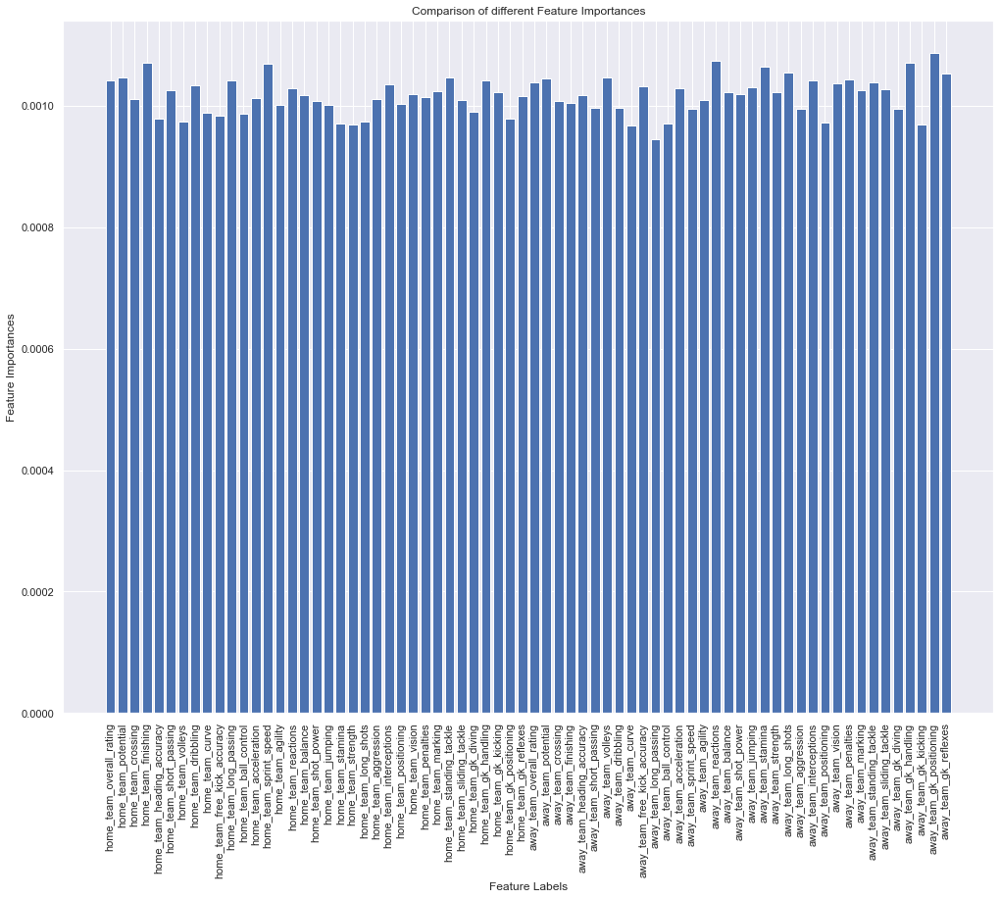

In [267]:
def prepare_features(df):
    cols_to_exclude = ['home_team_attributes', 'away_team_attributes', 'match_api_id', 'MatchResult']
    X = df.loc[:, ~df.columns.isin(cols_to_exclude)].values
    feature_names = df.loc[:, ~df.columns.isin(cols_to_exclude)].columns
    y = df['MatchResult'].values
    extra_tree_forest = ExtraTreesClassifier(n_estimators = 500,
                                            criterion ='entropy', max_features = 2)

    # Training the model
    extra_tree_forest.fit(X, y)

    # Computing the importance of each feature
    feature_importance = extra_tree_forest.feature_importances_

    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in 
                                            extra_tree_forest.estimators_],
                                            axis = 0)
    # Plotting a Bar Graph to compare the models
    plt.figure(figsize=(17,13))
    plt.xticks(range(len(feature_names)), feature_names, rotation='vertical')
    plt.bar(feature_names, feature_importance_normalized)
    plt.xlabel('Feature Labels')
    plt.ylabel('Feature Importances')
    plt.title('Comparison of different Feature Importances')
    plt.show()
    feature_importance_dict = dict(zip(feature_names.tolist(), feature_importance_normalized.tolist()))
    return feature_importance_dict

feature_importance_dict = prepare_features(df_data_to_use) 

In [268]:
from operator import itemgetter
from collections import OrderedDict

sorted_features = OrderedDict(sorted(feature_importance_dict.items(), key=itemgetter(1)))

### Feature Selection

In [269]:
feature_selection_list = list(sorted_features)
print(feature_selection_list)

['away_team_long_passing', 'away_team_curve', 'away_team_gk_kicking', 'home_team_strength', 'home_team_stamina', 'away_team_ball_control', 'away_team_positioning', 'home_team_volleys', 'home_team_long_shots', 'home_team_gk_positioning', 'home_team_heading_accuracy', 'home_team_free_kick_accuracy', 'home_team_ball_control', 'home_team_curve', 'home_team_gk_diving', 'away_team_sprint_speed', 'away_team_gk_diving', 'away_team_aggression', 'away_team_short_passing', 'away_team_dribbling', 'home_team_jumping', 'home_team_agility', 'home_team_positioning', 'away_team_finishing', 'away_team_crossing', 'home_team_shot_power', 'away_team_agility', 'home_team_sliding_tackle', 'home_team_aggression', 'home_team_crossing', 'home_team_acceleration', 'home_team_penalties', 'home_team_gk_reflexes', 'away_team_heading_accuracy', 'home_team_balance', 'away_team_shot_power', 'home_team_vision', 'away_team_balance', 'home_team_gk_kicking', 'away_team_strength', 'home_team_marking', 'away_team_marking', '

In [96]:
df_master_player_data_position = pd.read_excel('masterplayerdata.xlsx')
df_master_player_data_position.dropna(inplace=True)
position_mapping = pd.Series(df_master_player_data_position.position.values,index=df_master_player_data_position.player_api_id).to_dict()

In [ ]:
df_master_player_data_position.columns

In [402]:
position_mapping

{39357: 'mid',
 41762: 'gk',
 26028: 'mid',
 24852: 'for',
 30630: 'for',
 101983: 'gk',
 30955: 'for',
 30668: 'mid',
 24217: 'mid',
 26436: 'def',
 27731: 'mid',
 36286: 'gk',
 25930: 'mid',
 24154: 'for',
 30373: 'mid',
 30371: 'mid',
 30612: 'mid',
 33826: 'gk',
 23025: 'mid',
 24635: 'for',
 34418: 'def',
 30340: 'mid',
 32574: 'def',
 33989: 'for',
 34531: 'for',
 41176: 'mid',
 41137: 'mid',
 26215: 'gk',
 23349: 'def',
 24133: 'mid',
 40563: 'mid',
 30633: 'gk',
 26325: 'mid',
 37473: 'mid',
 27719: 'def',
 37322: 'gk',
 32413: 'mid',
 23127: 'mid',
 25524: 'gk',
 27700: 'def',
 30460: 'mid',
 32578: 'mid',
 30727: 'for',
 30723: 'def',
 32749: 'for',
 23984: 'gk',
 27686: 'for',
 32769: 'def',
 30717: 'gk',
 30729: 'for',
 39194: 'mid',
 34530: 'gk',
 43285: 'def',
 39349: 'mid',
 30714: 'for',
 26096: 'mid',
 24503: 'gk',
 26461: 'for',
 23921: 'def',
 34942: 'mid',
 26388: 'mid',
 38824: 'def',
 32961: 'for',
 31214: 'def',
 32572: 'for',
 40735: 'def',
 30626: 'for',
 41136

In [ ]:
df_master_player_data['position'] = df_master_player_data['player_api_id'].apply(lambda x : position_mapping.get(x))

df_master_player_data_2016 = df_master_player_data[df_master_player_data['year'] == 2016 ]

In [ ]:
df_master_player_data_2016.shape

In [195]:
df_master_player_data_2016.head()

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
67515,69.000000,69.000000,75.0,50.000000,60.0,71.0,58.0,72.0,65.0,60.0,...,medium,high,3879.0,Giovanni Pasquale,1982-01-05,71.3232,181.0,1982.0,25.013373,mid
67516,72.166667,72.166667,80.0,65.666667,41.0,77.0,75.0,79.0,84.0,77.0,...,medium,low,5034.0,Joe Cole,1981-11-08,68.3514,161.0,1981.0,24.226260,for
67517,69.000000,69.000000,67.0,22.000000,67.0,64.0,55.0,70.0,52.0,42.0,...,medium,medium,4081.0,Guy Demel,1981-06-13,73.3044,194.0,1981.0,25.380313,mid
67518,74.000000,74.000000,78.0,68.000000,43.0,80.0,69.0,75.0,81.0,80.0,...,medium,medium,3016.0,Emre Belozoglu,1980-09-07,66.3702,159.0,1980.0,25.375009,mid
67519,73.000000,73.000000,71.0,59.000000,68.0,77.0,68.0,66.0,58.0,54.0,...,medium,high,3805.0,Giampiero Pinzi,1981-03-11,70.3326,161.0,1981.0,22.880624,mid


In [196]:
df_final_data_2016 = pd.merge(df_match_melted, df_master_player_data_2016, on=['player_api_id'], how='inner')

In [496]:
df_final_data_2016.columns

Index(['id_x', 'country_id', 'league_id', 'season', 'stage', 'date',
       'match_api_id', 'home_team_api_id', 'away_team_api_id',
       'home_team_goal', 'away_team_goal', 'goal', 'shoton', 'shotoff',
       'foulcommit', 'card', 'cross', 'corner', 'possession', 'MatchResult',
       'HomeTeamShortName', 'AwayTeamShortName', 'MatchYear', 'player_cols',
       'player_api_id', 'overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_positioning', 'gk_reflexes', 'year',
       'player_fifa_api_id', 'preferred_foot', 'attacking_wo

In [ ]:
df_final_data_2016.iloc[0].to_dict()

### Handling Categorical data

In [199]:
max_attack_work_rate = df_final_data_2016['attacking_work_rate'].value_counts().index[0]
df_final_data_2016['attacking_work_rate'].fillna(max_attack_work_rate, inplace=True) 

max_defense_work_rate = df_final_data_2016['defensive_work_rate'].value_counts().index[0]
df_final_data_2016['defensive_work_rate'].fillna(max_defense_work_rate, inplace=True) 

In [200]:
max_position = df_final_data_2016['position'].value_counts().index[0]
df_final_data_2016['position'].fillna(max_position, inplace=True) 

max_preferred_foot = df_final_data_2016['preferred_foot'].value_counts().index[0]
df_final_data_2016['preferred_foot'].fillna(max_preferred_foot, inplace=True) 


In [201]:
df_final_data_2016_copy = df_final_data_2016.copy(deep=True)

### Factorizing Attacking Work Rate and Defensive Work Rate features

In [202]:
label_values_attack, unique_Values = pd.factorize(df_final_data_2016_copy['attacking_work_rate'])
label_values_defense, unique_Values = pd.factorize(df_final_data_2016_copy['defensive_work_rate'])

df_final_data_2016_copy['attacking_work_rate'] = label_values_attack
df_final_data_2016_copy['defensive_work_rate'] = label_values_defense

In [203]:
y = pd.get_dummies(df_final_data_2016_copy.position, prefix='preferred_position')
for col_name in y.columns.tolist():
    df_final_data_2016_copy[col_name] = y[col_name]

In [204]:
y = pd.get_dummies(df_final_data_2016_copy.preferred_foot, prefix='preferred_foot')
for col_name in y.columns.tolist():
    df_final_data_2016_copy[col_name] = y[col_name]

In [205]:
# y = pd.get_dummies(df_final_data_2016_copy.MatchResult, prefix='MatchResult')
# for col_name in y.columns.tolist():
#     df_final_data_2016_copy[col_name] = y[col_name]

In [206]:
# df_final_data_2016_copy.drop(['MatchResult_Defeat', 'MatchResult_Draw', 'MatchResult_Win'], axis=1, inplace=True)
label_values_matchResult, unique_Values = pd.factorize(df_final_data_2016_copy['MatchResult'])
df_final_data_2016_copy['MatchResult'] = label_values_matchResult

### One hot encoding on preferred foot and postion 

In [207]:
df_final_data_2016_copy.columns

Index(['id_x', 'country_id', 'league_id', 'season', 'stage', 'date',
       'match_api_id', 'home_team_api_id', 'away_team_api_id',
       'home_team_goal', 'away_team_goal', 'goal', 'shoton', 'shotoff',
       'foulcommit', 'card', 'cross', 'corner', 'possession', 'MatchResult',
       'HomeTeamShortName', 'AwayTeamShortName', 'MatchYear', 'player_cols',
       'player_api_id', 'overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_positioning', 'gk_reflexes', 'year',
       'player_fifa_api_id', 'preferred_foot', 'attacking_wo

In [ ]:
# df_final_data_2016_copy.isna().sum().to_csv("Isnana.csv")

In [168]:
df_data_to_use.columns

Index(['match_api_id', 'MatchResult', 'home_team_attributes',
       'away_team_attributes', 'home_team_overall_rating',
       'home_team_potential', 'home_team_crossing', 'home_team_finishing',
       'home_team_heading_accuracy', 'home_team_short_passing',
       'home_team_volleys', 'home_team_dribbling', 'home_team_curve',
       'home_team_free_kick_accuracy', 'home_team_long_passing',
       'home_team_ball_control', 'home_team_acceleration',
       'home_team_sprint_speed', 'home_team_agility', 'home_team_reactions',
       'home_team_balance', 'home_team_shot_power', 'home_team_jumping',
       'home_team_stamina', 'home_team_strength', 'home_team_long_shots',
       'home_team_aggression', 'home_team_interceptions',
       'home_team_positioning', 'home_team_vision', 'home_team_penalties',
       'home_team_marking', 'home_team_standing_tackle',
       'home_team_sliding_tackle', 'home_team_gk_diving',
       'home_team_gk_handling', 'home_team_gk_kicking',
       'home_team_

## HYPOTHESIS TESTING 

### Hypothesis Testing-1

#### Null Hypothesis: 
There is no statistical difference in Home Team goals for teams with standing_tackle of greater than or equal to Mean 


#### Alternate Hypothesis:
There is statistical difference in Home Team goals for teams with standing_tackle greater than or equal to Mean 

#### Home Team Match Result % across matches 

In [166]:
df_match_result = pd.DataFrame(df_match_master_data['MatchResult'].value_counts())
df_match_result['Percentage'] = (df_match_result['MatchResult'] / df_match_result['MatchResult'].sum())*100
df_match_result

,MatchResult,Percentage
Win,11550,45.795171
Defeat,7267,28.813291
Draw,6404,25.391539


In [174]:
df_match_goal_data = df_match_master_data[['match_api_id', 'home_team_goal', 'away_team_goal']]
df_data_to_use_hypothesis = pd.merge(df_data_to_use, df_match_goal_data, how='left', on='match_api_id')


Index(['MatchResult', 'Percentage'], dtype='object')

In [200]:
df_data_to_use['home_team_standing_tackle'].describe()

count    24447.000000
mean        54.302523
std          5.375620
min         22.000000
25%         50.548377
50%         54.318182
75%         58.090909
max         78.714286
Name: home_team_standing_tackle, dtype: float64

#### The Mean of home_team_standing_tackle is 54.3. So 2 samples will be created. One with interceptions > 54.3. and the other with <= 54.3.

In [201]:
sample_greater_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_standing_tackle'] > 54.3]
sample_less_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_standing_tackle'] <= 54.3]

In [202]:
sample_less_than_mean.shape

(12216, 76)

In [203]:
sample_greater_than_mean.shape

(12231, 76)

In [204]:
sample_size = 1000
trials = 100

home_team_win_under_mean = []
home_team_win_above_mean = []

np.random.seed(1234)

for _ in range(trials):
    sample_under_mean = np.random.choice(sample_less_than_mean['home_team_goal'], size=sample_size)
    home_team_win_under_mean.append(np.mean(sample_under_mean))
    
    sample_above_mean = np.random.choice(sample_greater_than_mean['home_team_goal'], size=sample_size)
    home_team_win_above_mean.append(np.mean(sample_above_mean))
    

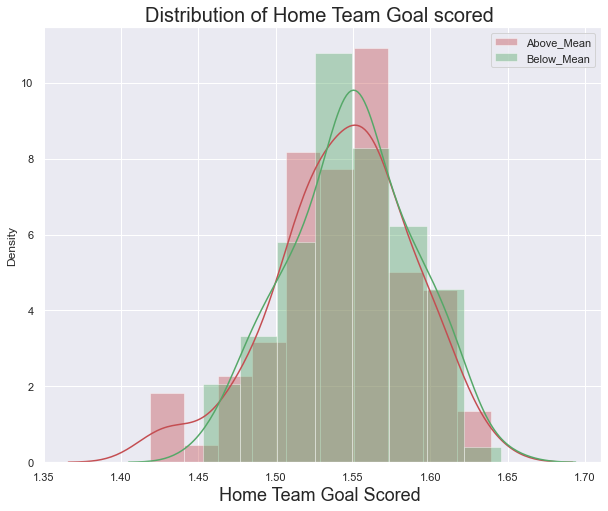

In [205]:
import seaborn as sns
sns.set(color_codes=True)
sns.set(rc={'figure.figsize' : (10,8)})
sns.distplot(home_team_win_above_mean, color='r', kde=True, norm_hist=True, label="Above_Mean")
sns.distplot(home_team_win_under_mean, color='g', kde=True, norm_hist=True, label="Below_Mean")
plt.xlabel("Home Team Goal Scored ", fontsize=18)
plt.title("Distribution of Home Team Goal scored ", fontsize=20)
plt.legend()
plt.show()

In [206]:
# from statsmodels.stats.weightstats import ttest_ind
from scipy import stats

t_stat, p_value = stats.ttest_ind(np.array(home_team_win_above_mean), np.array(home_team_win_under_mean))

print("The calculated t-statistic is {}".format(round(t_stat, 2)))
print("The calculated p-value is {}".format(round(p_value, 2)))

The calculated t-statistic is -0.95
The calculated p-value is 0.35


#### The alpha is set  to 0.05. From test results, the p-value is less than our alpha. We can reject our null hypothesis and with 95% confidence accept our alternative hypothesis.


### Hypothesis Testing-2

#### Null Hypothesis: 
There is no statistical difference in Away Team goals for teams with Stamina of greater than or equal to Mean 


#### Alternate Hypothesis:
There is statistical difference in Away Team goals for teams with Stamina greater than or equal to Mean 

In [189]:
df_data_to_use_hypothesis['away_team_stamina'].describe()

count    24447.000000
mean        69.446481
std          4.379482
min         38.000000
25%         66.551840
50%         69.616450
75%         72.500000
max         84.000000
Name: away_team_stamina, dtype: float64

#### The Mean of home_team_stamina is 69.4. So 2 samples will be created. One with interceptions > 69.4. and the other with <= 69.4.

In [190]:
sample_greater_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['away_team_stamina'] > 69.4]
sample_less_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['away_team_stamina'] <= 69.4]

In [191]:
sample_less_than_mean.shape

(11785, 76)

In [192]:
sample_greater_than_mean.shape

(12662, 76)

In [197]:
sample_size = 1000
trials = 100

away_team_win_under_mean = []
away_team_win_above_mean = []

np.random.seed(1234)

for _ in range(trials):
    sample_under_mean = np.random.choice(sample_less_than_mean['away_team_goal'], size=sample_size)
    away_team_win_under_mean.append(np.mean(sample_under_mean))
    
    sample_above_mean = np.random.choice(sample_greater_than_mean['away_team_goal'], size=sample_size)
    away_team_win_above_mean.append(np.mean(sample_above_mean))
    

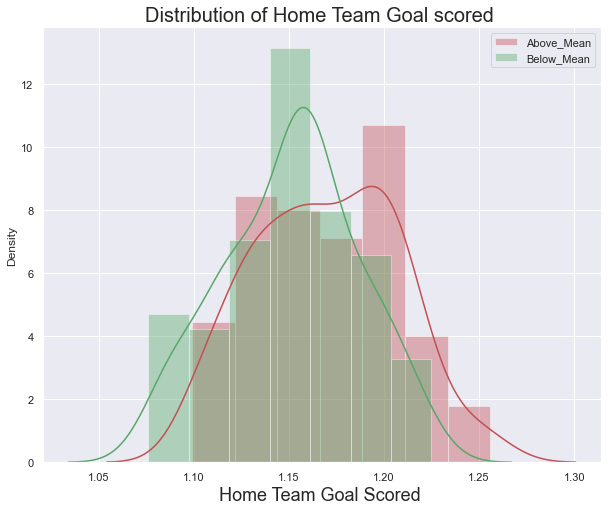

In [198]:
import seaborn as sns
sns.set(color_codes=True)
sns.set(rc={'figure.figsize' : (10,8)})
sns.distplot(away_team_win_above_mean, color='r', kde=True, norm_hist=True, label="Above_Mean")
sns.distplot(away_team_win_under_mean, color='g', kde=True, norm_hist=True, label="Below_Mean")
plt.xlabel("Home Team Goal Scored ", fontsize=18)
plt.title("Distribution of Home Team Goal scored ", fontsize=20)
plt.legend()
plt.show()

In [199]:
# from statsmodels.stats.weightstats import ttest_ind
from scipy import stats

t_stat, p_value = stats.ttest_ind(np.array(away_team_win_above_mean), np.array(away_team_win_under_mean))

print("The calculated t-statistic is {}".format(round(t_stat, 2)))
print("The calculated p-value is {}".format(round(p_value, 2)))

The calculated t-statistic is 3.63
The calculated p-value is 0.0


### Ooopsss...!!!!

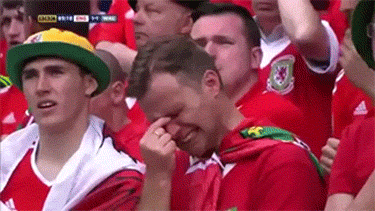

#### The alpha is set  to 0.05. From test results, the p-value is greater than our alpha. We can accept our null hypothesis with 95% confidence and reject our alternative hypothesis.


### Hypothesis Testing-3

#### Null Hypothesis: 
There is no statistical difference in Home Team goals for teams with Goalkeeper diving of greater than or equal to Mean 


#### Alternate Hypothesis:
There is statistical difference in Home Team goals for teams with Goalkeeper diving greater than or equal to Mean 

In [207]:
df_data_to_use_hypothesis['home_team_gk_diving'].describe()


count    24447.000000
mean        15.620914
std          1.980819
min          3.000000
25%         14.797717
50%         15.772727
75%         16.727273
max         40.500000
Name: home_team_gk_diving, dtype: float64

#### The Mean of home_team_gk_diving is 15.6. So 2 samples will be created. One with interceptions > 15.6 and the other with <= 15.6.

In [211]:
sample_greater_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_gk_diving'] > 15.5]
sample_less_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_gk_diving'] <= 15.6]


In [212]:
sample_less_than_mean.shape

(11101, 76)

In [213]:
sample_greater_than_mean.shape

(13990, 76)

In [216]:
sample_size = 1000
trials = 100

home_team_win_under_mean = []
home_team_win_above_mean = []

np.random.seed(1234)

for _ in range(trials):
    sample_under_mean = np.random.choice(sample_less_than_mean['home_team_goal'], size=sample_size)
    home_team_win_under_mean.append(np.mean(sample_under_mean))
    
    sample_above_mean = np.random.choice(sample_greater_than_mean['home_team_goal'], size=sample_size)
    home_team_win_above_mean.append(np.mean(sample_above_mean))

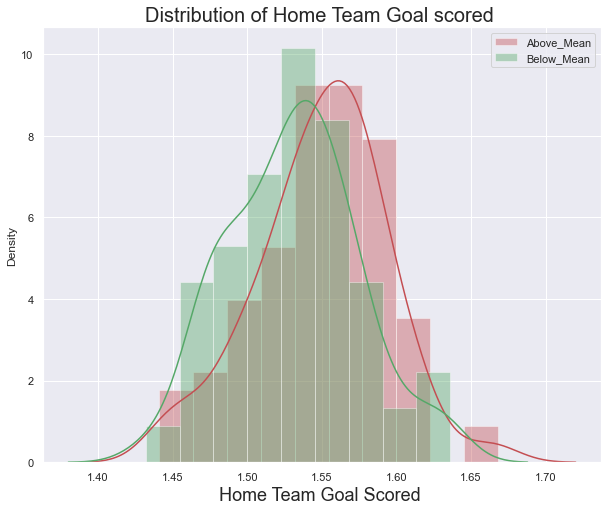

In [217]:
import seaborn as sns
sns.set(color_codes=True)
sns.set(rc={'figure.figsize' : (10,8)})
sns.distplot(home_team_win_above_mean, color='r', kde=True, norm_hist=True, label="Above_Mean")
sns.distplot(home_team_win_under_mean, color='g', kde=True, norm_hist=True, label="Below_Mean")
plt.xlabel("Home Team Goal Scored ", fontsize=18)
plt.title("Distribution of Home Team Goal scored ", fontsize=20)
plt.legend()
plt.show()

In [218]:
# from statsmodels.stats.weightstats import ttest_ind
from scipy import stats

t_stat, p_value = stats.ttest_ind(np.array(home_team_win_above_mean), np.array(home_team_win_under_mean))

print("The calculated t-statistic is {}".format(round(t_stat, 2)))
print("The calculated p-value is {}".format(round(p_value, 2)))

The calculated t-statistic is 3.05
The calculated p-value is 0.0


#### The alpha is set  to 0.05. From test results, the p-value is less than our alpha. We can reject our null hypothesis and with 95% confidence accept our alternative hypothesis.


### Hypothesis Testing-4

#### Null Hypothesis: 
There is no statistical difference in Away Team goals for teams with Long Shots of greater than or equal to Mean 


#### Alternate Hypothesis:
There is statistical difference in Away Team goals for teams with Long Shots greater than or equal to Mean 

In [221]:
df_data_to_use_hypothesis['away_team_long_shots'].describe()

count    24447.000000
mean        53.785250
std          6.476220
min         22.000000
25%         49.727273
50%         53.978030
75%         58.181818
max         74.850000
Name: away_team_long_shots, dtype: float64

#### The Mean of away_team_long_shots is 53.7. So 2 samples will be created. One with interceptions > 53.7 and the other with <= 53.7.

In [225]:
sample_greater_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['away_team_long_shots'] > 53.7]
sample_less_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['away_team_long_shots'] <= 53.7]


In [226]:
sample_less_than_mean.shape

(11785, 76)

In [227]:
sample_greater_than_mean.shape

(12662, 76)

In [228]:
sample_size = 1000
trials = 100

away_team_win_under_mean = []
away_team_win_above_mean = []

np.random.seed(1234)

for _ in range(trials):
    sample_under_mean = np.random.choice(sample_less_than_mean['away_team_goal'], size=sample_size)
    away_team_win_under_mean.append(np.mean(sample_under_mean))
    
    sample_above_mean = np.random.choice(sample_greater_than_mean['away_team_goal'], size=sample_size)
    away_team_win_above_mean.append(np.mean(sample_above_mean))

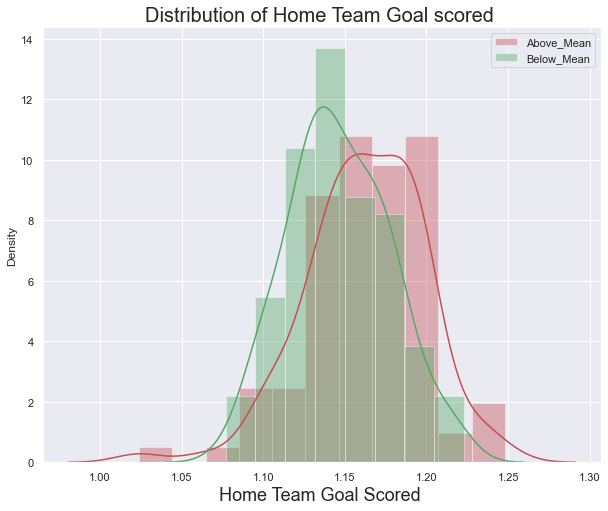

In [229]:
import seaborn as sns
sns.set(color_codes=True)
sns.set(rc={'figure.figsize' : (10,8)})
sns.distplot(away_team_win_above_mean, color='r', kde=True, norm_hist=True, label="Above_Mean")
sns.distplot(away_team_win_under_mean, color='g', kde=True, norm_hist=True, label="Below_Mean")
plt.xlabel("Home Team Goal Scored ", fontsize=18)
plt.title("Distribution of Home Team Goal scored ", fontsize=20)
plt.legend()
plt.show()

In [230]:
# from statsmodels.stats.weightstats import ttest_ind
from scipy import stats

t_stat, p_value = stats.ttest_ind(np.array(away_team_win_above_mean), np.array(away_team_win_under_mean))

print("The calculated t-statistic is {}".format(round(t_stat, 2)))
print("The calculated p-value is {}".format(round(p_value, 2)))

The calculated t-statistic is 3.3
The calculated p-value is 0.0


The alpha is set to 0.05. From test results, the p-value is less than our alpha. We can reject our null hypothesis and with 95% confidence accept our alternative hypothesis.

### Hypothesis Testing-5
#### Null Hypothesis: There is no statistical difference in Home Team goals for teams with Ball Control of greater than or equal to Mean

#### Alternate Hypothesis: There is statistical difference in Home Team goals for teams with Ball Control greater than or equal to Mean

In [232]:
df_data_to_use_hypothesis['home_team_ball_control'].describe()

count    24447.000000
mean        64.761292
std          5.768577
min         30.666667
25%         61.100000
50%         65.218571
75%         68.681818
max         85.398333
Name: home_team_ball_control, dtype: float64

#### The Mean of home_team_ball_control is 64.7. So 2 samples will be created. One with interceptions > 64.7 and the other with <= 64.7.

In [233]:
sample_greater_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_ball_control'] > 64.7]
sample_less_than_mean = df_data_to_use_hypothesis[df_data_to_use_hypothesis['home_team_ball_control'] <= 64.7]


In [234]:
sample_less_than_mean.shape

(11370, 76)

In [235]:
sample_greater_than_mean.shape

(13077, 76)

In [236]:
sample_size = 1000
trials = 100

home_team_win_under_mean = []
home_team_win_above_mean = []

np.random.seed(1234)

for _ in range(trials):
    sample_under_mean = np.random.choice(sample_less_than_mean['home_team_ball_control'], size=sample_size)
    home_team_win_under_mean.append(np.mean(sample_under_mean))
    
    sample_above_mean = np.random.choice(sample_greater_than_mean['home_team_ball_control'], size=sample_size)
    home_team_win_above_mean.append(np.mean(sample_above_mean))

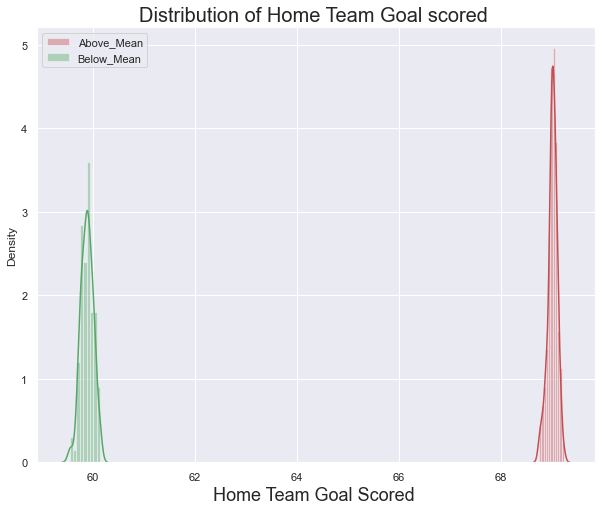

In [237]:
import seaborn as sns
sns.set(color_codes=True)
sns.set(rc={'figure.figsize' : (10,8)})
sns.distplot(home_team_win_above_mean, color='r', kde=True, norm_hist=True, label="Above_Mean")
sns.distplot(home_team_win_under_mean, color='g', kde=True, norm_hist=True, label="Below_Mean")
plt.xlabel("Home Team Goal Scored ", fontsize=18)
plt.title("Distribution of Home Team Goal scored ", fontsize=20)
plt.legend()
plt.show()

In [238]:
# from statsmodels.stats.weightstats import ttest_ind
from scipy import stats

t_stat, p_value = stats.ttest_ind(np.array(home_team_win_above_mean), np.array(home_team_win_under_mean))

print("The calculated t-statistic is {}".format(round(t_stat, 2)))
print("The calculated p-value is {}".format(round(p_value, 2)))

The calculated t-statistic is 601.25
The calculated p-value is 0.0


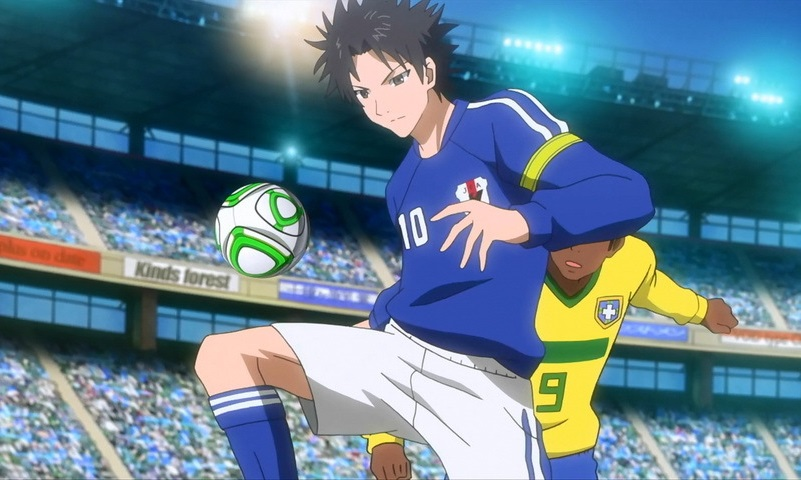

### Build ML Model   

In [274]:
import pickle
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.feature_selection import RFE
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.metrics import r2_score


In [240]:
df_data_to_use_hypothesis.columns

Index(['match_api_id', 'MatchResult', 'home_team_attributes',
       'away_team_attributes', 'home_team_overall_rating',
       'home_team_potential', 'home_team_crossing', 'home_team_finishing',
       'home_team_heading_accuracy', 'home_team_short_passing',
       'home_team_volleys', 'home_team_dribbling', 'home_team_curve',
       'home_team_free_kick_accuracy', 'home_team_long_passing',
       'home_team_ball_control', 'home_team_acceleration',
       'home_team_sprint_speed', 'home_team_agility', 'home_team_reactions',
       'home_team_balance', 'home_team_shot_power', 'home_team_jumping',
       'home_team_stamina', 'home_team_strength', 'home_team_long_shots',
       'home_team_aggression', 'home_team_interceptions',
       'home_team_positioning', 'home_team_vision', 'home_team_penalties',
       'home_team_marking', 'home_team_standing_tackle',
       'home_team_sliding_tackle', 'home_team_gk_diving',
       'home_team_gk_handling', 'home_team_gk_kicking',
       'home_team_

In [242]:
df_data_to_use_hypothesis

,match_api_id,MatchResult,home_team_attributes,away_team_attributes,home_team_overall_rating,home_team_potential,home_team_crossing,home_team_finishing,home_team_heading_accuracy,home_team_short_passing,...,away_team_marking,away_team_standing_tackle,away_team_sliding_tackle,away_team_gk_diving,away_team_gk_handling,away_team_gk_kicking,away_team_gk_positioning,away_team_gk_reflexes,home_team_goal,away_team_goal
0,493016,0,"{'overall_rating': 64.0, 'potential': 67.75, '...","{'overall_rating': 70.4090909090909, 'potentia...",67.863636,72.318182,57.181818,47.818182,61.636364,60.272727,...,50.090909,54.863636,51.454545,11.272727,25.090909,58.863636,25.181818,25.318182,1,1
1,493017,1,"{'overall_rating': 61.8, 'potential': 66.85, '...","{'overall_rating': 66.04545454545455, 'potenti...",63.200000,68.450000,50.800000,48.200000,51.450000,54.100000,...,41.900000,43.900000,48.222222,12.650000,25.200000,56.450000,24.800000,25.300000,2,1
2,493018,1,"{'overall_rating': 64.5, 'potential': 71.08333...","{'overall_rating': 62.8, 'potential': 69.1, 'c...",63.650000,69.800000,51.550000,41.250000,54.200000,59.600000,...,46.000000,50.100000,38.000000,10.500000,25.900000,53.450000,26.200000,26.000000,3,0
3,493019,1,"{'overall_rating': 72.45, 'potential': 77.55, ...","{'overall_rating': 65.72727272727273, 'potenti...",68.409091,75.000000,57.363636,52.272727,63.681818,63.500000,...,43.800000,48.900000,41.875000,15.800000,25.500000,49.400000,24.800000,25.400000,4,0
4,493020,2,"{'overall_rating': 66.9, 'potential': 69.3, 'c...","{'overall_rating': 69.9, 'potential': 73.75, '...",69.950000,75.550000,53.600000,48.250000,63.600000,63.350000,...,45.727273,51.000000,50.636364,12.000000,26.090909,55.318182,26.000000,26.363636,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24442,1147516,2,"{'overall_rating': 64.5, 'potential': 70.45, '...","{'overall_rating': 72.36363636363636, 'potenti...",60.786797,66.673701,50.907468,44.317641,52.051407,55.791667,...,40.600649,48.274892,44.755952,14.464286,15.327922,13.691558,14.418831,15.737013,1,5
24443,1147517,1,"{'overall_rating': 68.81818181818181, 'potenti...","{'overall_rating': 60.45454545454545, 'potenti...",59.147727,62.920455,51.571970,44.549242,52.625000,56.882576,...,45.500758,48.288636,45.328030,14.912879,14.621970,14.312879,14.003788,14.185606,6,3
24444,1147518,1,"{'overall_rating': 64.18181818181819, 'potenti...","{'overall_rating': 59.90909090909091, 'potenti...",66.269776,71.624046,53.830657,48.401712,57.205982,60.751771,...,46.217001,49.474577,49.570464,14.048603,15.230421,15.757694,15.903148,14.975876,3,2
24445,1147520,0,"{'overall_rating': 63.09090909090909, 'potenti...","{'overall_rating': 68.22727272727273, 'potenti...",60.541667,66.016667,43.491667,39.713889,48.858333,57.675000,...,44.789702,49.191775,44.661013,13.902650,13.968766,16.373724,13.018352,14.299344,2,2


In [244]:
for col_name in df_data_to_use_hypothesis.columns.tolist():
    if col_name not in ['match_api_id', 'MatchResult', 'home_team_attributes' , 'away_team_attributes']:
        print(col_name + " Skew value : " + str(df_data_to_use_hypothesis[col_name].skew()))

home_team_overall_rating Skew value : -0.17616712633945758
home_team_potential Skew value : -0.21605075263050771
home_team_crossing Skew value : -0.19304429457016245
home_team_finishing Skew value : -0.17611483135319878
home_team_heading_accuracy Skew value : -0.2844020438945626
home_team_short_passing Skew value : -0.2578254425555801
home_team_volleys Skew value : -0.046899547875208086
home_team_dribbling Skew value : -0.18906618672492415
home_team_curve Skew value : -0.0876112695762086
home_team_free_kick_accuracy Skew value : -0.2015501203197267
home_team_long_passing Skew value : -0.11477039816639328
home_team_ball_control Skew value : -0.3548751942366289
home_team_acceleration Skew value : -0.2631096161601576
home_team_sprint_speed Skew value : -0.3265649386098214
home_team_agility Skew value : -0.47315212146087193
home_team_reactions Skew value : -0.22436203354048231
home_team_balance Skew value : 0.0261309257387699
home_team_shot_power Skew value : -0.5870008713363435
home_team_

In [245]:
df_data_to_use_hypothesis.columns

Index(['match_api_id', 'MatchResult', 'home_team_attributes',
       'away_team_attributes', 'home_team_overall_rating',
       'home_team_potential', 'home_team_crossing', 'home_team_finishing',
       'home_team_heading_accuracy', 'home_team_short_passing',
       'home_team_volleys', 'home_team_dribbling', 'home_team_curve',
       'home_team_free_kick_accuracy', 'home_team_long_passing',
       'home_team_ball_control', 'home_team_acceleration',
       'home_team_sprint_speed', 'home_team_agility', 'home_team_reactions',
       'home_team_balance', 'home_team_shot_power', 'home_team_jumping',
       'home_team_stamina', 'home_team_strength', 'home_team_long_shots',
       'home_team_aggression', 'home_team_interceptions',
       'home_team_positioning', 'home_team_vision', 'home_team_penalties',
       'home_team_marking', 'home_team_standing_tackle',
       'home_team_sliding_tackle', 'home_team_gk_diving',
       'home_team_gk_handling', 'home_team_gk_kicking',
       'home_team_

In [247]:
cols_to_exclude = ['match_api_id', 'MatchResult', 'home_team_attributes' , 'away_team_attributes']

df_master_data_to_use_ml = df_data_to_use_hypothesis.loc[:, ~df_data_to_use_hypothesis.columns.isin(cols_to_exclude)]


In [248]:
features_to_include = ['home_team_stamina', 'home_team_positioning', 'away_team_marking', 'home_team_potential', 'home_team_ball_control', 'away_team_long_shots', 'home_team_gk_diving', 'home_team_standing_tackle', 'away_team_stamina', 'home_team_strength' ]

In [250]:
X = df_master_data_to_use_ml.loc[:, df_master_data_to_use_ml.columns.isin(features_to_include)].values
y = df_data_to_use_hypothesis.MatchResult.values

In [252]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#scaling features
scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

#creating models variable to iterate through each model and print result
classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025, probability=True),
    SVC(gamma=2, C=1, probability=True),
    QuadraticDiscriminantAnalysis()]

names = ["Nearest Neighbors","Linear SVM", "RBF SVM", "QDA"]

In [261]:
for name, clf in zip(names, classifiers):
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)
    y_pred = clf.predict(X_test)
    

    # prediction_proba = clf.predict_proba(X_test)
    # logloss = log_loss(y_test,prediction_proba)
    # precision, recall, fscore, support = score(y_test, prediction)
    # conf_martrix = confusion_matrix(y_test, prediction)
    # clas_report = classification_report(y_test, prediction)

    print(name, accuracy)
    print(name, "R2-score : " , r2_score(y_test, y_pred))

Nearest Neighbors 0.3572597137014315
Nearest Neighbors R2-score :  -1.0609143192216473
Linear SVM 0.4668711656441718
Linear SVM R2-score :  -0.000708442952288113
RBF SVM 0.4668711656441718
RBF SVM R2-score :  -0.000708442952288113
QDA 0.4658486707566462
QDA R2-score :  -0.0026277149947742107


In [ ]:
y_test

In [254]:
from sklearn.decomposition import PCA

pca = PCA(n_components=0.95)
principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents)

principalDf

,f1,f2,f3,f4,f5
0,-6.643510,2.758116,5.917930,1.185226,8.179303
1,14.348612,5.240991,4.977449,-3.586544,4.092078
2,10.539824,0.875708,4.730389,-2.127615,3.663232
3,2.283903,10.452231,1.113719,-2.355694,4.178538
4,-1.945727,4.583074,-1.727520,-1.206272,8.393406
...,...,...,...,...,...
24442,22.562537,5.871377,4.630794,-4.378288,0.123087
24443,18.211085,-0.081140,2.422282,-1.066277,0.957885
24444,6.731973,-0.232594,5.527870,-3.102939,1.068123
24445,18.641718,5.196560,2.833265,1.078260,0.351374


In [255]:
X_train, X_test, y_train, y_test = train_test_split(principalDf, y, test_size = 0.2)
scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

for name, clf in zip(names, classifiers):
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)

    # prediction_proba = clf.predict_proba(X_test)
    # logloss = log_loss(y_test,prediction_proba)
    # precision, recall, fscore, support = score(y_test, prediction)
    # conf_martrix = confusion_matrix(y_test, prediction)
    # clas_report = classification_report(y_test, prediction)

    print(name, accuracy)

Nearest Neighbors 0.35132924335378324
Linear SVM 0.465439672801636
RBF SVM 0.465439672801636
QDA 0.4652351738241309


In [280]:
X = df_master_data_to_use_ml.values
y = df_data_to_use_hypothesis.MatchResult.values

# from sklearn.decomposition import PCA

# pca = PCA(n_components=0.95)
# principalComponents = pca.fit_transform(X)

# X = pd.DataFrame(data=principalComponents).values



X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

#scaling features
scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

#creating models variable to iterate through each model and print result
classifiers = [
#     KNeighborsClassifier(3),
#     SVC(kernel="linear", C=0.025, probability=True),
#     SVC(gamma=2, C=1, probability=True),
#     SVC(gamma=2, C=1),
    DecisionTreeClassifier(),
    RandomForestClassifier(n_estimators=200),
    QuadraticDiscriminantAnalysis()]

# names = ["Nearest Neighbors","Linear SVM", "RBF SVM", "QDA"]
names = [ "DecisionTree", "RandomForest", "QDA"]

In [281]:

for name, clf in zip(names, classifiers):
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)

    # prediction_proba = clf.predict_proba(X_test)
    # logloss = log_loss(y_test,prediction_proba)
    # precision, recall, fscore, support = score(y_test, prediction)
    # conf_martrix = confusion_matrix(y_test, prediction)
    # clas_report = classification_report(y_test, prediction)

    print(name, accuracy)

DecisionTree 0.3439672801635992
RandomForest 0.4568507157464213
QDA 0.43558282208588955


In [273]:
print(X.shape)

(24447, 28)


### Hyperparameter Tuning using GridSearchCV

In [263]:
param_grid_lr = {
    'max_iter': [20, 50, 100, 200, 500, 1000],                      
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],   
    'class_weight': ['balanced']                                    
}

In [264]:
logModel_grid = GridSearchCV(estimator=LogisticRegression(random_state=1234), param_grid=param_grid_lr, verbose=1, cv=10, n_jobs=-1)
logModel_grid.fit(X_train, y_train)


Fitting 10 folds for each of 30 candidates, totalling 300 fits


GridSearchCV(cv=10, estimator=LogisticRegression(random_state=1234), n_jobs=-1,
             param_grid={'class_weight': ['balanced'],
                         'max_iter': [20, 50, 100, 200, 500, 1000],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga']},
             verbose=1)

LogisticRegression(class_weight='balanced', max_iter=20, random_state=1234,
                   solver='liblinear')

In [265]:
accuracy = logModel_grid.score(X_test, y_test)


In [266]:
print(accuracy)

0.465439672801636


In [417]:
# from mlxtend.evaluate import bias_variance_decomp
# mse, bias, var = bias_variance_decomp(LogisticRegression(), X_train, y_train, X_test, y_test, loss='mse', num_rounds=200, random_seed=123)


In [419]:
# print('MSE from bias_variance lib [avg expected loss]: %.3f' % mse)
# print('Avg Bias: %.3f' % bias)
# print('Avg Variance: %.3f' % var)


In [423]:
from sklearn.ensemble import VotingClassifier
model1 = LogisticRegression(random_state=1)
model2 = DecisionTreeClassifier(random_state=1)
model3 = RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1)
model4 = SVC(kernel="linear", C=0.025, probability=True)
model = VotingClassifier(estimators=[('lr', model1), ('dt', model2), ('rf', model3),
                                    ('LinearSVM', model4)], voting='hard')
model.fit(X_train,y_train)
model.score(X_test,y_test)

0.41725601131541723

In [424]:
# PCA 

In [438]:
from sklearn.decomposition import PCA

pca = PCA(n_components=8)
principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents, columns = ['f1', 'f2', 'f3', 'f4', 'f5', 'f6', 'f7', 'f8'])


In [439]:
principalDf

,f1,f2,f3,f4,f5,f6,f7,f8
0,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695
1,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695
2,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695
3,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695
4,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695
...,...,...,...,...,...,...,...,...
3530,10.643213,82.329810,-27.080883,48.622468,18.439097,11.672103,6.289466,21.261568
3531,-1.210163,37.415417,44.972331,7.296856,16.198994,-2.876032,-13.500889,9.499974
3532,-23.836921,71.031308,13.370129,26.378951,-9.140130,-13.977270,-12.455216,-8.552605
3533,-2.896447,64.968497,-29.483327,22.980271,46.086407,10.364468,-4.937563,5.686207


In [440]:
finalDf = pd.concat([principalDf, df_final.MatchResult], axis = 1)

In [441]:
finalDf

,f1,f2,f3,f4,f5,f6,f7,f8,MatchResult
0,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695,0
1,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695,1
2,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695,2
3,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695,0
4,245.417798,46.946710,-4.928256,-25.904399,-1.673290,12.651839,-9.475183,-9.898695,1
...,...,...,...,...,...,...,...,...,...
3530,10.643213,82.329810,-27.080883,48.622468,18.439097,11.672103,6.289466,21.261568,2
3531,-1.210163,37.415417,44.972331,7.296856,16.198994,-2.876032,-13.500889,9.499974,0
3532,-23.836921,71.031308,13.370129,26.378951,-9.140130,-13.977270,-12.455216,-8.552605,1
3533,-2.896447,64.968497,-29.483327,22.980271,46.086407,10.364468,-4.937563,5.686207,0


In [442]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)
scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)


In [ ]:
for name, clf in zip(names, classifiers):
        clf.fit(X_train, y_train)
        accuracy = clf.score(X_test, y_test)

        # prediction_proba = clf.predict_proba(X_test)
        # logloss = log_loss(y_test,prediction_proba)
        # precision, recall, fscore, support = score(y_test, prediction)
        # conf_martrix = confusion_matrix(y_test, prediction)
        # clas_report = classification_report(y_test, prediction)

        print(name, accuracy)

In [487]:
from sklearn.decomposition import PCA
X = df_multiple_feature_data_2016_features.values 
pca = PCA(n_components=5)
principalComponents = pca.fit_transform(X)

principalDf = pd.DataFrame(data = principalComponents, columns = ['f1', 'f2', 'f3', 'f4', 'f5'])

In [488]:
principalDf

,f1,f2,f3,f4,f5
0,245.418157,46.946126,-4.927646,-25.904407,-1.681754
1,245.417570,46.945558,-4.928357,-25.904351,-1.684877
2,245.417965,46.945443,-4.927702,-25.904149,-1.682322
3,245.417955,46.946925,-4.928245,-25.904868,-1.683741
4,245.417368,46.946357,-4.928956,-25.904812,-1.686864
...,...,...,...,...,...
3530,10.643204,82.329375,-27.080737,48.622501,18.438557
3531,-1.209596,37.417047,44.972823,7.295255,16.200520
3532,-23.837920,71.031914,13.368050,26.379353,-9.153007
3533,-2.896069,64.969436,-29.483126,22.980669,46.091628


In [489]:
finalDf = pd.concat([principalDf, df_final.MatchResult], axis = 1)

In [490]:
finalDf

,f1,f2,f3,f4,f5,MatchResult
0,245.418157,46.946126,-4.927646,-25.904407,-1.681754,0
1,245.417570,46.945558,-4.928357,-25.904351,-1.684877,1
2,245.417965,46.945443,-4.927702,-25.904149,-1.682322,2
3,245.417955,46.946925,-4.928245,-25.904868,-1.683741,0
4,245.417368,46.946357,-4.928956,-25.904812,-1.686864,1
...,...,...,...,...,...,...
3530,10.643204,82.329375,-27.080737,48.622501,18.438557,2
3531,-1.209596,37.417047,44.972823,7.295255,16.200520,0
3532,-23.837920,71.031914,13.368050,26.379353,-9.153007,1
3533,-2.896069,64.969436,-29.483126,22.980669,46.091628,0


In [491]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)
scaler = MinMaxScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

In [492]:
for name, clf in zip(names, classifiers):
        clf.fit(X_train, y_train)
        accuracy = clf.score(X_test, y_test)

        # prediction_proba = clf.predict_proba(X_test)
        # logloss = log_loss(y_test,prediction_proba)
        # precision, recall, fscore, support = score(y_test, prediction)
        # conf_martrix = confusion_matrix(y_test, prediction)
        # clas_report = classification_report(y_test, prediction)

        print(name, accuracy)

Nearest Neighbors 0.6011315417256011
Linear SVM 0.6478076379066479
RBF SVM 0.71004243281471
QDA 0.7142857142857143


# Strategy 

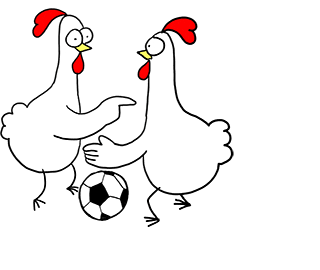

##### select top players with attributes 'away_team_stamina' column 

In [343]:
name_mapping = pd.Series(df_team.team_long_name.values,index=df_team.team_short_name.values).to_dict()

In [344]:
name_mapping

{'GEN': 'Genoa',
 'BAC': 'Beerschot AC',
 'ZUL': 'SV Zulte-Waregem',
 'LOK': 'Sporting Lokeren',
 'CEB': 'KSV Cercle Brugge',
 'AND': 'RSC Anderlecht',
 'MON': 'Montpellier Hérault SC',
 'STL': 'Standard de Liège',
 'MEC': 'KV Mechelen',
 'CLB': 'Club Brugge KV',
 'ROS': 'Ross County FC',
 'KOR': 'KV Kortrijk',
 'MOU': 'Royal Excel Mouscron',
 'WES': 'KVC Westerlo',
 'CHA': 'Sporting Charleroi',
 'STT': 'Sint-Truidense VV',
 'LIE': 'Lierse SK',
 'EUP': 'KAS Eupen',
 'O-H': 'Oud-Heverlee Leuven',
 'WAA': 'Waasland-Beveren',
 'OOS': 'KV Oostende',
 'MOP': 'Royal Excel Mouscron',
 'MUN': 'Manchester United',
 'NEW': 'Newcastle United',
 'ARS': 'Arsenal',
 'WBA': 'West Bromwich Albion',
 'SUN': 'Sunderland',
 'LIV': 'Livorno',
 'WHU': 'West Ham United',
 'WIG': 'Wigan Athletic',
 'AVL': 'Aston Villa',
 'MCI': 'Manchester City',
 'EVE': 'Everton',
 'BLB': 'Blackburn Rovers',
 'MID': 'Middlesbrough',
 'TOT': 'Tottenham Hotspur',
 'BOL': 'Bologna',
 'STK': 'Stoke City',
 'HUL': 'Hull City',
 

In [323]:
df_match_master_data.head()

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,BSH,BSD,BSA,MatchResult,HomeTeamShortName,AwayTeamShortName,Matchyear,home_team_attributes,away_team_attributes,target
4768,4769,4769,4769,2008/2009,1,2008-08-09,483129,8583,9830,2,...,2.00,2.88,3.75,Win,AUX,NAN,2008,"{'overall_rating': 68.95454545454545, 'potenti...","{'overall_rating': 71.1, 'potential': 75.2, 'c...",1
4769,4770,4769,4769,2008/2009,1,2008-08-09,483130,9827,7819,2,...,1.50,3.50,6.50,Win,BOR,CAE,2008,"{'overall_rating': 77.27272727272727, 'potenti...","{'overall_rating': 70.0909090909091, 'potentia...",1
4770,4771,4769,4769,2008/2009,1,2008-08-09,483131,9746,9831,1,...,2.38,2.88,2.88,Win,LEH,NIC,2008,"{'overall_rating': 66.13636363636364, 'potenti...","{'overall_rating': 67.77272727272727, 'potenti...",1
4771,4772,4769,4769,2008/2009,1,2008-08-09,483132,8682,8689,0,...,1.91,3.00,4.00,Defeat,LEM,LOR,2008,"{'overall_rating': 69.66666666666667, 'potenti...","{'overall_rating': 67.2, 'potential': 73.8, 'c...",-1
4772,4773,4769,4769,2008/2009,1,2008-08-10,483133,9748,9941,3,...,1.30,4.33,9.00,Win,LYO,TOU,2008,"{'overall_rating': 79.18181818181819, 'potenti...","{'overall_rating': 69.27272727272727, 'potenti...",1


In [404]:

df_master_player_data['position'] = df_master_player_data['player_api_id'].apply(lambda x : position_mapping.get(x))

##### Looking at only defense players

In [405]:
df_master_player_data.columns.tolist()

['overall_rating',
 'potential',
 'crossing',
 'finishing',
 'heading_accuracy',
 'short_passing',
 'volleys',
 'dribbling',
 'curve',
 'free_kick_accuracy',
 'long_passing',
 'ball_control',
 'acceleration',
 'sprint_speed',
 'agility',
 'reactions',
 'balance',
 'shot_power',
 'jumping',
 'stamina',
 'strength',
 'long_shots',
 'aggression',
 'interceptions',
 'positioning',
 'vision',
 'penalties',
 'marking',
 'standing_tackle',
 'sliding_tackle',
 'gk_diving',
 'gk_handling',
 'gk_kicking',
 'gk_positioning',
 'gk_reflexes',
 'year',
 'player_fifa_api_id',
 'player_api_id',
 'preferred_foot',
 'attacking_work_rate',
 'defensive_work_rate',
 'id',
 'player_name',
 'birthday',
 'height',
 'weight',
 'birth_year',
 'BMI',
 'position']

In [407]:
# stamina, interceptions, BMI, standingTackle, positioning, crossing

df_defense = df_master_player_data.sort_values(by=['stamina', 'interceptions', 'BMI', 'standing_tackle', 'positioning', 'crossing'],
                                 ascending=[False, False, False, False, False, False])

In [408]:
df_defense.columns

Index(['overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle', 'gk_diving', 'gk_handling',
       'gk_kicking', 'gk_positioning', 'gk_reflexes', 'year',
       'player_fifa_api_id', 'player_api_id', 'preferred_foot',
       'attacking_work_rate', 'defensive_work_rate', 'id', 'player_name',
       'birthday', 'height', 'weight', 'birth_year', 'BMI', 'position'],
      dtype='object')

In [337]:
cols = ['home_player_1',
 'home_player_2',
 'home_player_3',
 'home_player_4',
 'home_player_5',
 'home_player_6',
 'home_player_7',
 'home_player_8',
 'home_player_9',
 'home_player_10',
 'home_player_11',
 'away_player_1',
 'away_player_2',
 'away_player_3',
 'away_player_4',
 'away_player_5', 'away_player_6', 'away_player_7', 'away_player_8', 'away_player_9', 'away_player_10', 'away_player_11']
player_mapping = {}
for index, rows in df_match_master_data.iterrows():
    player_mapping[rows['HomeTeamShortName']] = []
    temp_player = []
    for col_name in cols:
        temp_player.append(rows[col_name])
        
    player_mapping[rows['HomeTeamShortName']] = player_mapping[rows['HomeTeamShortName']] + temp_player
    print(player_mapping.keys())

dict_keys(['AUX'])
dict_keys(['AUX', 'BOR'])
dict_keys(['AUX', 'BOR', 'LEH'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'L

dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', '

dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL', 'LOK', 'CLB', 'BAC', nan, 'ZUL', 'CEB', 'AND', 'KOR', 'GEN', 'WES', 'ROS', 'BMU', 'LEV', 'S04', 'WOL', 'EFR', 'BIE', 'COT', 'GLA', 'KAR', 'DOR', 'STU', 'WBR', 'HBE', 'FCK', 'BOC', 'HAN', 'HOF'])
dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL',

dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL', 'LOK', 'CLB', 'BAC', nan, 'ZUL', 'CEB', 'AND', 'KOR', 'GEN', 'WES', 'ROS', 'BMU', 'LEV', 'S04', 'WOL', 'EFR', 'BIE', 'COT', 'GLA', 'KAR', 'DOR', 'STU', 'WBR', 'HBE', 'FCK', 'BOC', 'HAN', 'HOF', 'GOR', 'PIG', 'LGD', 'BEL', 'ODR', 'CHO', 'CKR', 'POZ', 'LEG', 'LOD', 'WIS', 'SLA', 'POB', 'ARK', 'BIA', 'PWA', 'VIT', 'ROD', 'WII', 'NEC', 'UTR', 'HER', 'SPA', 'ALK', 'GUI', 'RA', 'LEI', 'FER', 'BRA', 'NAC', 'BEN', 'SCP', 'ACA', 'NAV', 'SET', 'GRO', 'AJA', 'PSV', 'TWE', 'FEY', 'GRA', 'HEE', 'HAA', 'OSA', 'COR', 'NUM', 'SAN', 'SPG', 'BET', 'ESP', 'BIL', 'AMA', 'VIL', 'REA', 'BAR', 'SEV', 'GET', 'HUE'

dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL', 'LOK', 'CLB', 'BAC', nan, 'ZUL', 'CEB', 'AND', 'KOR', 'GEN', 'WES', 'ROS', 'BMU', 'LEV', 'S04', 'WOL', 'EFR', 'BIE', 'COT', 'GLA', 'KAR', 'DOR', 'STU', 'WBR', 'HBE', 'FCK', 'BOC', 'HAN', 'HOF', 'GOR', 'PIG', 'LGD', 'BEL', 'ODR', 'CHO', 'CKR', 'POZ', 'LEG', 'LOD', 'WIS', 'SLA', 'POB', 'ARK', 'BIA', 'PWA', 'VIT', 'ROD', 'WII', 'NEC', 'UTR', 'HER', 'SPA', 'ALK', 'GUI', 'RA', 'LEI', 'FER', 'BRA', 'NAC', 'BEN', 'SCP', 'ACA', 'NAV', 'SET', 'GRO', 'AJA', 'PSV', 'TWE', 'FEY', 'GRA', 'HEE', 'HAA', 'OSA', 'COR', 'NUM', 'SAN', 'SPG', 'BET', 'ESP', 'BIL', 'AMA', 'VIL', 'REA', 'BAR', 'SEV', 'GET', 'HUE'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL', 'LOK', 'CLB', 'BAC', nan, 'ZUL', 'CEB', 'AND', 'KOR', 'GEN', 'WES', 'ROS', 'BMU', 'LEV', 'S04', 'WOL', 'EFR', 'BIE', 'COT', 'GLA', 'KAR', 'DOR', 'STU', 'WBR', 'HBE', 'FCK', 'BOC', 'HAN', 'HOF', 'GOR', 'PIG', 'LGD', 'BEL', 'ODR', 'CHO', 'CKR', 'POZ', 'LEG', 'LOD', 'WIS', 'SLA', 'POB', 'ARK', 'BIA', 'PWA', 'VIT', 'ROD', 'WII', 'NEC', 'UTR', 'HER', 'SPA', 'ALK', 'GUI', 'RA', 'LEI', 'FER', 'BRA', 'NAC', 'BEN', 'SCP', 'ACA', 'NAV', 'SET', 'GRO', 'AJA', 'PSV', 'TWE', 'FEY', 'GRA', 'HEE', 'HAA', 'OSA', 'COR', 'NUM', 'SAN', 'SPG', 'BET', 'ESP', 'BIL', 'AMA', 'VIL', 'REA', 'BAR', 'SEV', 'GET', 'HUE'

dict_keys(['AUX', 'BOR', 'LEH', 'LEM', 'LYO', 'MON', 'NAN', 'REN', 'SOC', 'VAL', 'CAE', 'GRE', 'LIL', 'LOR', 'MAR', 'NIC', 'PSG', 'ETI', 'TOU', 'AAR', 'MUN', 'ARS', 'SUN', 'WHU', 'AVL', 'EVE', 'MID', 'BOL', 'HUL', 'CHE', 'LIV', 'TOT', 'NEW', 'MCI', 'BLB', 'FUL', 'WBA', 'POR', 'STK', 'WIG', 'FAL', 'HEA', 'KIL', 'ABE', 'CEL', 'HAM', 'RAN', 'DUU', 'MOT', 'HIB', 'INV', 'MIR', 'MOU', 'MEC', 'CHA', 'STL', 'LOK', 'CLB', 'BAC', nan, 'ZUL', 'CEB', 'AND', 'KOR', 'GEN', 'WES', 'ROS', 'BMU', 'LEV', 'S04', 'WOL', 'EFR', 'BIE', 'COT', 'GLA', 'KAR', 'DOR', 'STU', 'WBR', 'HBE', 'FCK', 'BOC', 'HAN', 'HOF', 'GOR', 'PIG', 'LGD', 'BEL', 'ODR', 'CHO', 'CKR', 'POZ', 'LEG', 'LOD', 'WIS', 'SLA', 'POB', 'ARK', 'BIA', 'PWA', 'VIT', 'ROD', 'WII', 'NEC', 'UTR', 'HER', 'SPA', 'ALK', 'GUI', 'RA', 'LEI', 'FER', 'BRA', 'NAC', 'BEN', 'SCP', 'ACA', 'NAV', 'SET', 'GRO', 'AJA', 'PSV', 'TWE', 'FEY', 'GRA', 'HEE', 'HAA', 'OSA', 'COR', 'NUM', 'SAN', 'SPG', 'BET', 'ESP', 'BIL', 'AMA', 'VIL', 'REA', 'BAR', 'SEV', 'GET', 'HUE'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [338]:
df_defense

for key, value in player_mapping.items():
    print(key, value)

AUX [26241.0, 307015.0, 246331.0, 30823.0, 260564.0, 26311.0, 115429.0, 26199.0, 41877.0, 120915.0, 37466.0, 46705.0, 40044.0, 93985.0, 26138.0, 26325.0, 93984.0, 49851.0, 41124.0, 199834.0, 25543.0, 46469.0]
BOR [602493.0, 26154.0, 612747.0, 466308.0, 352833.0, 684978.0, 41174.0, 562688.0, 512740.0, 40707.0, 297579.0, 510569.0, 306128.0, 39965.0, 173952.0, 40537.0, 574633.0, 210128.0, 470539.0, 26155.0, 294859.0, 239259.0]
LEH [41186.0, 46645.0, 26137.0, 24423.0, 165608.0, 103470.0, 46651.0, 46647.0, 46649.0, 26405.0, 26282.0, 34003.0, 26107.0, 77741.0, 40544.0, 26154.0, 26291.0, 26160.0, 26195.0, 32575.0, 107417.0, 27445.0]
LEM [107806.0, 108535.0, 26127.0, 94013.0, 165583.0, 91560.0, 40687.0, 111787.0, 26057.0, 37466.0, 38363.0, 39989.0, 20482.0, 94043.0, 26357.0, 30457.0, 40730.0, 30695.0, 35499.0, 26374.0, 38084.0, 145067.0]
LYO [167035.0, 38994.0, 93985.0, 40740.0, 41360.0, 210119.0, 182923.0, 282472.0, 210120.0, 169193.0, 426880.0, 145550.0, 109651.0, 80562.0, 52133.0, 34304.0, 

### Picking Team  'NEW': 'Newcastle United'


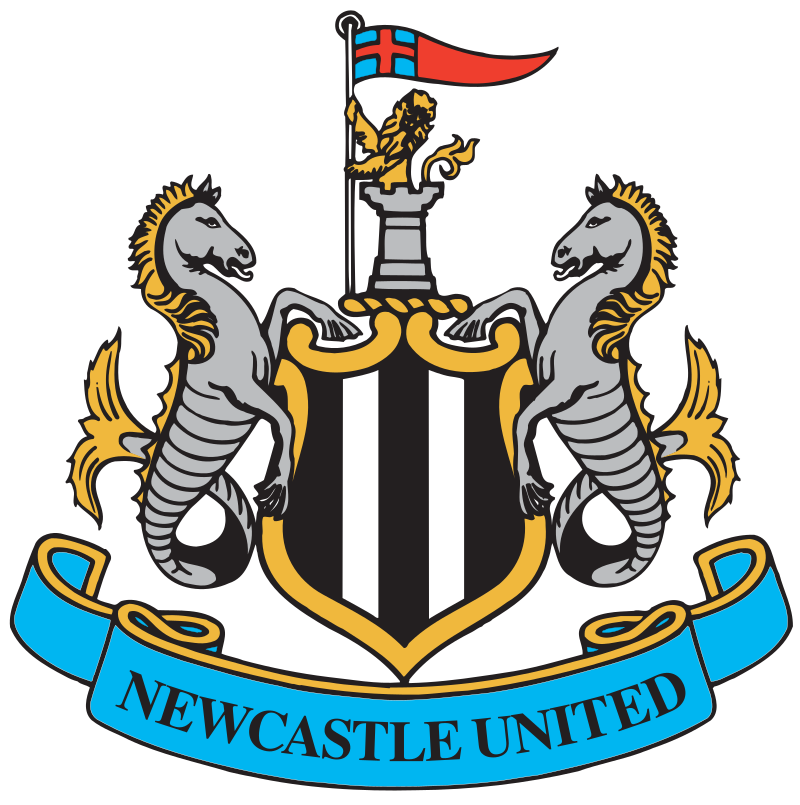

In [367]:
for col_name in ['stamina', 'interceptions', 'BMI', 'standing_tackle', 'positioning', 'crossing']:
    print(col_name, df_defense[col_name].mean())

stamina 65.92538198101535
interceptions 52.082895356936675
BMI 23.561411739746323
standing_tackle 49.46089848154431
positioning 54.43717025477219
crossing 53.2713033673255


In [409]:
df_filter_NEW = df_match_master_data[df_match_master_data['HomeTeamShortName'] == 'NEW']

In [410]:
newcastle_playert_list = list(set(player_mapping['NEW']))

In [420]:
df_defense_new_castle = df_defense[df_defense['player_api_id'].isin(newcastle_playert_list)]

In [421]:
df_defense_new_castle_2016 = df_defense_new_castle[df_defense_new_castle['year'] == 2016]

In [422]:
df_defense_new_castle_2016_sorted = df_defense_new_castle_2016.sort_values(by='defensive_work_rate', ascending=False)

df_newcastle_defenders_2016_filtered = df_defense_new_castle_2016_sorted[
        (df_defense_new_castle_2016_sorted['stamina'] > 65.92) & 
        (df_defense_new_castle_2016_sorted['interceptions'] > 52.08) &
        (df_defense_new_castle_2016_sorted['BMI'] >= 18.5) & (df_defense_new_castle_2016_sorted['BMI'] <= 25) &
        (df_defense_new_castle_2016_sorted['standing_tackle'] > 49.46) &
        (df_defense_new_castle_2016_sorted['positioning'] > 54.43) &
        (df_defense_new_castle_2016_sorted['crossing'] > 53.27) 
    ]

In [423]:
# df_final_defenders_new_castle = df_newcastle_defenders_2016_filtered[:4]
df_final_defenders_new_castle

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
69393,79.500000,81.500000,76.0,72.0,70.0,79.5,67.0,80.0,75.0,74.0,...,high,medium,7731.0,Moussa Sissoko,1989-08-16,73.3044,183.0,1989.0,23.941223,mid
69284,80.000000,84.000000,66.0,76.0,72.0,79.0,73.0,86.0,76.0,71.0,...,high,medium,3760.0,Georginio Wijnaldum,1990-11-11,68.3514,163.0,1990.0,24.527207,for
68670,80.000000,80.000000,77.0,71.0,70.0,84.0,73.0,75.0,80.0,81.0,...,medium,medium,10946.0,Yohan Cabaye,1986-01-14,68.3514,157.0,1986.0,23.624365,mid
70379,75.333333,78.666667,75.0,39.0,77.0,74.0,43.0,74.0,75.0,73.0,...,high,medium,8310.0,Pape Ndiaye Souare,1990-06-06,69.3420,150.0,1990.0,21.930769,mid


In [455]:
defense_features = ['stamina', 'interceptions', 'BMI', 'standing_tackle', 'positioning', 'crossing']

final_defense_player = pd.DataFrame(df_defense_new_castle_2016[df_defense_new_castle_2016['position'] == 'def'].sort_values(by=defense_features,
                                ascending=[False]*len(defense_features)).iloc[0]).T

df_final_defense_players = pd.concat([df_final_defenders_new_castle, final_defense_player])


In [458]:
df_final_defense_players = df_final_defense_players[~(df_final_defense_players['player_name'].isin(['Georginio Wijnaldum']))]

### The 3 players (Moussa Sissoko, Yohan Cabaye, Pape Ndiaye Souare) played as Mid. Based on the data, they can be played as good Defenders and the player Georginio Wijnaldum can be played as attacker as he is playing. The 4th player - Damien Delaney can be played as Defense

### Attackers

In [424]:

attacker_features = ['acceleration', 'volleys', 'long_shots', 'aggression', 'stamina', 'BMI',
 'sprint_speed',
 'agility',
 'finishing',
 'shot_power',
 'stamina',
 'long_shots',
 'aggression',
 'positioning',
 'vision']

In [425]:
attack_features_mean = {}
for col_name in attacker_features:
    print(col_name, df_defense[col_name].mean())
    attack_features_mean[col_name] = df_defense[col_name].mean()

acceleration 66.62937698922721
volleys 47.76576870429828
long_shots 51.13209202218465
aggression 59.88657271813018
stamina 65.92538198101535
BMI 23.561411739746323
sprint_speed 67.05593611396688
agility 64.82043512425993
finishing 48.10837380226461
shot_power 59.607334380004666
stamina 65.92538198101535
long_shots 51.13209202218465
aggression 59.88657271813018
positioning 54.43717025477219
vision 57.12790764104188


In [426]:
df_attackers_new_castle_2016 = df_defense_new_castle_2016.sort_values(by=attacker_features,
                                 ascending=[False]*len(attacker_features))

In [427]:
df_attackers_new_castle_2016

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
70497,75.000000,81.000000,75.0,66.0,54.0,73.000000,59.0,84.0,68.0,68.0,...,high,medium,778.0,Andros Townsend,1991-07-16,70.3326,179.0,1991.0,25.438706,mid
69914,77.000000,78.500000,75.0,64.0,51.0,71.000000,51.0,86.0,62.0,49.0,...,high,medium,10895.0,Yannick Bolasie,1989-05-24,72.3138,185.0,1989.0,24.870510,for
70379,75.333333,78.666667,75.0,39.0,77.0,74.000000,43.0,74.0,75.0,73.0,...,high,medium,8310.0,Pape Ndiaye Souare,1990-06-06,69.3420,150.0,1990.0,21.930769,mid
69284,80.000000,84.000000,66.0,76.0,72.0,79.000000,73.0,86.0,76.0,71.0,...,high,medium,3760.0,Georginio Wijnaldum,1990-11-11,68.3514,163.0,1990.0,24.527207,for
69393,79.500000,81.500000,76.0,72.0,70.0,79.500000,67.0,80.0,75.0,74.0,...,high,medium,7731.0,Moussa Sissoko,1989-08-16,73.3044,183.0,1989.0,23.941223,mid
69473,73.000000,74.000000,55.0,53.0,51.0,74.000000,43.0,77.0,53.0,60.0,...,medium,high,10714.0,Vurnon Anita,1989-04-04,65.3796,143.0,1989.0,23.518350,for
68237,75.000000,75.000000,84.0,74.0,41.0,74.333333,71.0,80.0,71.0,77.0,...,medium,low,4695.0,Jason Puncheon,1986-06-26,67.3608,157.0,1986.0,24.324309,for
70165,73.000000,78.000000,63.0,75.0,71.0,63.000000,62.0,74.0,53.0,69.0,...,high,medium,1908.0,Connor Wickham,1993-03-31,73.3044,198.0,1993.0,25.903618,for
68670,80.000000,80.000000,77.0,71.0,70.0,84.000000,73.0,75.0,80.0,81.0,...,medium,medium,10946.0,Yohan Cabaye,1986-01-14,68.3514,157.0,1986.0,23.624365,mid
71191,68.500000,76.500000,46.0,23.0,72.0,54.000000,33.0,46.0,29.0,16.0,...,medium,high,4573.0,Jamaal Lascelles,1993-11-11,73.3044,183.0,1993.0,23.941223,def


In [439]:
defense_player_names = ['Moussa Sissoko', 'Yohan Cabaye', 'Pape Ndiaye Souare', 'Damien Delaney']
df_attackers_new_castle_2016 = df_attackers_new_castle_2016[~df_attackers_new_castle_2016['player_name'].isin(defense_player_names)]

df_attackers_new_castle_2016_filtered = df_attackers_new_castle_2016[
        (df_attackers_new_castle_2016['acceleration'] > attack_features_mean['acceleration']) & 
        (df_attackers_new_castle_2016['volleys'] > attack_features_mean['volleys']) &
        (df_attackers_new_castle_2016['BMI'] >= 18.5) & (df_defense_new_castle_2016_sorted['BMI'] <= 25) &
        (df_attackers_new_castle_2016['long_shots'] > attack_features_mean['long_shots']) &
        (df_attackers_new_castle_2016['aggression'] > attack_features_mean['aggression']) &
        (df_attackers_new_castle_2016['stamina'] > attack_features_mean['stamina']) &
        (df_attackers_new_castle_2016['long_shots'] > attack_features_mean['long_shots']) &
        (df_attackers_new_castle_2016['aggression'] > attack_features_mean['aggression']) &
        (df_attackers_new_castle_2016['positioning'] > attack_features_mean['positioning']) &
        (df_attackers_new_castle_2016['vision'] > attack_features_mean['vision']) 

    ]

In [440]:
df_attackers_new_castle_2016_filtered

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
69914,77.0,78.5,75.0,64.0,51.0,71.000000,51.0,86.0,62.0,49.0,...,high,medium,10895.0,Yannick Bolasie,1989-05-24,72.3138,185.0,1989.0,24.870510,for
69284,80.0,84.0,66.0,76.0,72.0,79.000000,73.0,86.0,76.0,71.0,...,high,medium,3760.0,Georginio Wijnaldum,1990-11-11,68.3514,163.0,1990.0,24.527207,for
68237,75.0,75.0,84.0,74.0,41.0,74.333333,71.0,80.0,71.0,77.0,...,medium,low,4695.0,Jason Puncheon,1986-06-26,67.3608,157.0,1986.0,24.324309,for


### Get Mid-Fielders

In [464]:
players_selected = df_attackers_new_castle_2016_filtered['player_name'].tolist() + df_final_defense_players['player_name'].tolist()

# df_defense_new_castle_2016[df_defense_new_castle_2016['position'] == 'mid']

In [467]:
df_players_to_select_mid_field = df_defense_new_castle_2016[~(df_defense_new_castle_2016['player_name'].isin(players_selected))]

In [468]:
df_players_to_select_mid_field

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
69473,73.0,74.0,55.0,53.0,51.0,74.0,43.0,77.0,53.0,60.0,...,medium,high,10714.0,Vurnon Anita,1989-04-04,65.3796,143.0,1989.0,23.518350,for
69304,76.0,76.0,59.0,59.0,79.0,72.0,67.0,55.0,59.0,77.0,...,medium,high,7573.0,Mile Jedinak,1984-08-03,73.3044,172.0,1984.0,22.502133,mid
68351,78.0,78.0,30.0,34.0,82.0,69.0,29.0,38.0,30.0,29.0,...,low,medium,9536.0,Scott Dann,1987-02-14,74.2950,172.0,1987.0,21.906076,def
70165,73.0,78.0,63.0,75.0,71.0,63.0,62.0,74.0,53.0,69.0,...,high,medium,1908.0,Connor Wickham,1993-03-31,73.3044,198.0,1993.0,25.903618,for
70497,75.0,81.0,75.0,66.0,54.0,73.0,59.0,84.0,68.0,68.0,...,high,medium,778.0,Andros Townsend,1991-07-16,70.3326,179.0,1991.0,25.438706,mid
71191,68.5,76.5,46.0,23.0,72.0,54.0,33.0,46.0,29.0,16.0,...,medium,high,4573.0,Jamaal Lascelles,1993-11-11,73.3044,183.0,1993.0,23.941223,def
70351,68.0,72.0,12.0,14.0,12.0,32.0,15.0,12.0,19.0,16.0,...,medium,medium,5652.0,Karl Darlow,1990-10-08,72.3138,174.0,1990.0,23.391723,gk


In [472]:
mid_field_features = ['dribbling', 'ball_control', 'vision', 'stamina', 'BMI',
    'short_passing', 'long_passing', 'acceleration', 'sprint_speed', 'agility',
    'positioning', 'free_kick_accuracy']

In [473]:
mid_field_features_mean = {}
for col_name in mid_field_features:
    print(col_name, df_players_to_select_mid_field[col_name].mean())
    mid_field_features_mean[col_name] = df_players_to_select_mid_field[col_name].mean()

dribbling 55.142857142857146
ball_control 63.285714285714285
vision 56.57142857142857
stamina 70.07142857142857
BMI 23.80026117720721
short_passing 62.42857142857143
long_passing 56.714285714285715
acceleration 66.85714285714286
sprint_speed 65.57142857142857
agility 66.85714285714286
positioning 46.714285714285715
free_kick_accuracy 47.857142857142854


In [474]:
df_players_to_select_mid_field = df_players_to_select_mid_field.sort_values(by=mid_field_features,
                                 ascending=[False]*len(mid_field_features))

In [475]:
df_players_mid_field_2016_filtered = df_players_to_select_mid_field[
        (df_players_to_select_mid_field['dribbling'] > mid_field_features_mean['dribbling']) & 
        (df_players_to_select_mid_field['ball_control'] > mid_field_features_mean['ball_control']) &
        (df_players_to_select_mid_field['BMI'] >= 18.5) & (df_defense_new_castle_2016_sorted['BMI'] <= 25) &
        (df_players_to_select_mid_field['stamina'] > mid_field_features_mean['stamina']) &
        (df_players_to_select_mid_field['short_passing'] > mid_field_features_mean['short_passing']) &
        (df_players_to_select_mid_field['long_passing'] > mid_field_features_mean['long_passing']) &
        (df_players_to_select_mid_field['acceleration'] > mid_field_features_mean['acceleration']) &
        (df_players_to_select_mid_field['sprint_speed'] > mid_field_features_mean['sprint_speed']) &
        (df_players_to_select_mid_field['agility'] > mid_field_features_mean['agility']) &
        (df_players_to_select_mid_field['positioning'] > mid_field_features_mean['positioning']) &  
        (df_players_to_select_mid_field['free_kick_accuracy'] > mid_field_features_mean['free_kick_accuracy'])
    ]

In [476]:
df_players_mid_field_2016_filtered

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
69473,73.0,74.0,55.0,53.0,51.0,74.0,43.0,77.0,53.0,60.0,...,medium,high,10714.0,Vurnon Anita,1989-04-04,65.3796,143.0,1989.0,23.51835,for


In [480]:
df_new_Castle_final_mid_players = pd.concat([df_players_to_select_mid_field[df_players_to_select_mid_field['position'] == 'mid'],
              df_players_mid_field_2016_filtered])

In [481]:
df_new_Castle_final_mid_players

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
70497,75.0,81.0,75.0,66.0,54.0,73.0,59.0,84.0,68.0,68.0,...,high,medium,778.0,Andros Townsend,1991-07-16,70.3326,179.0,1991.0,25.438706,mid
69304,76.0,76.0,59.0,59.0,79.0,72.0,67.0,55.0,59.0,77.0,...,medium,high,7573.0,Mile Jedinak,1984-08-03,73.3044,172.0,1984.0,22.502133,mid
69473,73.0,74.0,55.0,53.0,51.0,74.0,43.0,77.0,53.0,60.0,...,medium,high,10714.0,Vurnon Anita,1989-04-04,65.3796,143.0,1989.0,23.518350,for


### Goal Keeper

In [485]:
df_goal_keeper_new_castle_2016 = df_defense_new_castle_2016[df_defense_new_castle_2016['position'] == 'gk']

In [486]:
df_goal_keeper_new_castle_2016

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
70351,68.0,72.0,12.0,14.0,12.0,32.0,15.0,12.0,19.0,16.0,...,medium,medium,5652.0,Karl Darlow,1990-10-08,72.3138,174.0,1990.0,23.391723,gk


## New Castle Final Team - For 2016

In [487]:
df_final_team_new_castle = pd.concat([df_goal_keeper_new_castle_2016, df_new_Castle_final_mid_players, df_attackers_new_castle_2016_filtered,  df_final_defense_players])

In [488]:
df_final_team_new_castle

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,attacking_work_rate,defensive_work_rate,id,player_name,birthday,height,weight,birth_year,BMI,position
70351,68.0,72.0,12.0,14.0,12.0,32.0,15.0,12.0,19.0,16.0,...,medium,medium,5652.0,Karl Darlow,1990-10-08,72.3138,174.0,1990.0,23.391723,gk
70497,75.0,81.0,75.0,66.0,54.0,73.0,59.0,84.0,68.0,68.0,...,high,medium,778.0,Andros Townsend,1991-07-16,70.3326,179.0,1991.0,25.438706,mid
69304,76.0,76.0,59.0,59.0,79.0,72.0,67.0,55.0,59.0,77.0,...,medium,high,7573.0,Mile Jedinak,1984-08-03,73.3044,172.0,1984.0,22.502133,mid
69473,73.0,74.0,55.0,53.0,51.0,74.0,43.0,77.0,53.0,60.0,...,medium,high,10714.0,Vurnon Anita,1989-04-04,65.3796,143.0,1989.0,23.51835,for
69914,77.0,78.5,75.0,64.0,51.0,71.0,51.0,86.0,62.0,49.0,...,high,medium,10895.0,Yannick Bolasie,1989-05-24,72.3138,185.0,1989.0,24.87051,for
69284,80.0,84.0,66.0,76.0,72.0,79.0,73.0,86.0,76.0,71.0,...,high,medium,3760.0,Georginio Wijnaldum,1990-11-11,68.3514,163.0,1990.0,24.527207,for
68237,75.0,75.0,84.0,74.0,41.0,74.333333,71.0,80.0,71.0,77.0,...,medium,low,4695.0,Jason Puncheon,1986-06-26,67.3608,157.0,1986.0,24.324309,for
69393,79.5,81.5,76.0,72.0,70.0,79.5,67.0,80.0,75.0,74.0,...,high,medium,7731.0,Moussa Sissoko,1989-08-16,73.3044,183.0,1989.0,23.941223,mid
68670,80.0,80.0,77.0,71.0,70.0,84.0,73.0,75.0,80.0,81.0,...,medium,medium,10946.0,Yohan Cabaye,1986-01-14,68.3514,157.0,1986.0,23.624365,mid
70379,75.333333,78.666667,75.0,39.0,77.0,74.0,43.0,74.0,75.0,73.0,...,high,medium,8310.0,Pape Ndiaye Souare,1990-06-06,69.342,150.0,1990.0,21.930769,mid


In [495]:
df_new_matches = df_match_master_data[(df_match_master_data['Matchyear'] == 2016) & (df_match_master_data['HomeTeamShortName'] == 'NEW')]

In [501]:
df_defeat_match = df_new_matches[df_new_matches['MatchResult'] == 'Defeat']

In [515]:
df_defeat_match[[ 'home_team_goal','away_team_goal', 'match_api_id']]

,home_team_goal,away_team_goal,match_api_id
4602,1,3,1988994


In [567]:
df_defeat_match

,id,country_id,league_id,season,stage,date,match_api_id,home_team_api_id,away_team_api_id,home_team_goal,...,BSH,BSD,BSA,MatchResult,HomeTeamShortName,AwayTeamShortName,Matchyear,home_team_attributes,away_team_attributes,target
4602,4603,1729,1729,2015/2016,29,2016-03-05,1988994,10261,8678,1,...,NaN,NaN,NaN,Defeat,NEW,BOU,2016,"{'overall_rating': 74.71428571428571, 'potenti...","{'overall_rating': 72.66666666666667, 'potenti...",-1


### Getting new Team statistics

In [508]:
players_to_get_avg_home_team_stats = df_final_team_new_castle['player_api_id'].values.tolist()

In [512]:
df_new_player_data = df_master_player_data[df_master_player_data['player_api_id'].isin(players_to_get_avg_home_team_stats)]

In [518]:
features_to_cal_mean = ['home_team_overall_rating',
'home_team_potential', 'home_team_crossing', 'home_team_finishing',
'home_team_heading_accuracy', 'home_team_short_passing',
'home_team_volleys', 'home_team_dribbling', 'home_team_curve',
'home_team_free_kick_accuracy', 'home_team_long_passing',
'home_team_ball_control', 'home_team_acceleration',
'home_team_sprint_speed', 'home_team_agility', 'home_team_reactions',
'home_team_balance', 'home_team_shot_power', 'home_team_jumping',
'home_team_stamina', 'home_team_strength', 'home_team_long_shots',
'home_team_aggression', 'home_team_interceptions',
'home_team_positioning', 'home_team_vision', 'home_team_penalties',
'home_team_marking', 'home_team_standing_tackle',
'home_team_sliding_tackle', 'home_team_gk_diving',
'home_team_gk_handling', 'home_team_gk_kicking',
'home_team_gk_positioning', 'home_team_gk_reflexes']

new_home_team_dict = {} 

for col_name in features_to_cal_mean:
    col_name_final = col_name.replace("home_team_", "")
    print(col_name_final)
    new_home_team_dict[col_name] = df_new_player_data[col_name_final].mean()

overall_rating
potential
crossing
finishing
heading_accuracy
short_passing
volleys
dribbling
curve
free_kick_accuracy
long_passing
ball_control
acceleration
sprint_speed
agility
reactions
balance
shot_power
jumping
stamina
strength
long_shots
aggression
interceptions
positioning
vision
penalties
marking
standing_tackle
sliding_tackle
gk_diving
gk_handling
gk_kicking
gk_positioning
gk_reflexes


In [536]:
df_match_to_predict = df_data_to_use_hypothesis[df_data_to_use_hypothesis['match_api_id'] == 1988994]

In [542]:
# print(df_match_to_predict['home_team_overall_rating'])
for col_name in features_to_cal_mean:
    print(col_name, new_home_team_dict[col_name])
    df_match_to_predict[col_name] = new_home_team_dict[col_name]
# print(df_match_to_predict['home_team_overall_rating'])

4394    68.791519
Name: home_team_overall_rating, dtype: float64
home_team_overall_rating 68.79151860600459
home_team_potential 75.14409925484692
home_team_crossing 59.1352027774925
home_team_finishing 51.32593243983432
home_team_heading_accuracy 54.095551761322795
home_team_short_passing 64.76341974484498
home_team_volleys 50.4696830817158
home_team_dribbling 59.880483522189145
home_team_curve 53.97109493569775
home_team_free_kick_accuracy 55.14462716670661
home_team_long_passing 60.89118639667706
home_team_ball_control 65.30670894526034
home_team_acceleration 70.89248627800032
home_team_sprint_speed 70.76075165748063
home_team_agility 68.57675133796629
home_team_reactions 67.35652308491095
home_team_balance 68.1477673935618
home_team_shot_power 62.81514426642933
home_team_jumping 66.95397196261683
home_team_stamina 70.69903632193352
home_team_strength 68.36222185135738
home_team_long_shots 58.32858868805132
home_team_aggression 61.598837338673775
home_team_interceptions 52.8841510903

### Match Begins!!!

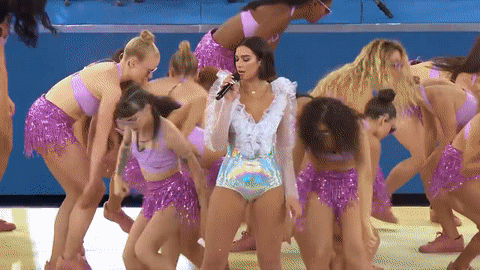

In [543]:
df_match_to_predict

,match_api_id,MatchResult,home_team_attributes,away_team_attributes,home_team_overall_rating,home_team_potential,home_team_crossing,home_team_finishing,home_team_heading_accuracy,home_team_short_passing,...,away_team_marking,away_team_standing_tackle,away_team_sliding_tackle,away_team_gk_diving,away_team_gk_handling,away_team_gk_kicking,away_team_gk_positioning,away_team_gk_reflexes,home_team_goal,away_team_goal
4394,1988994,2,"{'overall_rating': 74.71428571428571, 'potenti...","{'overall_rating': 72.66666666666667, 'potenti...",68.791519,75.144099,59.135203,51.325932,54.095552,64.76342,...,53.818182,56.363636,51.727273,16.727273,25.727273,62.727273,25.181818,25.545455,1,3


In [557]:
df_master_data_to_use_ml_filter = df_master_data_to_use_ml.loc[:, ~df_master_data_to_use_ml.columns.isin(['home_team_goal','away_team_goal'])]

X = df_master_data_to_use_ml_filter.values
y = df_data_to_use_hypothesis.MatchResult.values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)

#scaling features
scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

#creating models variable to iterate through each model and print result
classifiers = [
    DecisionTreeClassifier(),
    RandomForestClassifier(n_estimators=200),
    QuadraticDiscriminantAnalysis()]

# names = ["Nearest Neighbors","Linear SVM", "RBF SVM", "QDA"]
names = [ "DecisionTree", "RandomForest", "QDA"]


In [566]:

X_to_use = df_match_to_predict.loc[:, ~df_match_to_predict.columns.isin(cols_to_exclude)]
# print(X_to_use.columns.tolist())
X_to_use.drop(['home_team_goal', 'away_team_goal'], axis=1, inplace=True)
# print(X_to_use.columns.tolist())

X_data = X_to_use

for name, clf in zip(names, classifiers):
    clf.fit(X_train, y_train)
    accuracy = clf.score(X_test, y_test)
    
    print(name, accuracy)
    print(clf.predict(X_data))

# cols_to_exclude = ['match_api_id' , 'MatchResult', 'home_team_attributes', 'away_team_attributes']


DecisionTree 0.3537832310838446
[1]
RandomForest 0.44642126789366054
[2]
QDA 0.38609406952965236
[1]


In [561]:
df_match_to_predict.loc[:, ~df_match_to_predict.columns.isin(cols_to_exclude)].columns

Index(['home_team_overall_rating', 'home_team_potential', 'home_team_crossing',
       'home_team_finishing', 'home_team_heading_accuracy',
       'home_team_short_passing', 'home_team_volleys', 'home_team_dribbling',
       'home_team_curve', 'home_team_free_kick_accuracy',
       'home_team_long_passing', 'home_team_ball_control',
       'home_team_acceleration', 'home_team_sprint_speed', 'home_team_agility',
       'home_team_reactions', 'home_team_balance', 'home_team_shot_power',
       'home_team_jumping', 'home_team_stamina', 'home_team_strength',
       'home_team_long_shots', 'home_team_aggression',
       'home_team_interceptions', 'home_team_positioning', 'home_team_vision',
       'home_team_penalties', 'home_team_marking', 'home_team_standing_tackle',
       'home_team_sliding_tackle', 'home_team_gk_diving',
       'home_team_gk_handling', 'home_team_gk_kicking',
       'home_team_gk_positioning', 'home_team_gk_reflexes',
       'away_team_overall_rating', 'away_team_poten

### Yay!!! Our New Team Strategy worked!!

#### In RANDOM FOREST MODEL, match prediction is [2] which depicts the Match Result as "DRAW". Earlier Match Result for Newcastle United vs Bournemouth was [0] i.e. "DEFEAT" 

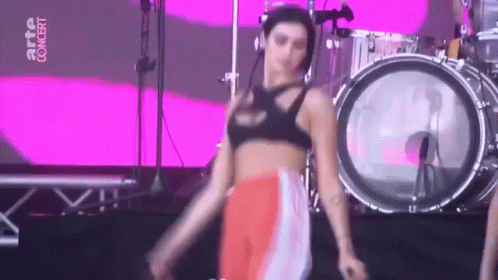

### Dua Lipa is finally impressed!!! :P